In [1]:
import pickle
import random
import kdtree
import math
import numpy as np

In [199]:
with open('pumas_out.pkl','rb') as f:
    data = pickle.load(f)

In [318]:
vals = sorted((x[0] for x in 
               data['with_z'][(True,True,True,True,False,False,True,True)]['vals'].values()),
              reverse=True)
n = sum(vals)

In [201]:
list(data['with_z'][(True,True,True,True,True,True,True,True)]['vals'].keys())[2000]

('boomer',
 'multiple',
 'female',
 'never_married',
 'no_deg',
 'suburban',
 'middle',
 'yes')

In [208]:
data['with_z'][(True,True,True,True,True,True,True,True)]['vals'][('millennial','white_alone',
                                                                   'male','never_married',
                                                                   'deg','urban','no_or_low','no')]

(289017.0, 230.0)

In [114]:
vals

[97986887.0,
 82446749.0,
 42966690.0,
 28047244.0,
 22841024.0,
 20491553.0,
 18822250.0,
 12116781.0]

In [100]:
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [319]:
D = 1.0
d = .18
radii = [D/2*(d*s/n)**.5 for s in vals]

In [320]:
sum(radii)

3.069054772174904

In [321]:
def distance(point1,point2):
    return ((point1[0]-point2[0])**2+(point1[1]-point2[1])**2)**.5

def brute_force(points,point):
    return min((point1 for point1 in points),key=lambda x:distance(x,point))

def overlaps(points,point1,buffer=0.003):
    o = False
    for x,y,r in points:
        if distance((x,y,r),(point1[0],point1[1]))<(r+point1[2]+buffer):
            return True
    return o

In [322]:
len(vals)

720

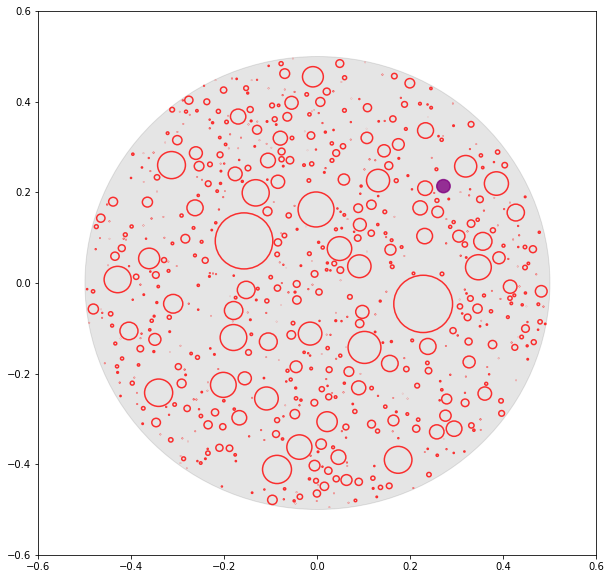

In [324]:
circles = []
tree_centers = kdtree.create(dimensions=2)
fig, ax = plt.subplots(1,1,figsize=(10,10))
ax.add_artist(plt.Circle((0,0), 0.5, color='black',alpha=0.1))
max_attempts = 5000
k = 3
center_to_radius = {}
for u,radius in enumerate(radii):
    attempts = 0
    while attempts<max_attempts:
        r = (.5-radius) * random.random()**.5
        theta = random.random()*2*math.pi
        x = r*math.cos(theta)
        y = r*math.sin(theta)
        search_res = tree_centers.search_knn((x,y),k)
        points = []
        for node,_ in search_res:
            x_, y_ = node.data
            points.append((x_,y_,center_to_radius[(x_,y_)]))
        if u>50:
            points += circles[:4]
        if not overlaps(points,(x,y,radius)):
            circles.append((x,y,radius))
            tree_centers.add((x,y))
            center_to_radius[(x,y)] = radius
#             if u%42==0:
#                 tree_centers = tree_centers.rebalance()
            break
        attempts += 1
    else:
        print('failed to place one')
for u,(x,y,r) in enumerate(circles):
    ax.add_artist(plt.Circle((x, y), r, color='red' if u!=50 else 'purple',alpha=0.8,
                             linewidth=1.5,fill=False if u!=50 else True));
plt.xlim(-.6,.6);
plt.ylim(-.6,.6);

In [196]:
vals[2000]

3295.0

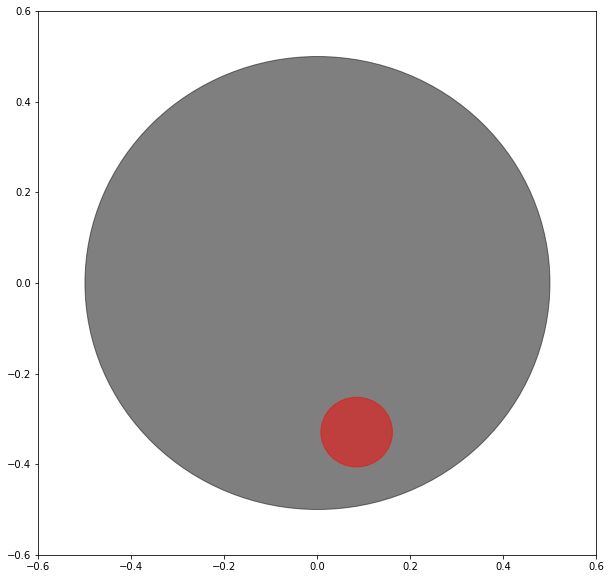

(0.4237416562831601, -0.024366987360009966) (0.14658057242931283, -0.28387136646729955) (<KDNode - (0.14658057242931283, -0.28387136646729955)>, 0.1441607891788992) 0.37968511845857117 0.07532923437156437


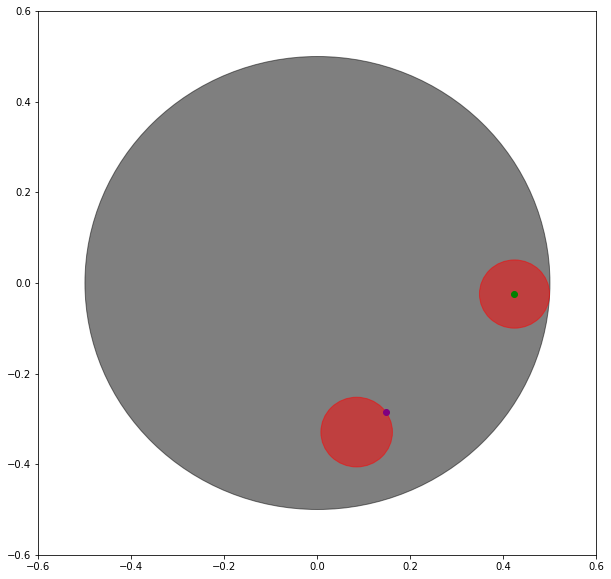

(-0.4291656052256358, 0.007738966045297516) (0.022079200834912285, -0.2838713664672995) (<KDNode - (0.022079200834912285, -0.2838713664672995)>, 0.28865846102472903) 0.5372694491823716 0.05295851396241448


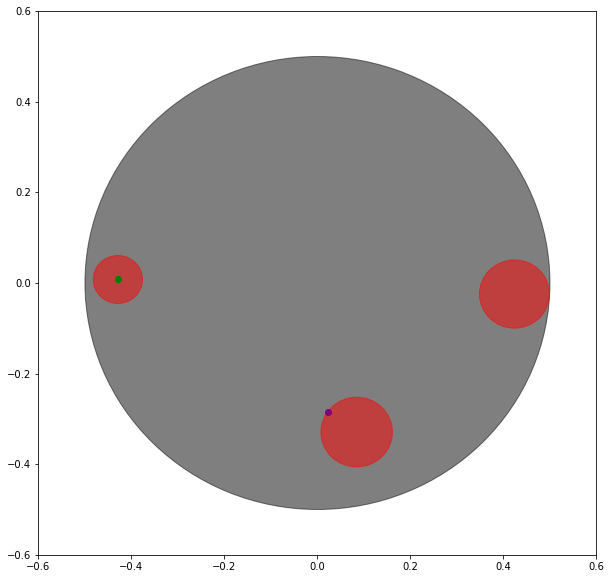

(0.22094529552172157, 0.13487198541739379) (0.3627990255033111, 0.01991042567007885) (<KDNode - (0.3627990255033111, 0.01991042567007885)>, 0.03333864092922518) 0.18258872070646964 0.051915653374893435


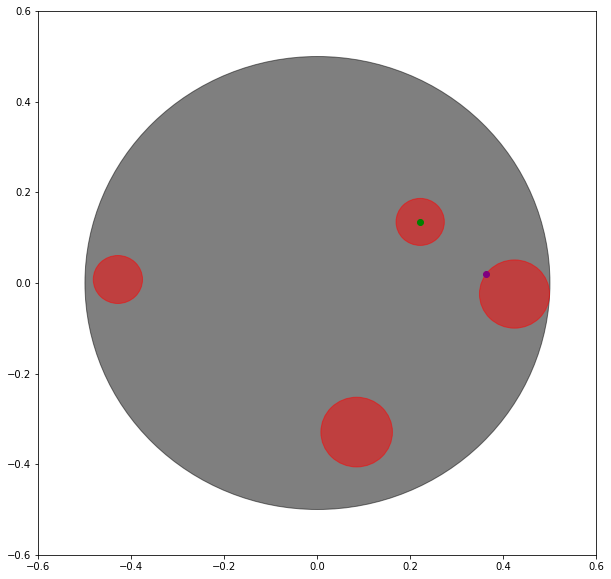

(0.3576191530561878, 0.128356007049941) (0.272860948896615, 0.13487198541739379) (<KDNode - (0.272860948896615, 0.13487198541739379)>, 0.007226411146440938) 0.08500830045613744 0.04865063171770167


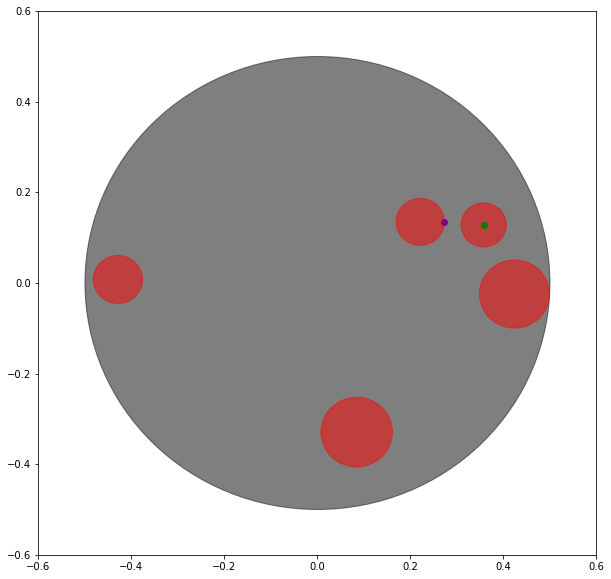

(-0.24677881795723222, -0.3496154339535455) (0.007383807340792331, -0.3290991370964648) (<KDNode - (0.007383807340792331, -0.3290991370964648)>, 0.0650195585351119) 0.25498933023778053 0.04750907151578954


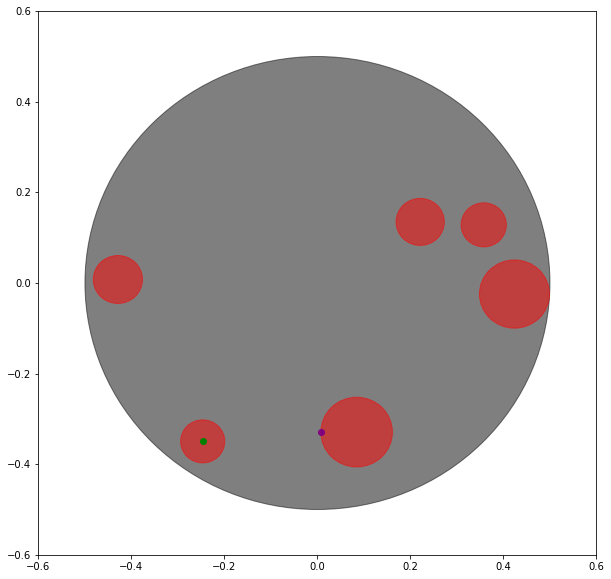

(0.010377719275498685, 0.4529960582956381) (0.19043004010483125, 0.17687263127176167) (<KDNode - (0.19043004010483125, 0.17687263127176167)>, 0.10866298518743892) 0.3296406910371335 0.04029388080584977


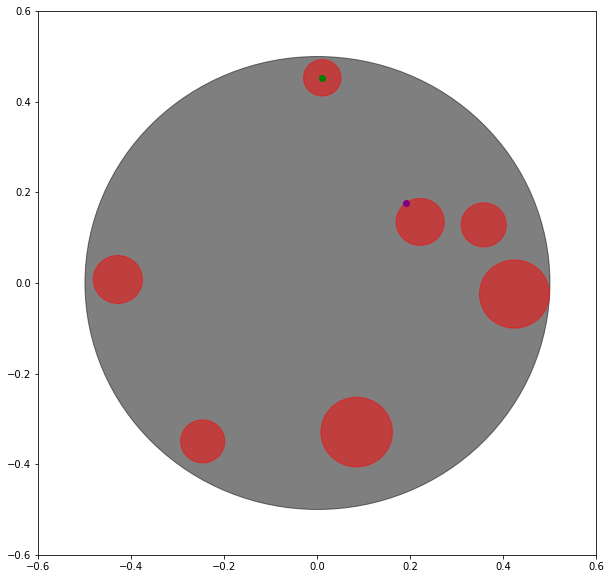

(0.034674505547598176, -0.20748406783932735) (0.060552240480572395, -0.25591906698309114) (<KDNode - (0.060552240480572395, -0.25591906698309114)>, 0.0030156063073176727) 0.05491453639354222 0.0352620689371532


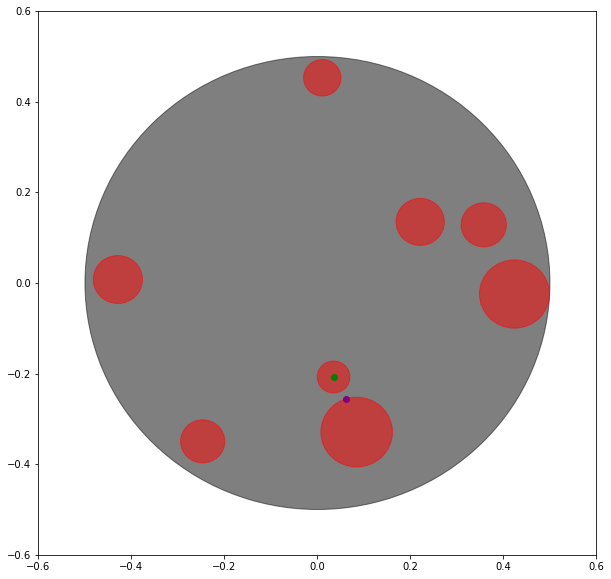

(0.28388672385588654, 6.296899170499626e-05) (0.3520992970665589, -0.0010889737659431561) (<KDNode - (0.3520992970665589, -0.0010889737659431561)>, 0.004654282116138235) 0.06822229925866055 0.03484840233491997


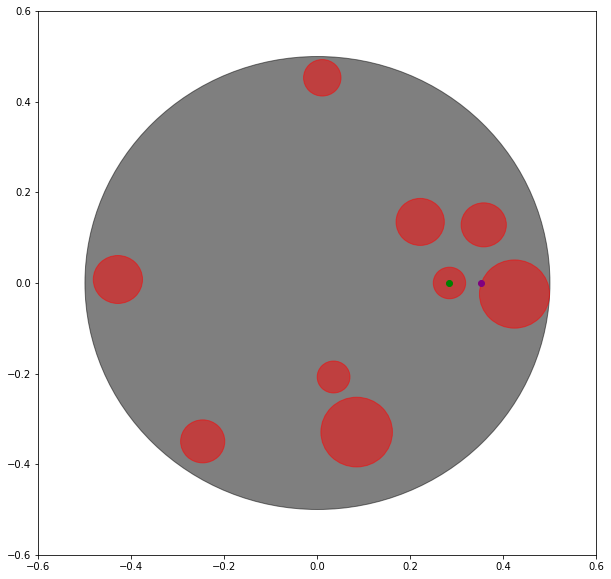

(0.12977179877216702, -0.09740283641128981) (0.055401029634177354, -0.17895645481234948) (<KDNode - (0.055401029634177354, -0.17895645481234948)>, 0.012182003976481814) 0.11037211593732275 0.033612604893538185


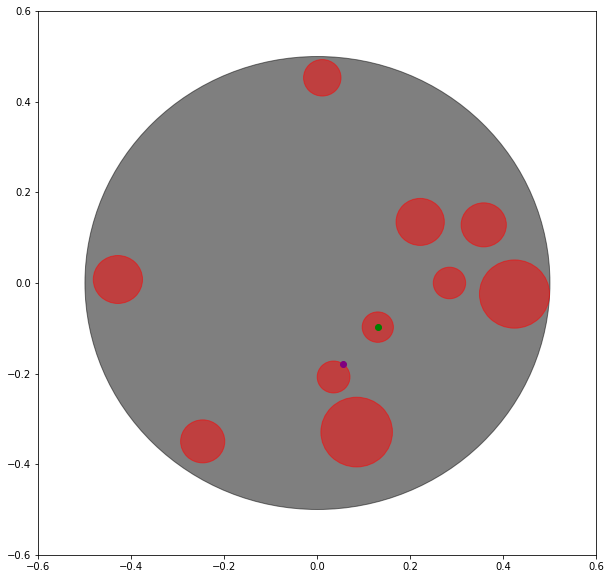

(-0.3378656752103908, 0.2117188219379421) (-0.4128005244144068, 0.05810550584255968) (<KDNode - (-0.4128005244144068, 0.05810550584255968)>, 0.029212282507048493) 0.1709160100957441 0.03353321207285256


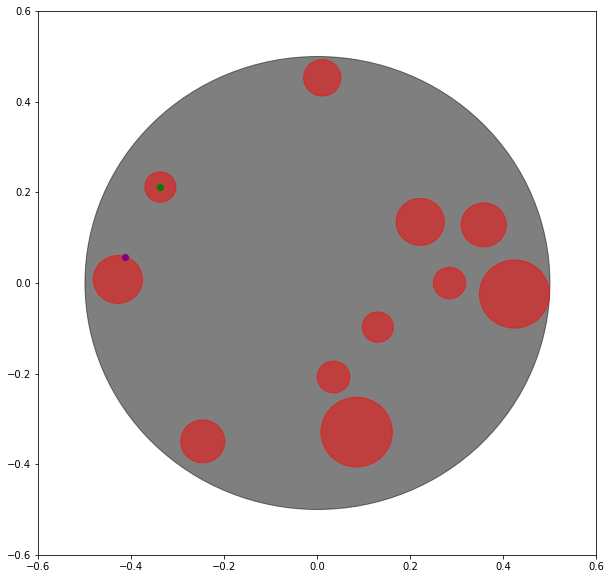

(-0.26202445060242613, 0.26279559973155514) (-0.31073673676747393, 0.23142914945636073) (<KDNode - (-0.31073673676747393, 0.23142914945636073)>, 0.0033567410262917517) 0.057937388845992636 0.03279742724026131


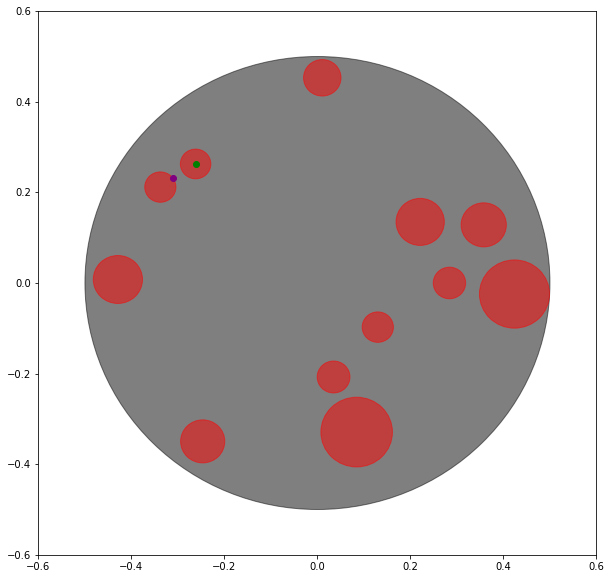

(-0.25114533386014004, 0.16711374089325037) (-0.26202445060242613, 0.22999817249129384) (<KDNode - (-0.26202445060242613, 0.22999817249129384)>, 0.004072806918501297) 0.06381854682223105 0.032731131978374385


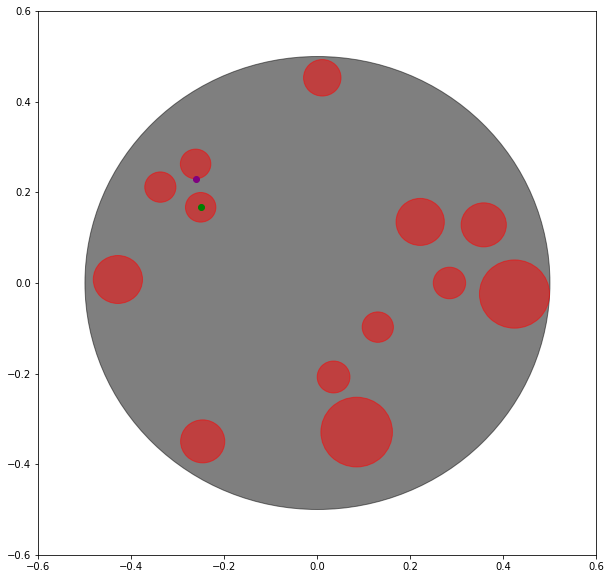

(0.10010525841904973, -0.3237787710928383) (0.1575099567454862, -0.30532149094492467) (<KDNode - (0.1575099567454862, -0.30532149094492467)>, 0.0036359705804077463) 0.06029900977966177 0.03268928871246073


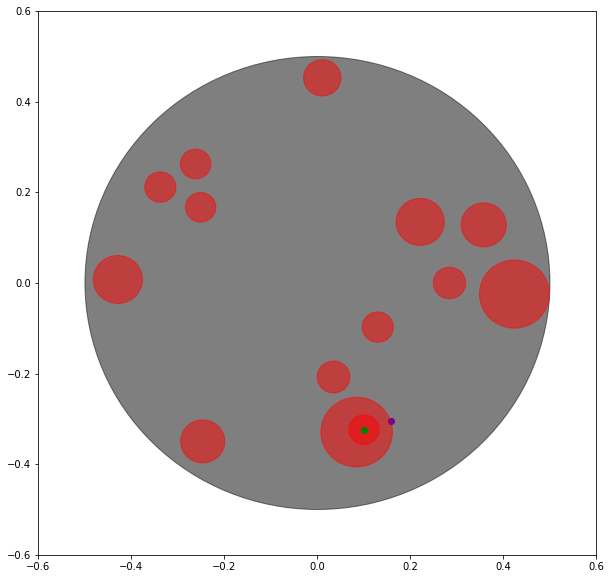

(-0.23615364990469342, 0.065038097434771) (-0.25114533386014004, 0.134382608914876) (<KDNode - (-0.25114533386014004, 0.134382608914876)>, 0.0050334118602344095) 0.07094654227116647 0.031089461493439014


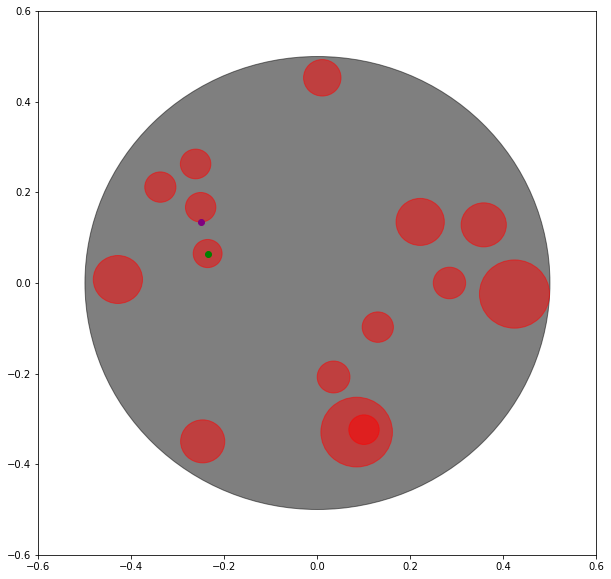

(-0.18647332620147092, 0.2420211454015653) (-0.23083224370785943, 0.2526606373425386) (<KDNode - (-0.23083224370785943, 0.2526606373425386)>, 0.0020809123511006168) 0.04561701821799203 0.03005491731999535


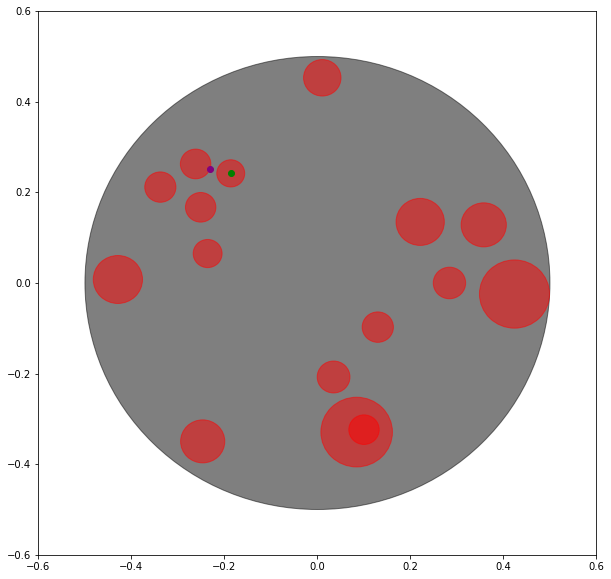

(-0.09118082580546935, -0.3946001066002355) (0.011149816518738878, -0.352876783248005) (<KDNode - (0.011149816518738878, -0.352876783248005)>, 0.01221239607003982) 0.11050971029751105 0.03004636098514871


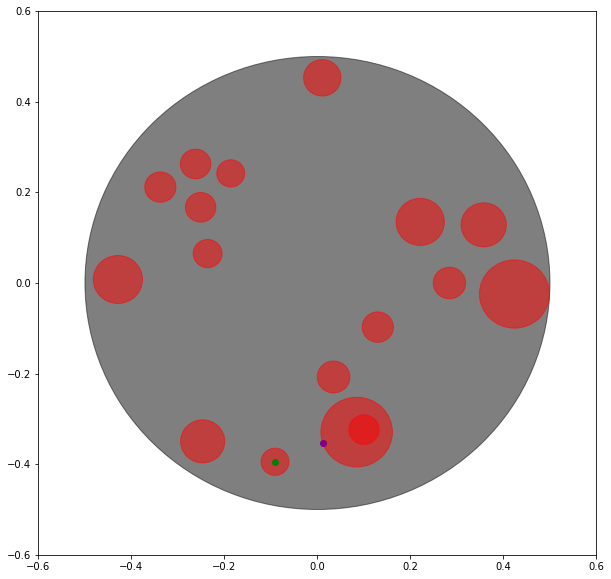

(-0.4507238314706045, 0.007785291880254101) (-0.48212411918805026, 0.007738966045297522) (<KDNode - (-0.48212411918805026, 0.007738966045297522)>, 0.0009859802148213584) 0.03140032189040995 0.028942400173637927


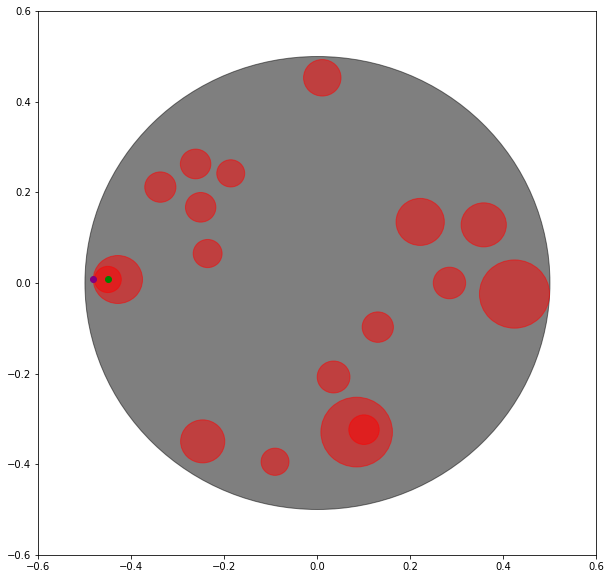

(0.2329625171752386, -0.38904173072422354) (0.1575099567454862, -0.352876783248005) (<KDNode - (0.1575099567454862, -0.352876783248005)>, 0.007000992301363086) 0.08367193257815363 0.028449930289571906


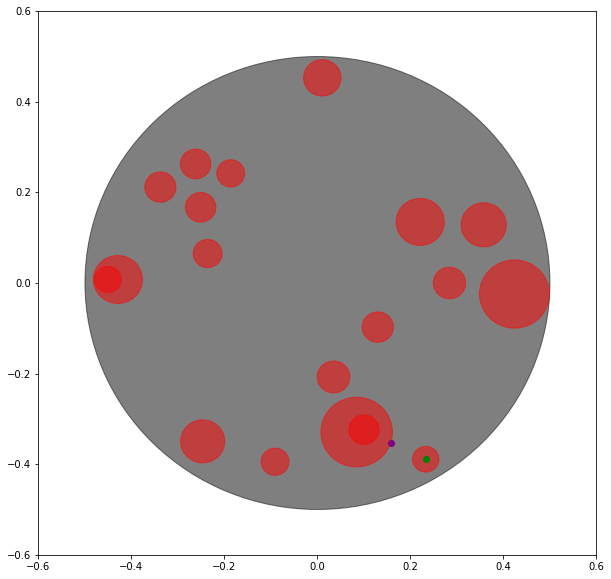

(-0.16979517965376045, 0.37671145627006014) (-0.18647332620147092, 0.27207606272156065) (<KDNode - (-0.18647332620147092, 0.27207606272156065)>, 0.011226726155316275) 0.10595624641953053 0.028164633551746653


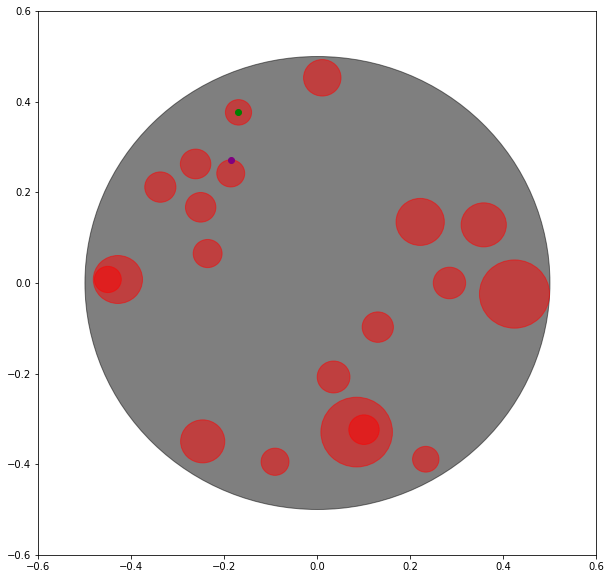

(0.029658394951495963, 0.3595681593130819) (0.022829213213824757, 0.41467430038841446) (<KDNode - (0.022829213213824757, 0.41467430038841446)>, 0.0030833245074205974) 0.055527691356841026 0.028038845247293706


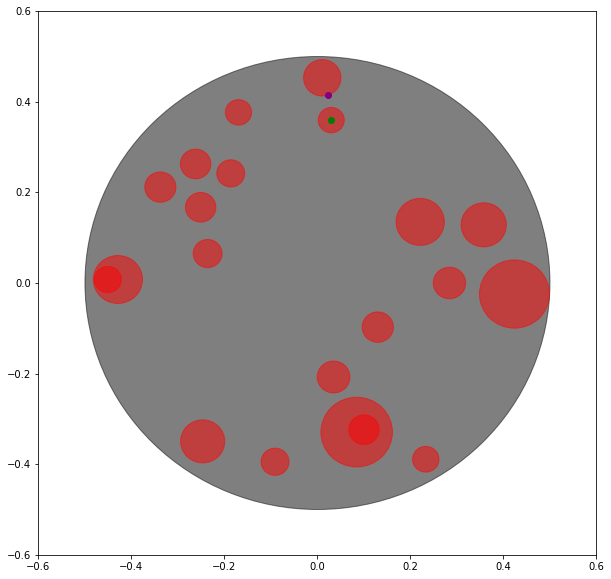

(0.32886072525032517, -0.13887738785130976) (0.37946424325307127, -0.08530961813985895) (<KDNode - (0.37946424325307127, -0.08530961813985895)>, 0.005430221986113275) 0.0736900399383341 0.027881297009612883


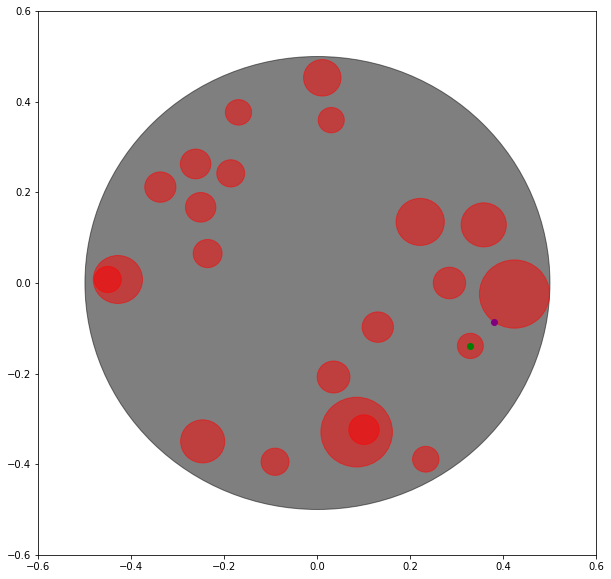

(0.09703327705675466, -0.22711514905903912) (0.08432988663211255, -0.25215305780514463) (<KDNode - (0.08432988663211255, -0.25215305780514463)>, 0.0007882730026591955) 0.02807619993266887 0.026752098548620176


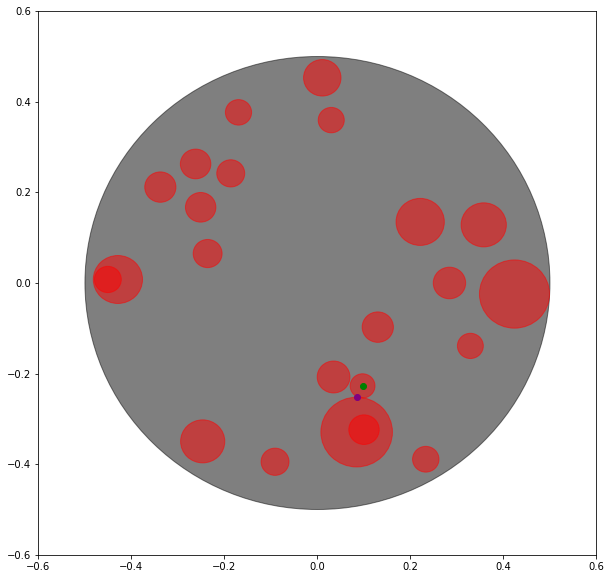

(-0.27058209594138555, -0.2648572819117203) (-0.2614599284425859, -0.30443162190532136) (<KDNode - (-0.2614599284425859, -0.30443162190532136)>, 0.0016493423258052877) 0.040612095806610224 0.02667208288523011


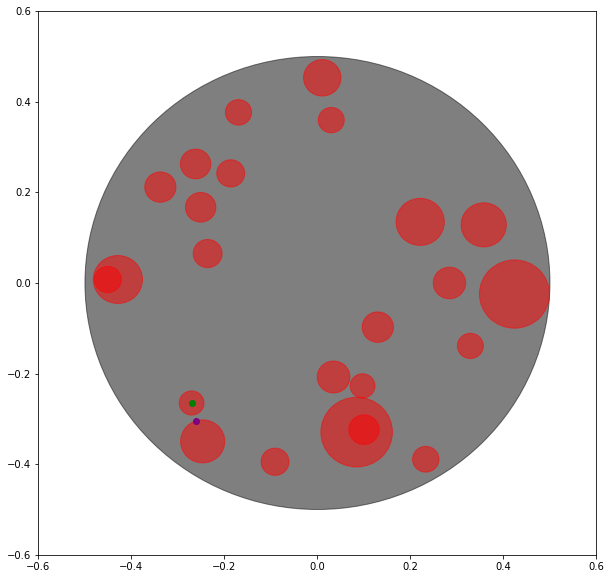

(-0.05633080516249429, 0.2722701669533212) (0.013177575223825816, 0.33688425700537206) (<KDNode - (0.013177575223825816, 0.33688425700537206)>, 0.009006395577183909) 0.0949020314702689 0.025749728905400966


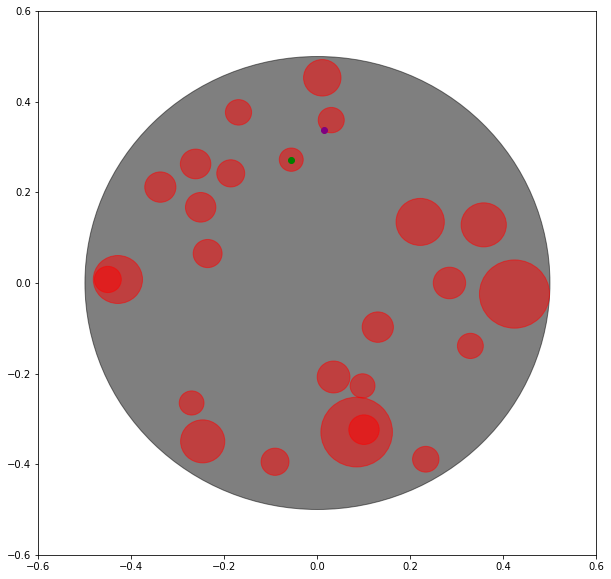

(-0.2431055519585763, -0.18044310024460605) (-0.26233996905447227, -0.23949062368055776) (<KDNode - (-0.26233996905447227, -0.23949062368055776)>, 0.003856572824938161) 0.06210131097600244 0.025387192888823844


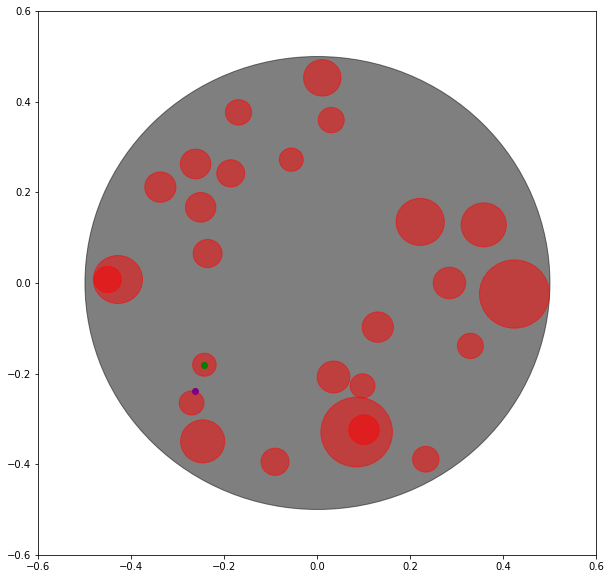

(0.3860178451136356, -0.20047730723370114) (0.3452489404473619, -0.161433830957302) (<KDNode - (0.3452489404473619, -0.161433830957302)>, 0.0031864966274334607) 0.05644906223697131 0.02527234227248924


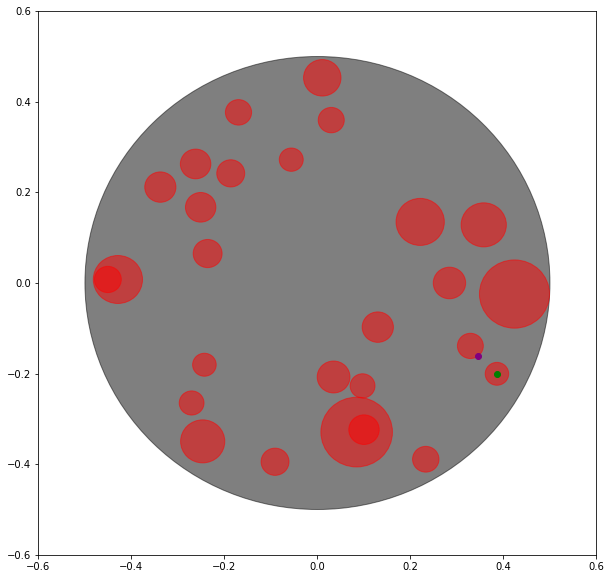

(0.08500753808093008, 0.2183715198893358) (0.17894464966735368, 0.1653872408342841) (<KDNode - (0.17894464966735368, 0.1653872408342841)>, 0.011631514760183792) 0.10784950050966297 0.025186788170410517


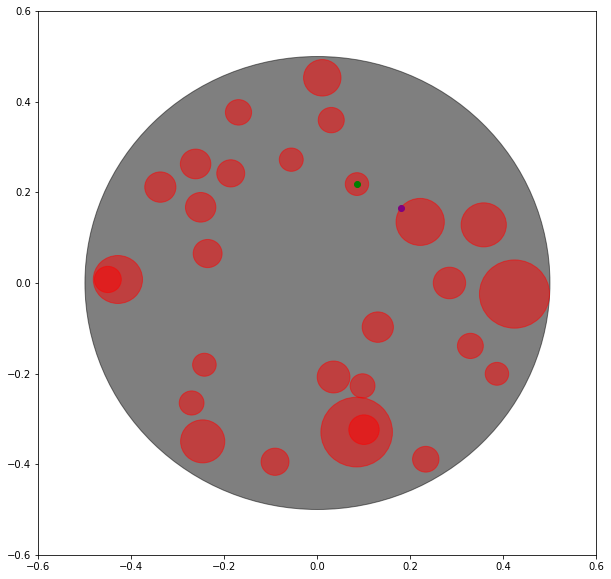

(0.022467578774080052, 0.14799486954051783) (0.07020311544174825, 0.19799498022575182) (<KDNode - (0.07020311544174825, 0.19799498022575182)>, 0.004778692529485946) 0.06912808784774786 0.02473257451175698


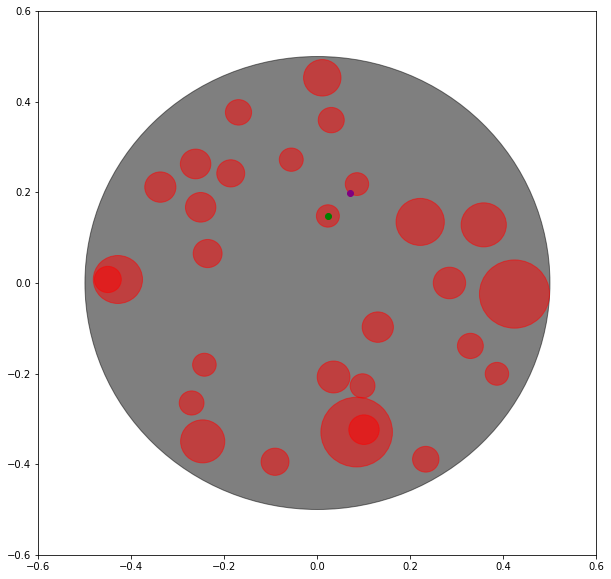

(-0.07962173093057898, 0.3502602084083944) (-0.06428790899481099, 0.29675961442163645) (<KDNode - (-0.06428790899481099, 0.29675961442163645)>, 0.003097439652093759) 0.055654646275883915 0.02471928870951027


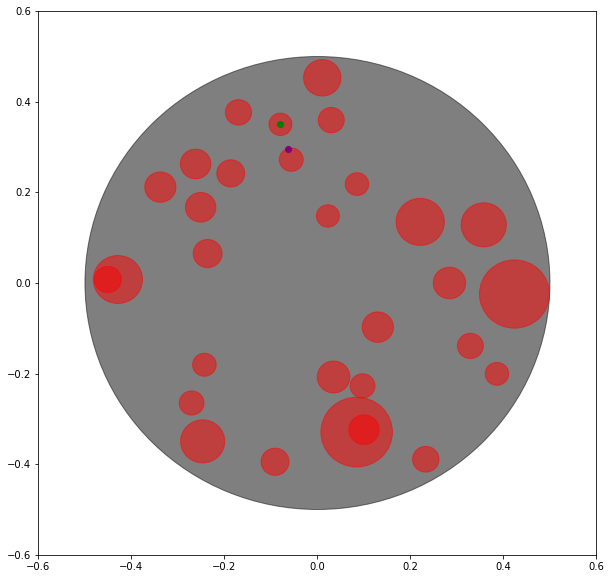

(-0.2291612883897735, 0.001644027875844953) (-0.23615364990469342, 0.03394863594133199) (<KDNode - (-0.23615364990469342, 0.03394863594133199)>, 0.0010924808218200632) 0.03305269764815064 0.024244770144112342


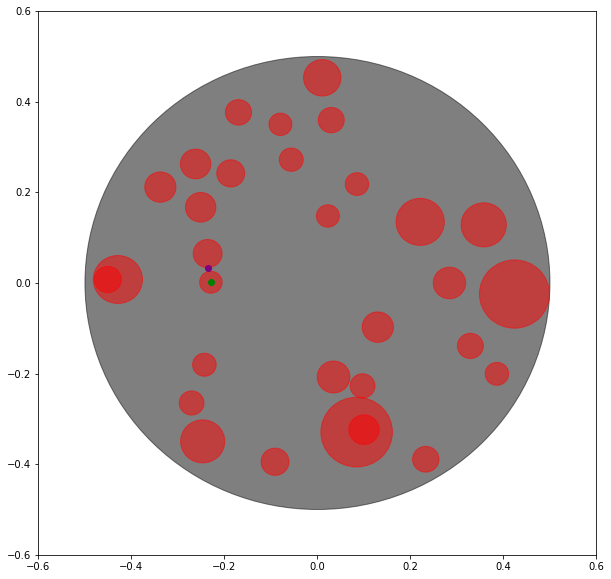

(-0.31576968957867824, -0.01236031604656009) (-0.3787990654283736, -0.008626114765931503) (<KDNode - (-0.3787990654283736, -0.008626114765931503)>, 0.003986646479206411) 0.06313989609752625 0.023602565670457556


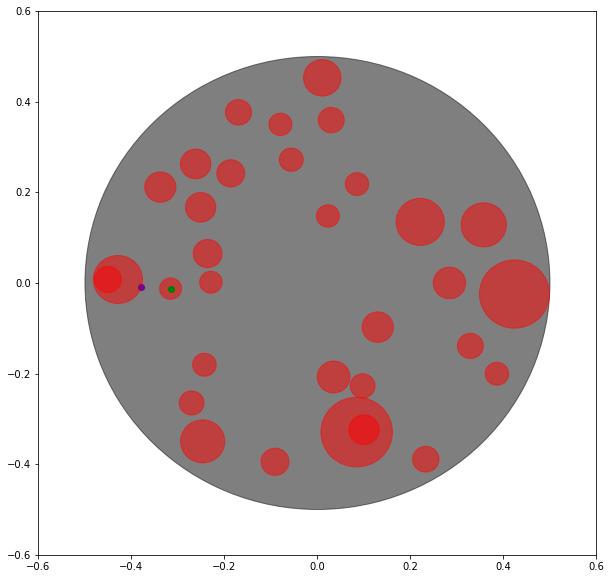

(-0.13642322757255723, -0.11093534126069769) (-0.222566881472043, -0.16552088266745105) (<KDNode - (-0.222566881472043, -0.16552088266745105)>, 0.010400310437822776) 0.10198191230714776 0.02313630395610112


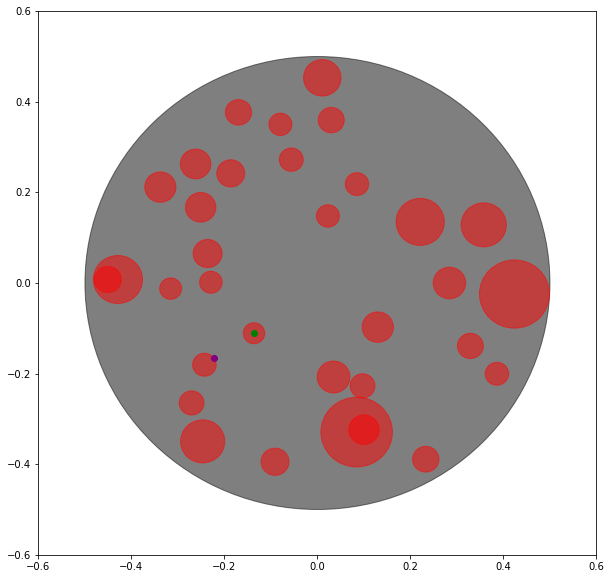

(-0.3217623589823188, -0.258706313894513) (-0.29725417882661564, -0.2648572819117203) (<KDNode - (-0.29725417882661564, -0.2648572819117203)>, 0.0006384853020931097) 0.025268266701400588 0.023121320876066873


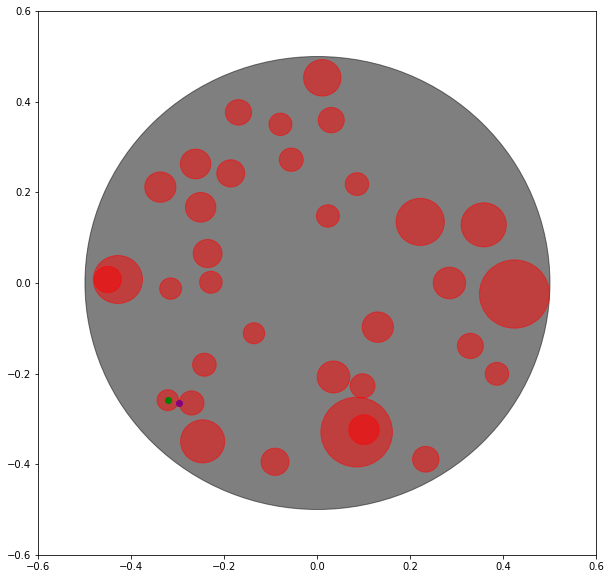

(-0.15195738320428742, -0.3365665287805073) (-0.19926974644144269, -0.3496154339535455) (<KDNode - (-0.19926974644144269, -0.3496154339535455)>, 0.002408733641299464) 0.049078851263038584 0.02307620516915053


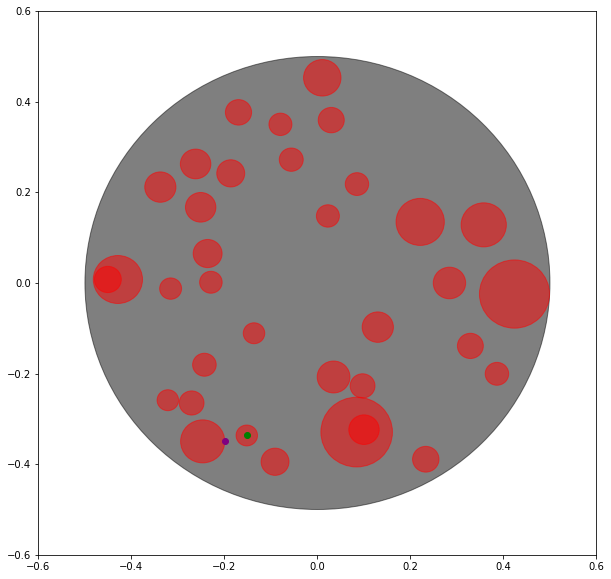

(0.32972274700833426, -0.2642933342975752) (0.3711631350349788, -0.2209230616198053) (<KDNode - (0.3711631350349788, -0.2209230616198053)>, 0.003598286311942975) 0.05998571756629219 0.02302414322855757


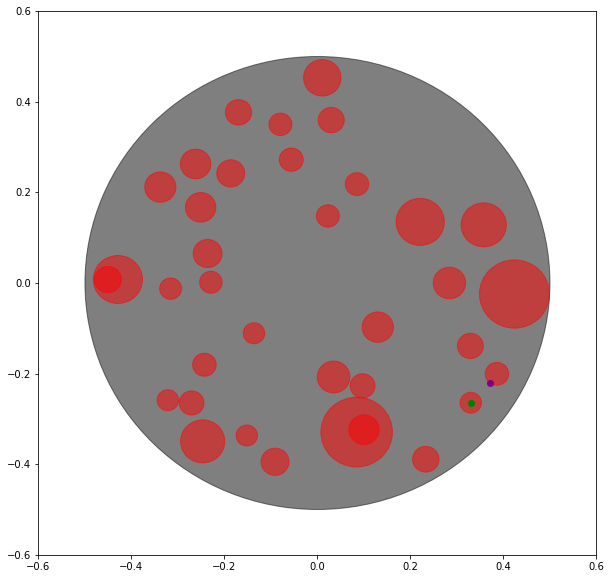

(-0.03507371684569646, -0.27936729197154697) (0.011149816518738892, -0.30532149094492467) (<KDNode - (0.011149816518738892, -0.30532149094492467)>, 0.0028102354810427485) 0.053011654200211 0.022946798859207952


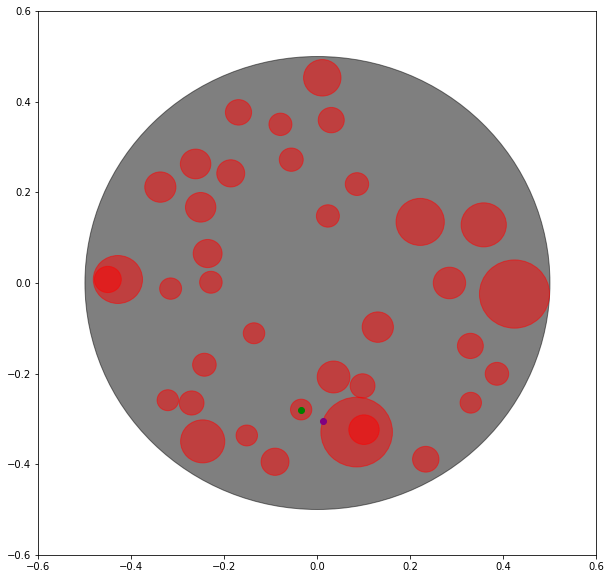

(-0.2964406052761725, -0.21163364132110873) (-0.3081719875578446, -0.24000077237337863) (<KDNode - (-0.3081719875578446, -0.24000077237337863)>, 0.000942319454375385) 0.030697222258298632 0.02253915552606904


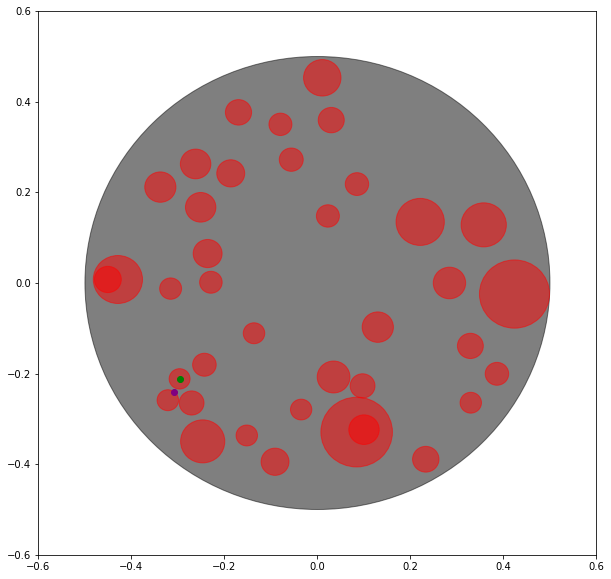

(-0.16123348392871914, 0.15934214923278614) (-0.1771858459850584, 0.21343722043767166) (<KDNode - (-0.1771858459850584, 0.21343722043767166)>, 0.0031807545838381675) 0.056398178905334946 0.022480900201119404


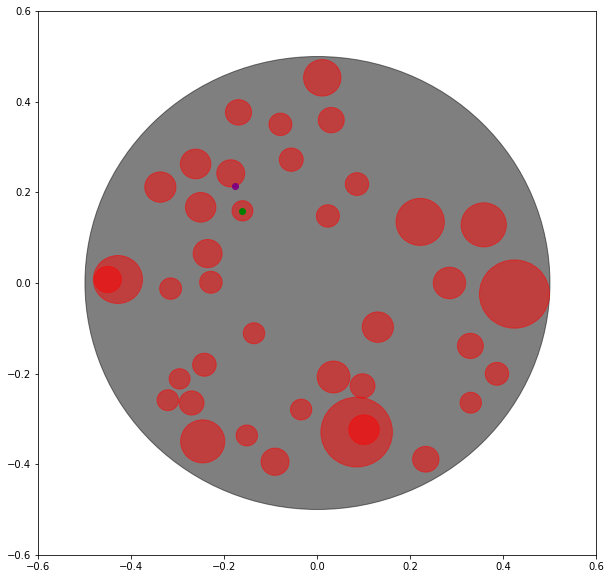

(0.10141659690250993, -0.4667771082949957) (0.08432988663211254, -0.406045216387785) (<KDNode - (0.08432988663211254, -0.406045216387785)>, 0.0039803183624936254) 0.06308976432428343 0.022228388173535674


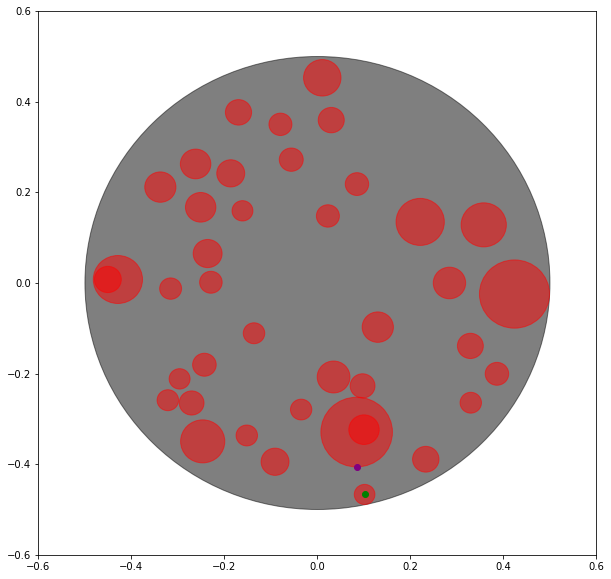

(-0.3995165219944836, 0.15917300921585195) (-0.36499461365330765, 0.19200849441952345) (<KDNode - (-0.36499461365330765, 0.19200849441952345)>, 0.0022699312440770843) 0.047643795441558646 0.022086615967515624


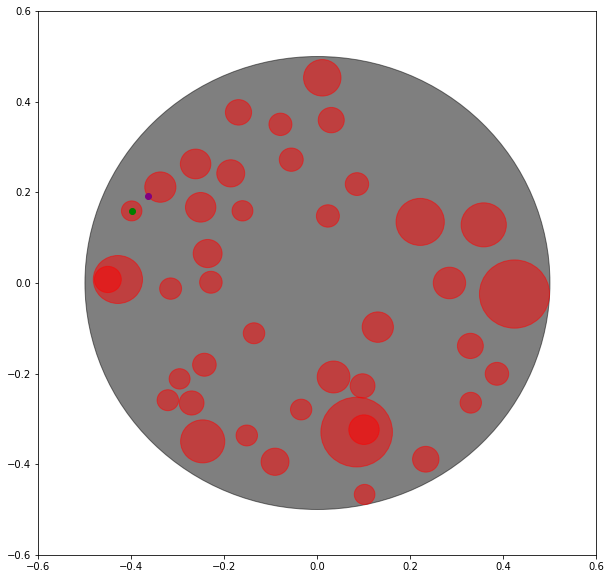

(-0.3566613218731465, 0.12638520515838753) (-0.38164807432853043, 0.14619082207709883) (<KDNode - (-0.38164807432853043, 0.14619082207709883)>, 0.0010166002597973792) 0.03188416942304408 0.021827425047203787


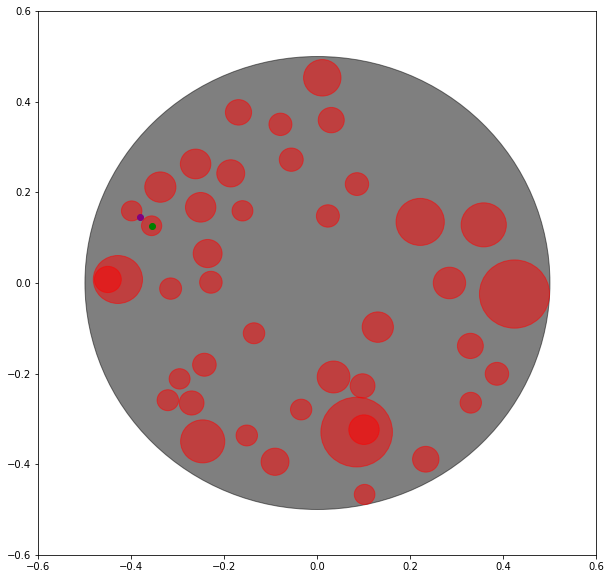

(0.26833686250879907, 0.2666534799659351) (0.23698811468864273, 0.18424670585730668) (<KDNode - (0.23698811468864273, 0.18424670585730668)>, 0.007773620408882265) 0.08816813715216096 0.021691074010729748


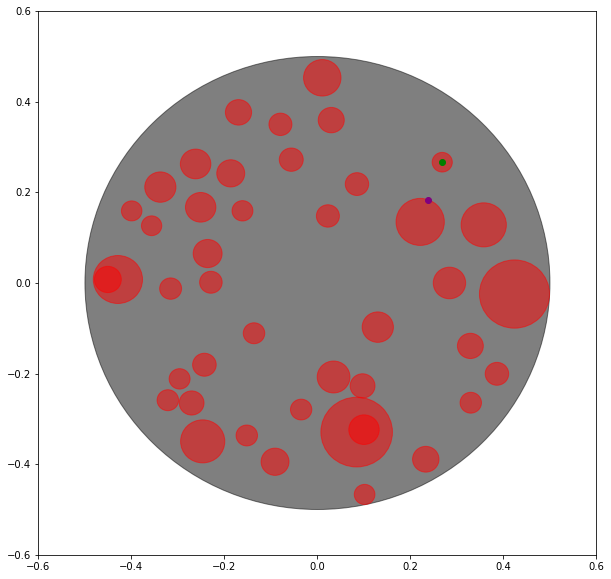

(-0.03884863453019982, -0.14111527191097384) (0.006146892520620298, -0.18675754375274817) (<KDNode - (0.006146892520620298, -0.18675754375274817)>, 0.004107814433459511) 0.06409223379988804 0.02148980082240996


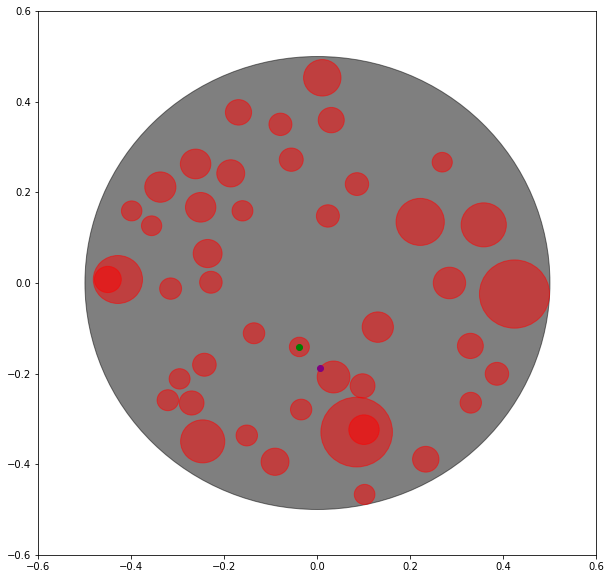

(-0.02290744903980254, 0.32886734822671426) (0.006974492643786127, 0.34308733958541177) (<KDNode - (0.006974492643786127, 0.34308733958541177)>, 0.0010951385930228256) 0.03309287828253725 0.021202553892525344


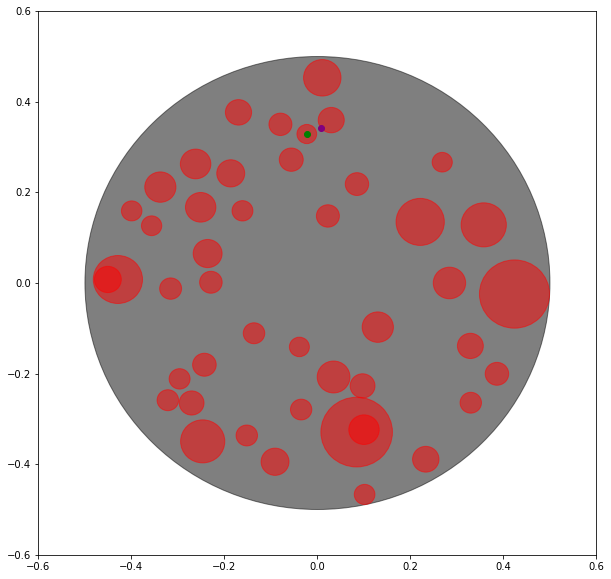

(-0.03951292680854308, -0.18908471623999779) (-0.03884863453019983, -0.1626050727333838) (<KDNode - (-0.03884863453019983, -0.1626050727333838)>, 0.0007016128044684313) 0.026487974714357293 0.02118712708271882


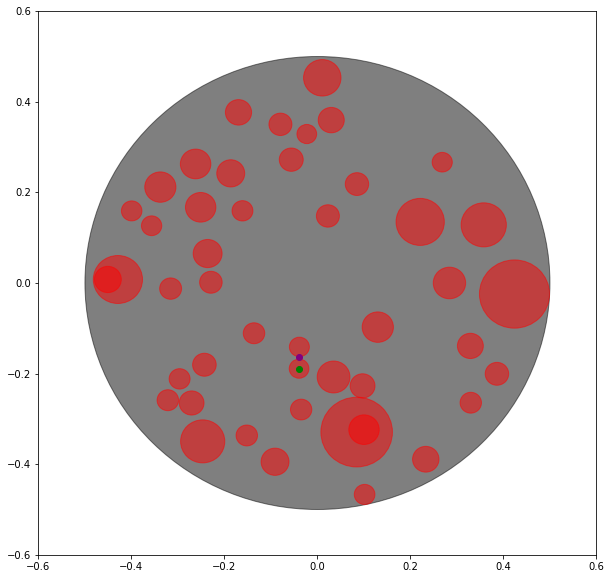

(0.2712091104300867, 0.0737847684783489) (0.25146055093861186, 0.0928713395630259) (<KDNode - (0.25146055093861186, 0.0928713395630259)>, 0.0007543027977587499) 0.027464573504038796 0.021152420981325883


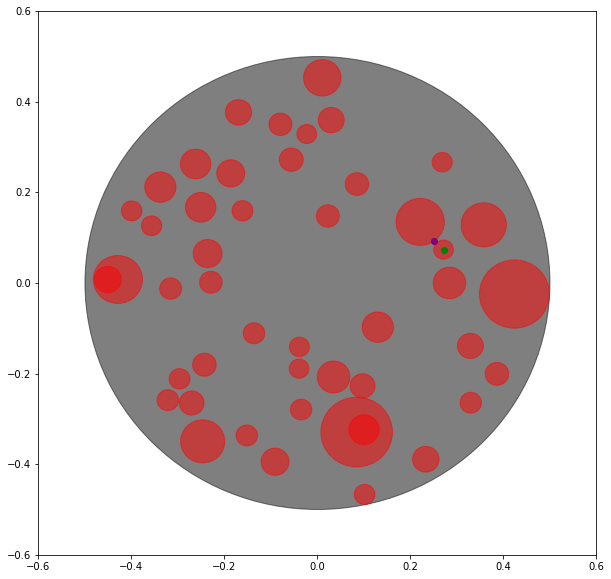

(-0.1722758098196781, -0.1617643665413219) (-0.15002240583050946, -0.1296530043482078) (<KDNode - (-0.15002240583050946, -0.1296530043482078)>, 0.0015263535710025034) 0.03906857523640328 0.02101214670677823


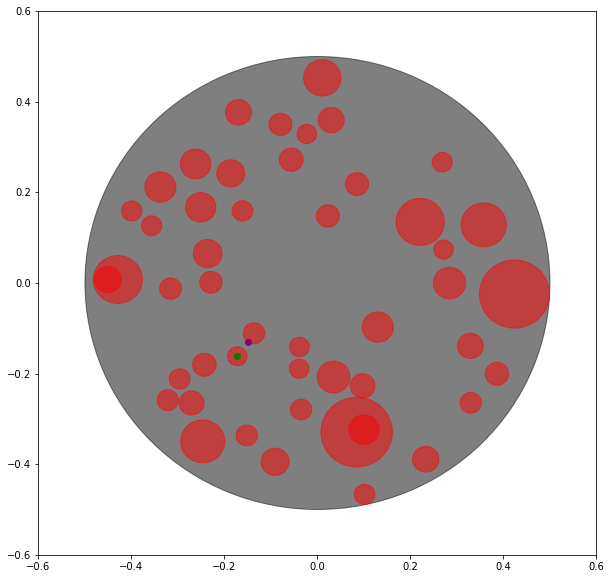

(-0.22914493163149816, 0.339679801971178) (-0.19258084683746635, 0.3601567000321217) (<KDNode - (-0.19258084683746635, 0.3601567000321217)>, 0.0017562356510234286) 0.04190746533761531 0.020904395834951777


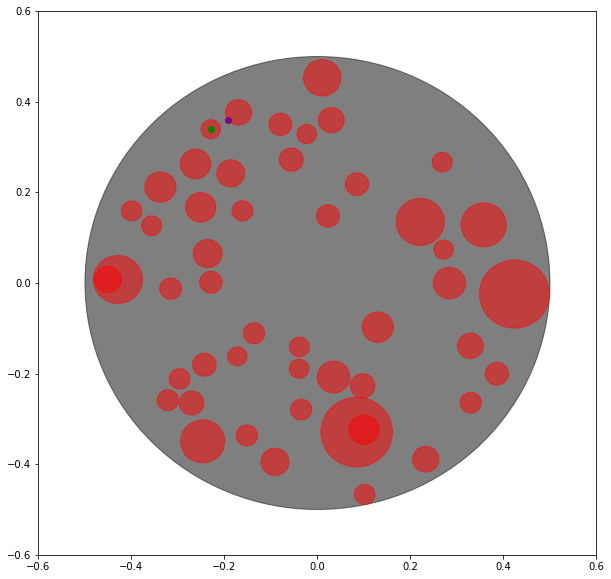

(0.14451715052467734, 0.3353198389667387) (0.05632492143332604, 0.3509036796290189) (<KDNode - (0.05632492143332604, 0.3509036796290189)>, 0.008020725361888728) 0.08955850245447793 0.020824965230514872


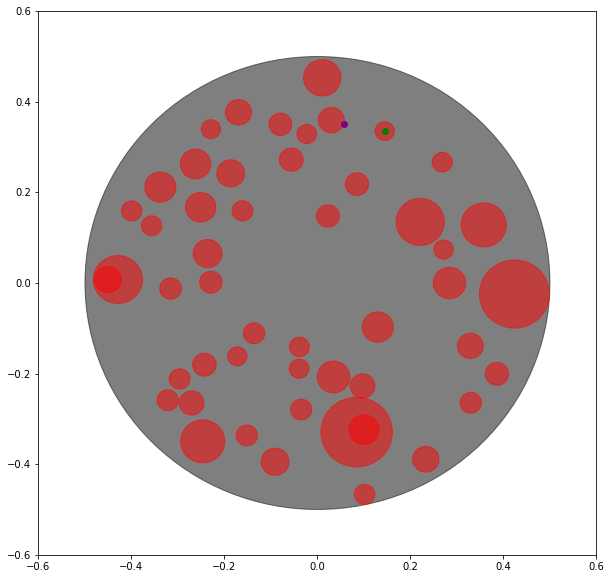

(-0.06510355846889801, 0.12231122383480651) (-0.0010544973800818529, 0.14035208370174027) (<KDNode - (-0.0010544973800818529, 0.14035208370174027)>, 0.004427754851097245) 0.0665413769852807 0.02077238776535955


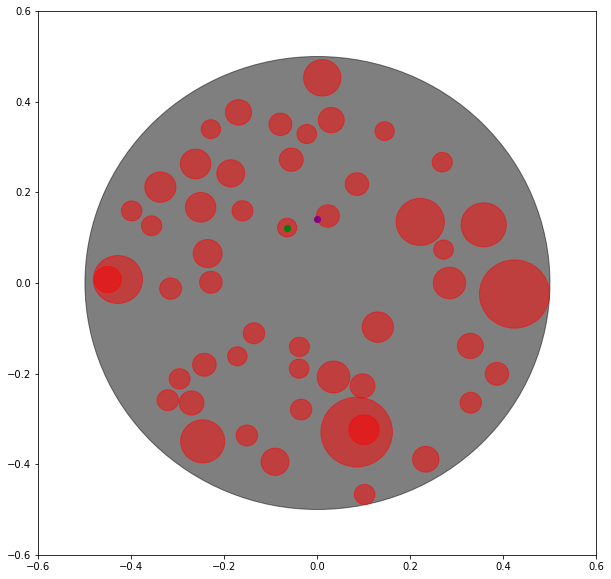

(-0.09800829901171763, -0.2612588194086253) (-0.05689741942886038, -0.27227634115754806) (<KDNode - (-0.05689741942886038, -0.27227634115754806)>, 0.001811490205564176) 0.042561604828344715 0.020721325258637294


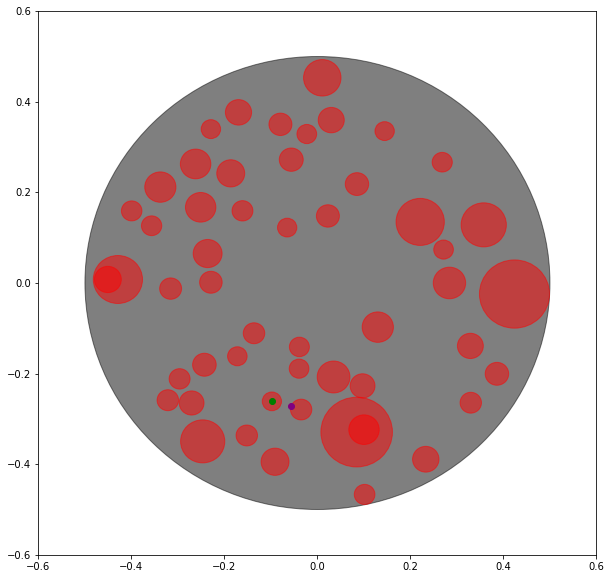

(0.22600739059276773, -0.052848203794356834) (0.2556937741401207, -0.020420407966715542) (<KDNode - (0.2556937741401207, -0.020420407966715542)>, 0.001932843310359738) 0.04396411389257991 0.02068634784018932


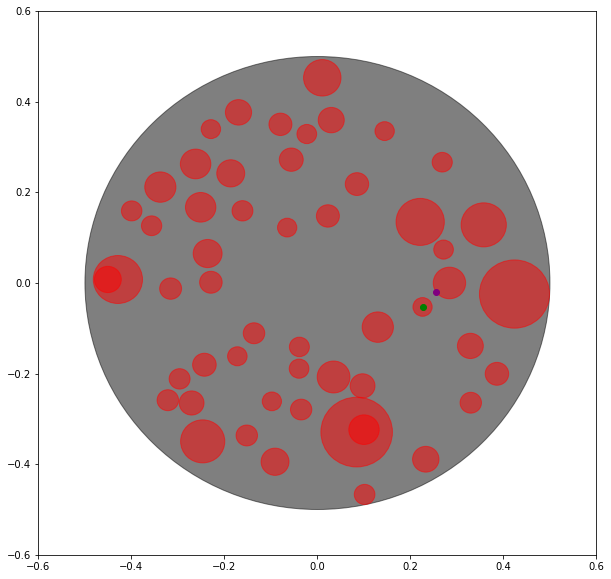

(0.12119134118405459, 0.15755158276051426) (0.09981196072011189, 0.19799498022575182) (<KDNode - (0.09981196072011189, 0.19799498022575182)>, 0.0020927463075531985) 0.04574654421432507 0.02046841439656025


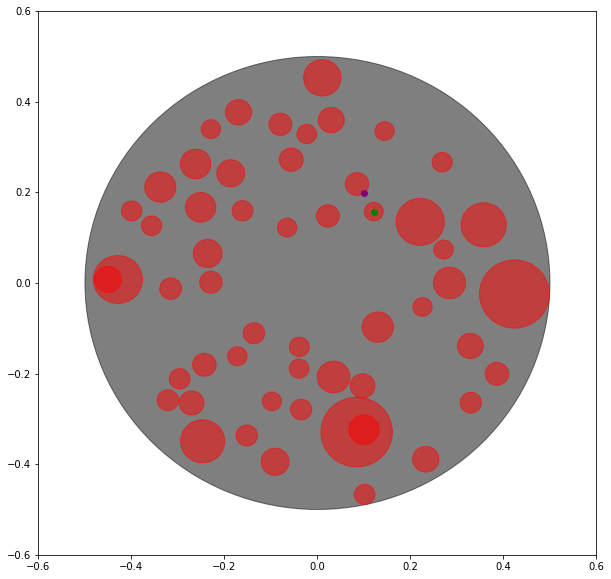

(-0.2967766604646974, 0.11859923974984336) (-0.2703842105278671, 0.1406336988776162) (<KDNode - (-0.2703842105278671, 0.1406336988776162)>, 0.0011820788027215865) 0.03438137290338457 0.020363430944702835


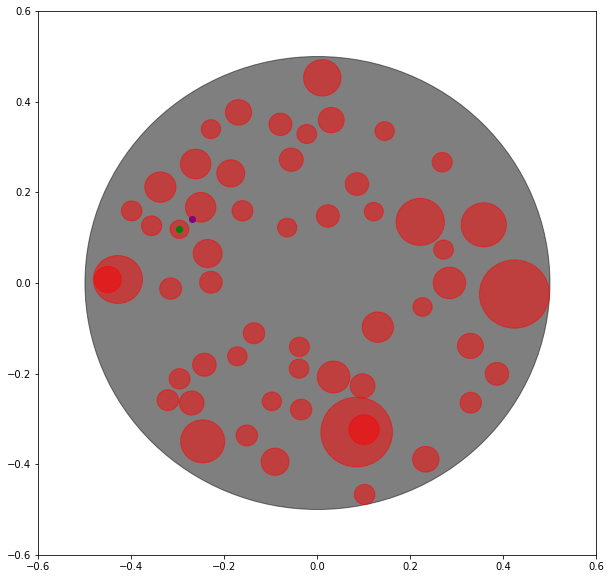

(0.017617040696138068, -0.13849333662873461) (-0.017358833707789862, -0.14111527191097384) (<KDNode - (-0.017358833707789862, -0.14111527191097384)>, 0.0012301863349435918) 0.035074012244731737 0.02004484681445542


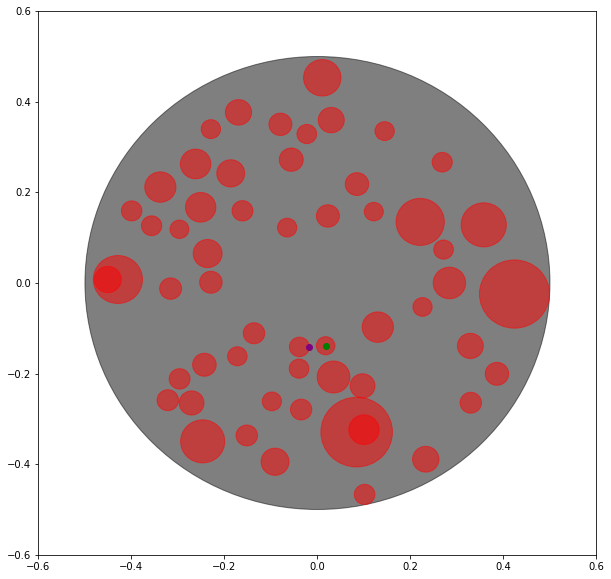

(0.4335285731483919, -0.17879622301477352) (0.41005327091392796, -0.19266772398384158) (<KDNode - (0.41005327091392796, -0.19266772398384158)>, 0.000743508354134283) 0.027267349598636883 0.0199119007769448


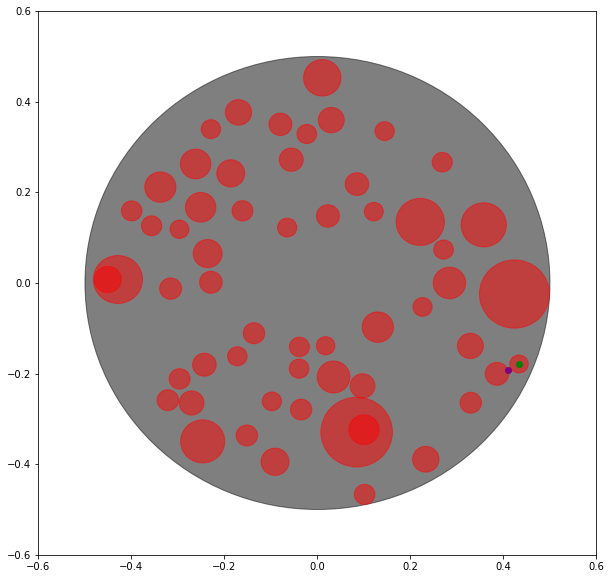

(0.3994473346050427, -0.11952169311522899) (0.40046364268909324, -0.09600934657661112) (<KDNode - (0.40046364268909324, -0.09600934657661112)>, 0.0005538633218737624) 0.023534300964204617 0.019889608472165865


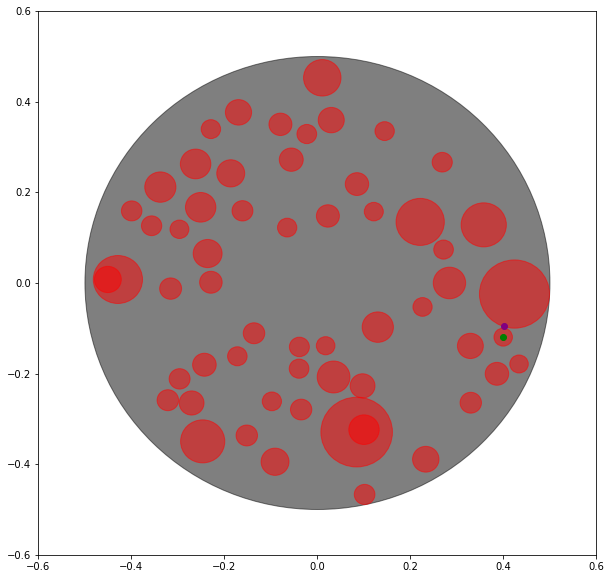

(0.16490652319447152, 0.2584112734730348) (0.15095241868817383, 0.3155141200826376) (<KDNode - (0.15095241868817383, 0.3155141200826376)>, 0.0034554521234925035) 0.05878309385777941 0.019879852554348616


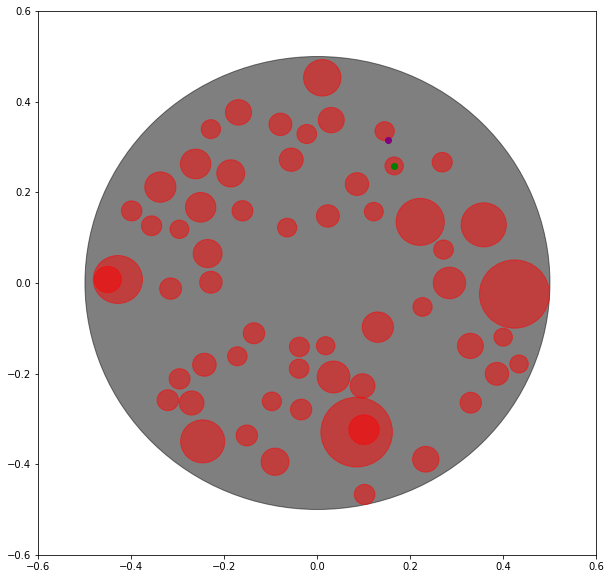

(-0.16893752158147368, 0.321739140675587) (-0.16979517965376045, 0.3485468227183135) (<KDNode - (-0.16979517965376045, 0.3485468227183135)>, 0.0007193873938728789) 0.026821398059625433 0.019641502317340267


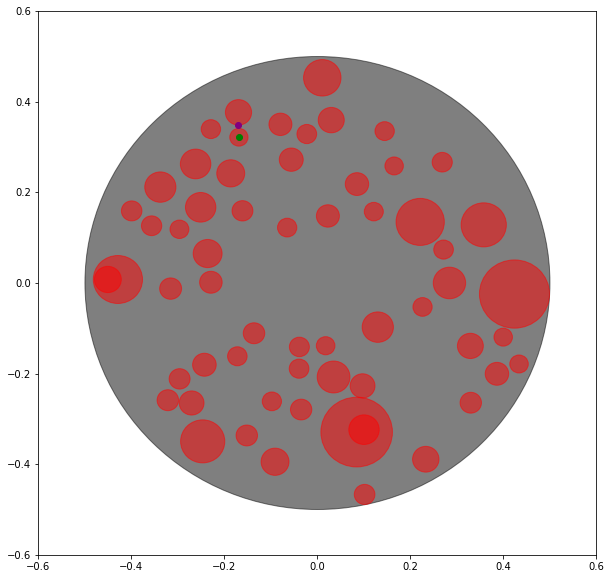

(0.0045169288059188385, -0.024972351211290274) (0.017617040696138068, -0.11844848981427919) (<KDNode - (0.017617040696138068, -0.11844848981427919)>, 0.00890940141966146) 0.0943896255933959 0.01963147649047795


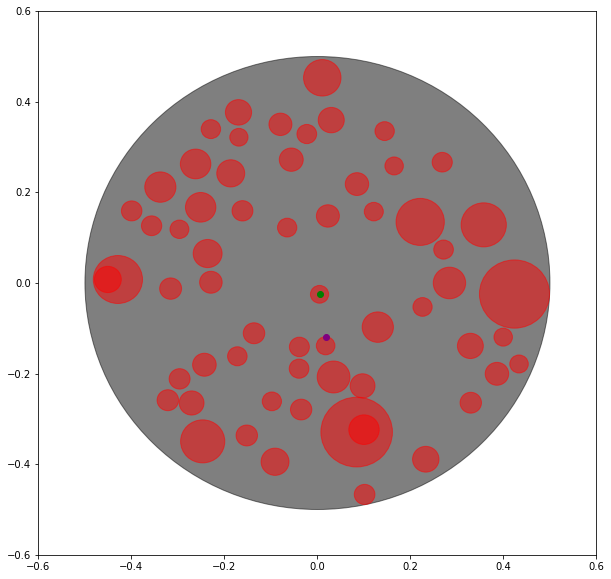

(0.17869729790682132, 0.38350465965236236) (0.1567577579666775, 0.35216758974549267) (<KDNode - (0.1567577579666775, 0.35216758974549267)>, 0.0014633553631332027) 0.03825382808469242 0.019612515050373078


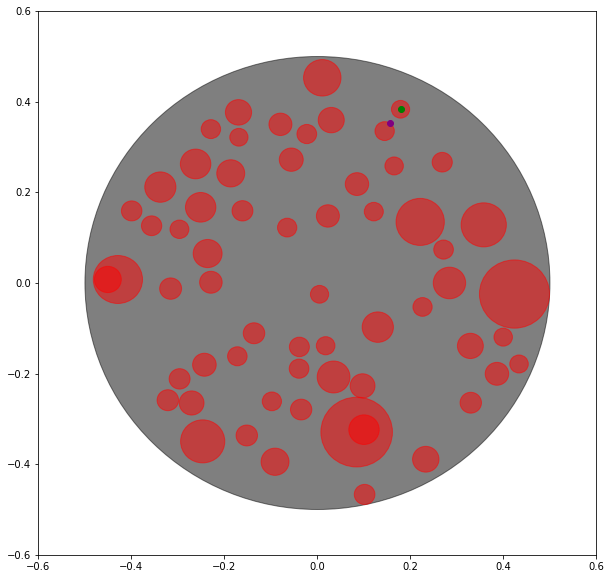

(-0.16615810665578934, -0.045359689396689065) (-0.1435727386820168, -0.08893140862026239) (<KDNode - (-0.1435727386820168, -0.08893140862026239)>, 0.002408593562608619) 0.049077424164361144 0.019523997782839832


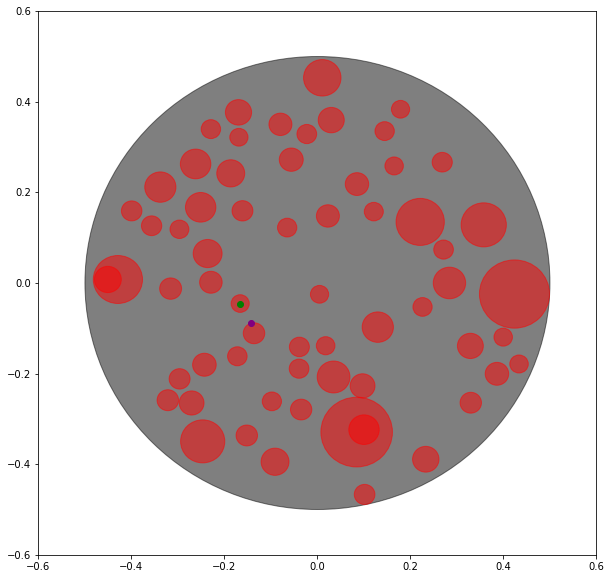

(-0.38371615159894573, 0.2470315872018312) (-0.36499461365330765, 0.23142914945636073) (<KDNode - (-0.36499461365330765, 0.23142914945636073)>, 0.0005939320466512478) 0.02437072109419924 0.019521245731201932


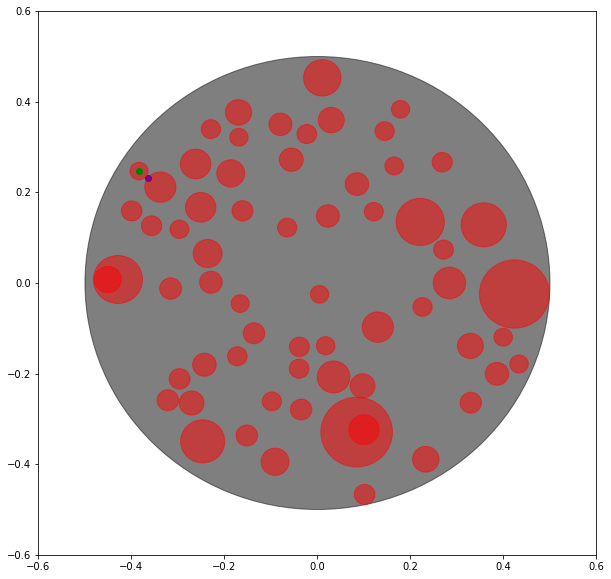

(0.09107832874590134, -0.1597141142772064) (0.06320211857457605, -0.18675754375274817) (<KDNode - (0.06320211857457605, -0.18675754375274817)>, 0.0015084301713145015) 0.03883851402042181 0.019506633701792418


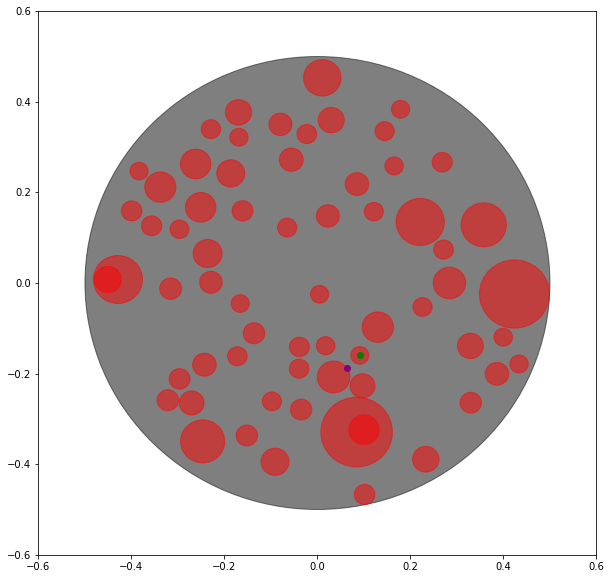

(-0.022812764626912042, 0.142698350689133) (-0.0022649957376769288, 0.14799486954051783) (<KDNode - (-0.0022649957376769288, 0.14799486954051783)>, 0.0004502639182684932) 0.021219423137033986 0.019405554332323976


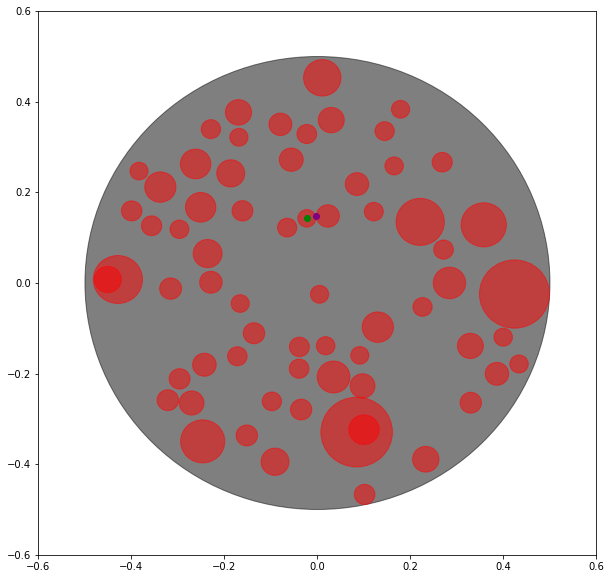

(-0.12716500527292274, 0.0328794177790517) (-0.16012485954275305, -0.02679126408118711) (<KDNode - (-0.16012485954275305, -0.02679126408118711)>, 0.004646942267154284) 0.0681684844129183 0.01934536141276056


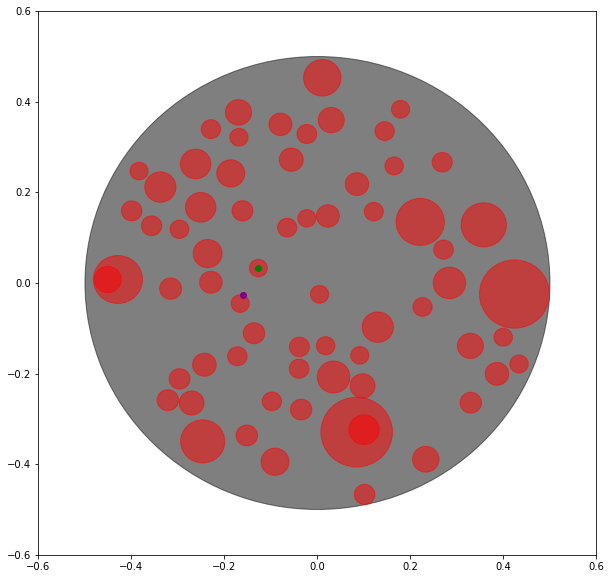

(-0.306374985309924, 0.3148233824166727) (-0.28130229464738715, 0.2893292757407024) (<KDNode - (-0.28130229464738715, 0.2893292757407024)>, 0.0012785892922650166) 0.03575736696493488 0.019330854664402024


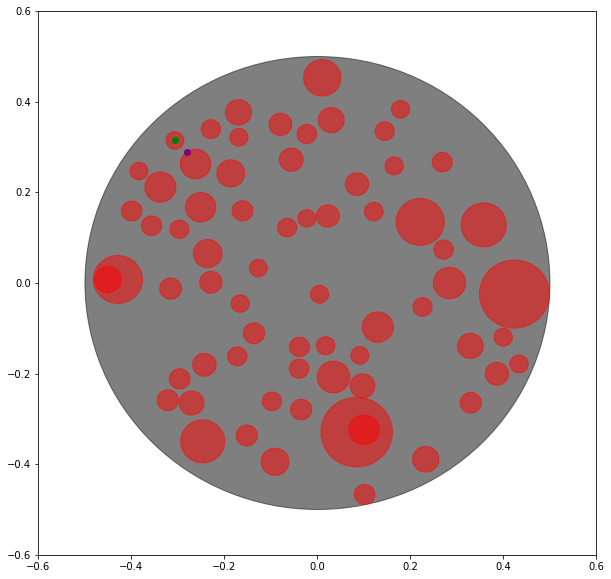

(0.39786981215723916, -0.06195011474181323) (0.37946424325307127, -0.08530961813985895) (<KDNode - (0.37946424325307127, -0.08530961813985895)>, 0.0008844313656893814) 0.02973939080898231 0.019275356690700893


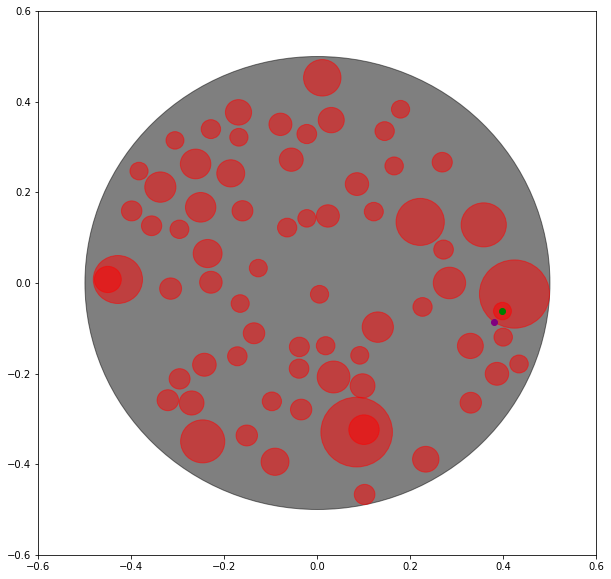

(0.2954442983807901, -0.21692077088085884) (0.3161894951719185, -0.24566641114474924) (<KDNode - (0.3161894951719185, -0.24566641114474924)>, 0.0012566750240836412) 0.035449612467326655 0.019262719857009152


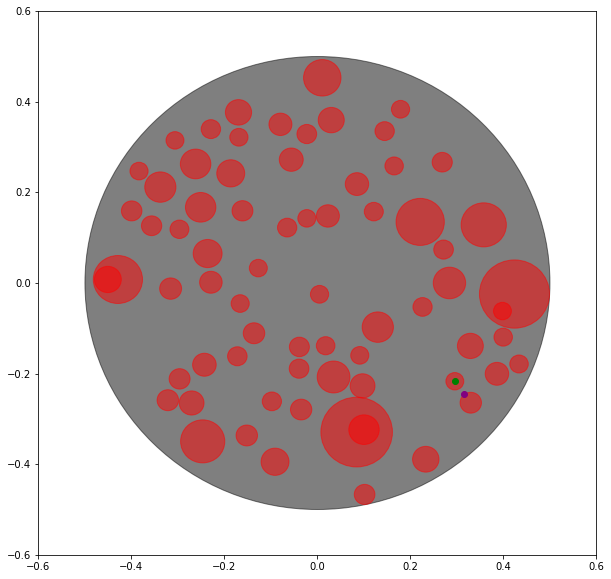

(-0.11232834832564405, -0.021874369434880272) (-0.12118695983405439, 0.01448088574736095) (<KDNode - (-0.12118695983405439, 0.01448088574736095)>, 0.0014001795772228176) 0.03741897349237172 0.01914498523270453


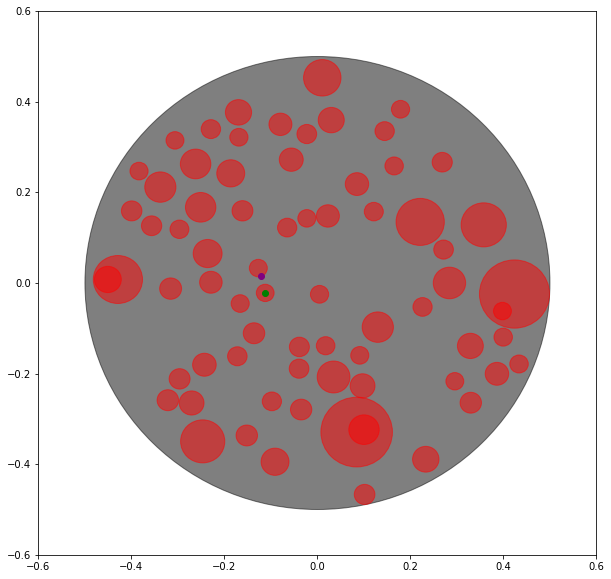

(0.2568736783215244, -0.18569876483251202) (0.27986043065858596, -0.20559842822986749) (<KDNode - (0.27986043065858596, -0.20559842822986749)>, 0.0009243873863334532) 0.03040373967678077 0.019012246414009715


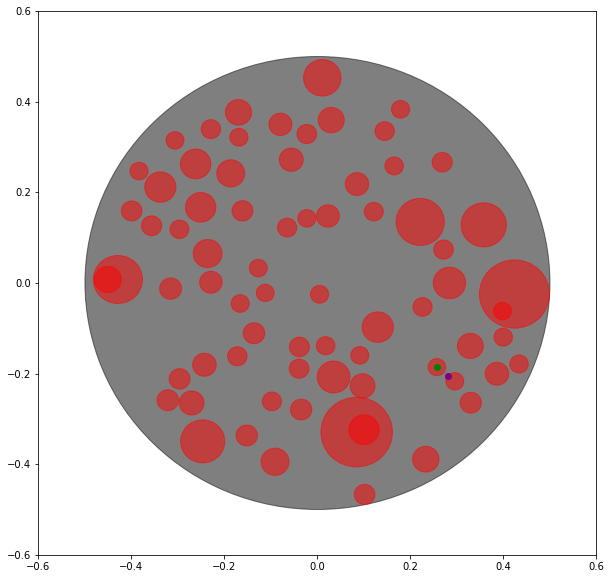

(0.41326086760768094, 0.08619648091445009) (0.3969783409028853, 0.09975988321156351) (<KDNode - (0.3969783409028853, 0.09975988321156351)>, 0.0004490865577657244) 0.021191662458753074 0.01890183568791073


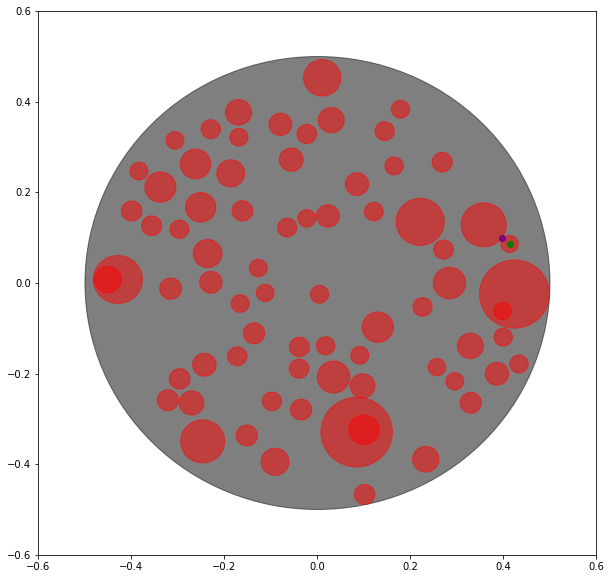

(-0.011503487258838516, 0.08119714476962697) (-0.016816118552957553, 0.12424257178905664) (<KDNode - (-0.016816118552957553, 0.12424257178905664)>, 0.0018811328385522981) 0.04337202829649886 0.01875225960055442


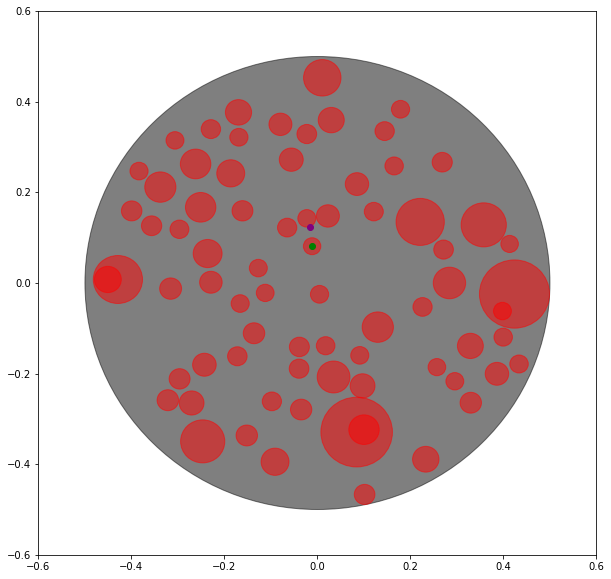

(0.04057824012004666, -0.03973373346848068) (0.023187572446683003, -0.031038811071520213) (<KDNode - (0.023187572446683003, -0.031038811071520213)>, 0.0003780369976145405) 0.019443173547920117 0.018747879565639232


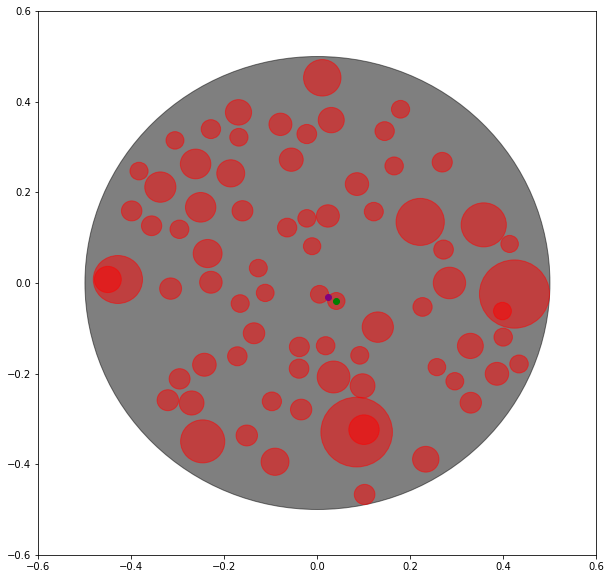

(-0.15743436949013537, -0.25813702932475846) (-0.11872962427035492, -0.2612588194086253) (<KDNode - (-0.11872962427035492, -0.2612588194086253)>, 0.0015078028758558463) 0.03883043749246004 0.018627818187685746


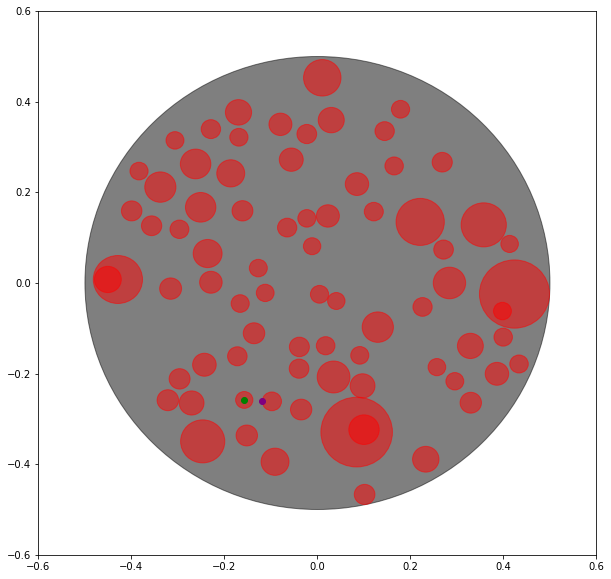

(0.23212621365733938, -0.008306882971245417) (0.25074392373278565, -0.010705779556600868) (<KDNode - (0.25074392373278565, -0.010705779556600868)>, 0.0003523738332806036) 0.018771623085940214 0.01805205181066474


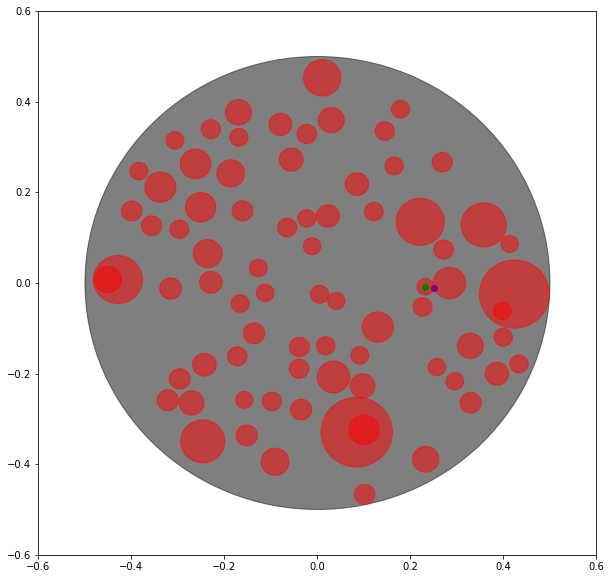

(0.10632898574946774, 0.0075676589557424475) (0.05574559329714361, -0.02871400634804252) (<KDNode - (0.05574559329714361, -0.02871400634804252)>, 0.003875038829201715) 0.062249809872815795 0.01799655526909821


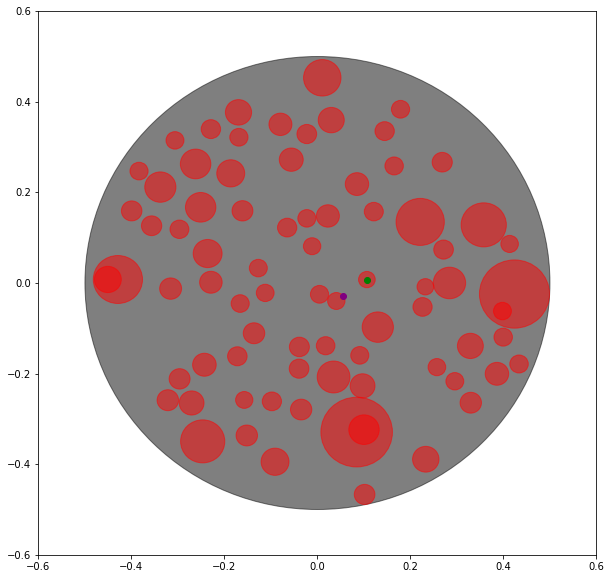

(0.38833686706924714, 0.267480045735808) (0.37265302504403447, 0.17462550736693683) (<KDNode - (0.37265302504403447, 0.17462550736693683)>, 0.008867948196368) 0.09416978388192256 0.01799626738707879


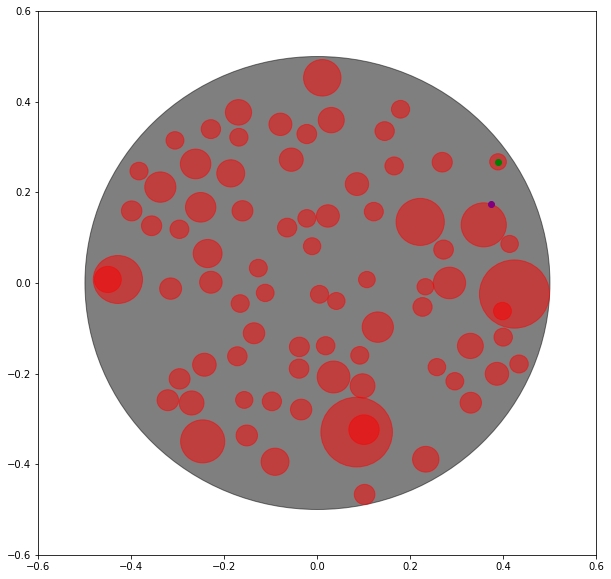

(0.0385112674134132, 0.26075001926961594) (0.06463099841734608, 0.23317594252851764) (<KDNode - (0.06463099841734608, 0.23317594252851764)>, 0.0014425700558417906) 0.03798118028500155 0.017895695999700638


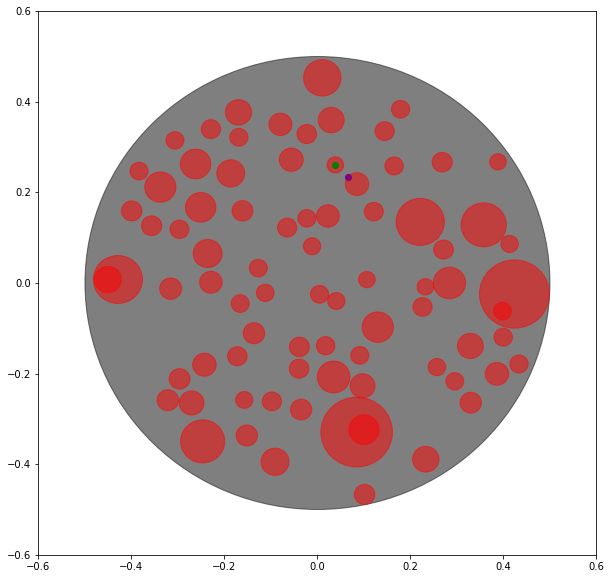

(-0.08669919425523115, 0.22381428654234817) (-0.07146611606361819, 0.25143819866830397) (<KDNode - (-0.07146611606361819, 0.25143819866830397)>, 0.0009951271923343222) 0.03154563666078595 0.017721836373969558


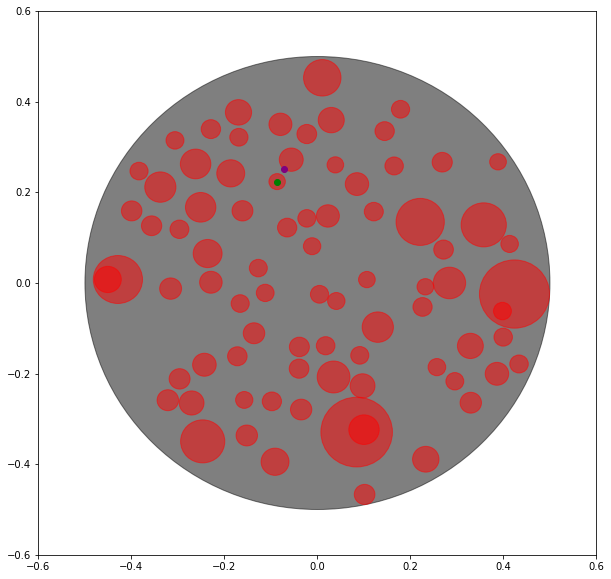

(-0.3424346926146337, -0.16950336872913563) (-0.3146751651356224, -0.19838545810375896) (<KDNode - (-0.3146751651356224, -0.19838545810375896)>, 0.0016047664525017154) 0.0400595363490607 0.01759933296885793


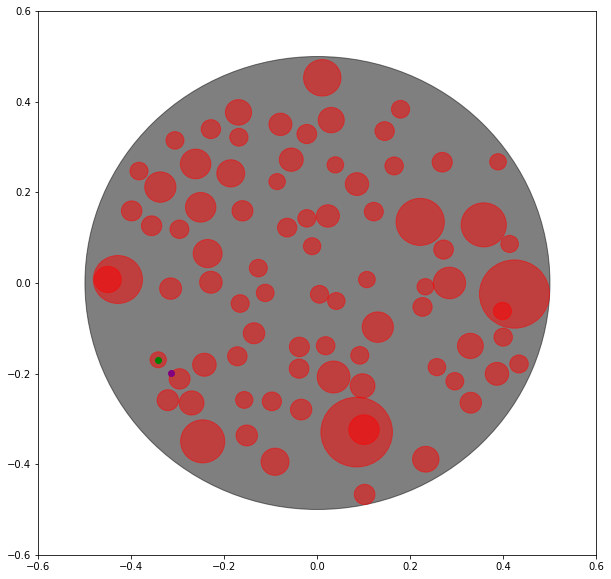

(0.24446935917610338, -0.12130229890089889) (0.2509985710783513, -0.16761704399105892) (<KDNode - (0.2509985710783513, -0.16761704399105892)>, 0.002187686220830959) 0.04677270807672952 0.017551207357068388


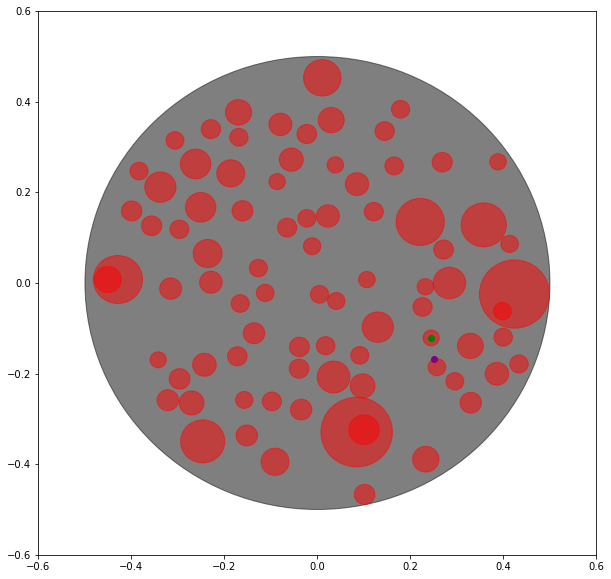

(0.04848417887643989, 0.004238456418974924) (0.04637165351432399, -0.021903440440862735) (<KDNode - (0.04637165351432399, -0.021903440440862735)>, 0.0006878615348359728) 0.0262271144969471 0.01743770820404138


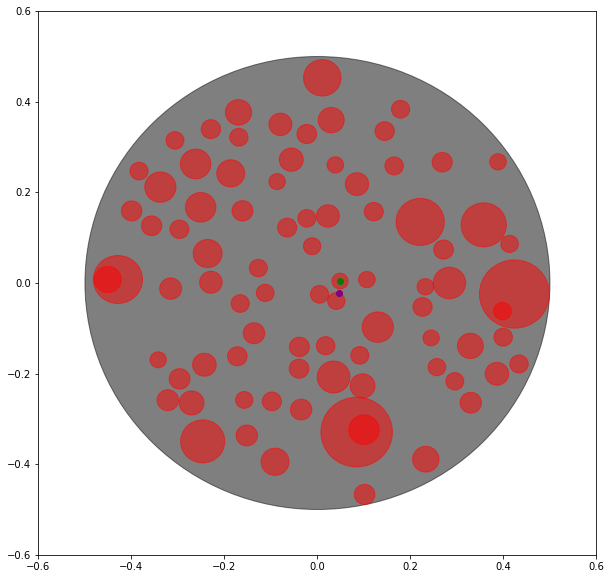

(0.23004608899808637, 0.034509555594870046) (0.23212621365733938, 0.009745168839419322) (<KDNode - (0.23212621365733938, 0.009745168839419322)>, 0.0006176017699715756) 0.024851594918064625 0.017433647286044008


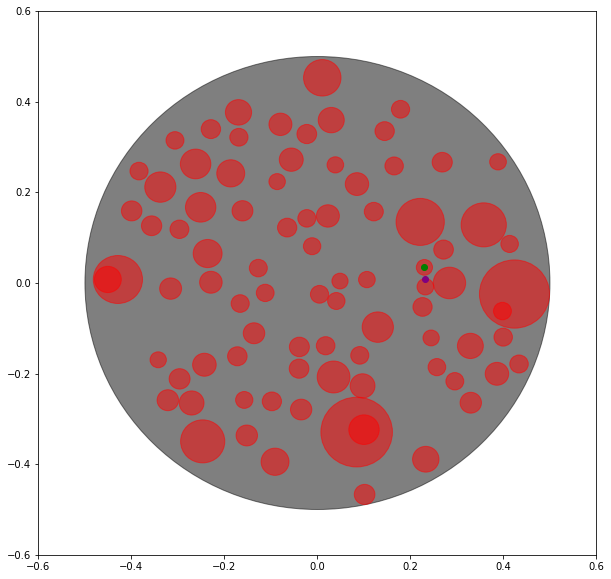

(0.26437340099917156, -0.27079906773538437) (0.3066986037797767, -0.2642933342975752) (<KDNode - (0.3066986037797767, -0.2642933342975752)>, 0.0018337473579831739) 0.04282227642224516 0.017262959718044108


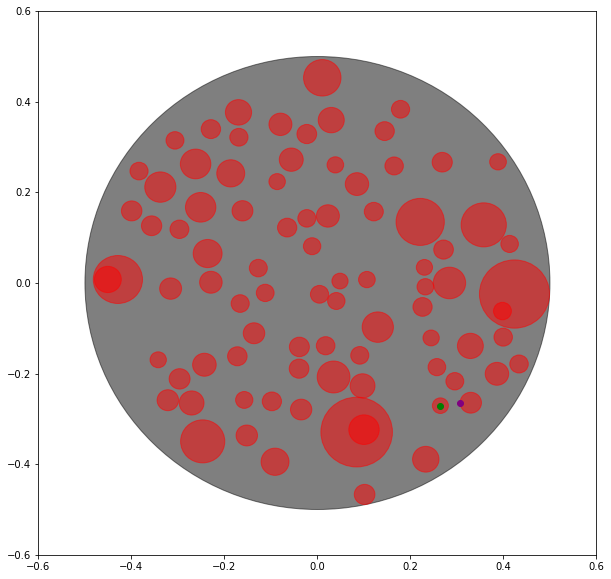

(-0.3129301687107178, -0.14125896612276936) (-0.3281965331531643, -0.15915874035985622) (<KDNode - (-0.3281965331531643, -0.15915874035985622)>, 0.0005534638010282732) 0.023525811378744692 0.01723839965116229


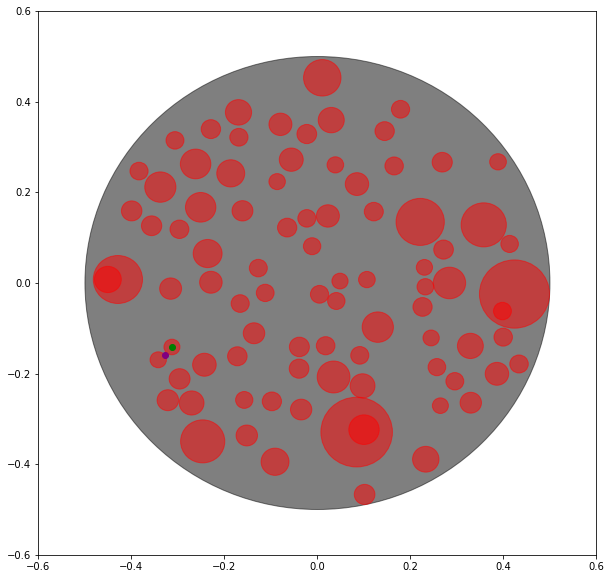

(0.2302520328049779, 0.2531882679691801) (0.24770742522545408, 0.2599505694703748) (<KDNode - (0.24770742522545408, 0.2599505694703748)>, 0.0003504194461458773) 0.018719493747050887 0.01715415366559924


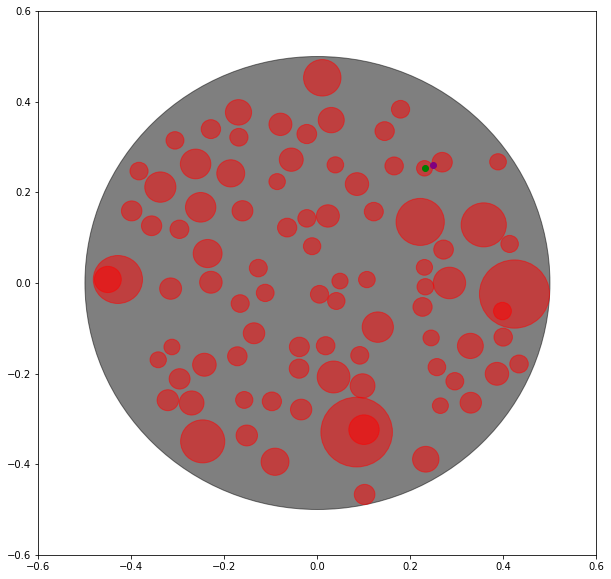

(0.3843319118938739, -0.28174086763268186) (0.35162000845796687, -0.27140818583612236) (<KDNode - (0.35162000845796687, -0.27140818583612236)>, 0.0011768329395090574) 0.03430499875395796 0.017129840859486455


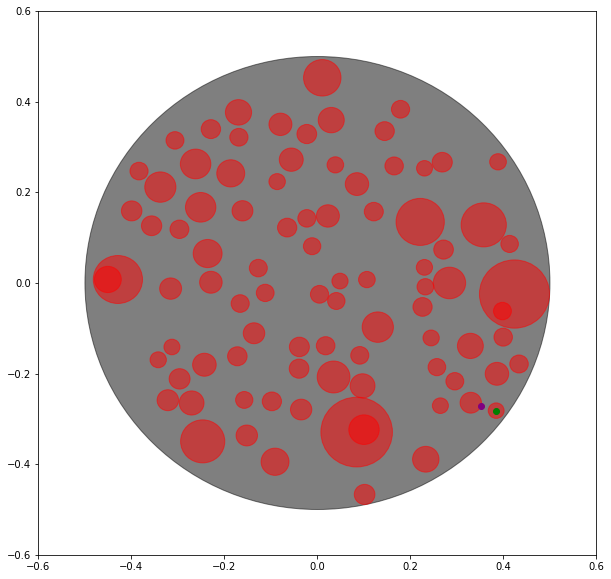

(0.2149394284999261, -0.10341743557593153) (0.23027013415243644, -0.11098595805648694) (<KDNode - (0.23027013415243644, -0.11098595805648694)>, 0.00029231306834258543) 0.01709716550608859 0.017018402468309032


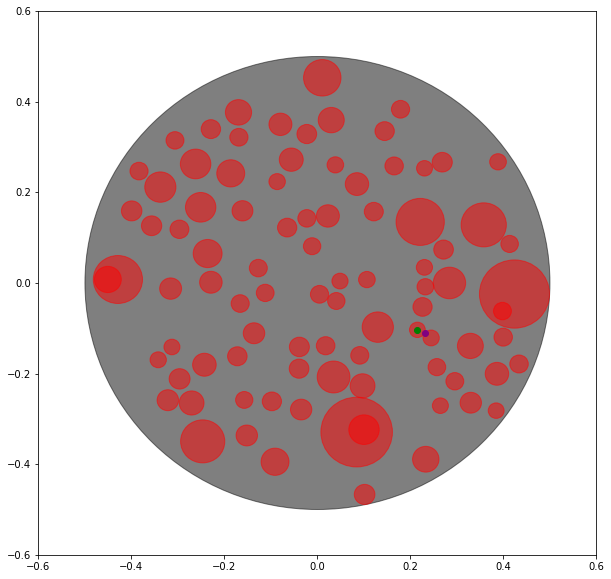

(-0.1618786209897269, 0.05355361828970554) (-0.14281573141817136, 0.04425033591774024) (<KDNode - (-0.14281573141817136, 0.04425033591774024)>, 0.00044994482170984174) 0.021211902830954175 0.016995182605802264


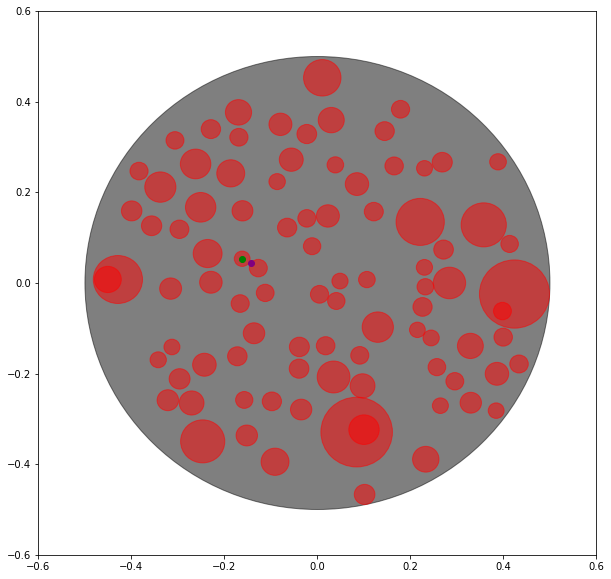

(0.02888871971122198, -0.3102534311778581) (0.011149816518738892, -0.30532149094492467) (<KDNode - (0.011149816518738892, -0.30532149094492467)>, 0.00033899272093351404) 0.018411754966149045 0.01692286023325006


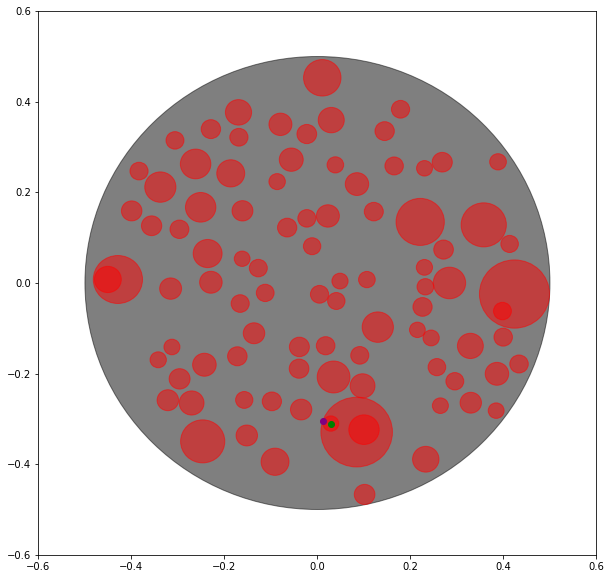

(-0.24583790741470368, 0.3842495491665406) (-0.23560474520163913, 0.35956106384922215) (<KDNode - (-0.23560474520163913, 0.35956106384922215)>, 0.00071423891614234) 0.026725248663807415 0.016866401420130236


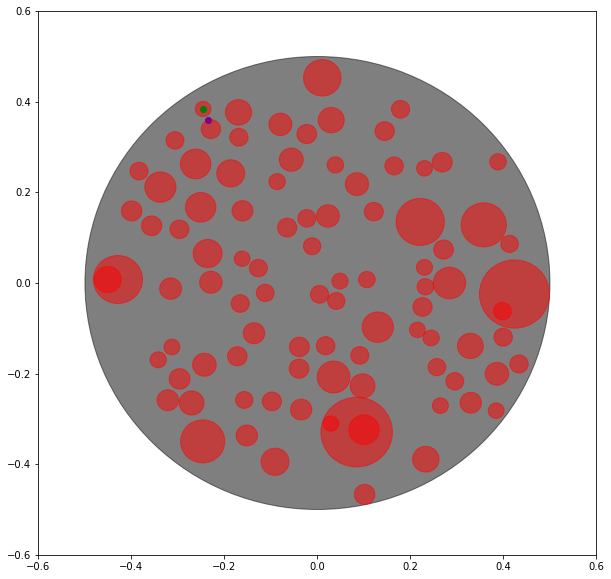

(0.0902680884286354, 0.0795161749997801) (0.10076774433110838, 0.024683400115284183) (<KDNode - (0.10076774433110838, 0.024683400115284183)>, 0.0031168759756041425) 0.05582898866721609 0.016765862136495183


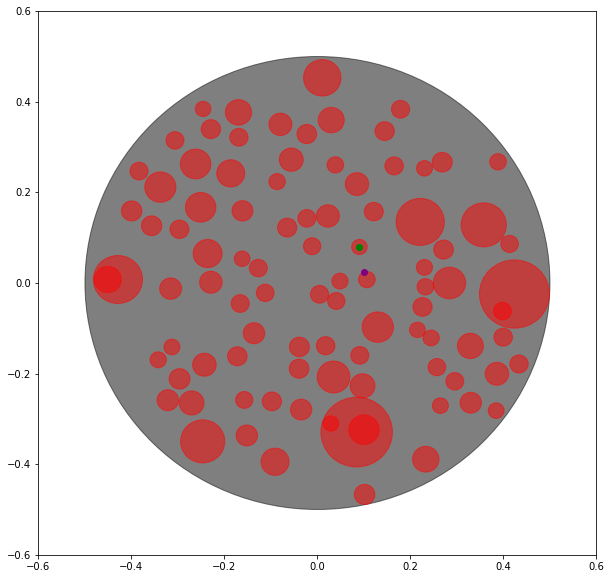

(0.24210973703614377, 0.37174373157196283) (0.1973499081464154, 0.37744405919936264) (<KDNode - (0.1973499081464154, 0.37744405919936264)>, 0.0020359360172974602) 0.04512134768928628 0.0167205708423353


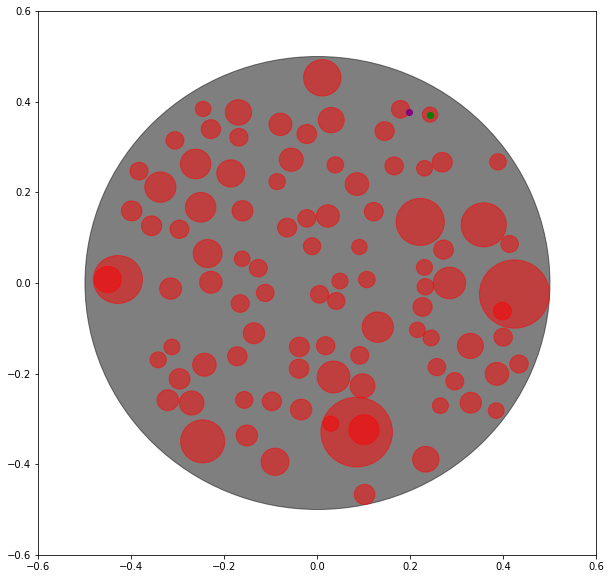

(-0.2542017713011526, -0.10032197987128866) (-0.2989840104371004, -0.13112648903469246) (<KDNode - (-0.2989840104371004, -0.13112648903469246)>, 0.0029543667268274393) 0.05435408656970918 0.016699418912541168


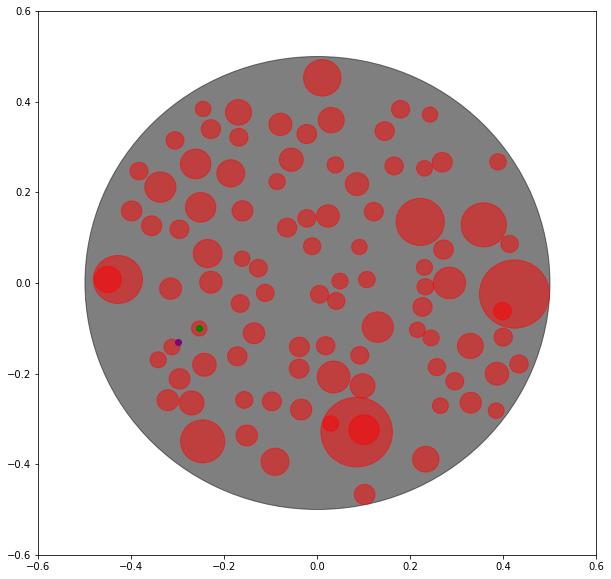

(-0.11539395619493885, 0.15171025437727254) (-0.1398528773002635, 0.15239516902179306) (<KDNode - (-0.1398528773002635, 0.15239516902179306)>, 0.0005987079297067741) 0.02446850893918087 0.01666035180055319


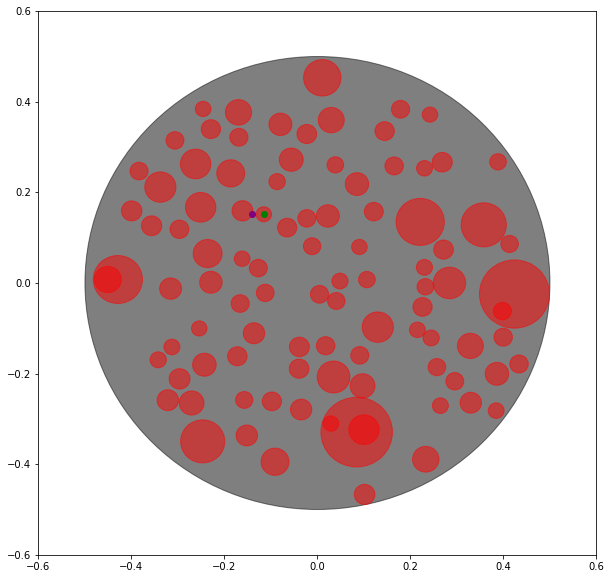

(-0.41758248700741185, 0.038558450168883845) (-0.427308937872131, 0.02479720786826559) (<KDNode - (-0.427308937872131, 0.02479720786826559)>, 0.00028397563608012065) 0.016851576664517795 0.016314230486099132


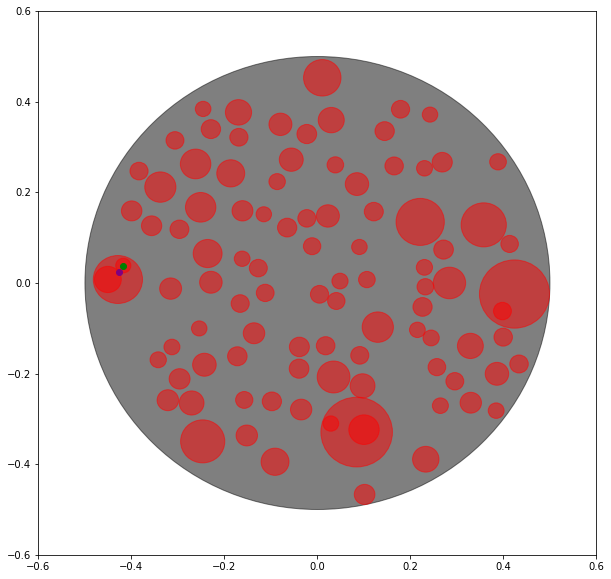

(-0.12157736223516702, 0.38284858683234296) (-0.1416305461020138, 0.37671145627006014) (<KDNode - (-0.1416305461020138, 0.37671145627006014)>, 0.0004397945547360703) 0.020971279282296307 0.01614033615270786


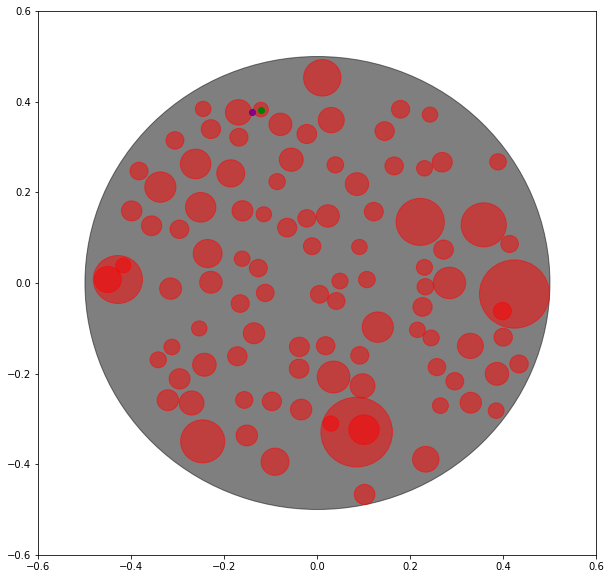

(0.06516179435515992, 0.18022203131180128) (0.07020311544174825, 0.19799498022575182) (<KDNode - (0.07020311544174825, 0.19799498022575182)>, 0.00034129263139597564) 0.018474107052736694 0.015843002415549343


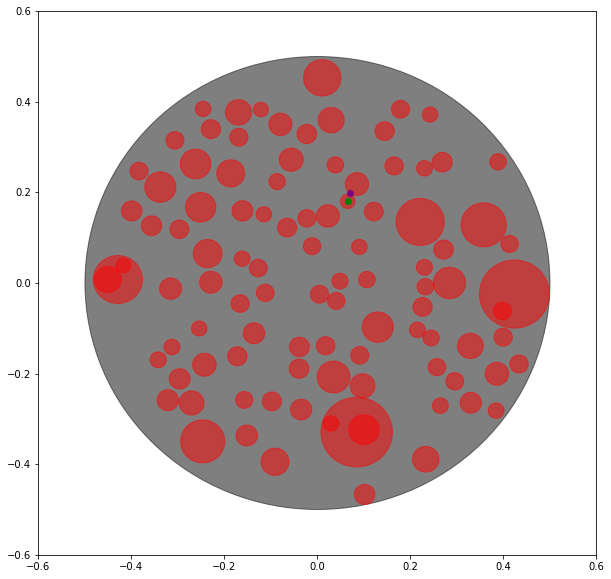

(0.0694683059203574, -0.37193294440966307) (0.0808909766059345, -0.3502249611952482) (<KDNode - (0.0808909766059345, -0.3502249611952482)>, 0.0006017139408284599) 0.024529858149375017 0.015830595345265406


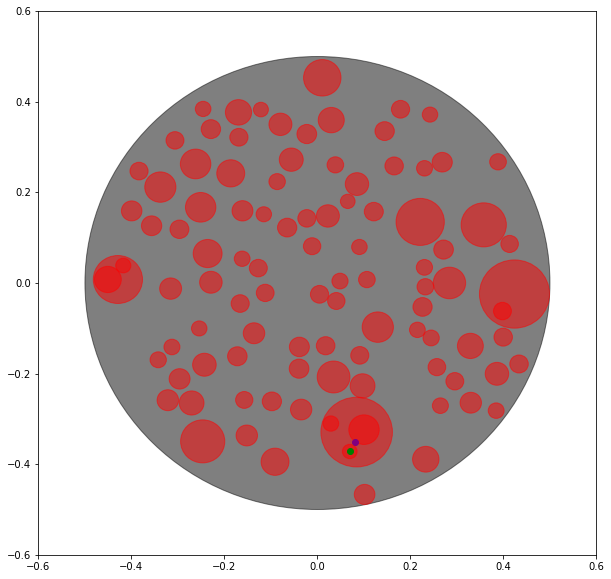

(0.3182790810528991, 0.29239068618126157) (0.28588531000972417, 0.2794031733758266) (<KDNode - (0.28588531000972417, 0.2794031733758266)>, 0.0012180318912689758) 0.034900313627086156 0.01565096069797036


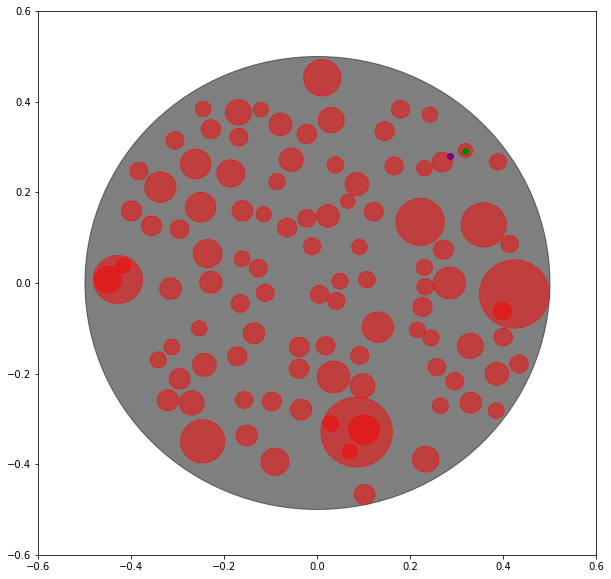

(-0.44881593929356783, -0.06797604366154139) (-0.4455306860368648, -0.042627573751964645) (<KDNode - (-0.4455306860368648, -0.042627573751964645)>, 0.0006533378157173956) 0.025560473699002443 0.01556606185359201


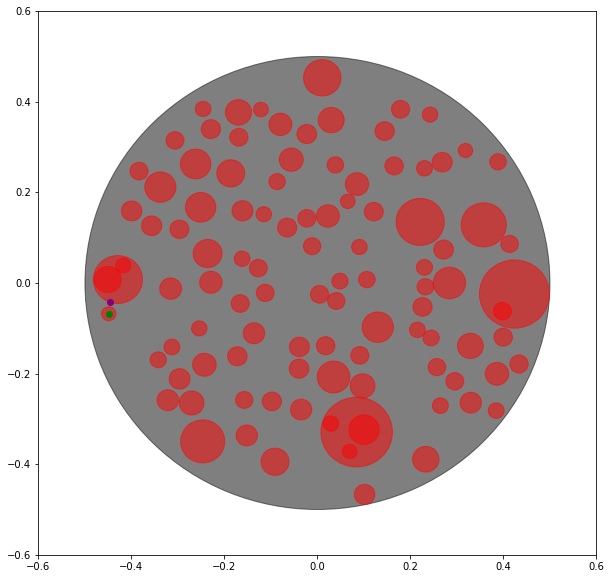

(0.20733175682888133, 0.4128434527496178) (0.19022524501379479, 0.3993715176305486) (<KDNode - (0.19022524501379479, 0.3993715176305486)>, 0.00047412578233210534) 0.021774429552392536 0.015497669248540222


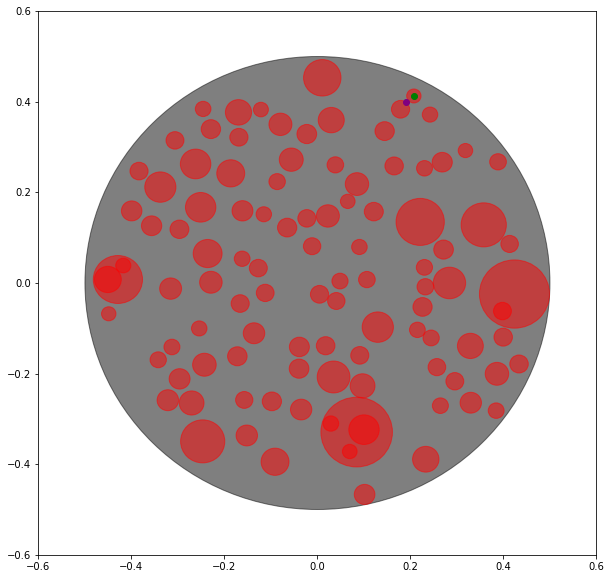

(-0.055482150012435096, -0.0757129661090152) (-0.04548934819005722, -0.12067725680493589) (<KDNode - (-0.04548934819005722, -0.12067725680493589)>, 0.0021216435260485783) 0.046061301827549105 0.015490659782185704


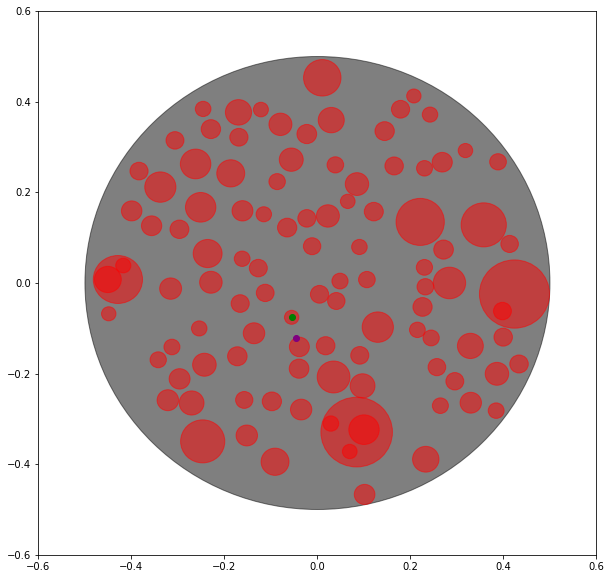

(-0.3701542153982721, 0.05545763774063154) (-0.38632126743319956, 0.03886719953572977) (<KDNode - (-0.38632126743319956, 0.03886719953572977)>, 0.0005366162113307164) 0.023164978120661293 0.015317512552165008


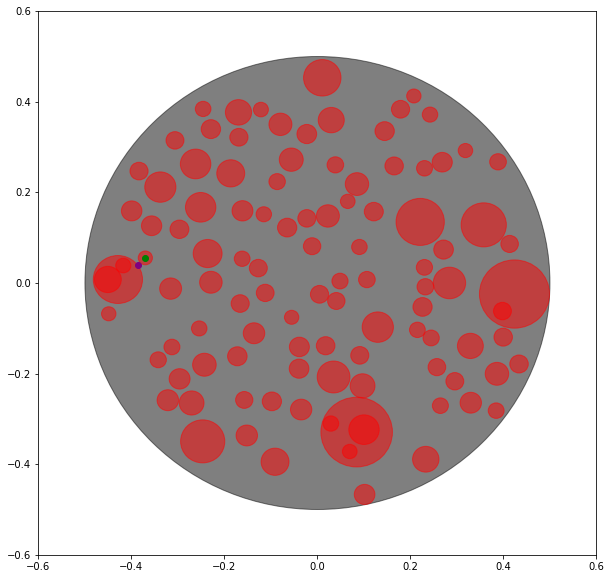

(0.23808570190599546, 0.32598735394097406) (0.24210973703614377, 0.35502316072962753) (<KDNode - (0.24210973703614377, 0.35502316072962753)>, 0.0008592709345966829) 0.029313323499676438 0.015245211222028663


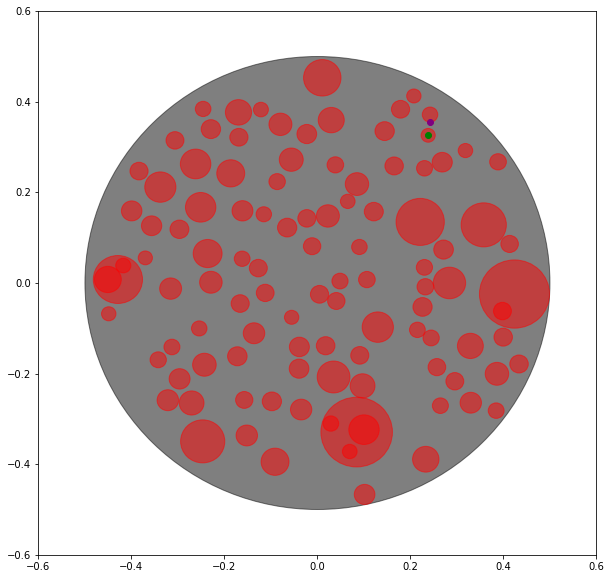

(-0.3784855835706945, -0.09035170001742594) (-0.43401173473465576, -0.07278622130979293) (<KDNode - (-0.43401173473465576, -0.07278622130979293)>, 0.003391699505311385) 0.058238299299613695 0.01522270262030893


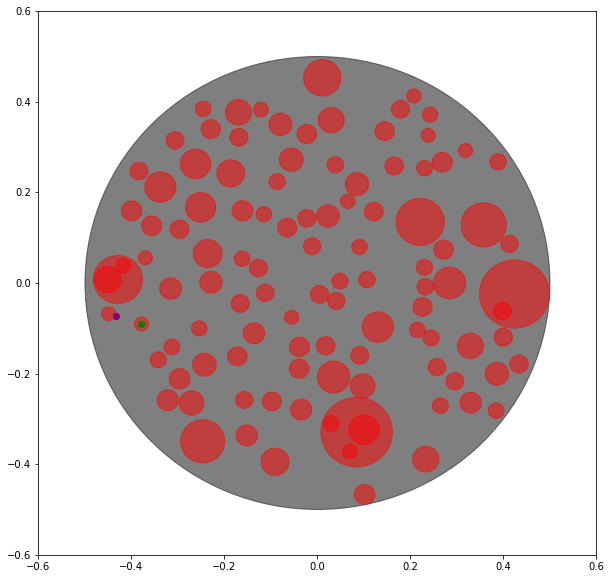

(0.32458253565198486, 0.3570214849038737) (0.3182790810528991, 0.3080416468792319) (<KDNode - (0.3182790810528991, 0.3080416468792319)>, 0.002438758072802881) 0.04938378350028358 0.015045196866379264


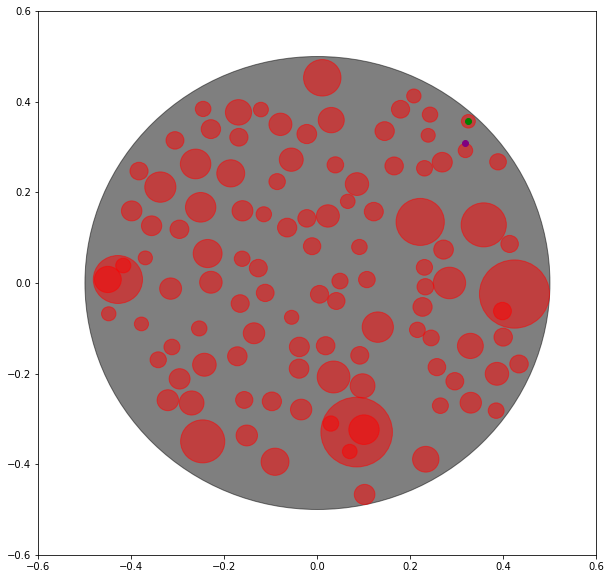

(0.20081344962914394, -0.43928371772753677) (0.2162400677222793, -0.41205820781726976) (<KDNode - (0.2162400677222793, -0.41205820781726976)>, 0.0009792089356654985) 0.0312923143226176 0.014978756030437726


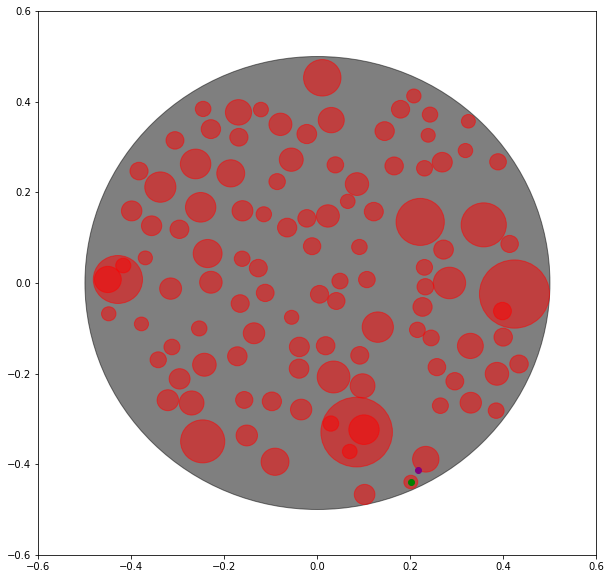

(0.4106957730301442, 0.1900225943572954) (0.38621527689456525, 0.16771519489663847) (<KDNode - (0.38621527689456525, 0.16771519489663847)>, 0.0010969147617414135) 0.03311970352737798 0.014950610873335771


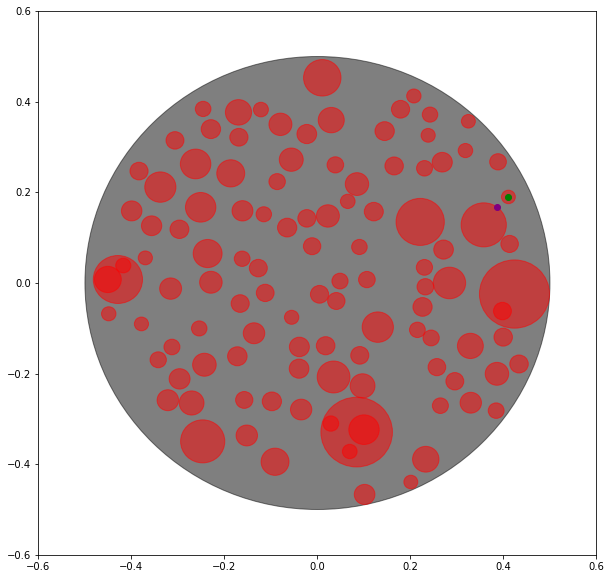

(-0.11160142755043805, -0.464886558060286) (-0.1004656619690047, -0.4231758940061176) (<KDNode - (-0.1004656619690047, -0.4231758940061176)>, 0.0018637847709243316) 0.04317157364428973 0.014941855204792133


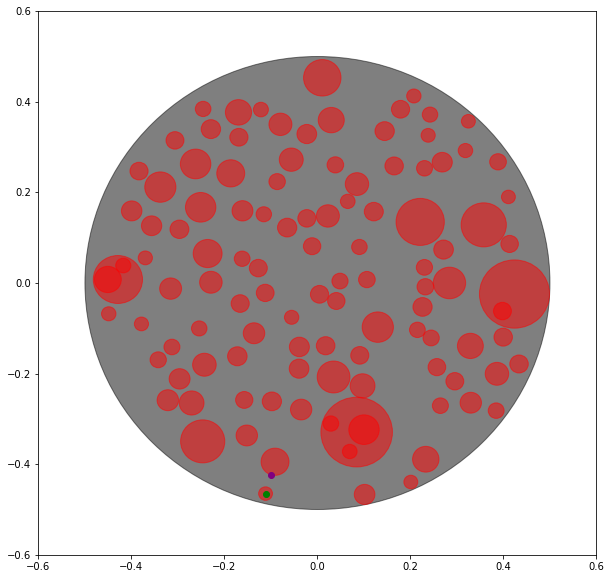

(0.017806990302621045, -0.45293900047762337) (0.0802761434833307, -0.45990815859181006) (<KDNode - (0.0802761434833307, -0.45990815859181006)>, 0.0039509642639355014) 0.06285669625374453 0.014930909824518116


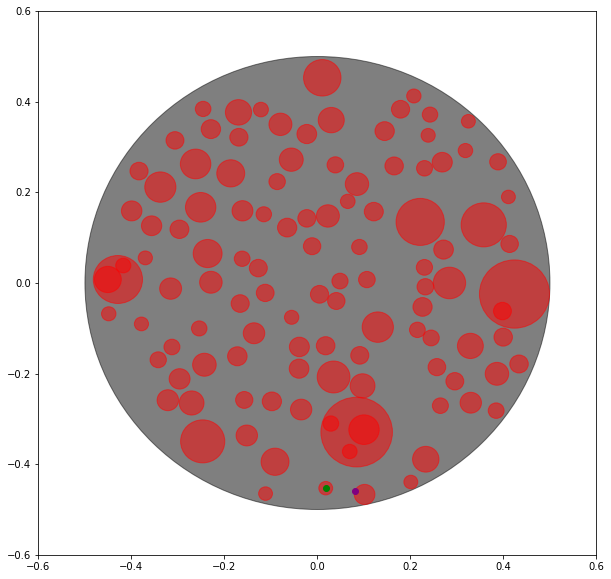

(0.18631105994453298, -0.31325250647228237) (0.16127596592343277, -0.3290991370964648) (<KDNode - (0.16127596592343277, -0.3290991370964648)>, 0.0008778716347846049) 0.029628898642788004 0.014825179700846444


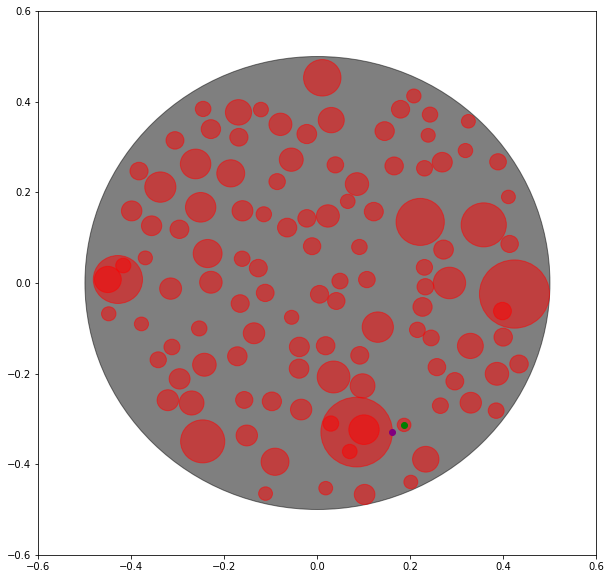

(-0.2418652740090758, -0.3449476340517657) (-0.20834317171398373, -0.321690302366456) (<KDNode - (-0.20834317171398373, -0.321690302366456)>, 0.0016646348194031264) 0.04079993651224382 0.014822914493560681


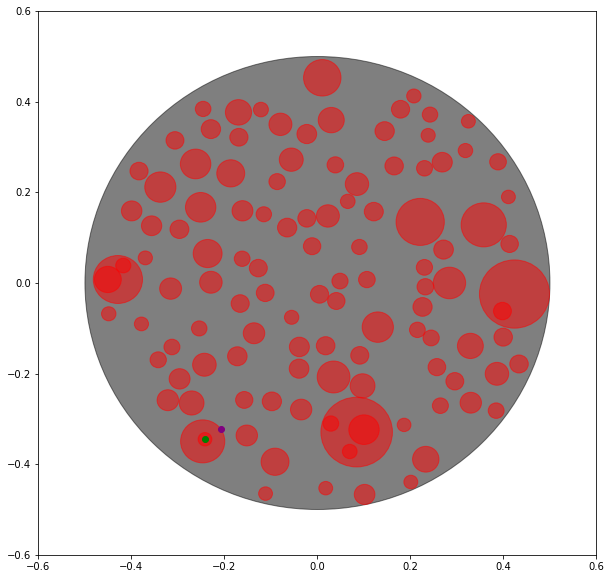

(0.15722584953814786, -0.45323054711275385) (0.1865678061004008, -0.44391240789553826) (<KDNode - (0.1865678061004008, -0.44391240789553826)>, 0.0009477781333725494) 0.030786005479317213 0.014821969476197261


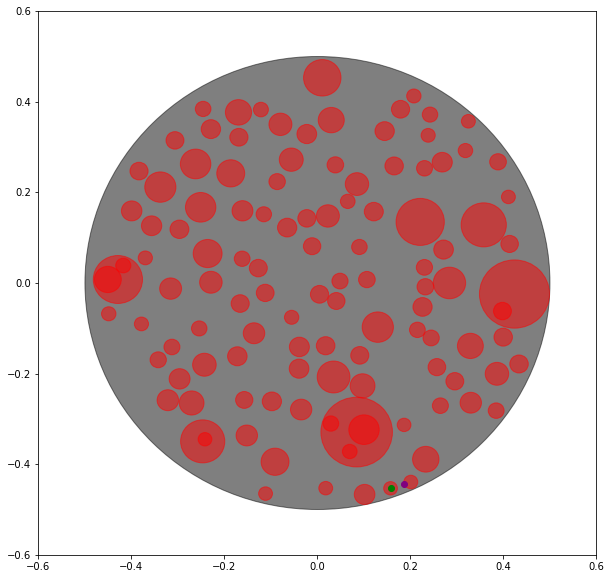

(0.1942908002689994, 0.0742788068208361) (0.2049024763548004, 0.0854972649774809) (<KDNode - (0.2049024763548004, 0.0854972649774809)>, 0.0002384614727623517) 0.015442197795726868 0.014806931709002847


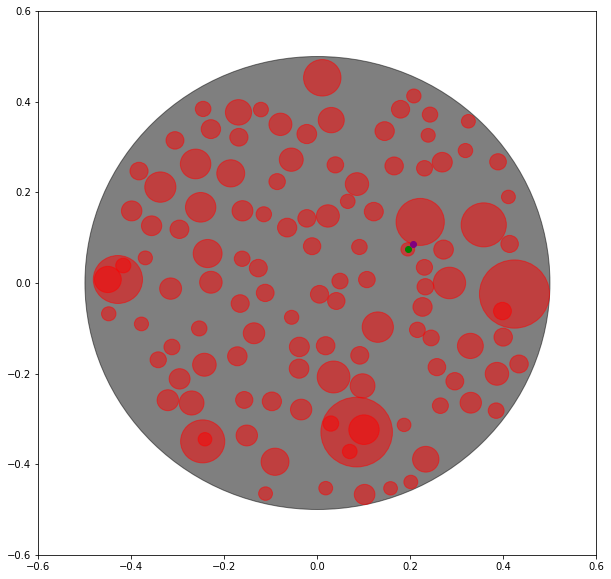

(0.09054132646122089, -0.22670639708502366) (0.07028117850813448, -0.22711514905903912) (<KDNode - (0.07028117850813448, -0.22711514905903912)>, 0.00041064067325721293) 0.02026427085431926 0.014666450609282726


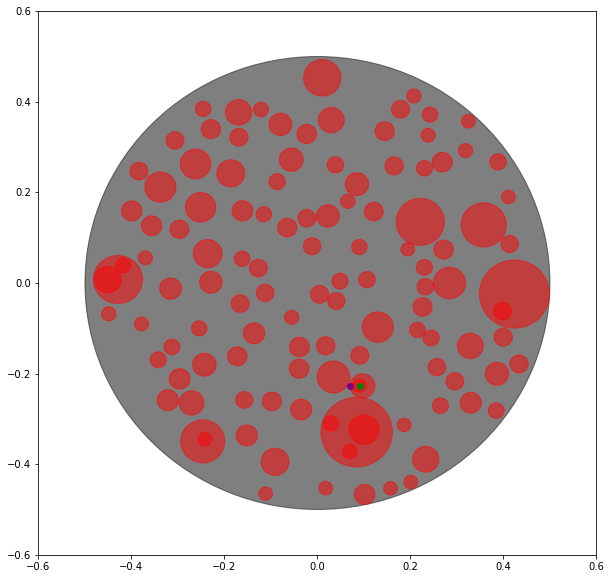

(-0.0745722495802358, 0.47293640160007466) (-0.027944038631724955, 0.46544755223396417) (<KDNode - (-0.027944038631724955, 0.46544755223396417)>, 0.00223027292108712) 0.047225765436752 0.014654959119053936


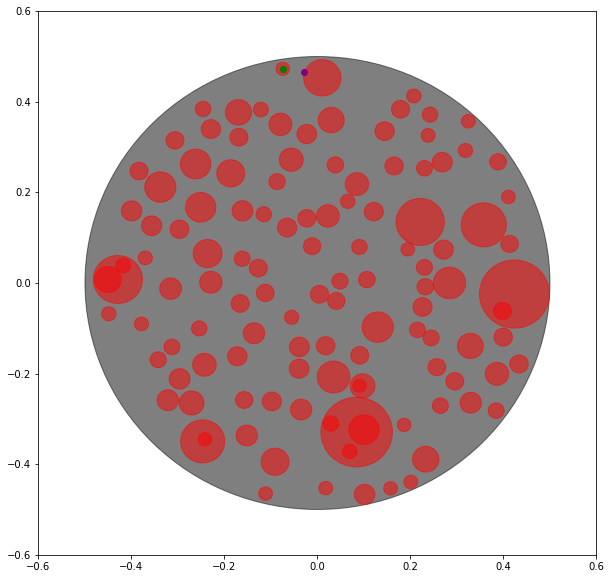

(-0.36970856610490294, -0.24239223507907945) (-0.3437520418668534, -0.2515614328114121) (<KDNode - (-0.3437520418668534, -0.2515614328114121)>, 0.0007578153375750682) 0.027528445970941916 0.014564176428641202


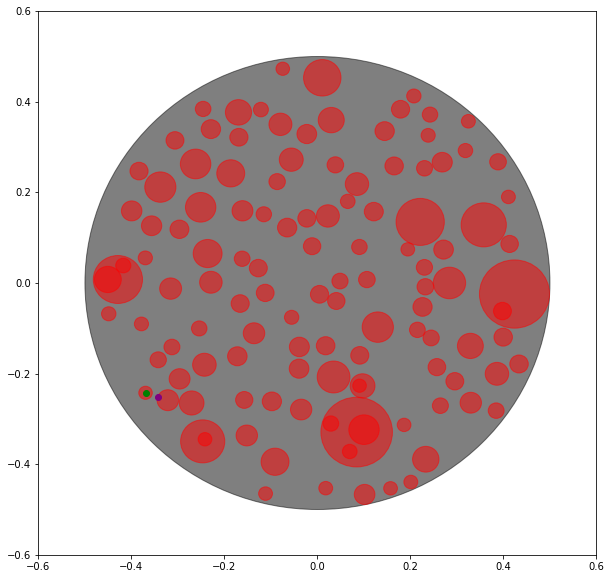

(-0.44656293712923045, 0.1698695323545806) (-0.42052214203329796, 0.16599814889804734) (<KDNode - (-0.42052214203329796, 0.16599814889804734)>, 0.000693110619095861) 0.026326994114327998 0.01455491145387627


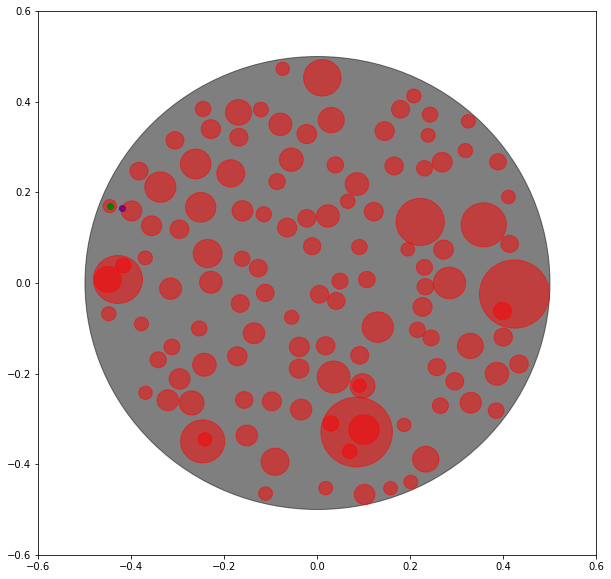

(0.11562656999098771, 0.29609117572075966) (0.13227654308267717, 0.3184720881879848) (<KDNode - (0.13227654308267717, 0.3184720881879848)>, 0.000778126846819576) 0.02789492510869273 0.01450708262809631


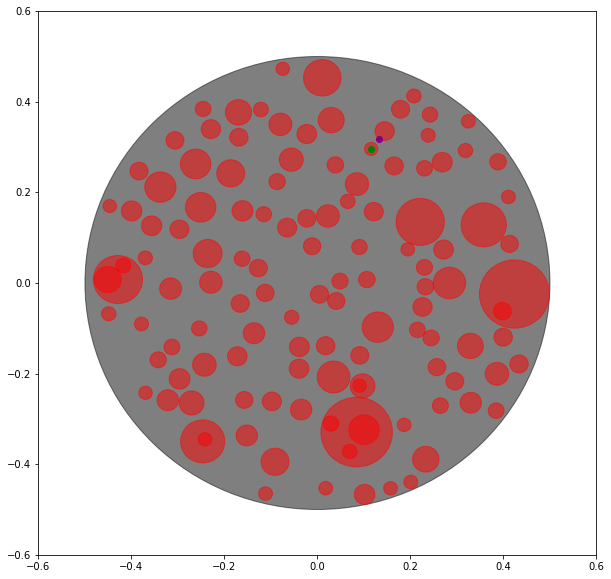

(-0.18944126885689913, 0.10410241689603696) (-0.21100174721053572, 0.08331202440232918) (<KDNode - (-0.21100174721053572, 0.08331202440232918)>, 0.0008970946468800523) 0.02995153830573736 0.014503312484436814


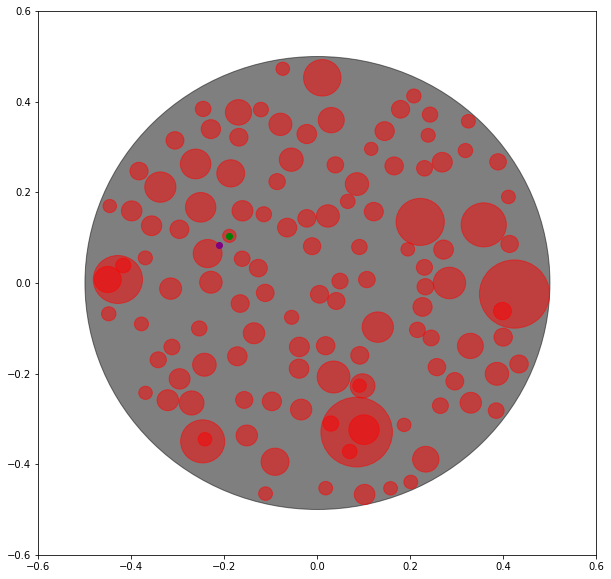

(0.270617624170737, 0.3432888335712064) (0.2504193368674523, 0.3349482642653662) (<KDNode - (0.2504193368674523, 0.3349482642653662)>, 0.00047753590633155306) 0.021852594956470343 0.014423911831405792


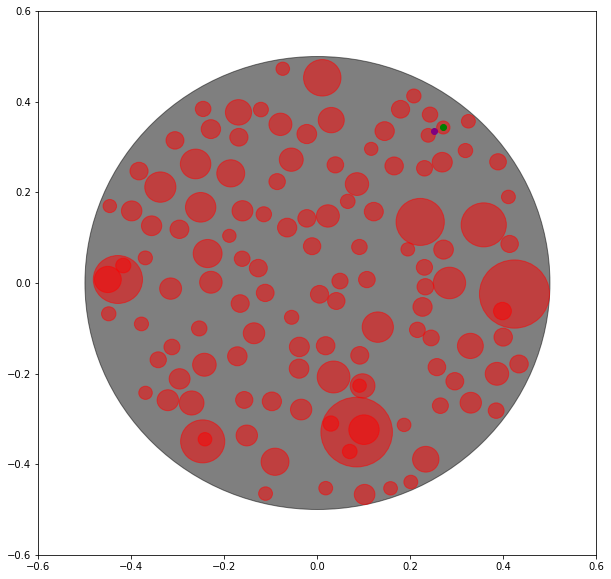

(0.35805618570130215, -0.3255677076489522) (0.37426324406255074, -0.29559919999894474) (<KDNode - (0.37426324406255074, -0.29559919999894474)>, 0.0011607801914934738) 0.03407022441213844 0.01436292109261192


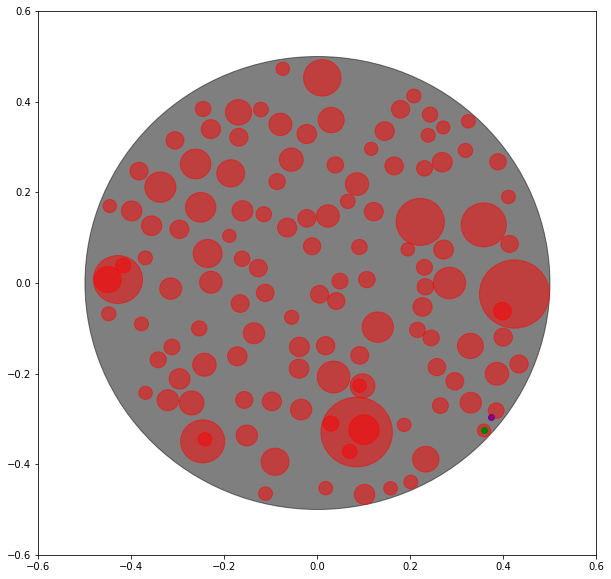

(-0.04423246166337411, -0.3844798169117346) (-0.0626050383995872, -0.38531527043670016) (<KDNode - (-0.0626050383995872, -0.38531527043670016)>, 0.0003382495585204156) 0.018391562155521634 0.014352683980000218


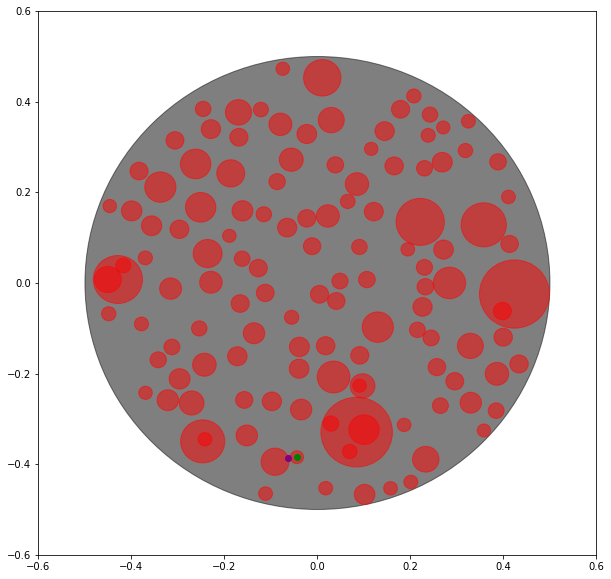

(0.33277029471578656, -0.03278986822390985) (0.3484124219115957, -0.024366987360009956) (<KDNode - (0.3484124219115957, -0.024366987360009956)>, 0.0003156210652573233) 0.017765727265083277 0.014303763128172137


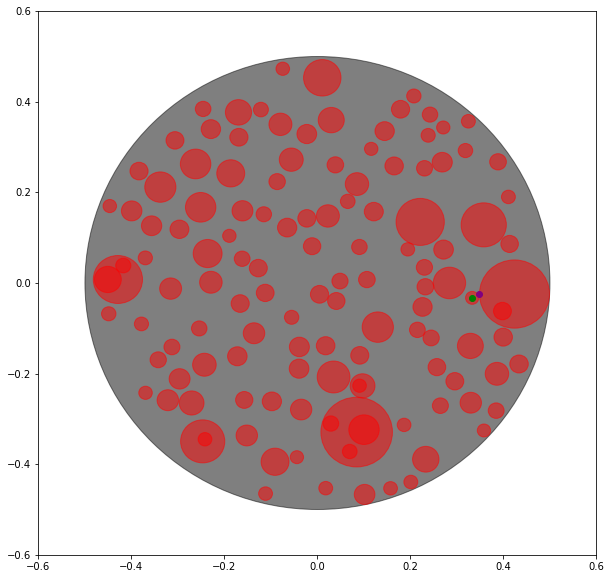

(0.2928443608122161, 0.16150079161542635) (0.27032001596163446, 0.15091480458431494) (<KDNode - (0.27032001596163446, 0.15091480458431494)>, 0.0006194092323707824) 0.024887933469269447 0.01430193858986734


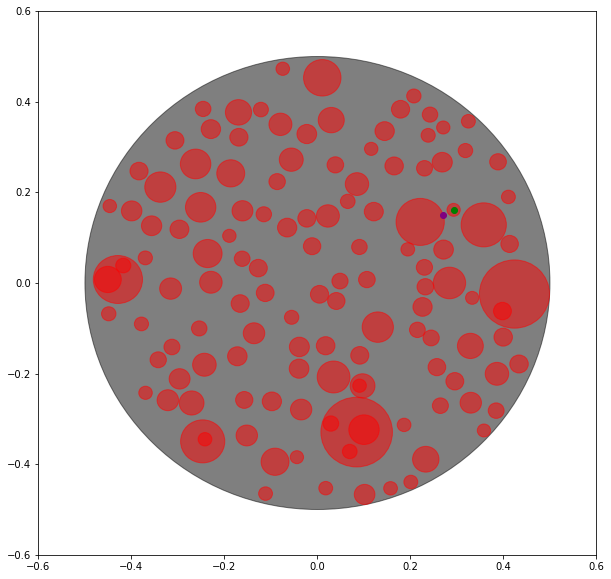

(-0.0848089283606923, -0.04238733996549536) (-0.09683972991532867, -0.033127509410021176) (<KDNode - (-0.09683972991532867, -0.033127509410021176)>, 0.00023048464796313428) 0.01518172084986199 0.014274394663967809


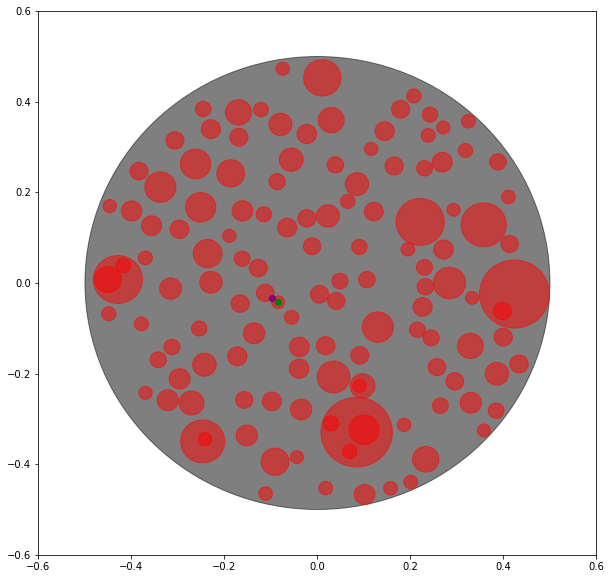

(-0.05066214941929562, -0.4389032580180692) (-0.07352001793334301, -0.4189081232563452) (<KDNode - (-0.07352001793334301, -0.4189081232563452)>, 0.0009222875671449817) 0.030369187791987155 0.014246406894311515


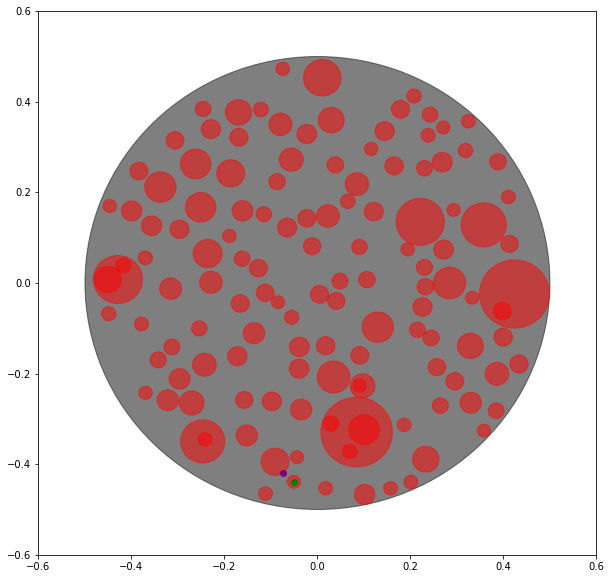

(-0.25611430592588147, 0.15999409763034006) (-0.2703842105278671, 0.1406336988776162) (<KDNode - (-0.2703842105278671, 0.1406336988776162)>, 0.0005784552172142421) 0.024051095967008284 0.014183016022154058


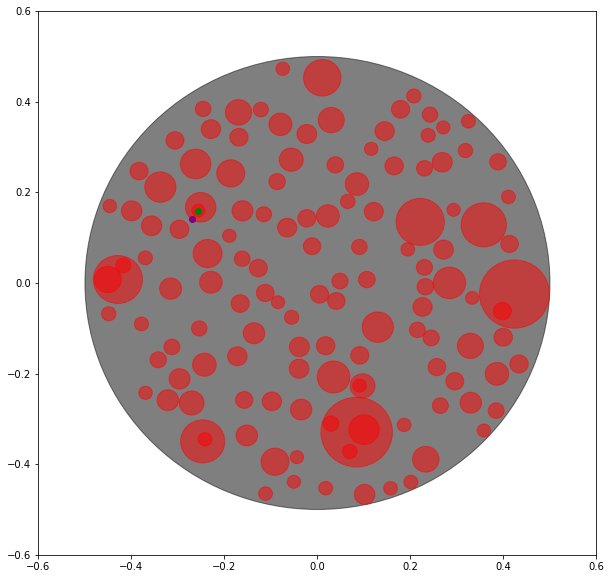

(0.03718215016950786, -0.07951387038558601) (0.04057824012004666, -0.05848161303411991) (<KDNode - (0.04057824012004666, -0.05848161303411991)>, 0.0004538892762504503) 0.021304677332699744 0.014182326022561802


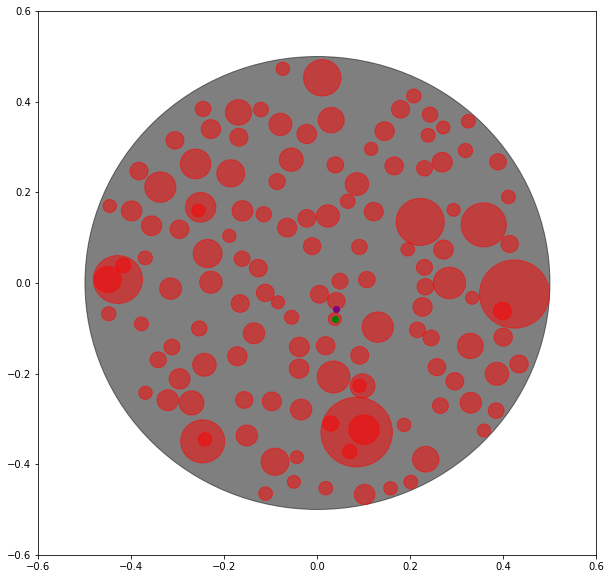

(-0.4477543048691728, -0.13387150613850843) (-0.44881593929356783, -0.0835421055151334) (<KDNode - (-0.44881593929356783, -0.0835421055151334)>, 0.0025341756347592435) 0.05034059628926979 0.01416410329499719


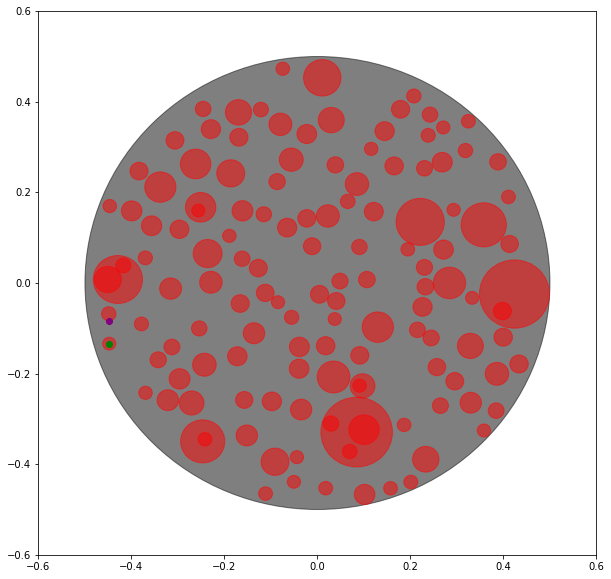

(-0.3004987674121734, 0.11745032066373588) (-0.31614343415878343, 0.1123065935241495) (<KDNode - (-0.31614343415878343, 0.1123065935241495)>, 0.00027121352649900305) 0.016468561761702298 0.014163642684765816


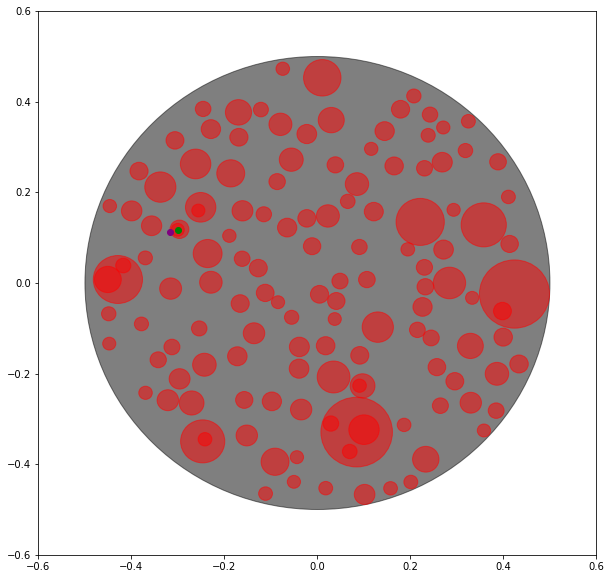

(-0.00030713418480622054, 0.23711359719543557) (0.024033345223487622, 0.2502311930814825) (<KDNode - (0.024033345223487622, 0.2502311930814825)>, 0.0007645302596552122) 0.02765014031890638 0.014099035948810321


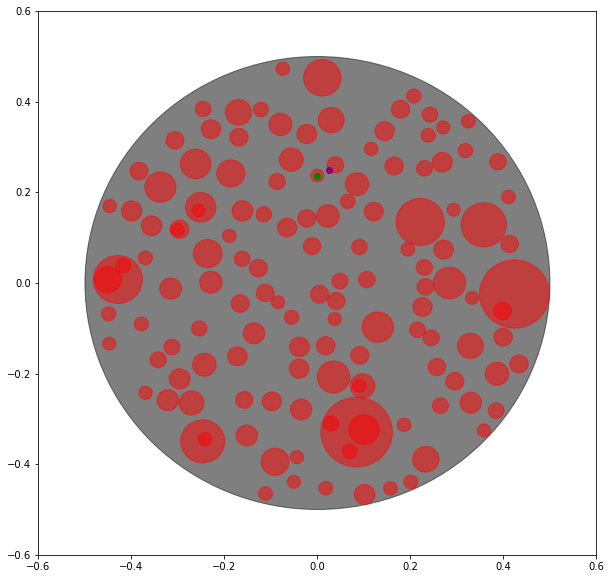

(-0.22873206967624682, -0.4179988483088699) (-0.23209770747187852, -0.39479924600176963) (<KDNode - (-0.23209770747187852, -0.39479924600176963)>, 0.0005495490649789971) 0.02344246286077888 0.014071626670739946


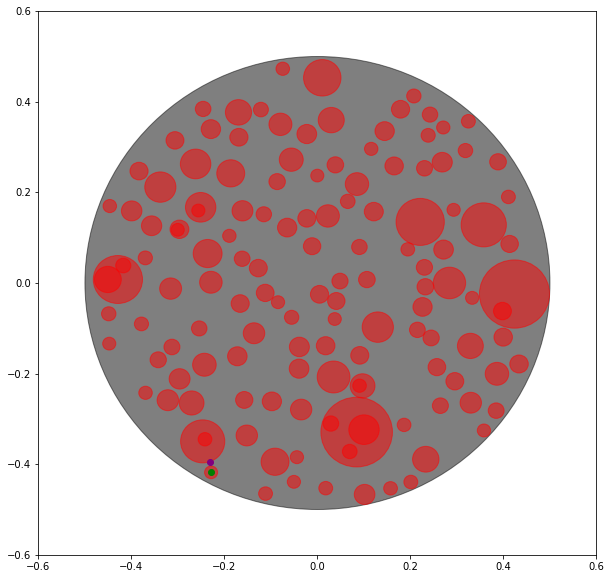

(0.025529851345718446, 0.08592613309159695) (0.007248772341715903, 0.08119714476962697) (<KDNode - (0.007248772341715903, 0.08119714476962697)>, 0.0003565611800999111) 0.01888282765106728 0.014070876661444104


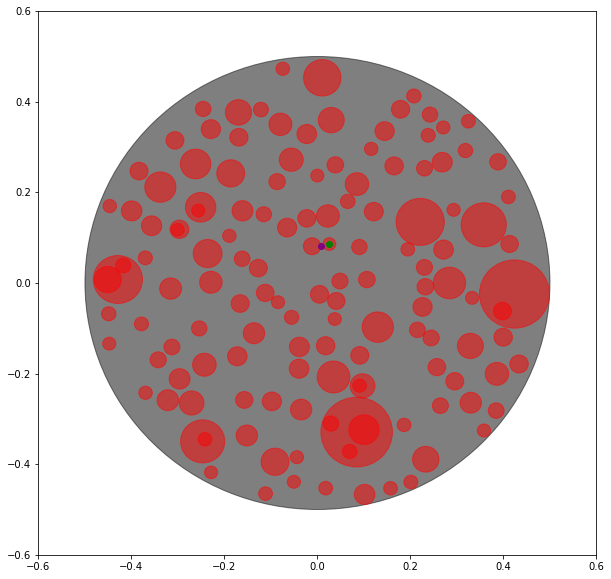

(0.38519442746797933, 0.21633543458255075) (0.40190802444603396, 0.20211789263011093) (<KDNode - (0.40190802444603396, 0.20211789263011093)>, 0.00048148282311422336) 0.02194271685808809 0.0140107458364278


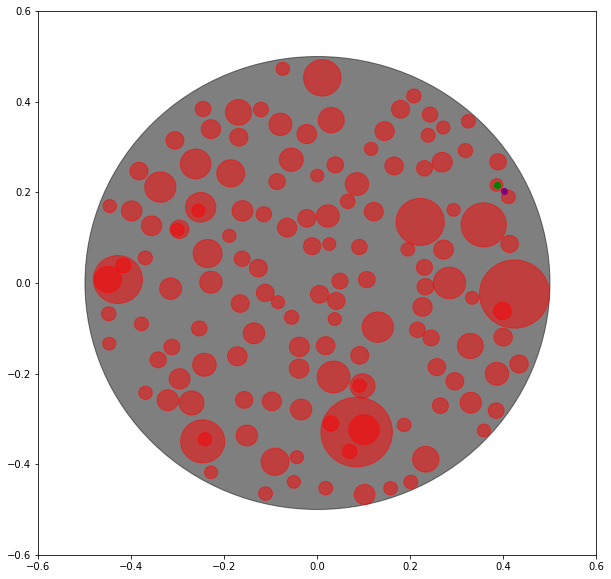

(0.4499496595521658, -0.08079968139894961) (0.44701966987722686, -0.09600934657661112) (<KDNode - (0.44701966987722686, -0.09600934657661112)>, 0.00023991875431181797) 0.015489310969562783 0.013680589809293384


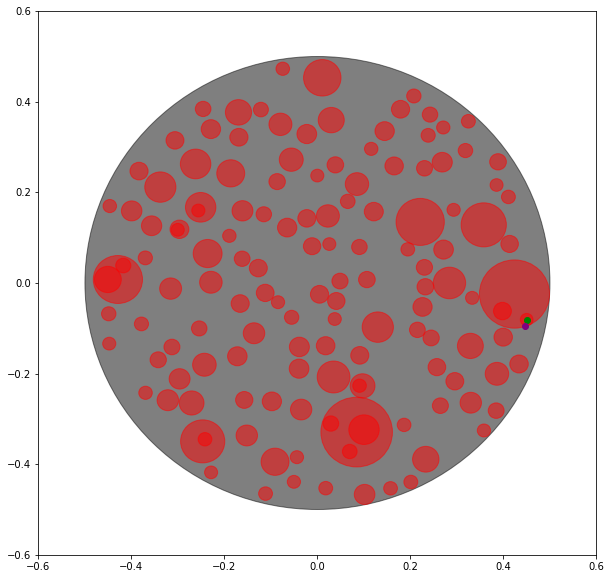

(-0.24243155096809624, 0.06738660929333593) (-0.26572148484613584, 0.0746452693822092) (<KDNode - (-0.26572148484613584, 0.0746452693822092)>, 0.0005951091663292582) 0.02439485942425695 0.013592292111379462


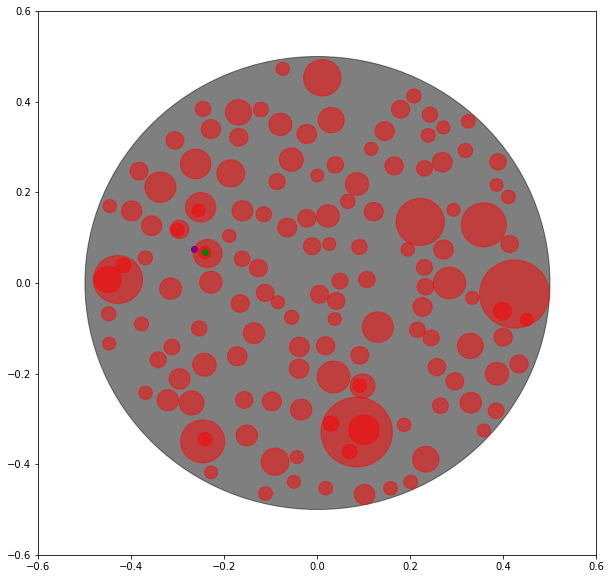

(0.1962871797639342, -0.16712562802365588) (0.23879195748007132, -0.17982365758933885) (<KDNode - (0.23879195748007132, -0.17982365758933885)>, 0.001967896083549185) 0.044360974781323115 0.013567437494081059


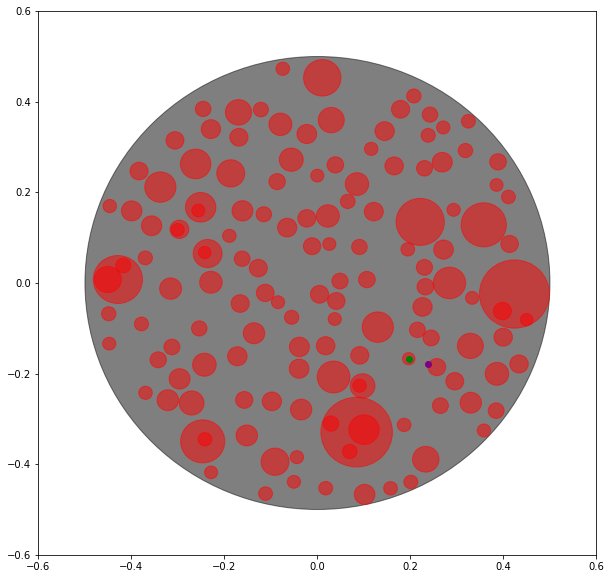

(0.10102765666587514, -0.3388355457401926) (0.10010525841904973, -0.35646805980529905) (<KDNode - (0.10010525841904973, -0.35646805980529905)>, 0.00031175637078192383) 0.01765662399163339 0.013549379119668341


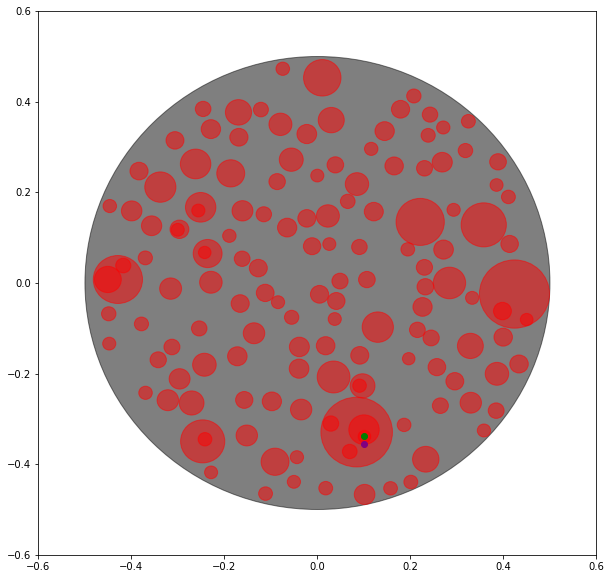

(0.13379274065008206, 0.060200248447926076) (0.10621337086485533, 0.07433523867425562) (<KDNode - (0.10621337086485533, 0.07433523867425562)>, 0.0009604195864487093) 0.030990637077167506 0.013504837976390299


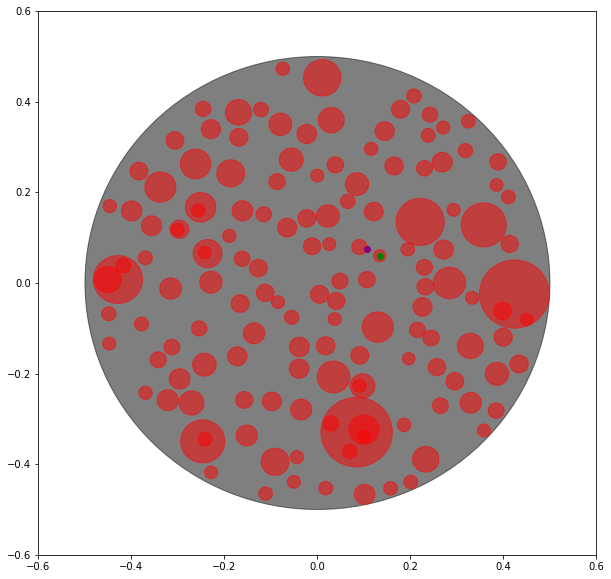

(0.3470366810980305, 0.01963456107004967) (0.3627990255033111, 0.01991042567007885) (<KDNode - (0.3627990255033111, 0.01991042567007885)>, 0.00024852760242823074) 0.015764758241984898 0.01343305069819021


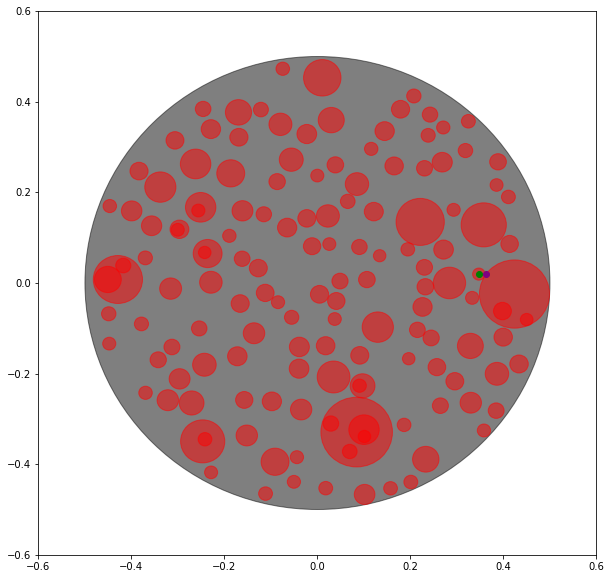

(0.009506144046967787, -0.4013384783868478) (0.02207920083491228, -0.3743269077256301) (<KDNode - (0.02207920083491228, -0.3743269077256301)>, 0.0008877067065788326) 0.029794407303701018 0.013415741136203386


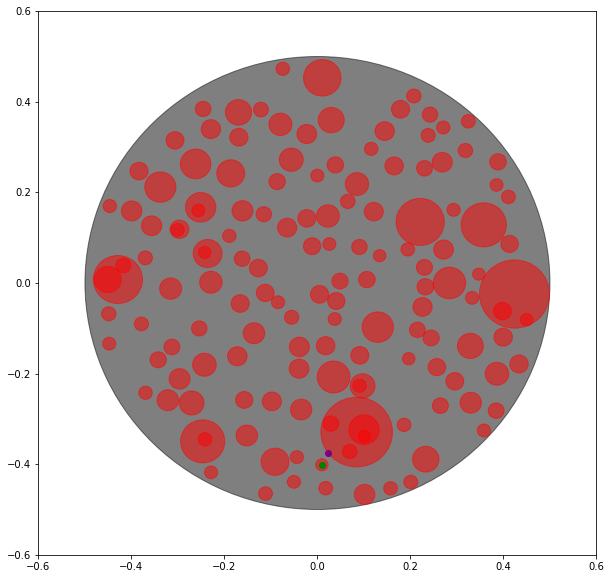

(-0.09166965413627481, 0.18943613101475862) (-0.08669919425523115, 0.2060924501683786) (<KDNode - (-0.08669919425523115, 0.2060924501683786)>, 0.0003021384391763124) 0.017382129880319973 0.013390272223709126


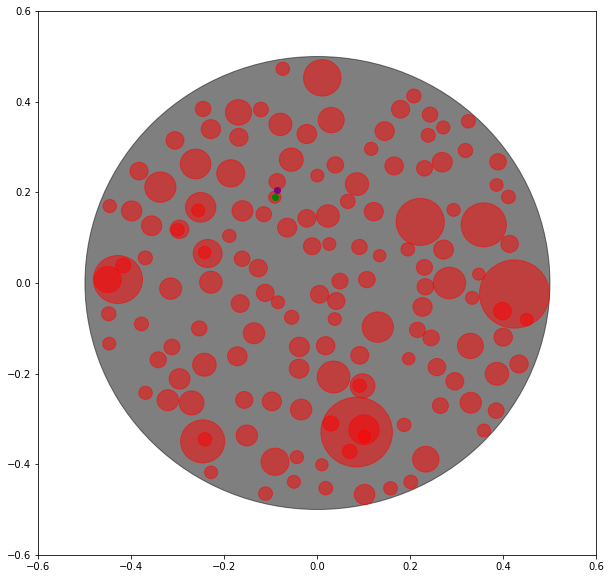

(-0.05201604405314439, -0.24499159323751613) (-0.04216466765969537, -0.25754358938838307) (<KDNode - (-0.04216466765969537, -0.25754358938838307)>, 0.00025460222421678304) 0.015956259718893494 0.013361868627447624


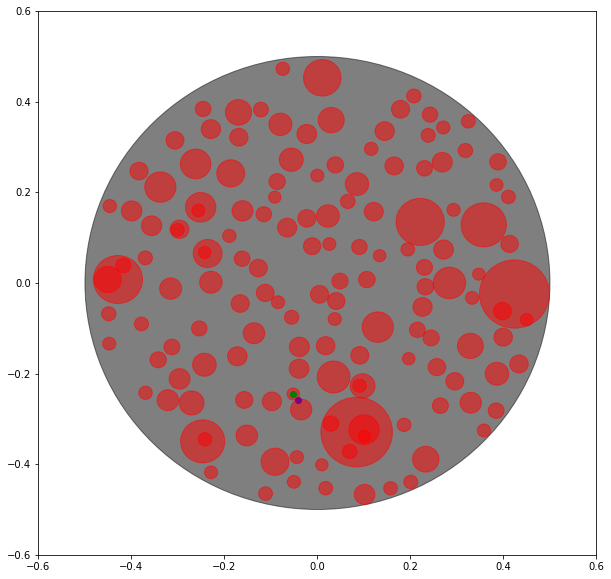

(-0.3892555734570898, 0.08599780181761285) (-0.37915762337823955, 0.0678497657068846) (<KDNode - (-0.37915762337823955, 0.0678497657068846)>, 0.00043131981047124794) 0.020768240427904525 0.01335684150760249


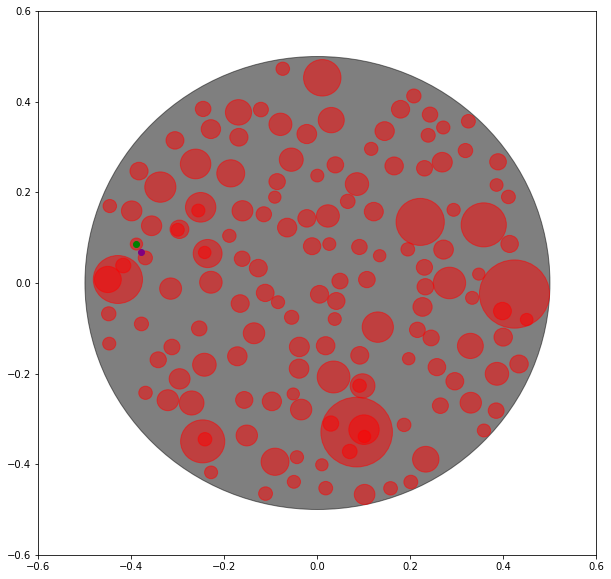

(-0.40182016389205255, -0.18321212704537665) (-0.3591726529171142, -0.174941861706176) (<KDNode - (-0.3591726529171142, -0.174941861706176)>, 0.0018872074811382708) 0.04344200134821451 0.013356453622602888


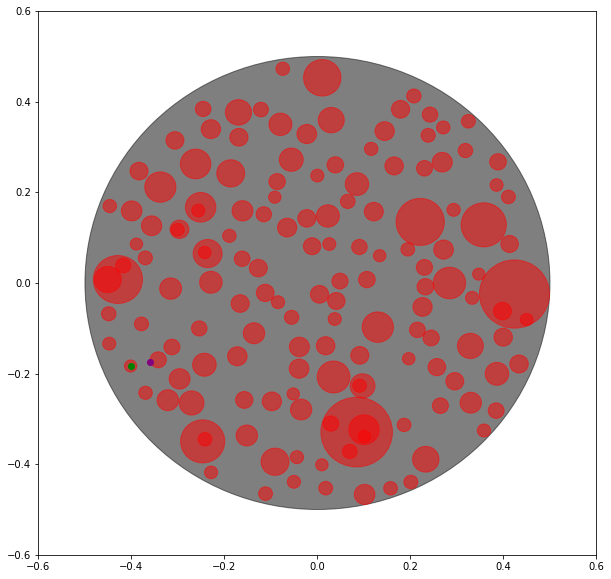

(-0.07733393155260222, 0.15576685440821053) (-0.07152257930214034, 0.14206693857806144) (<KDNode - (-0.07152257930214034, 0.14206693857806144)>, 0.00022145950873211814) 0.014881515673214142 0.013107536272709656


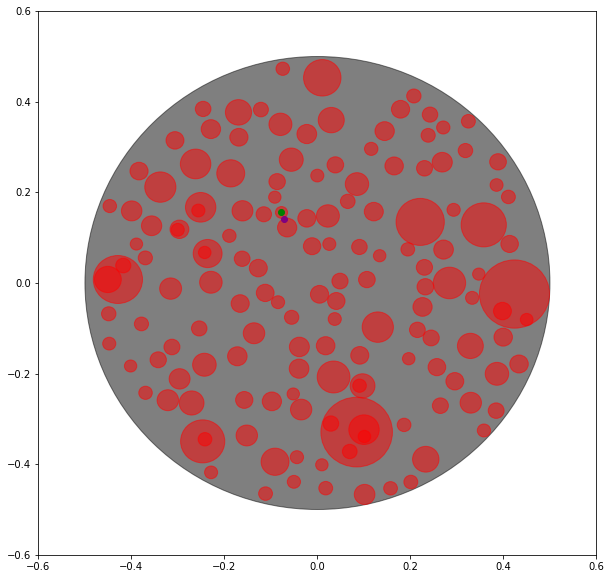

(0.09891688227089727, 0.4027147968601263) (0.0523422972592058, 0.376048979040752) (<KDNode - (0.0523422972592058, 0.376048979040752)>, 0.0028802578089873344) 0.05366803339966292 0.013089180575380407


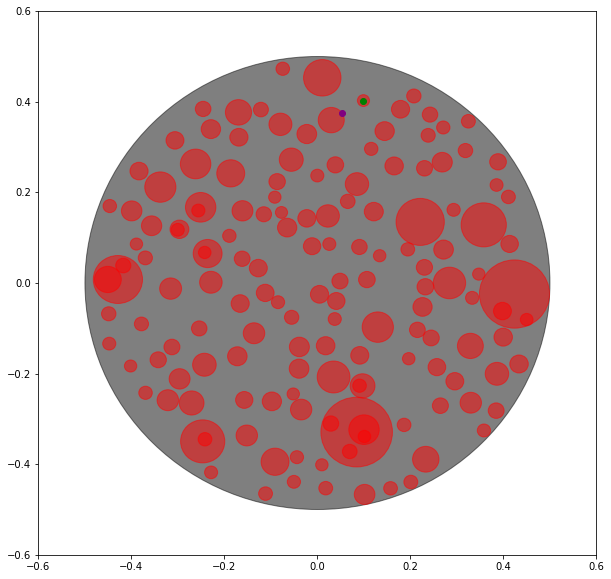

(0.06304875358853397, -0.4330687416498649) (0.08343345311255647, -0.453711589544359) (<KDNode - (0.08343345311255647, -0.453711589544359)>, 0.0008416631438799007) 0.02901143126217493 0.013087729187468788


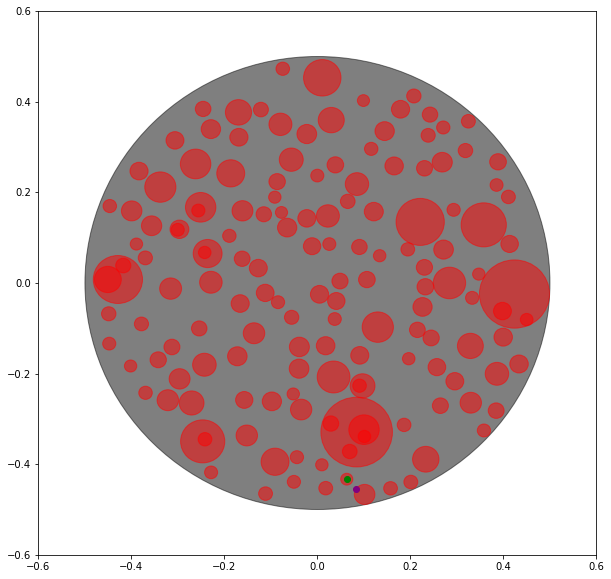

(-0.2813458514622899, 0.2615028183967725) (-0.29482187784268743, 0.26279559973155514) (<KDNode - (-0.29482187784268743, 0.26279559973155514)>, 0.00018327457058473238) 0.013537893875515954 0.013011060621530405


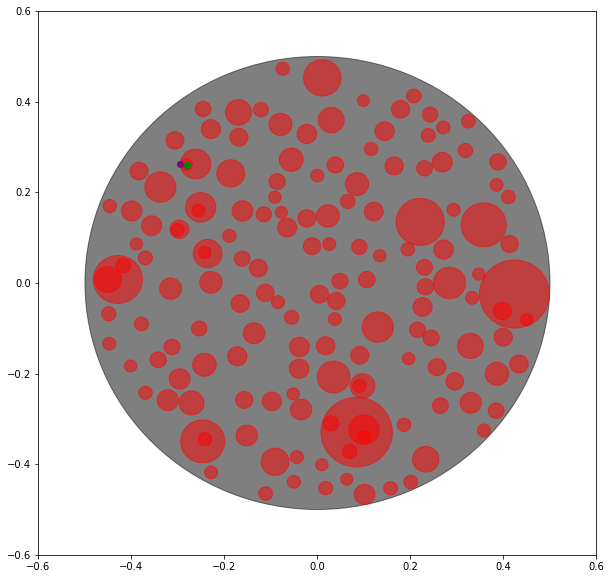

(0.32674674992947356, 0.2250976011577372) (0.3711836816315515, 0.21633543458255075) (<KDNode - (0.3711836816315515, 0.21633543458255075)>, 0.0020514164621864557) 0.045292565197684 0.012984561533987436


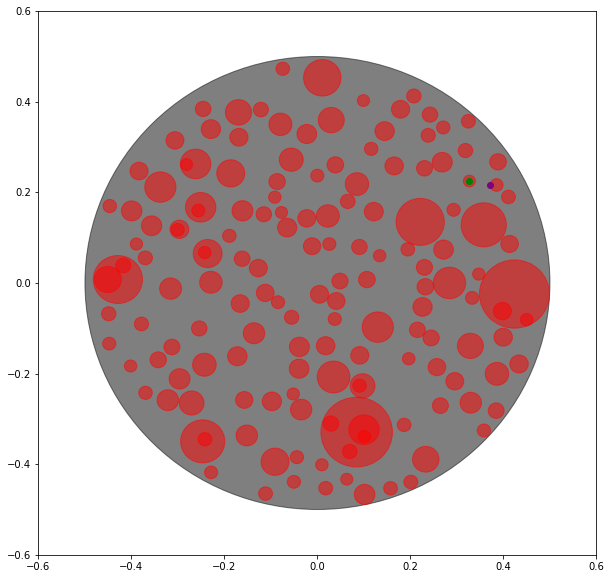

(0.3925471011739276, -0.027857186641779434) (0.39786981215723916, -0.04267475805111234) (<KDNode - (0.39786981215723916, -0.04267475805111234)>, 0.00024789167468254527) 0.015744576040101724 0.012968280984062313


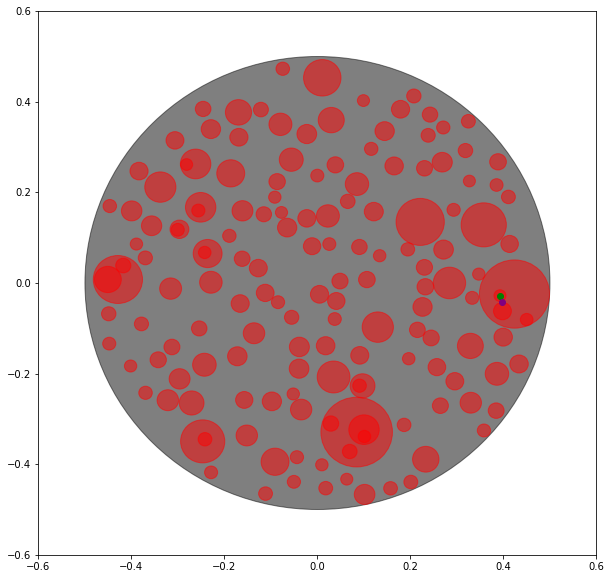

(0.20312281771523555, 0.2797889528603312) (0.21637403096538882, 0.2632712265093782) (<KDNode - (0.21637403096538882, 0.2632712265093782)>, 0.0004484299364060047) 0.02117616434593396 0.012959607428798018


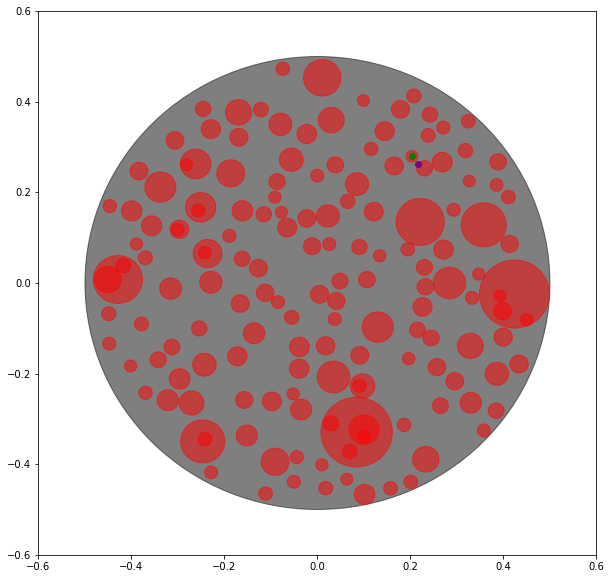

(-0.3748610522420099, -0.18957124315951157) (-0.38911742163968205, -0.1873394981993418) (<KDNode - (-0.38911742163968205, -0.1873394981993418)>, 0.0002082247539701266) 0.01442999494005894 0.01290473778998268


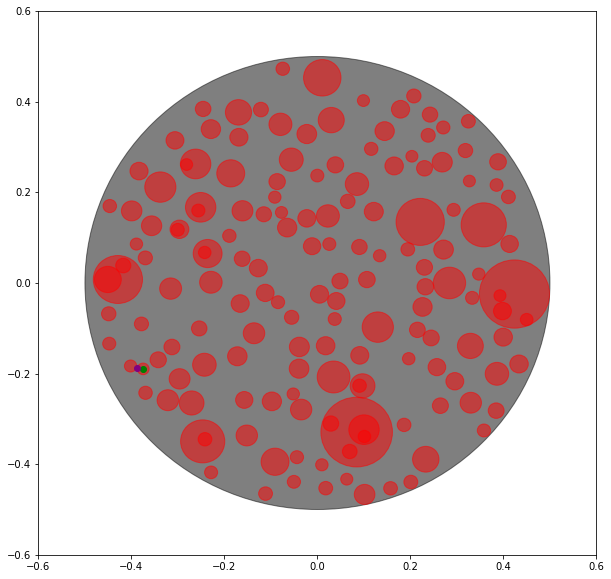

(-0.25979014219006563, -0.25708622411774995) (-0.24900392761185722, -0.24917982494385957) (<KDNode - (-0.24900392761185722, -0.24917982494385957)>, 0.00017885357282405024) 0.013373614800197074 0.012820526409763944


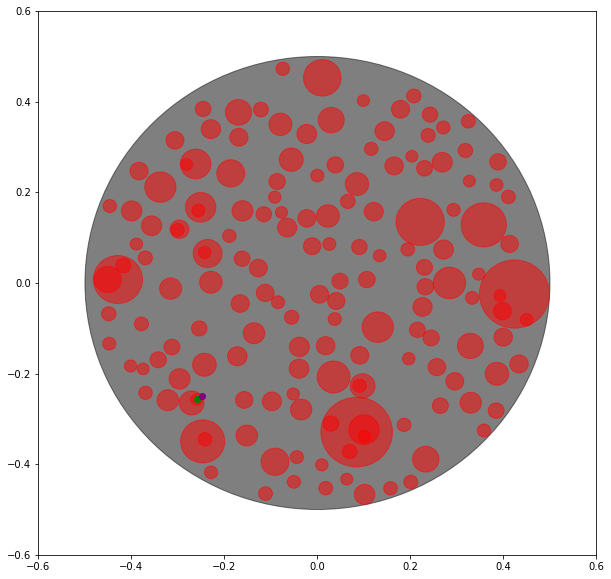

(-0.3418064732850192, 0.04948955478240912) (-0.35558639527210273, 0.05072426605046097) (<KDNode - (-0.35558639527210273, 0.05072426605046097)>, 0.00019141076188556298) 0.013835127823246267 0.012799150874380638


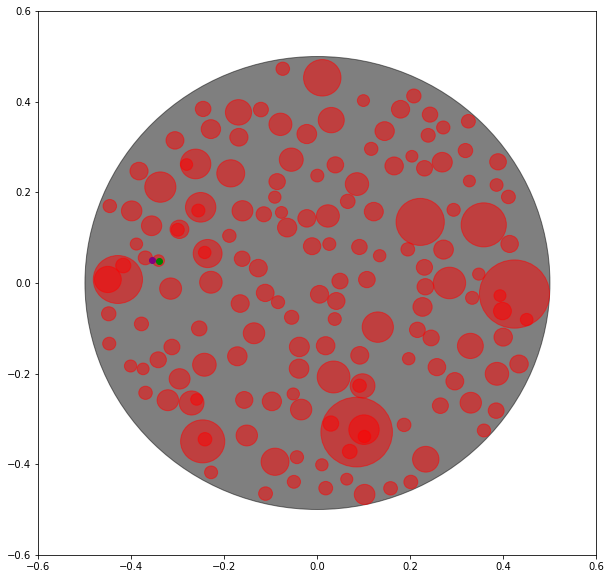

(0.20913212848523968, -0.2688555045642339) (0.19502508193527626, -0.3012586841496351) (<KDNode - (0.19502508193527626, -0.3012586841496351)>, 0.0012489748096065944) 0.03534083770380372 0.012743048310465112


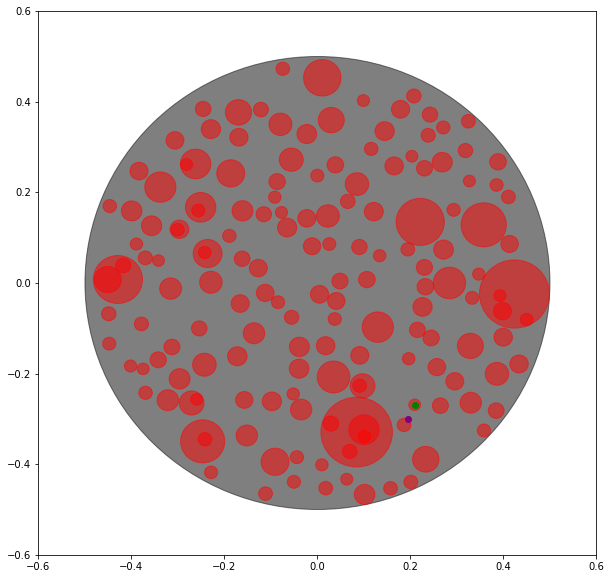

(-0.050838342550891126, 0.4182702339197881) (-0.02222071506575228, 0.4293119094003289) (<KDNode - (-0.02222071506575228, 0.4293119094003289)>, 0.000940887200295749) 0.030673884662620565 0.01274053339908476


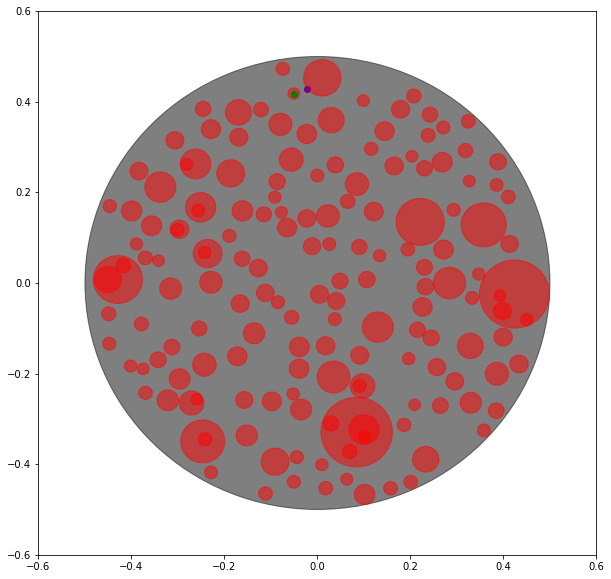

(-0.17357495892603586, -0.38290471256362) (-0.15908832276723794, -0.3585133040779918) (<KDNode - (-0.15908832276723794, -0.3585133040779918)>, 0.000804803435110167) 0.028369057705714636 0.012681342364194657


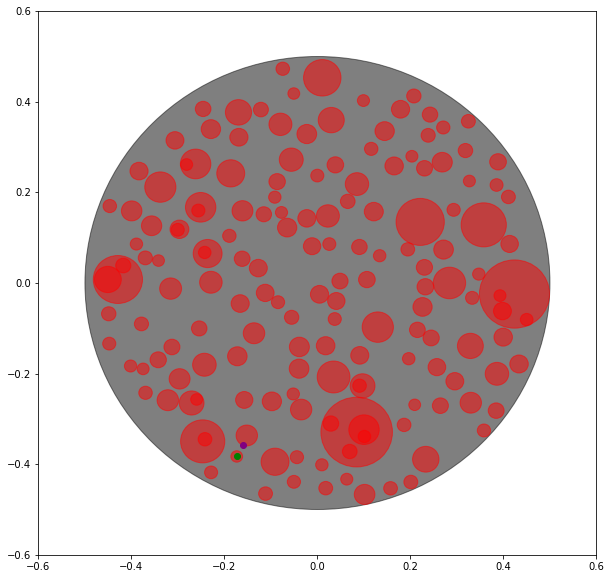

(0.20146438316604465, 0.1703327354238) (0.19043004010483125, 0.17687263127176167) (<KDNode - (0.19043004010483125, 0.17687263127176167)>, 0.00016452696449473445) 0.012826806480754844 0.012610512428008099


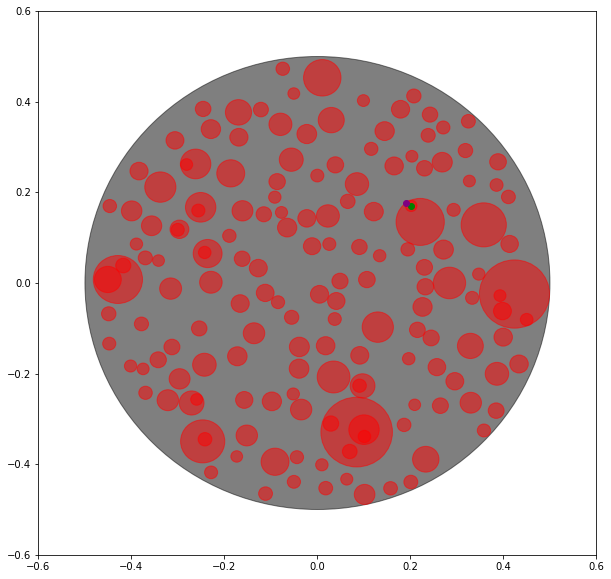

(-0.09982620640533646, 0.07793235655208605) (-0.1157940871342342, 0.04853014392430033) (<KDNode - (-0.1157940871342342, 0.04853014392430033)>, 0.0011194633223818259) 0.03345838194506462 0.012566934241473794


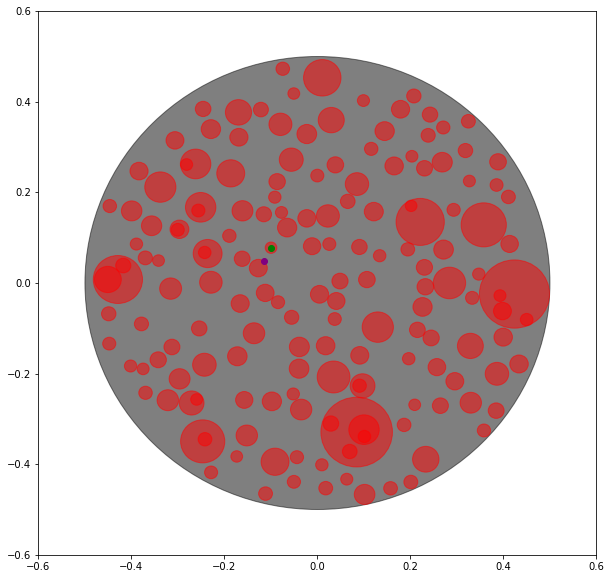

(0.3472176236808098, 0.20052048482343837) (0.3343788837066355, 0.2145928702122341) (<KDNode - (0.3343788837066355, 0.2145928702122341)>, 0.0003628652746552525) 0.01904902293177402 0.012546503132990224


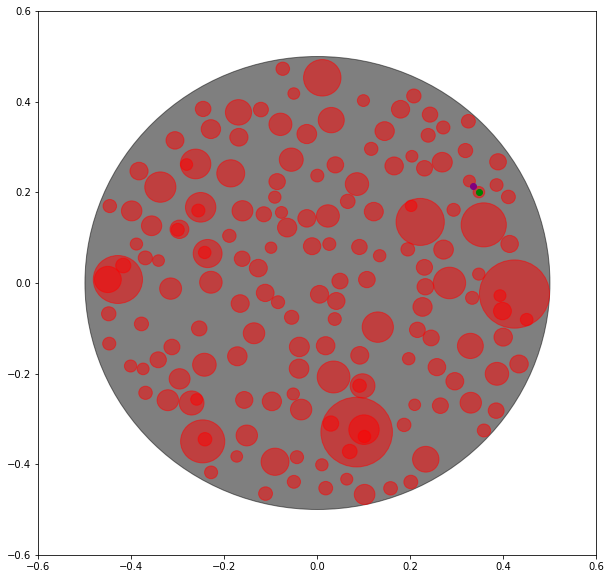

(0.3361092792688327, -0.09565127557739386) (0.33747651985151095, -0.11236069864755685) (<KDNode - (0.33747651985151095, -0.11236069864755685)>, 0.0002810741661486174) 0.016765266659036993 0.01248547026590997


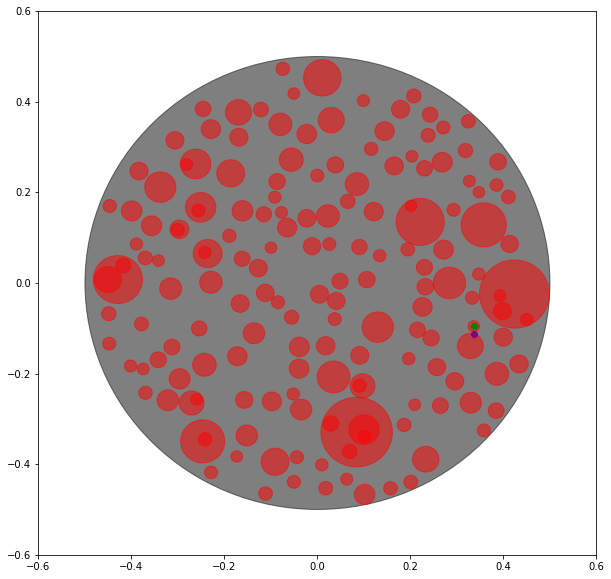

(-0.3703426085516055, -0.06341869238026371) (-0.373781509760703, -0.07587404949475783) (<KDNode - (-0.373781509760703, -0.07587404949475783)>, 0.00016696196237551167) 0.012921376179630082 0.012438477134422164


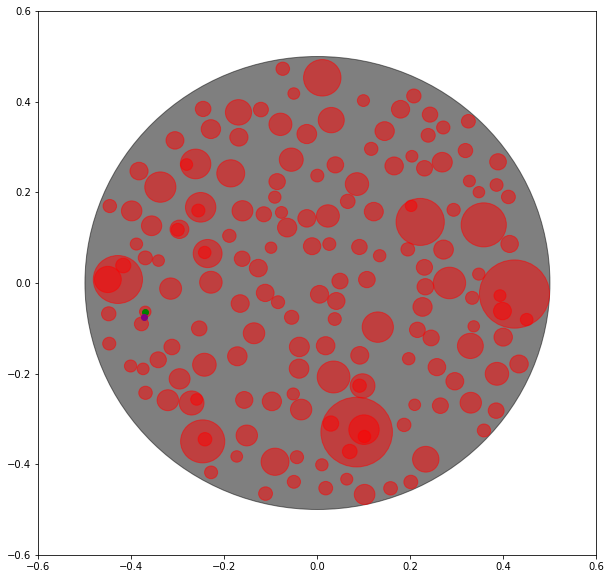

(-0.2030403200953065, 0.18315904759232982) (-0.2200161775063904, 0.17722821691969734) (<KDNode - (-0.2200161775063904, 0.17722821691969734)>, 0.0003233544873088904) 0.01798206015196508 0.01243526799313551


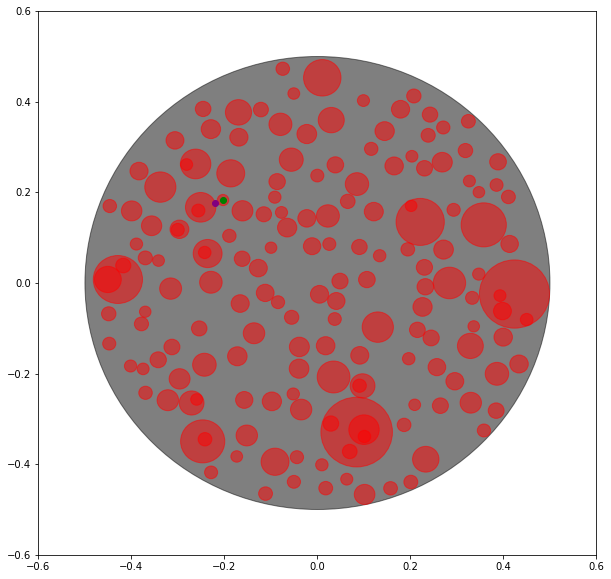

(-0.45239544484892685, 0.07239082285737639) (-0.4455306860368648, 0.058105505842559683) (<KDNode - (-0.4455306860368648, 0.058105505842559683)>, 0.0002511951957615952) 0.015849138644153354 0.012344062990439749


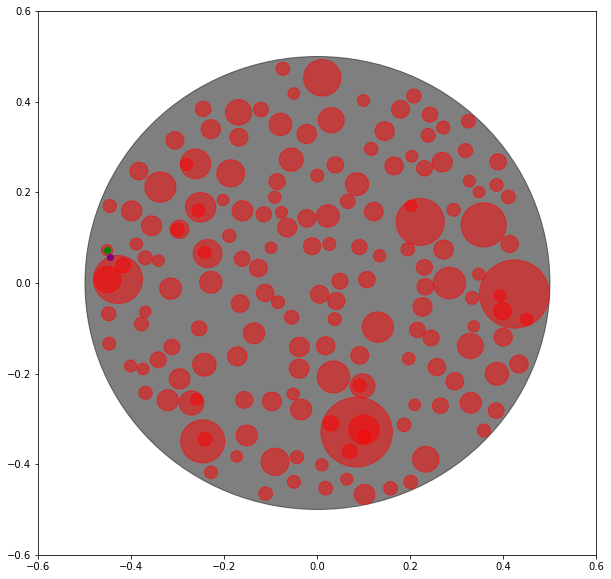

(-0.27981675351952606, 0.04500945378254555) (-0.26572148484613584, 0.05543092548733282) (<KDNode - (-0.26572148484613584, 0.05543092548733282)>, 0.0003072836714687376) 0.017529508591764276 0.012333410367311854


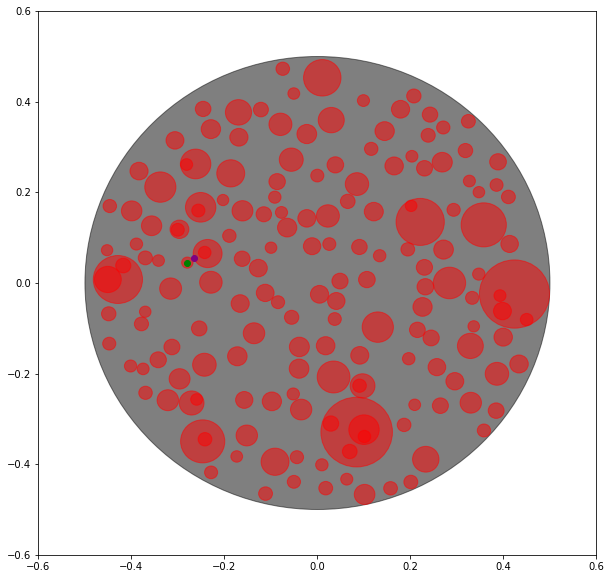

(0.46057953665511103, -0.0554200366565844) (0.4541771942963102, -0.06778866731406007) (<KDNode - (0.4541771942963102, -0.06778866731406007)>, 0.00019397301202034236) 0.013927419431479127 0.012327496913225797


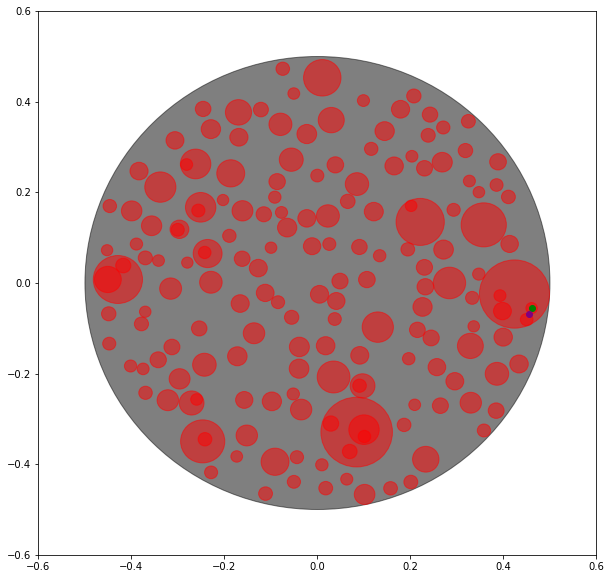

(-0.003108388187662758, 0.3013810413701264) (-0.010444900550839777, 0.31171412180351055) (<KDNode - (-0.010444900550839777, 0.31171412180351055)>, 0.00016059696489783575) 0.012672685780758385 0.012310534464078506


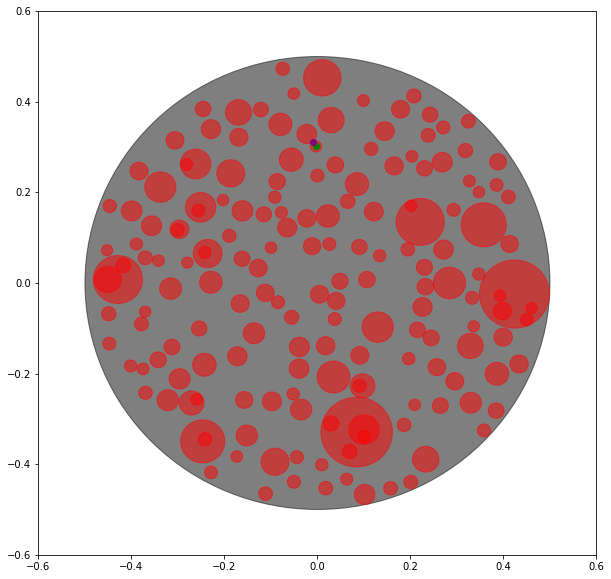

(0.26704572277411015, 0.013540296035679392) (0.2556937741401207, 0.02054634595012554) (<KDNode - (0.2556937741401207, 0.02054634595012554)>, 0.00017795147319244636) 0.013339845321158951 0.012291925225761686


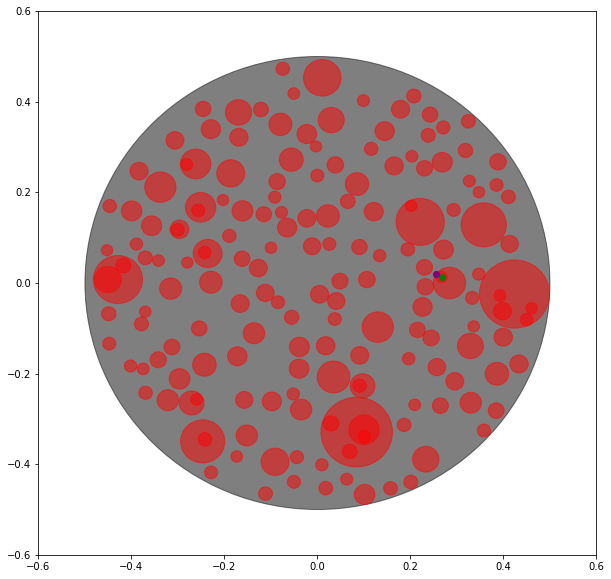

(-0.15104524832019628, 0.1609443904579523) (-0.13875258372759974, 0.15934214923278614) (<KDNode - (-0.13875258372759974, 0.15934214923278614)>, 0.00015367677972969853) 0.012396643889767042 0.012281867950156315


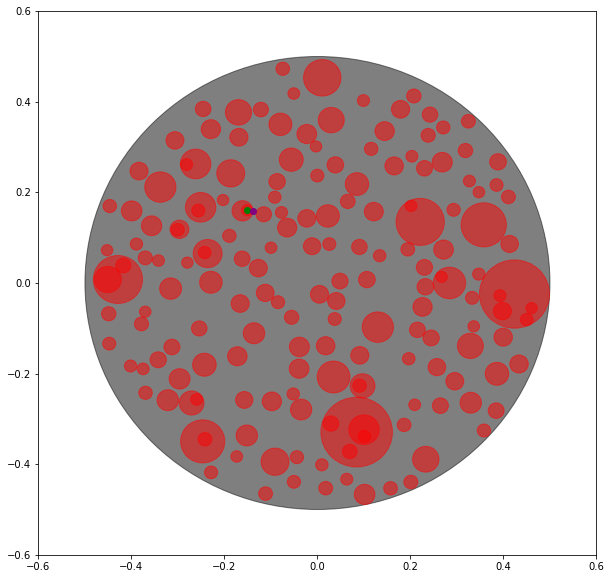

(-0.23101772754472386, 0.11615206846392823) (-0.23615364990469342, 0.09612755892821001) (<KDNode - (-0.23615364990469342, 0.09612755892821001)>, 0.0004273586806337052) 0.02067265538419545 0.012266985569219348


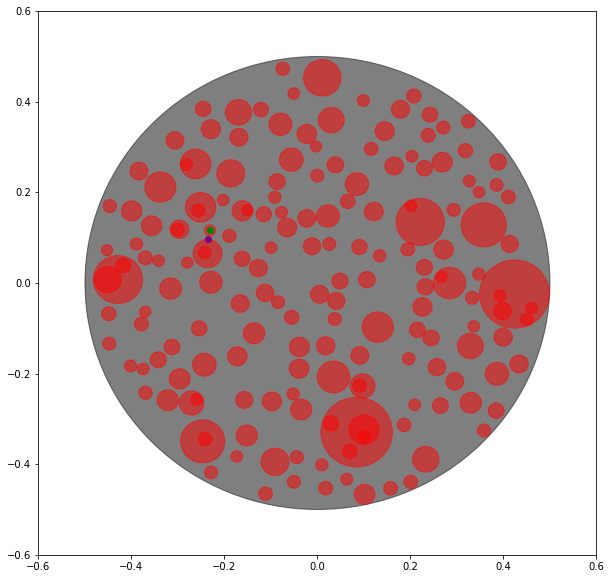

(0.0044359187367960205, 0.1848957216933609) (0.01482479293530248, 0.17151694569467973) (<KDNode - (0.01482479293530248, 0.17151694569467973)>, 0.0002869203543352807) 0.01693872351552149 0.012193025106627444


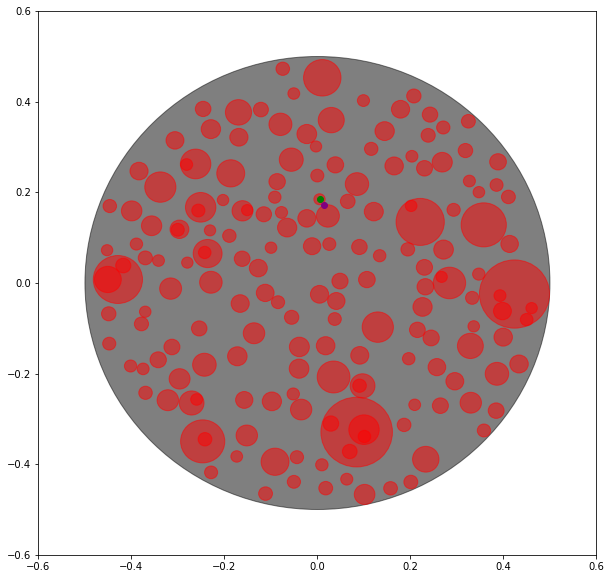

(-0.1460780521455625, -0.3369601174064341) (-0.12888117803513688, -0.3365665287805073) (<KDNode - (-0.12888117803513688, -0.3365665287805073)>, 0.0002958873911762857) 0.01720137759530572 0.012113497887677748


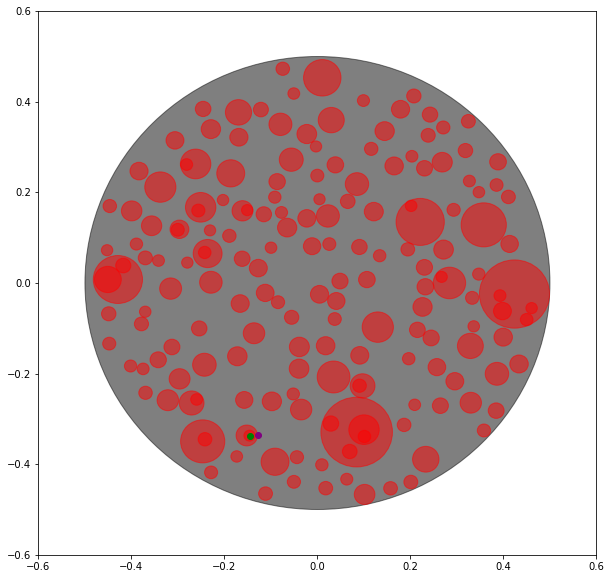

(-0.18881947952218156, 0.03231221292825318) (-0.17562801254032645, 0.04356410059399741) (<KDNode - (-0.17562801254032645, 0.04356410059399741)>, 0.0003006197771759006) 0.017338390270607608 0.012092697377571305


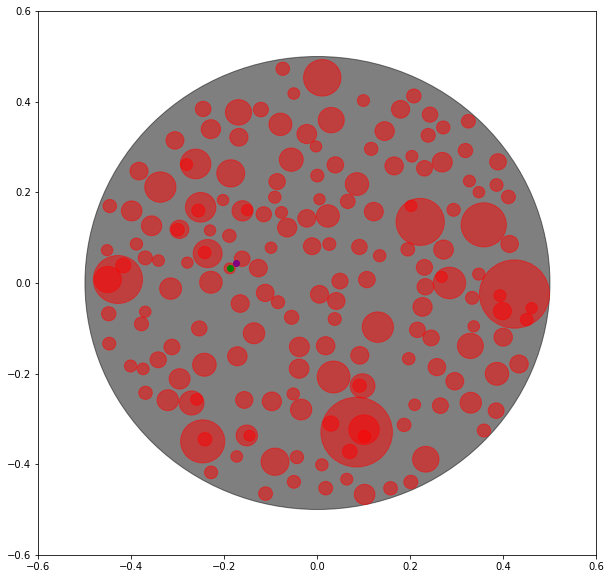

(0.33714072072536855, 0.14189286581625857) (0.3182599652094903, 0.15695213088831847) (<KDNode - (0.3182599652094903, 0.15695213088831847)>, 0.0005832643933609305) 0.02415086734179397 0.012071670284690496


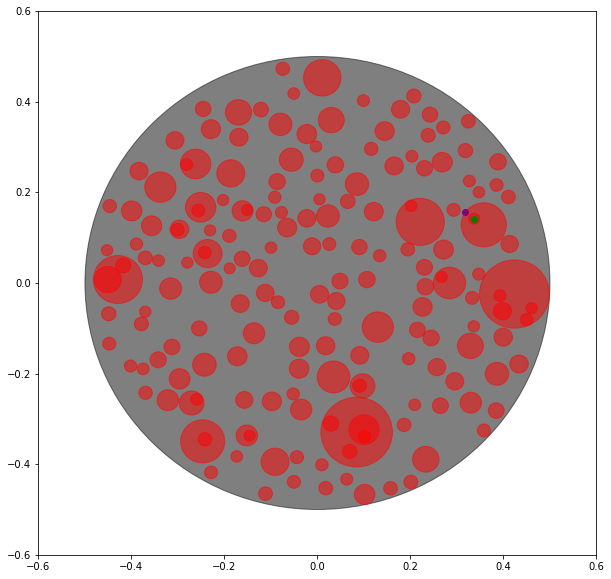

(-0.3719313947057232, 0.2847639170819188) (-0.3776837549166349, 0.26559739516068975) (<KDNode - (-0.3776837549166349, 0.26559739516068975)>, 0.00040044521055303354) 0.02001112716847888 0.01204407625893939


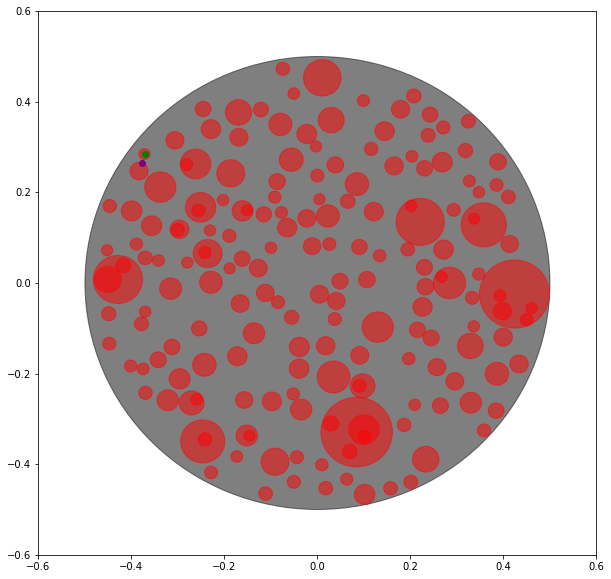

(0.15624226617207435, 0.07915937613702369) (0.144718384079262, 0.06813819304504762) (<KDNode - (0.144718384079262, 0.06813819304504762)>, 0.0002542663352359004) 0.01594573094078476 0.012011467640912274


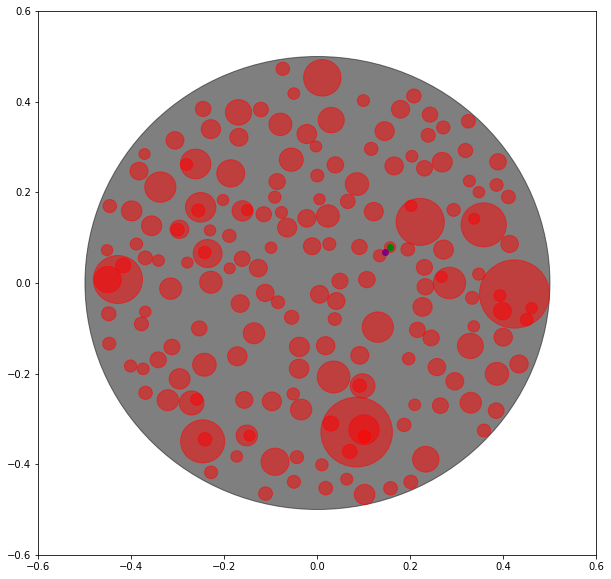

(0.08788267396094733, -0.06528522799476967) (0.10257863018808411, -0.07764584296373425) (<KDNode - (0.10257863018808411, -0.07764584296373425)>, 0.0003687559318409115) 0.01920301882103206 0.012004228788875637


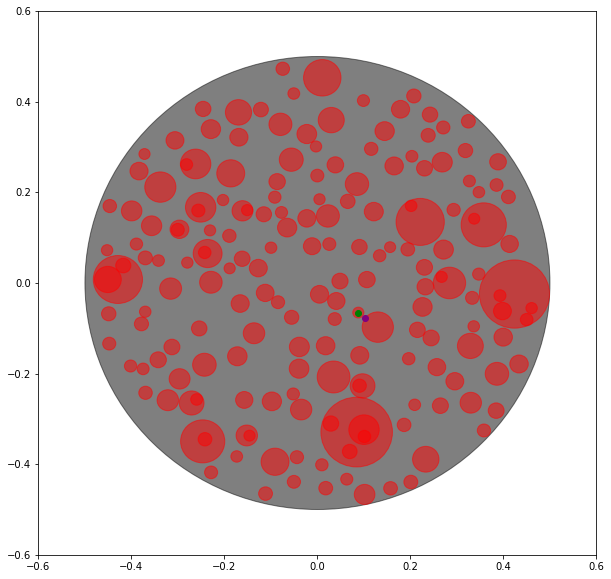

(0.016361799195417193, -0.4866521960957083) (0.01780699030262104, -0.4678699103021415) (<KDNode - (0.01780699030262104, -0.4678699103021415)>, 0.00035486283696756357) 0.01883780340080986 0.01197998760745614


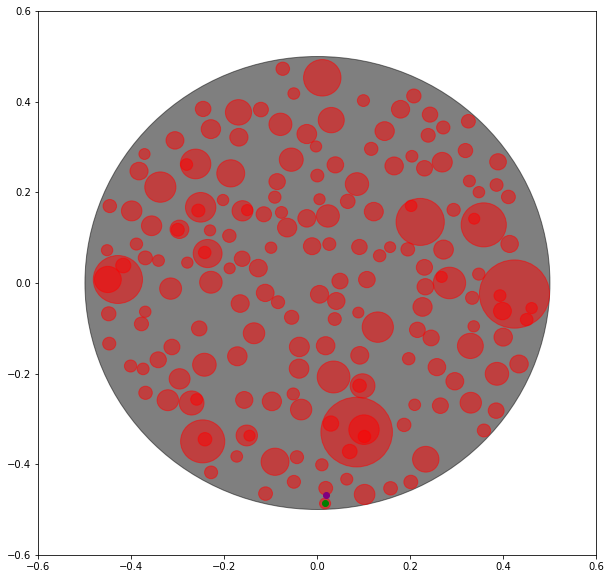

(0.14953808791141007, 0.10932833876885605) (0.1525305185436477, 0.09058296070718168) (<KDNode - (0.1525305185436477, 0.09058296070718168)>, 0.00036034383976385665) 0.01898272477185129 0.011938688745610864


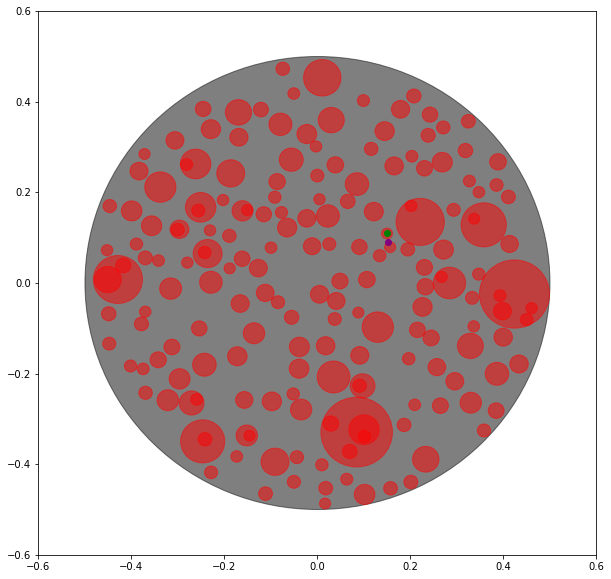

(0.007209942955181729, -0.0733953429552637) (0.023693956589528137, -0.07513129062484836) (<KDNode - (0.023693956589528137, -0.07513129062484836)>, 0.00027473621980885464) 0.016575168771655227 0.011928060174610157


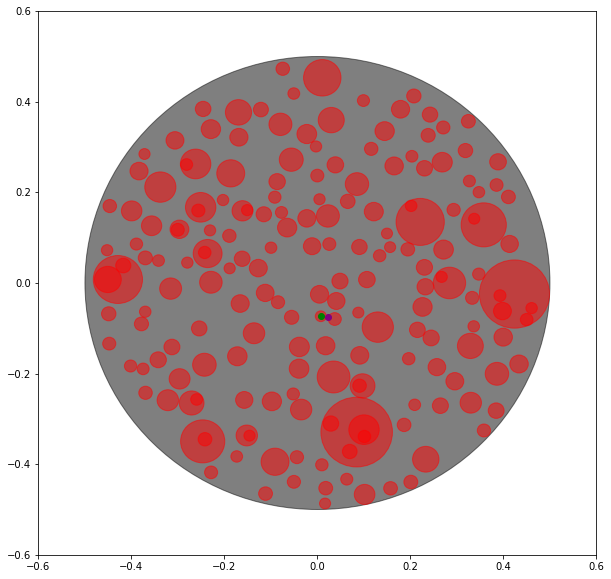

(0.03517417095161782, -0.37827454962867024) (0.039102116002947246, -0.3913498228936651) (<KDNode - (0.039102116002947246, -0.3913498228936651)>, 0.00018639152328055265) 0.01365252809118343 0.011918066149350315


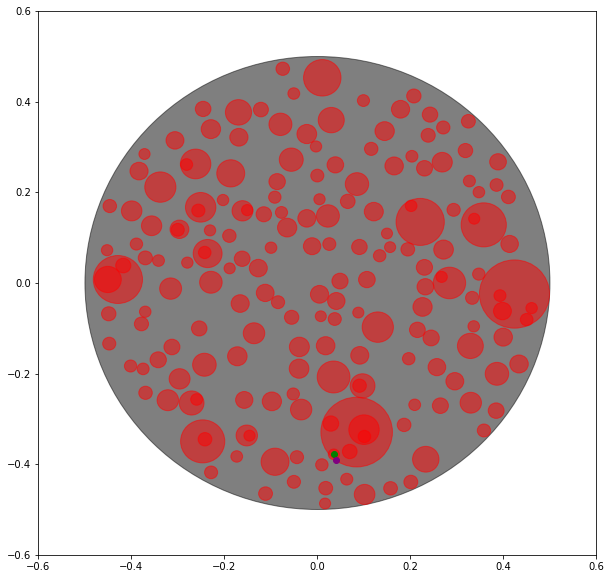

(-0.20250012736742204, 0.23807168982495572) (-0.21505725116536456, 0.2327336651851528) (<KDNode - (-0.21505725116536456, 0.2327336651851528)>, 0.00018617586513199757) 0.01364462770221297 0.011881543265722251


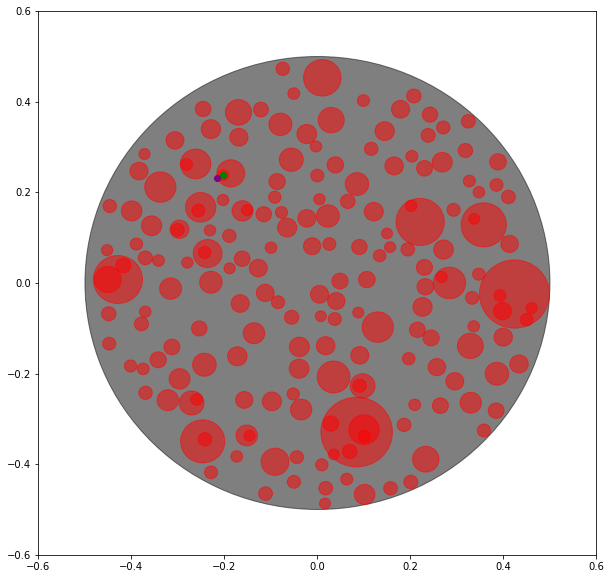

(0.18896478865124944, 0.31615425400550884) (0.19911807877930915, 0.2921142719541166) (<KDNode - (0.19911807877930915, 0.2921142719541166)>, 0.0006810100374558158) 0.026096169018762425 0.011873788890482552


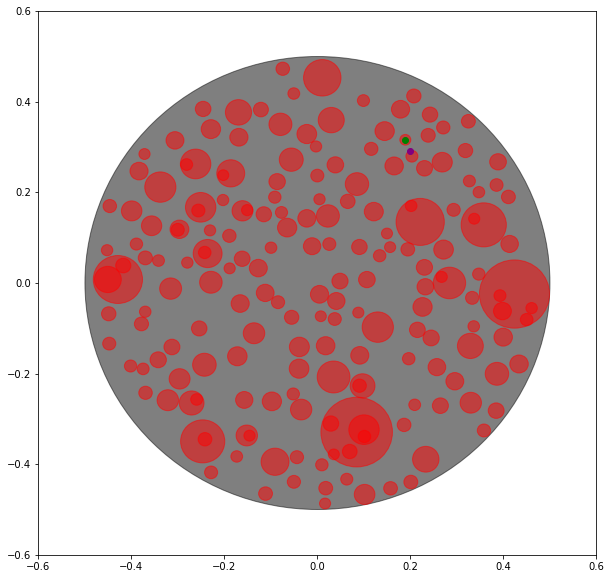

(-0.10879140136030632, -0.20787573452899616) (-0.10441154066260741, -0.24155166799512692) (<KDNode - (-0.10441154066260741, -0.24155166799512692)>, 0.0011532516745465136) 0.03395955939859223 0.011819219703680784


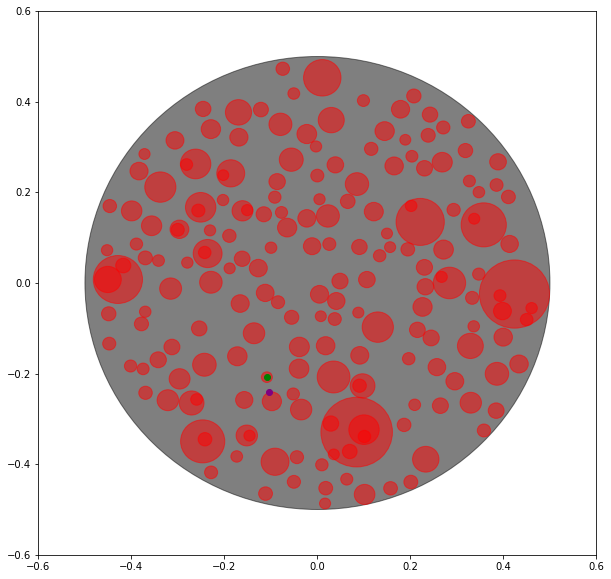

(0.4450182959595775, -0.03164024501106788) (0.45333361577183595, -0.04544688215568002) (<KDNode - (0.45333361577183595, -0.04544688215568002)>, 0.00025976777282312184) 0.016117312828853383 0.011817011559838466


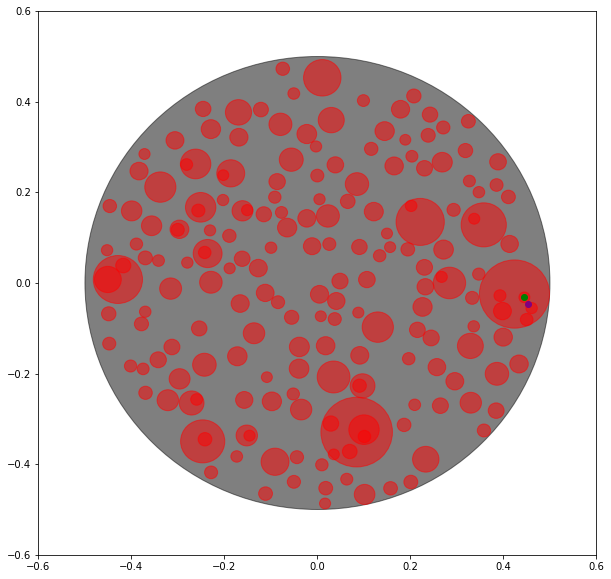

(0.18286301507074057, 0.12424856122978374) (0.17157057508180867, 0.11882916625047263) (<KDNode - (0.17157057508180867, 0.11882916625047263)>, 0.00015688904284541069) 0.012525535631078244 0.011814283282939212


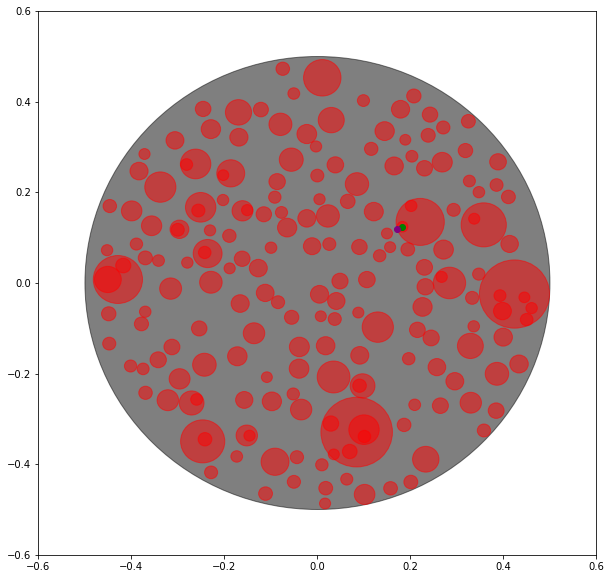

(0.11087413076819062, 0.19114958407143504) (0.09981196072011189, 0.19799498022575182) (<KDNode - (0.09981196072011189, 0.19799498022575182)>, 0.00016923105468214525) 0.013008883683166102 0.011784002583554087


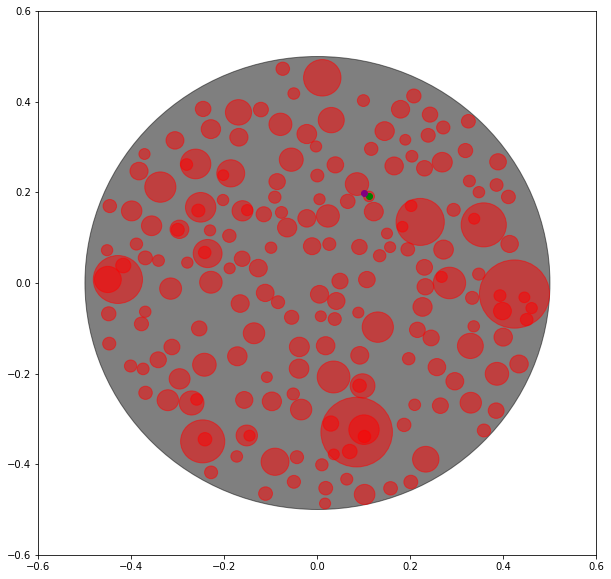

(-0.02075564273179275, -0.054379522188584224) (-0.0070221635559105, -0.04085454931675918) (<KDNode - (-0.0070221635559105, -0.04085454931675918)>, 0.0003715333414579948) 0.019275200166483222 0.011761053274603405


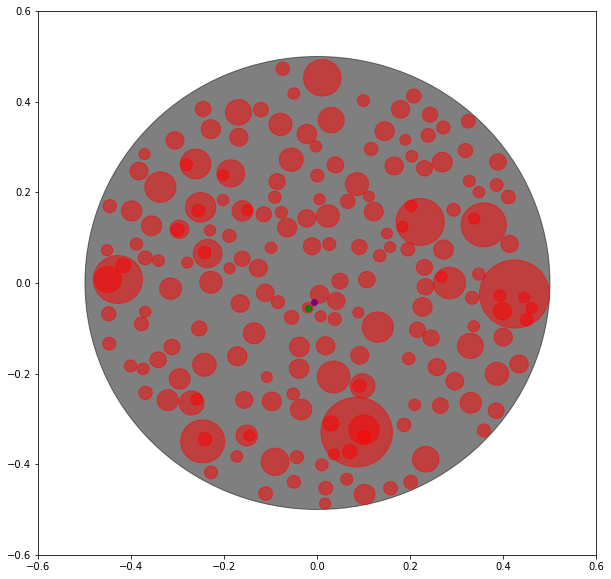

(0.1580938327284594, -0.23097150050001133) (0.12378537560537484, -0.22711514905903912) (<KDNode - (0.12378537560537484, -0.22711514905903912)>, 0.00119194167660282) 0.034524508347010825 0.011750623283394282


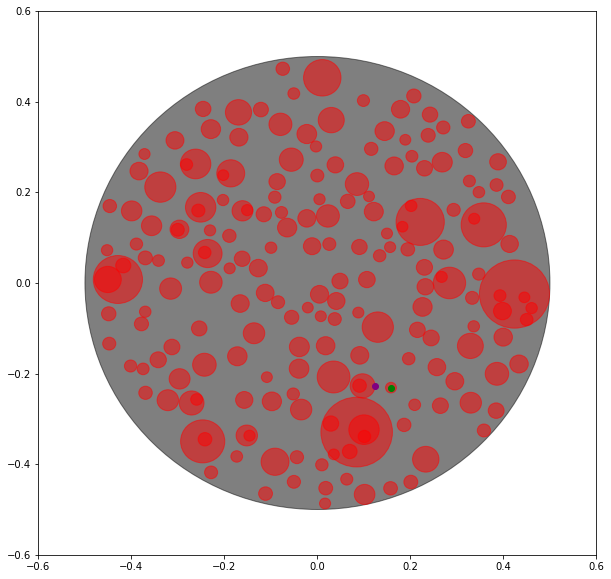

(0.4352834446926145, 0.15858425729533776) (0.41948352161425445, 0.17792729608447988) (<KDNode - (0.41948352161425445, 0.17792729608447988)>, 0.0006237907188803506) 0.024975802667388903 0.011749365836226969


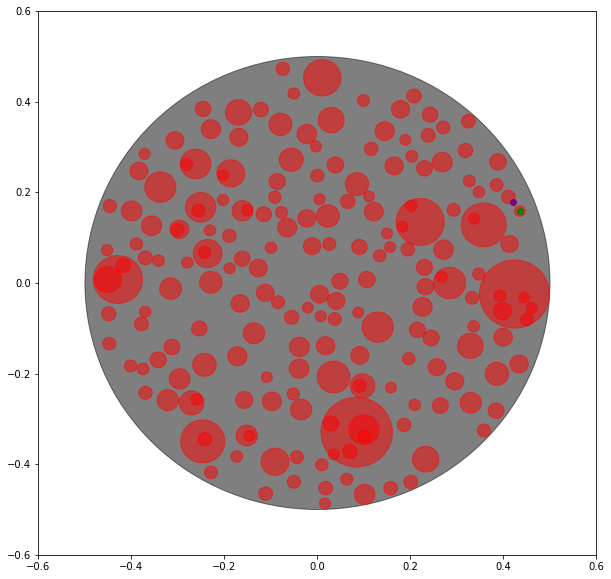

(-0.14001003199297218, 0.09693472176351955) (-0.15662682074202852, 0.06971699745257984) (<KDNode - (-0.15662682074202852, 0.06971699745257984)>, 0.001016922184997084) 0.0318892173782469 0.011742455640344276


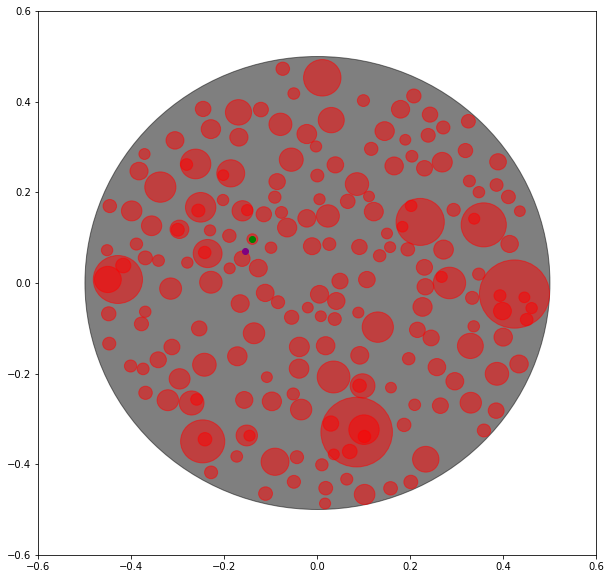

(-0.1932099755119606, -0.29663237991646113) (-0.20834317171398373, -0.321690302366456) (<KDNode - (-0.20834317171398373, -0.321690302366456)>, 0.0008569131047988851) 0.02927307815722298 0.011683200856123127


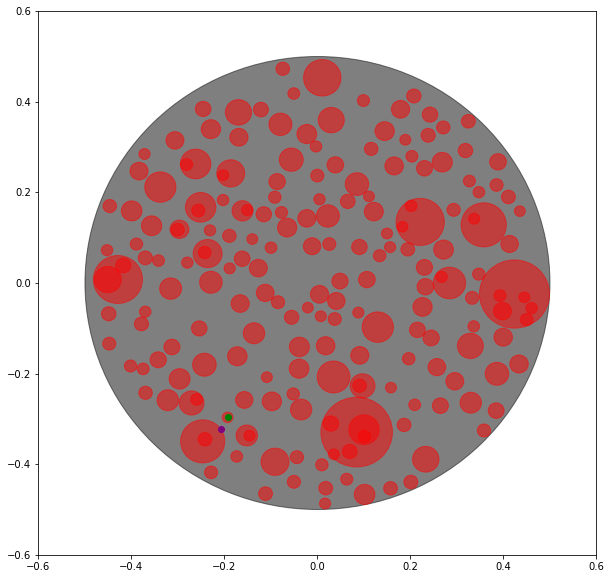

(-0.24804371217816443, -0.1747688034697835) (-0.2580277695357313, -0.15990442975807276) (<KDNode - (-0.2580277695357313, -0.15990442975807276)>, 0.0003206310071605825) 0.01790617232019681 0.011670892912990406


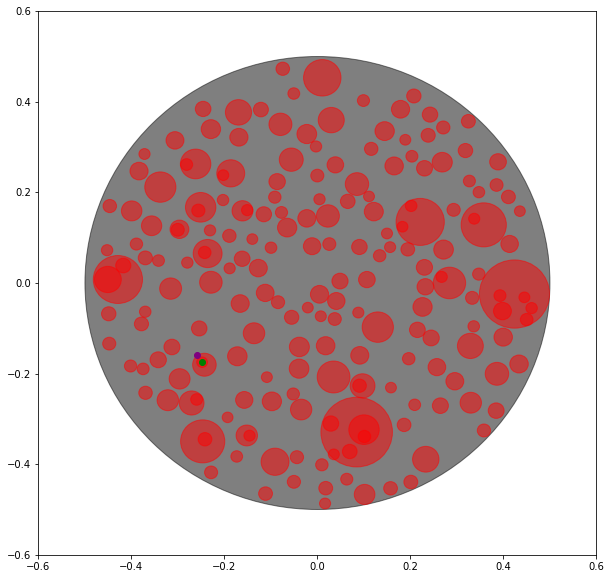

(-0.4231865165679576, -0.11924600094497974) (-0.43629530459343785, -0.12554605510976186) (<KDNode - (-0.43629530459343785, -0.12554605510976186)>, 0.00021153100597616332) 0.014544105540601777 0.01166678189755394


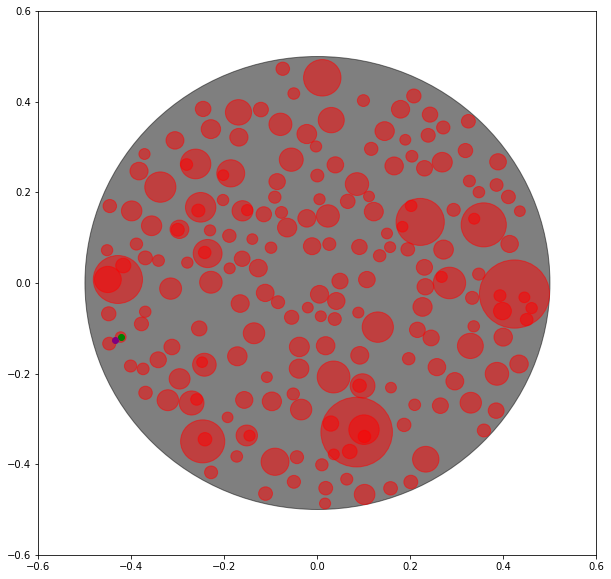

(-0.10938946255089296, 0.4125653227333515) (-0.11658972406905593, 0.39819895870557004) (<KDNode - (-0.11658972406905593, 0.39819895870557004)>, 0.0002582361813086718) 0.016069728725422585 0.011521855733041693


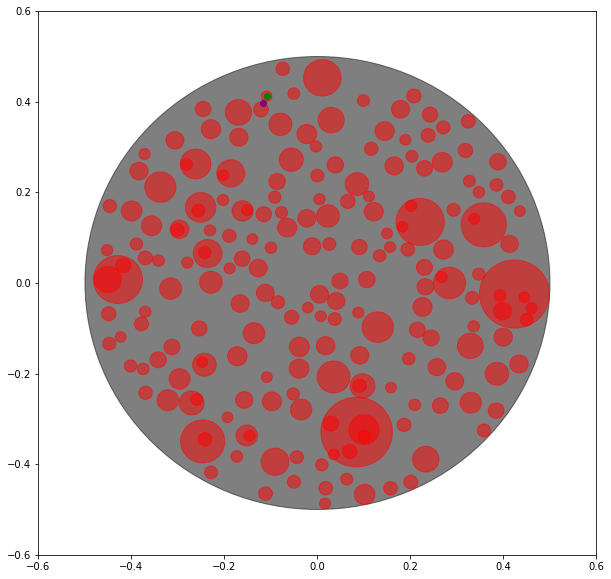

(-0.006583478324203167, -0.3630836312873737) (0.011149816518738878, -0.352876783248005) (<KDNode - (0.011149816518738878, -0.352876783248005)>, 0.00041864949288548004) 0.020460926002639275 0.011464908771647518


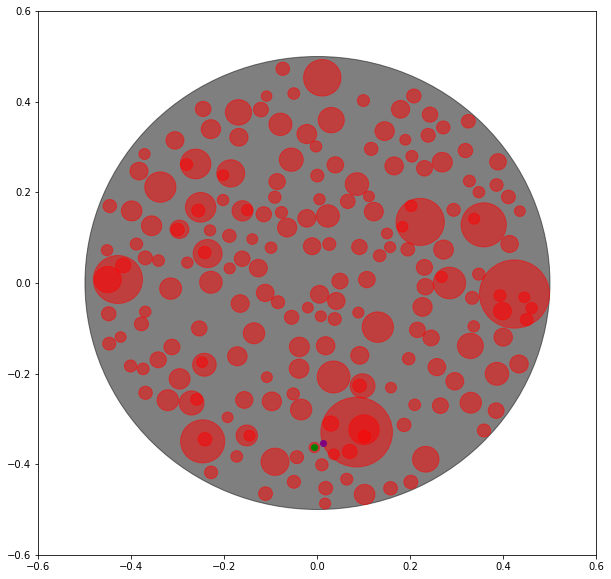

(-0.4356888765268826, -0.21988139885338218) (-0.4096708903543469, -0.1940177250106432) (<KDNode - (-0.4096708903543469, -0.1940177250106432)>, 0.0013458652291178388) 0.036686035887212434 0.01143100057690545


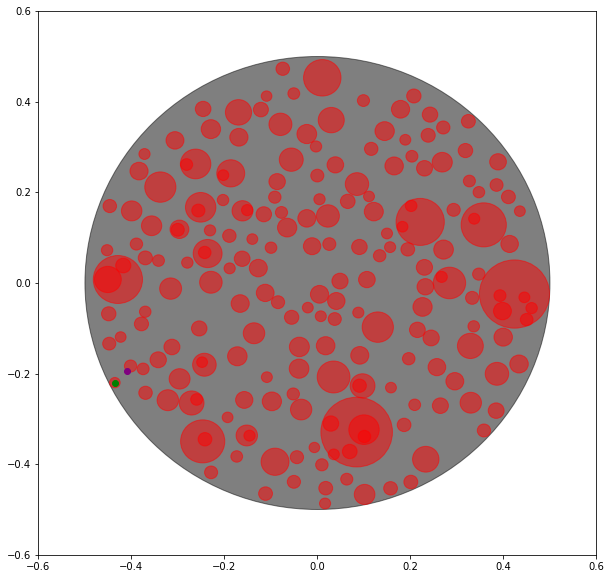

(-0.13913609437289315, 0.12596853905062272) (-0.14001003199297218, 0.10867717740386383) (<KDNode - (-0.14001003199297218, 0.10867717740386383)>, 0.0002997549545627936) 0.017313432778129058 0.011418723270233275


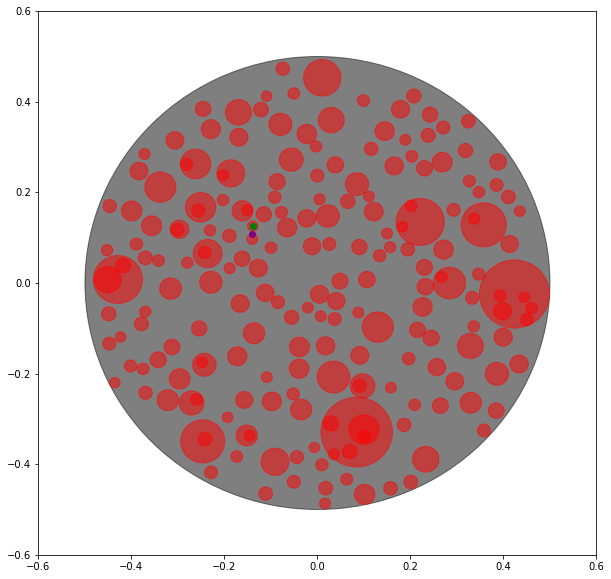

(0.2489072980958662, -0.23061650644433548) (0.2590388530730858, -0.25438101740499774) (<KDNode - (0.2590388530730858, -0.25438101740499774)>, 0.0006674003874558593) 0.025834093509466503 0.011402815368562243


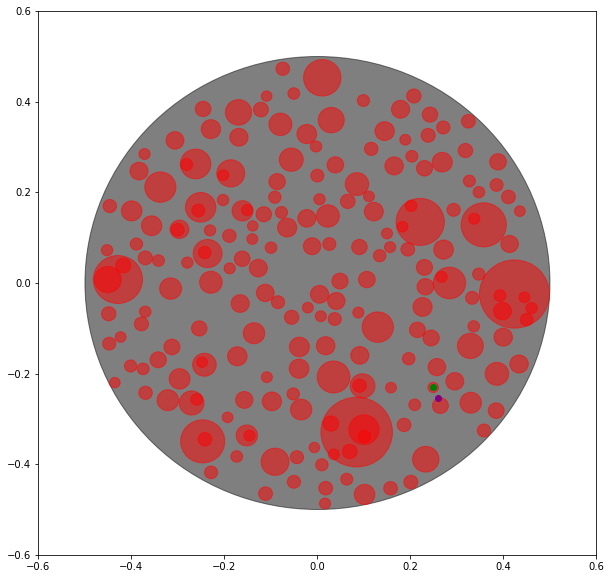

(0.3246924047666032, -0.12716270729158793) (0.3202449306491394, -0.11236069864755685) (<KDNode - (0.3202449306491394, -0.11236069864755685)>, 0.00023887948592348152) 0.01545572663848198 0.011368992023709987


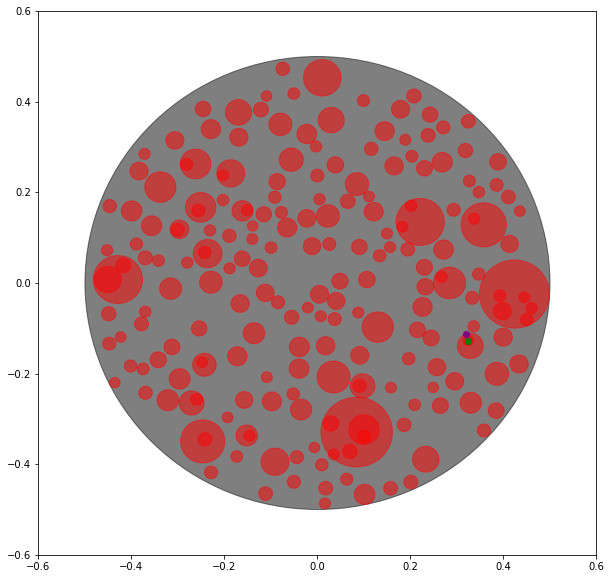

(0.4258413023805372, -0.08809838754409546) (0.4369386454672763, -0.08502721614309398) (<KDNode - (0.4369386454672763, -0.08502721614309398)>, 0.00013258311735912543) 0.0115144742545687 0.011342801332938779


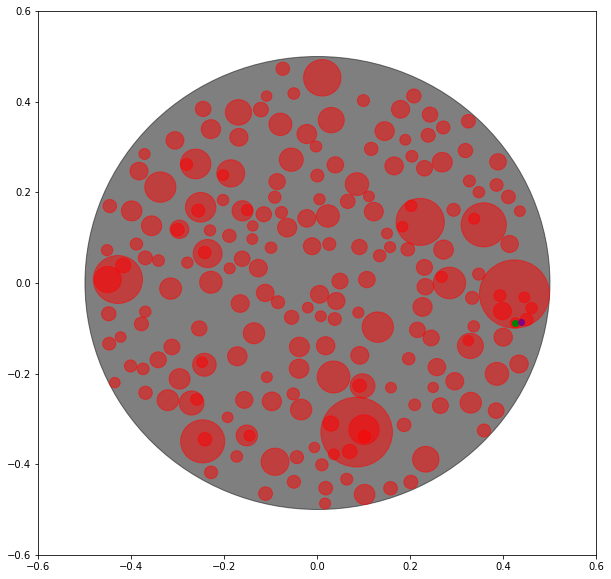

(0.2523064101905144, 0.41715413876366186) (0.22282942607742157, 0.4128434527496178) (<KDNode - (0.22282942607742157, 0.4128434527496178)>, 0.0008874746063152034) 0.029790512018345764 0.011338080583516694


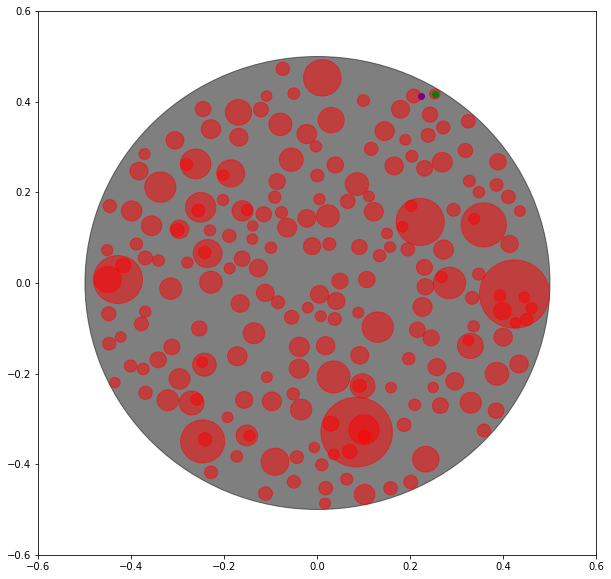

(0.16681638364988474, 0.034298111582536886) (0.144718384079262, 0.052262303850804534) (<KDNode - (0.144718384079262, 0.052262303850804534)>, 0.0008110337888745304) 0.028478654969547462 0.011322838944773867


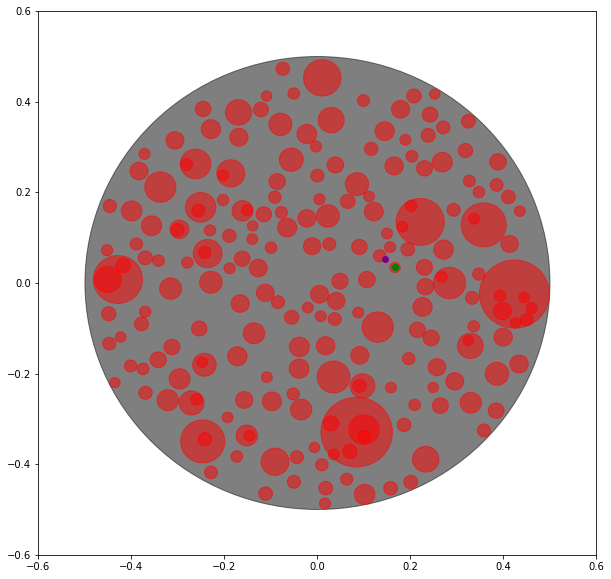

(-0.3597075181967598, -0.26800153559882794) (-0.36520798807937777, -0.25624358997601093) (<KDNode - (-0.36520798807937777, -0.25624358997601093)>, 0.00016850445419870925) 0.012980926553937098 0.011310155820209855


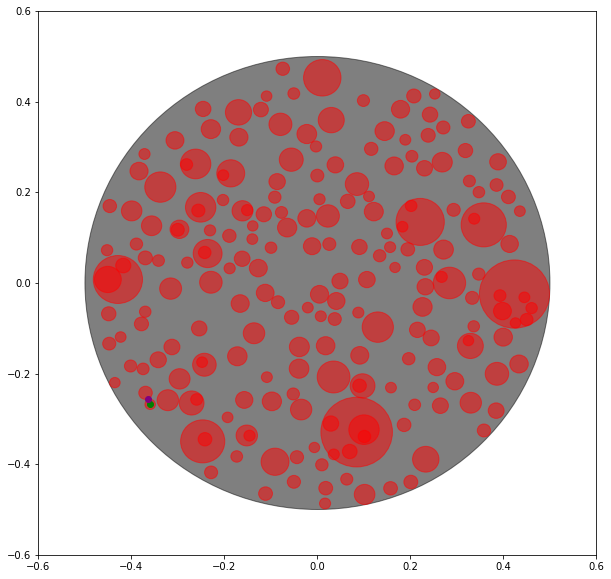

(-0.06644842788134019, 0.06678581266324209) (-0.08787434170513012, 0.07404896030427821) (<KDNode - (-0.08787434170513012, 0.07404896030427821)>, 0.000511823096839961) 0.022623507615751385 0.011190903969189692


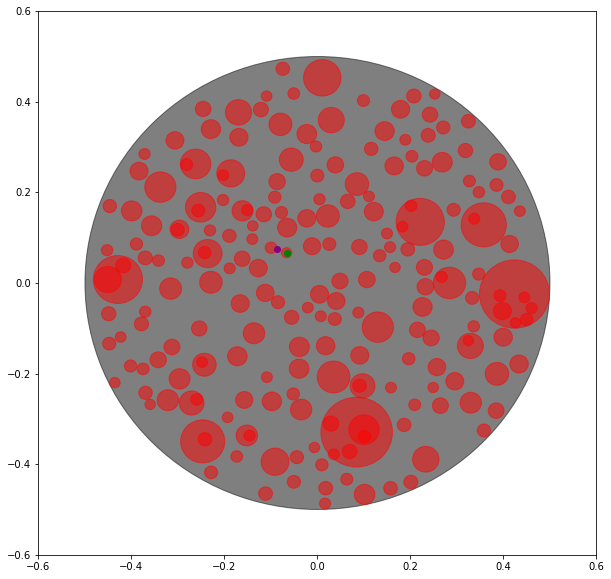

(0.11042801818859421, -0.053344271192786216) (0.09759429905551271, -0.05822931934752384) (<KDNode - (0.09759429905551271, -0.05822931934752384)>, 0.00018856804226092755) 0.013732007947162263 0.011109799355037994


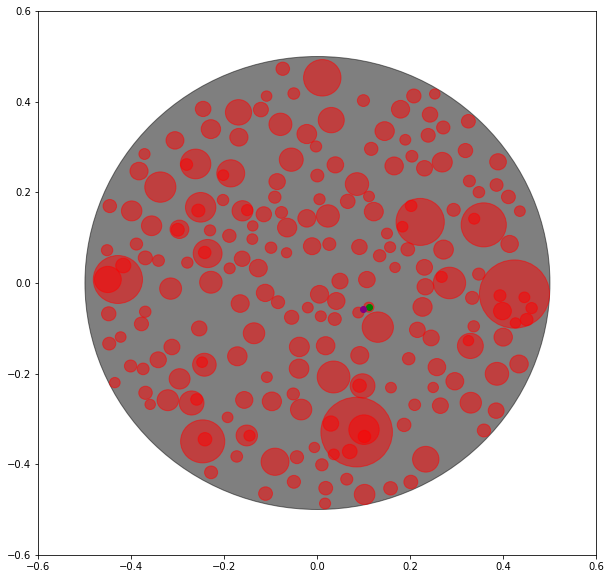

(0.46556028503221886, 0.004139008815304504) (0.48468428706300903, 0.019910425670078835) (<KDNode - (0.48468428706300903, 0.019910425670078835)>, 0.0006144650432807267) 0.02478840542029129 0.011076172636939927


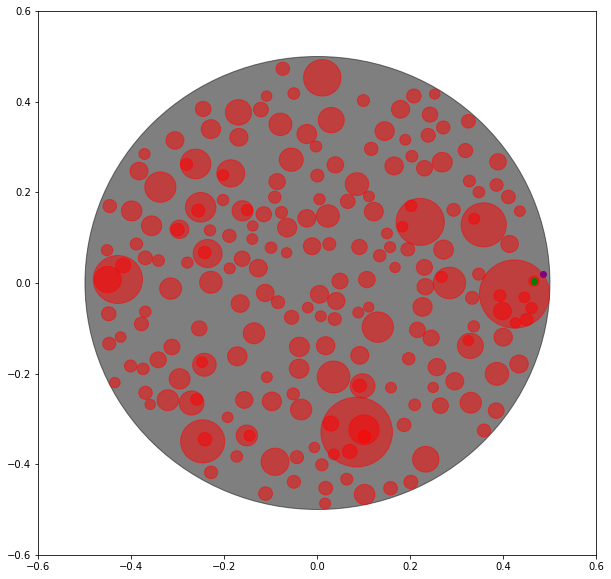

(-0.034259431607825054, -0.18791599512618087) (-0.019362771534949814, -0.18253753390945596) (<KDNode - (-0.019362771534949814, -0.18253753390945596)>, 0.0002508383263866094) 0.01583787632186239 0.011028428869423144


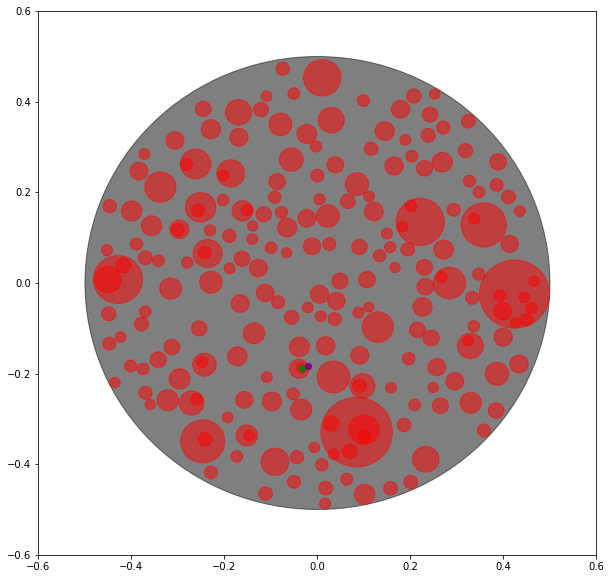

(-0.08316696761445645, 0.4153647810133996) (-0.09786760681785127, 0.4125653227333515) (<KDNode - (-0.09786760681785127, 0.4125653227333515)>, 0.0002239457596501183) 0.01496481739447957 0.011023051282778229


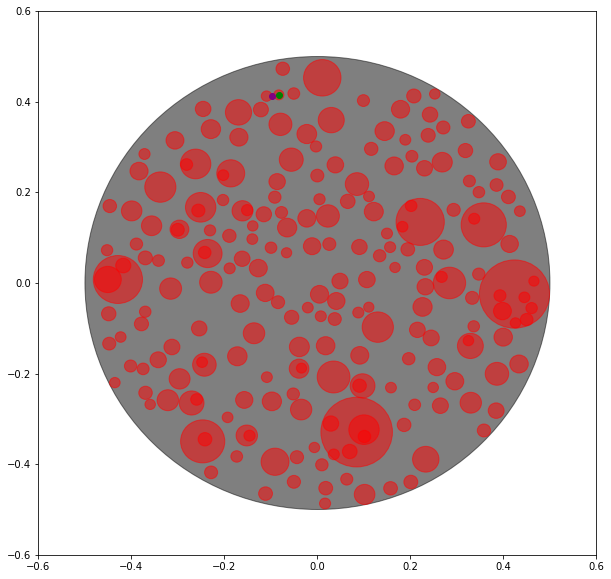

(0.21204926832053855, 0.1050968295555292) (0.2049024763548004, 0.0854972649774809) (<KDNode - (0.2049024763548004, 0.0854972649774809)>, 0.0004352195670506245) 0.020861916667713552 0.01101655639494456


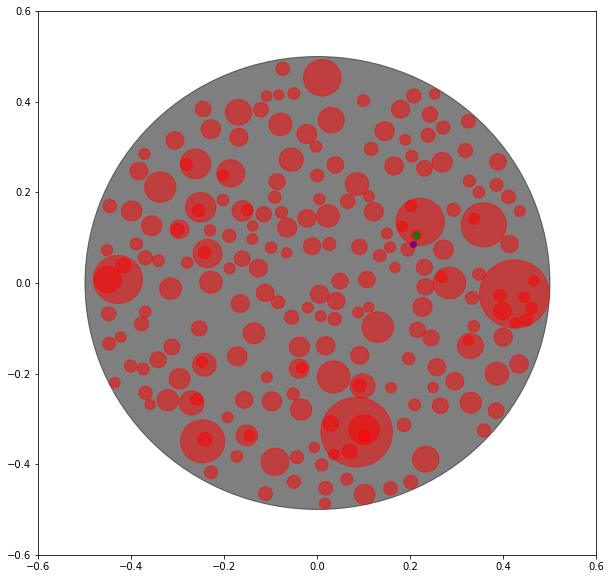

(-0.17484030587405228, -0.16613780907195463) (-0.1846264397729282, -0.17876355031540506) (<KDNode - (-0.1846264397729282, -0.17876355031540506)>, 0.00025517775863329343) 0.015974284291738815 0.01098479297098746


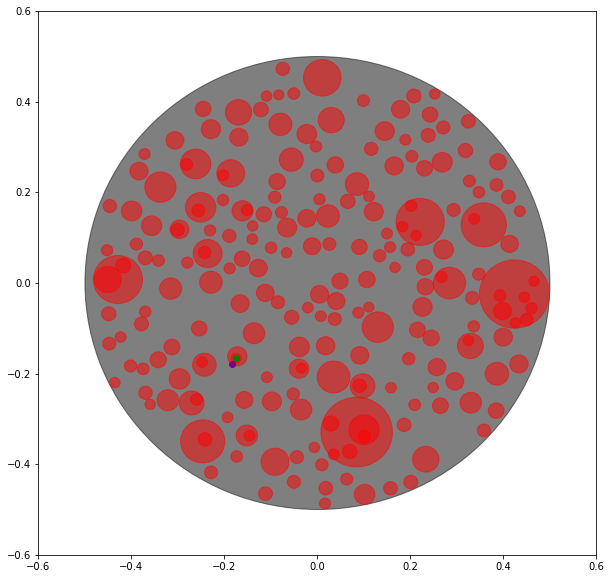

(-0.3028541420085578, -0.2899065091510723) (-0.30817198755784464, -0.27741185541564733) (<KDNode - (-0.30817198755784464, -0.27741185541564733)>, 0.00018439585325423873) 0.013579243471351367 0.010910881481125387


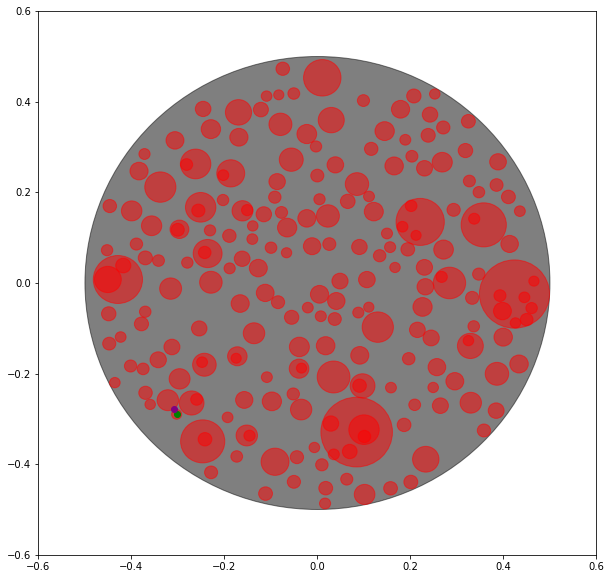

(-0.12232854781905168, 0.2999953138756968) (-0.15025734281274086, 0.315669582664474) (<KDNode - (-0.15025734281274086, 0.315669582664474)>, 0.001025700291862353) 0.03202655604123479 0.010910811135314485


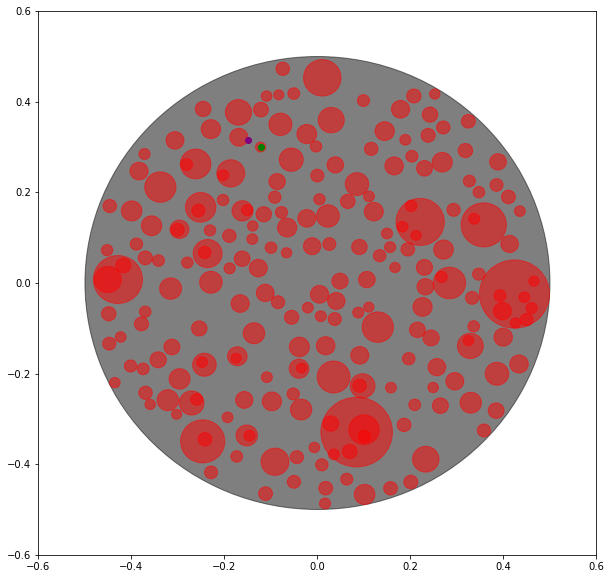

(-0.1718684528774615, 0.39050035160816793) (-0.16979517965376045, 0.4048760898218068) (<KDNode - (-0.16979517965376045, 0.4048760898218068)>, 0.00021096031104719218) 0.014524472831989193 0.01082321281704344


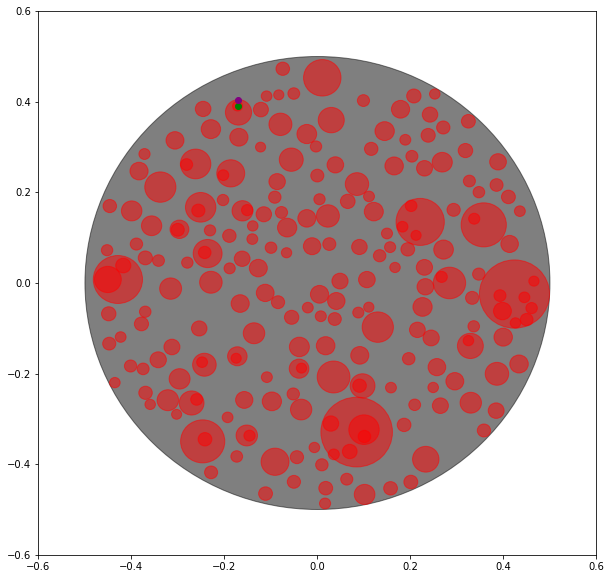

(-0.29470190934361495, 0.38808797742347717) (-0.2627043088348339, 0.3842495491665406) (<KDNode - (-0.2627043088348339, 0.3842495491665406)>, 0.0010385799698031935) 0.03222700683903476 0.010817609050741627


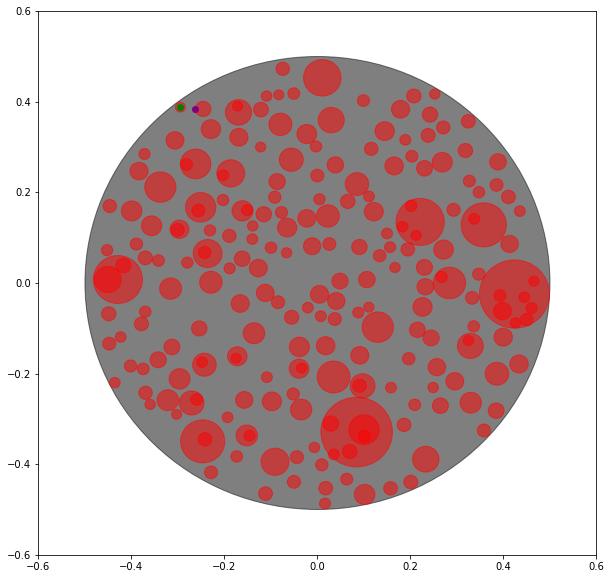

(0.21619373584036514, -0.18731684930218603) (0.20426191943435498, -0.1781019155264873) (<KDNode - (0.20426191943435498, -0.1781019155264873)>, 0.0002272832472372464) 0.015075916132601905 0.010763354263586877


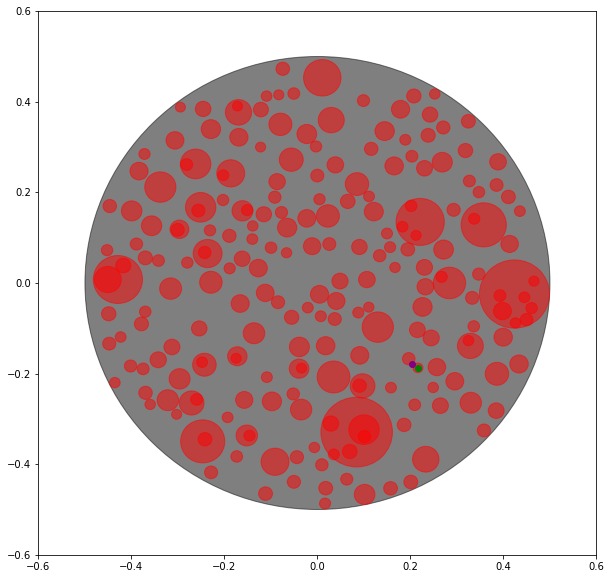

(-0.024885426435008653, -0.22703932386476255) (-0.04120606525693381, -0.23713768391523293) (<KDNode - (-0.04120606525693381, -0.23713768391523293)>, 0.0003683401272646666) 0.019192189225428834 0.01075832575007736


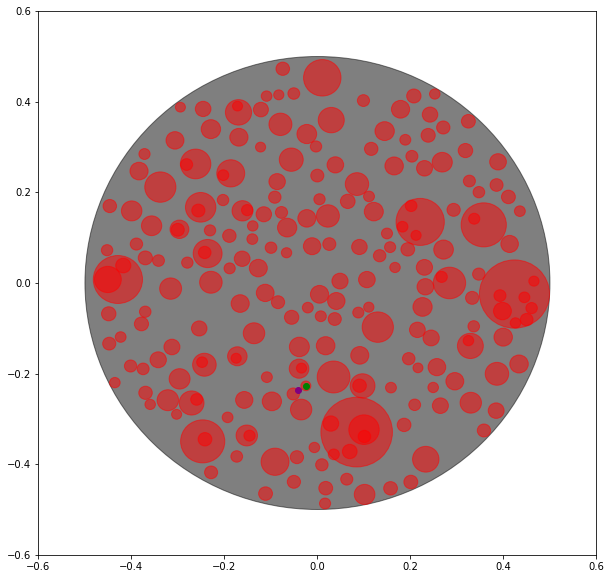

(-0.09258371658495934, 0.012187275019843732) (-0.10107520835050314, -0.0063857510245649025) (<KDNode - (-0.10107520835050314, -0.0063857510245649025)>, 0.00041706272885057966) 0.020422113721419232 0.010743922637898458


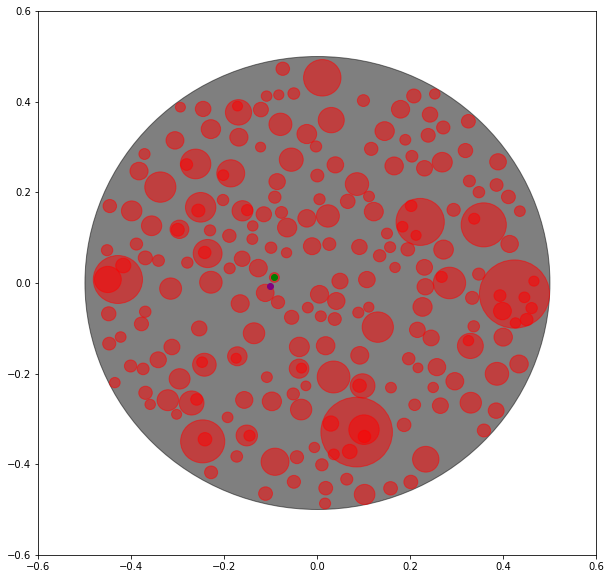

(0.45678378040515744, 0.1256563621341657) (0.4421895486549377, 0.14907882066070172) (<KDNode - (0.4421895486549377, 0.14907882066070172)>, 0.0007616031638064215) 0.027597158618350937 0.010741922166847093


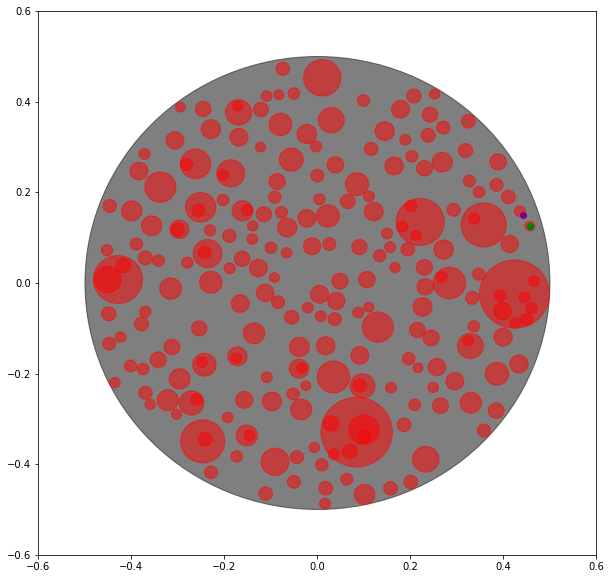

(0.0695018537336425, -0.12074765247102383) (0.07961261713411642, -0.14393291610940923) (<KDNode - (0.07961261713411642, -0.14393291610940923)>, 0.0006397839865217993) 0.025293951579810525 0.01071550601754417


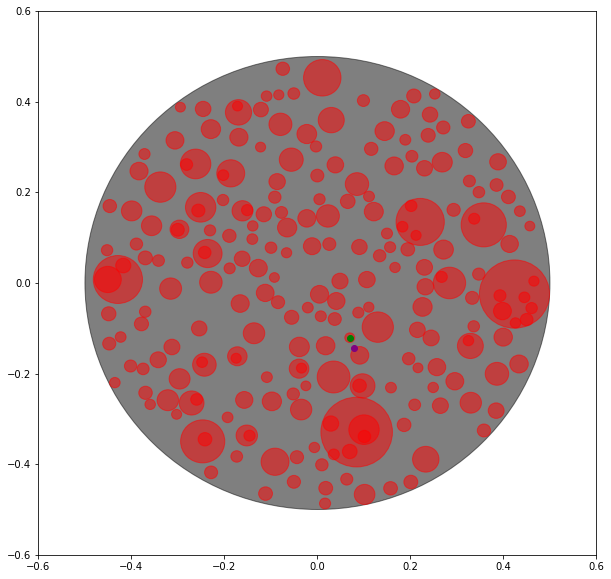

(0.417488071877793, -0.005069202462425968) (0.4030386608778635, -0.020234622331762687) (<KDNode - (0.4030386608778635, -0.020234622331762687)>, 0.0004387754380581573) 0.020946967275912696 0.010714270359973172


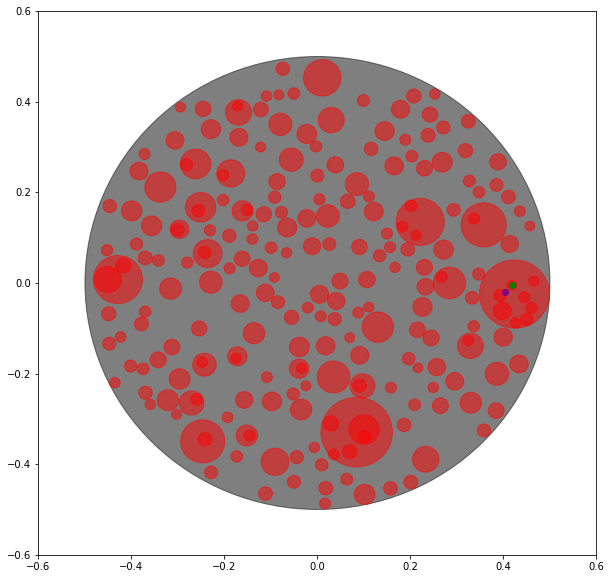

(0.13208575556188154, -0.19280954874283274) (0.11867617941778175, -0.2113906600642853) (<KDNode - (0.11867617941778175, -0.2113906600642853)>, 0.0005250744303046231) 0.022914502619621118 0.010633175451088248


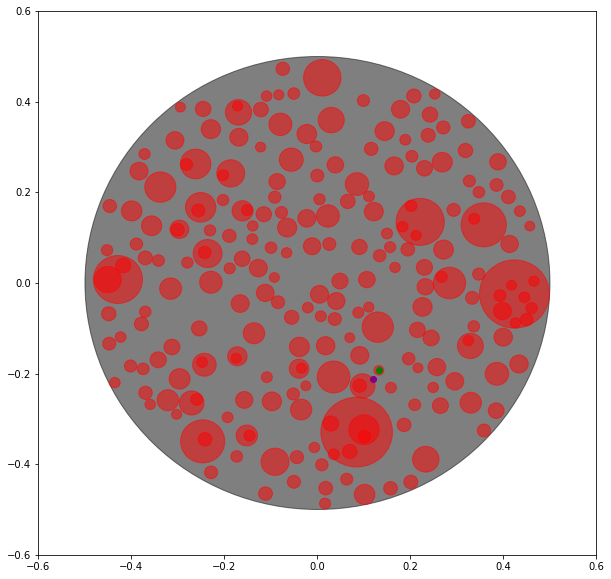

(-0.12666748164263059, 0.2199374286267677) (-0.1044210306292007, 0.22381428654234817) (<KDNode - (-0.1044210306292007, 0.22381428654234817)>, 0.0005099346099905343) 0.02258173177571938 0.010554112035639374


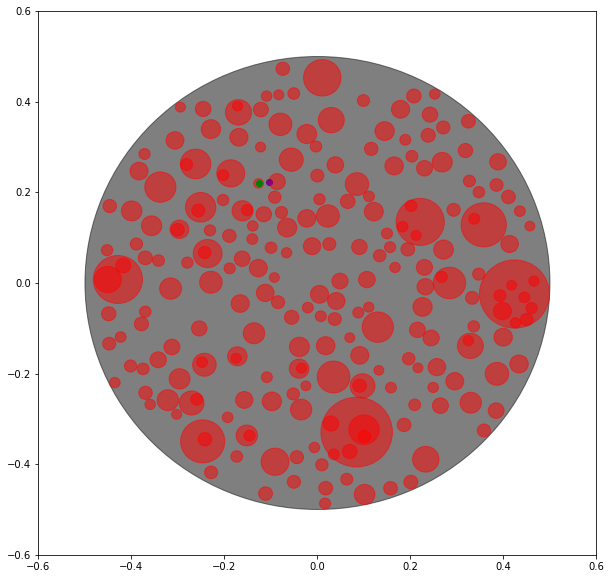

(-0.4084951007513244, -0.21152236916814737) (-0.40594753504601766, -0.19591486929774712) (<KDNode - (-0.40594753504601766, -0.19591486929774712)>, 0.00025008414322739877) 0.015814048919470268 0.010551984657847733


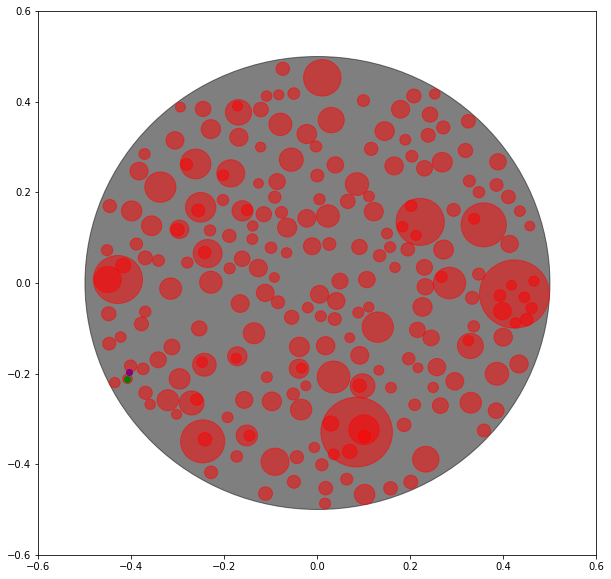

(-0.11244396554257859, -0.16904551387084168) (-0.10879140136030632, -0.1960565148253154) (<KDNode - (-0.10879140136030632, -0.1960565148253154)>, 0.0007429353976681974) 0.027256841300271707 0.010531616489416968


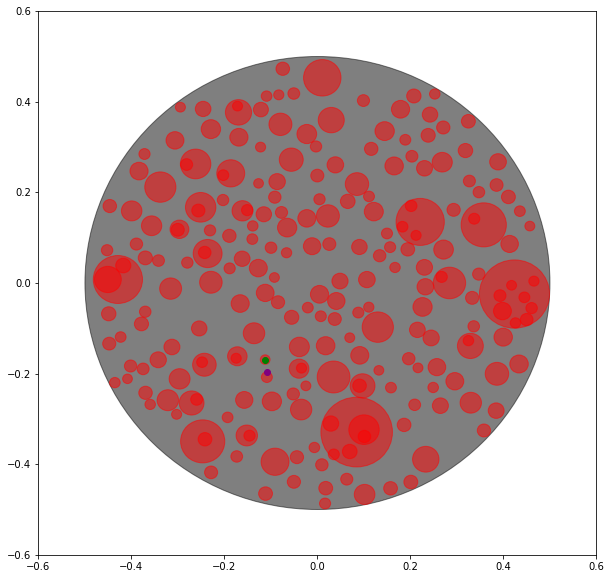

(-0.2252460318600004, -0.1424732711989604) (-0.23526047791645494, -0.15629844501724816) (<KDNode - (-0.23526047791645494, -0.15629844501724816)>, 0.00029142456092350755) 0.01707116167469301 0.0104676898995398


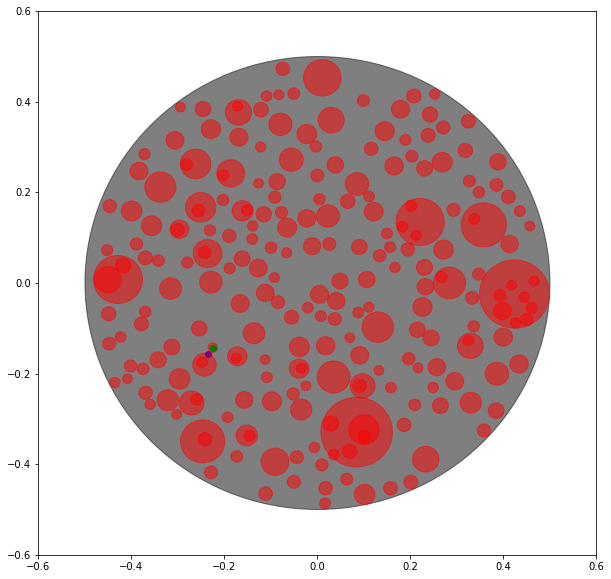

(0.3616362092630189, -0.08055928753567358) (0.3627990255033111, -0.06864440039009875) (<KDNode - (0.3627990255033111, -0.06864440039009875)>, 0.00014331667730047153) 0.01197149436371548 0.010427449360419888


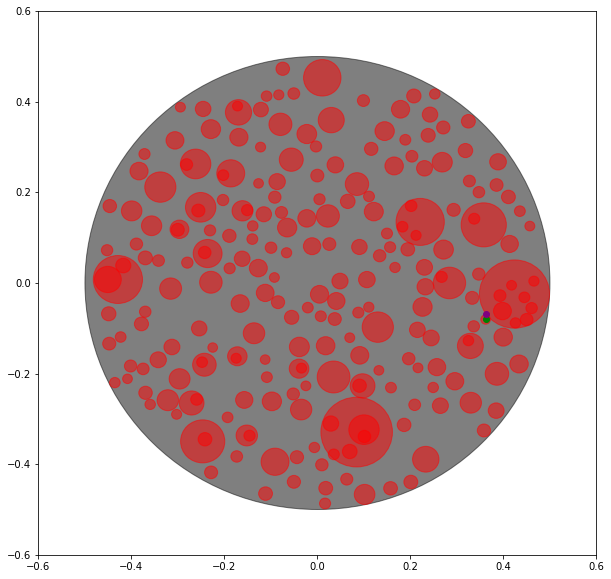

(0.370943762664989, -0.1464248097181254) (0.35537741445407806, -0.14749318245249554) (<KDNode - (0.35537741445407806, -0.14749318245249554)>, 0.00024345261692287646) 0.015602968208737607 0.010404606197198924


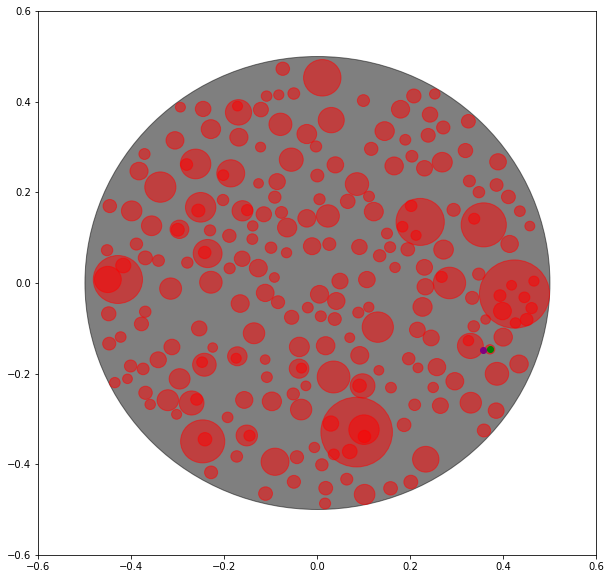

(-0.3294014167309766, -0.30108724341739057) (-0.31323100693970624, -0.29327815695235093) (<KDNode - (-0.31323100693970624, -0.29327815695235093)>, 0.0003224639842360782) 0.017957282206282725 0.01036176916105324


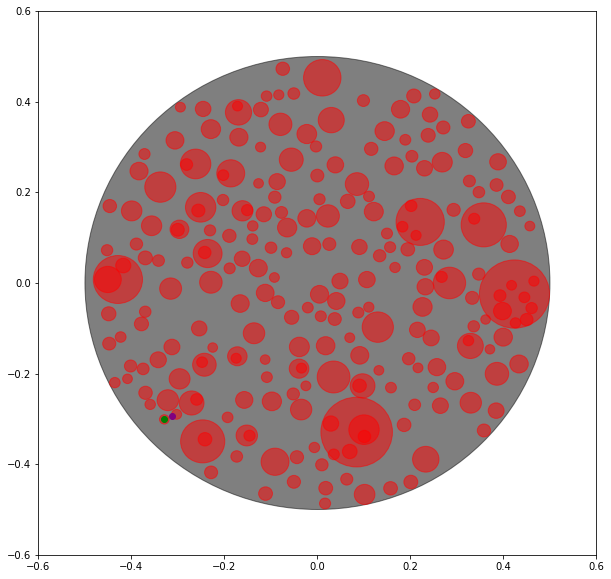

(0.10332645060424864, -0.47181154920645674) (0.10828554660569555, -0.48791756171417494) (<KDNode - (0.10828554660569555, -0.48791756171417494)>, 0.0002839962720503419) 0.01685218893943282 0.010325985435469679


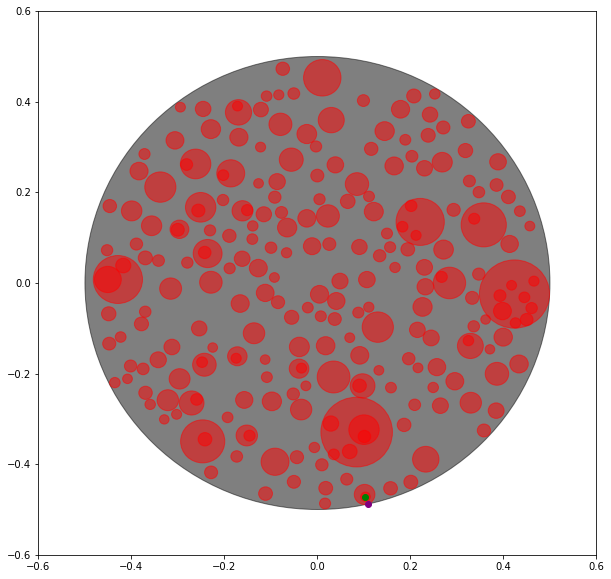

(-0.12042110457857663, -0.31560839540630253) (-0.13328834105676163, -0.3230026757032053) (<KDNode - (-0.13328834105676163, -0.3230026757032053)>, 0.00022024115569469892) 0.014840524104447892 0.010316485385193726


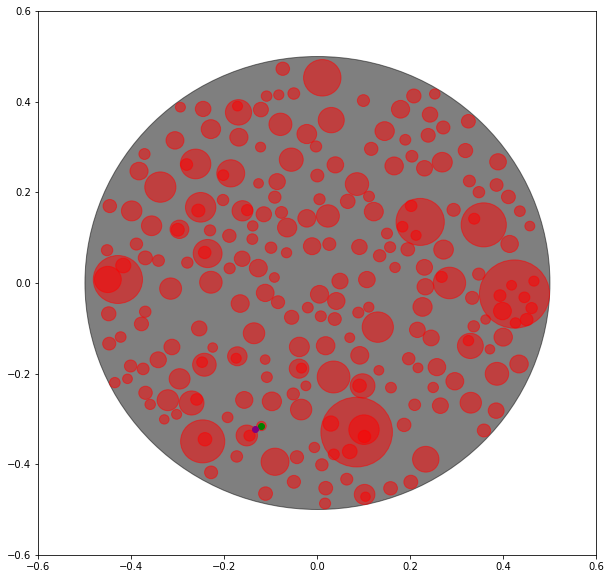

(-0.3785914065905279, -0.21433548136231778) (-0.3748610522420099, -0.20247598094949426) (<KDNode - (-0.3748610522420099, -0.20247598094949426)>, 0.00015456329360726868) 0.012432348676226414 0.01028504124519687


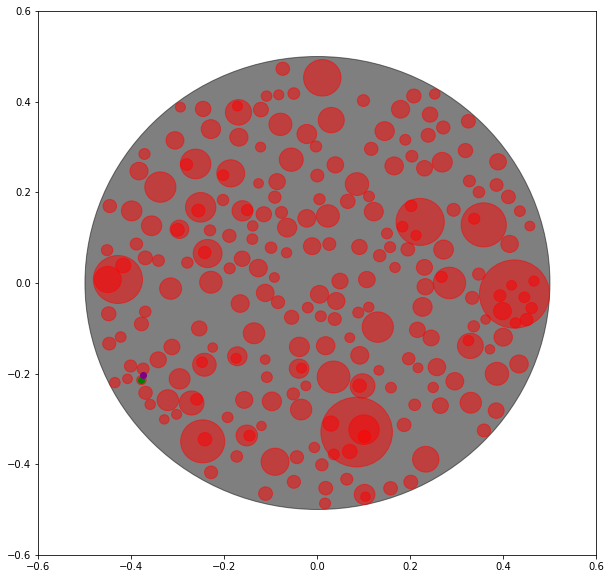

(-0.3045758373751097, -0.32507991915099815) (-0.2919626300054563, -0.3349343234681918) (<KDNode - (-0.2919626300054563, -0.3349343234681918)>, 0.00025620228459660304) 0.016006320145386416 0.010272813956114445


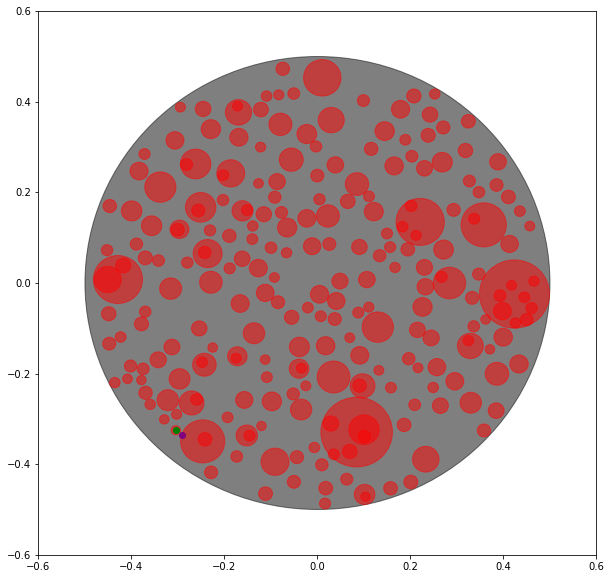

(0.025090293385728754, -0.34380129261306863) (0.011149816518738878, -0.352876783248005) (<KDNode - (0.011149816518738878, -0.352876783248005)>, 0.0002767014255438972) 0.01663434475847778 0.010265863118283843


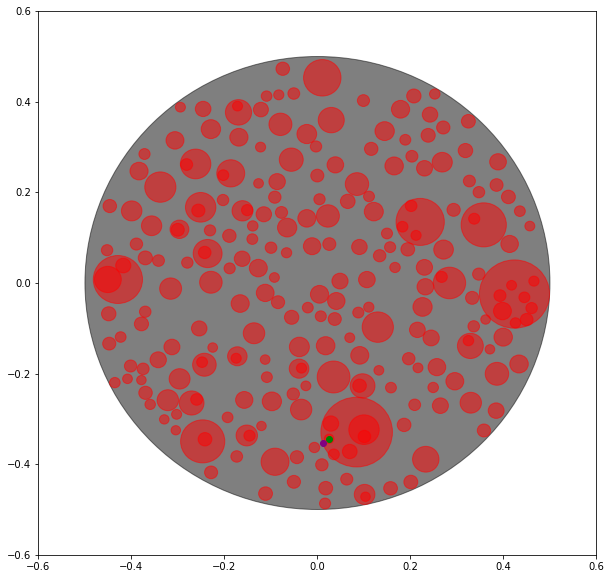

(-0.17255899278702577, -0.09415026294546973) (-0.15842716021299255, -0.10378583015123811) (<KDNode - (-0.15842716021299255, -0.10378583015123811)>, 0.0002925528472773856) 0.017104176310988657 0.010249663607355122


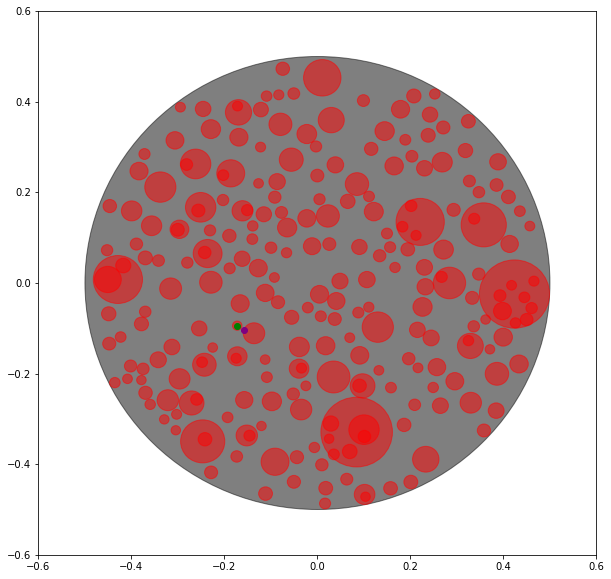

(0.1953138785682132, -0.0603635466311934) (0.2063335046810075, -0.05924063682852682) (<KDNode - (0.2063335046810075, -0.05924063682852682)>, 0.00012269308609070284) 0.011076691116515927 0.010240973418728637


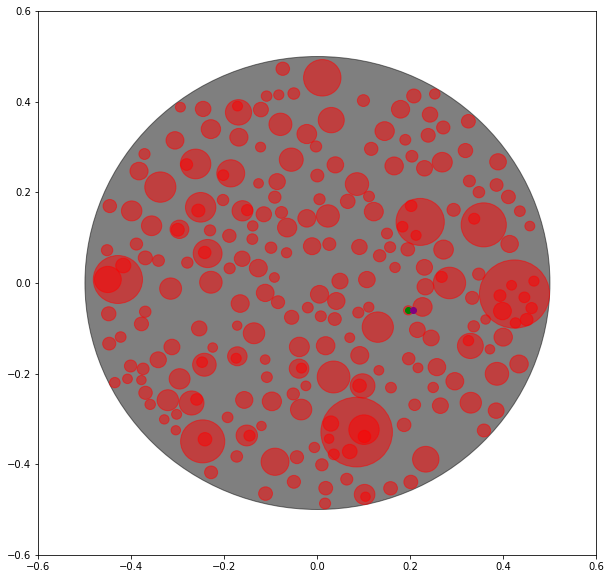

(-0.019847999894933552, 0.026124246049483685) (-0.0015495310543110962, -0.006301707570526106) (<KDNode - (-0.0015495310543110962, -0.006301707570526106)>, 0.0013862764300782567) 0.03723273331462863 0.010225466343603311


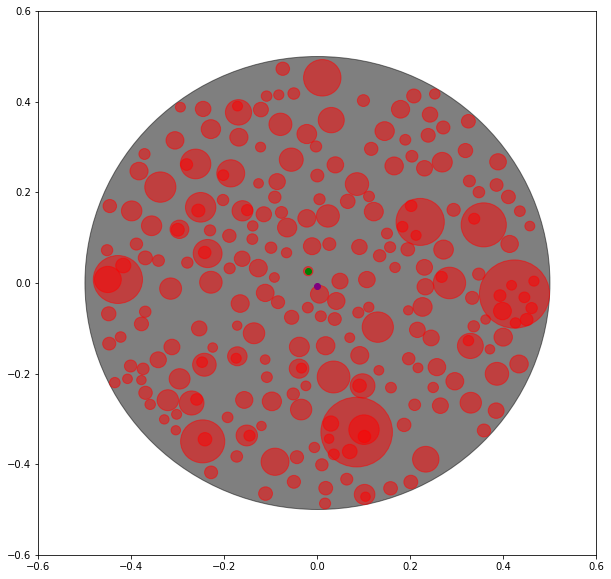

(-0.11146349026700748, -0.1363251928803172) (-0.122824049314605, -0.12965300434820784) (<KDNode - (-0.122824049314605, -0.12965300434820784)>, 0.00017358040168196132) 0.013174991524929392 0.010207097463736573


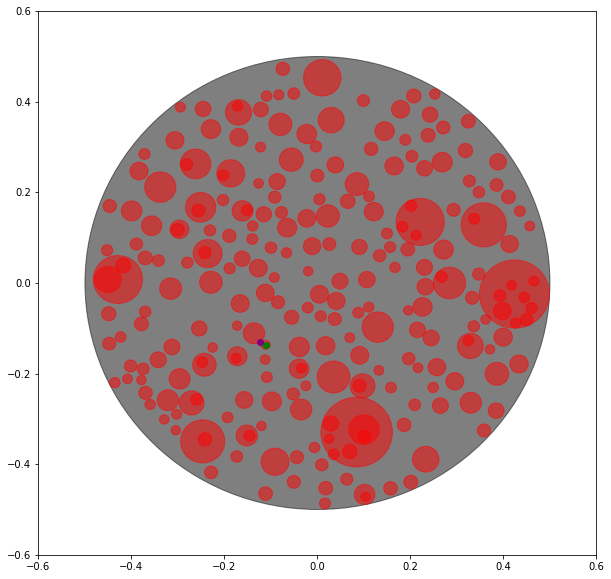

(-0.21277814782191237, -0.09027224220243994) (-0.23831968012603783, -0.09516157563112704) (<KDNode - (-0.23831968012603783, -0.09516157563112704)>, 0.0006762754538195612) 0.026005296649328213 0.01016263501673786


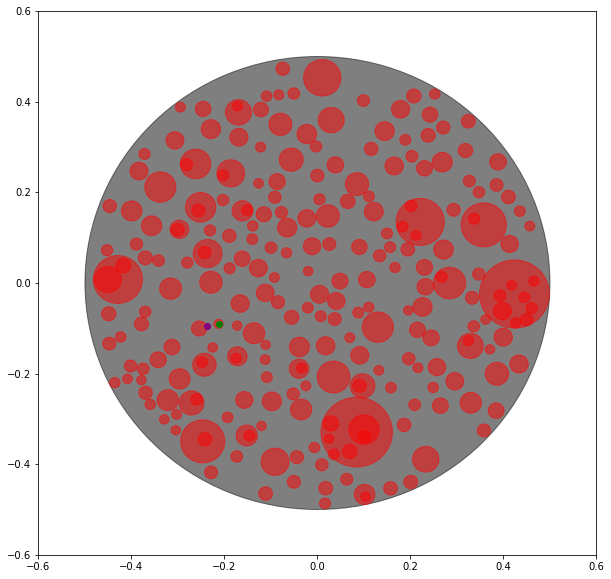

(0.19181925166407038, -0.12149861550309451) (0.20117125168595154, -0.1134206015643814) (<KDNode - (0.20117125168595154, -0.1134206015643814)>, 0.00015271421360330868) 0.012357759246858172 0.010141749793327099


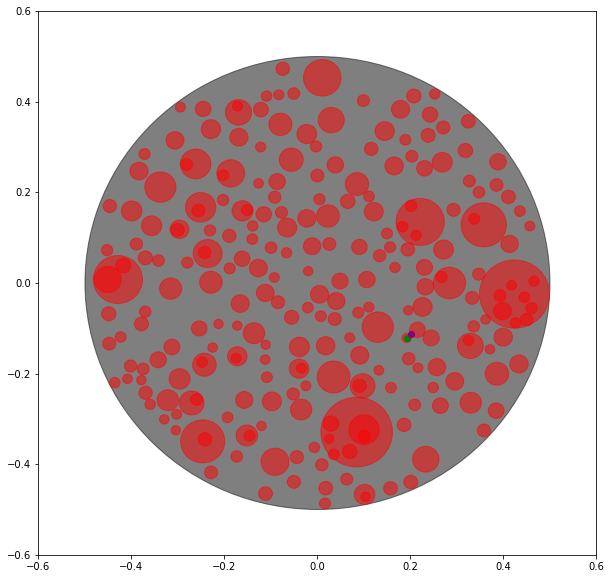

(0.05447909147654674, 0.3052029043897593) (0.044041341603488465, 0.27776983756376833) (<KDNode - (0.044041341603488465, 0.27776983756376833)>, 0.0008615197778918132) 0.02935165715750668 0.010133648748184336


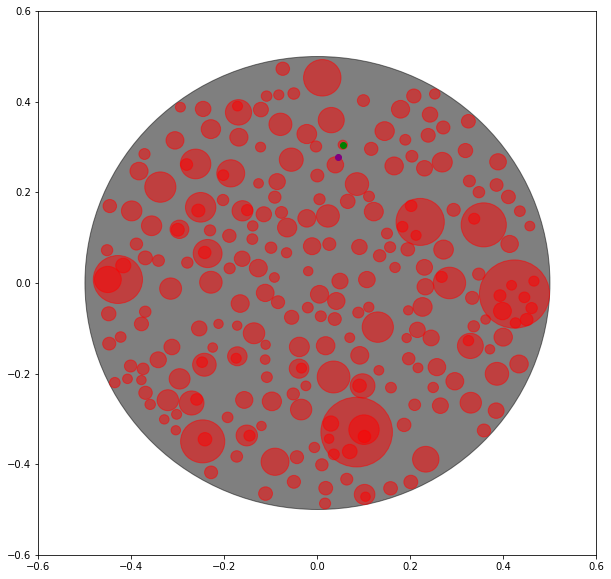

(-0.15159511572076342, -0.28692493227442306) (-0.15167805710201374, -0.2758531371965184) (<KDNode - (-0.15167805710201374, -0.2758531371965184)>, 0.00012259152551983795) 0.011072105740094698 0.010129387422955069


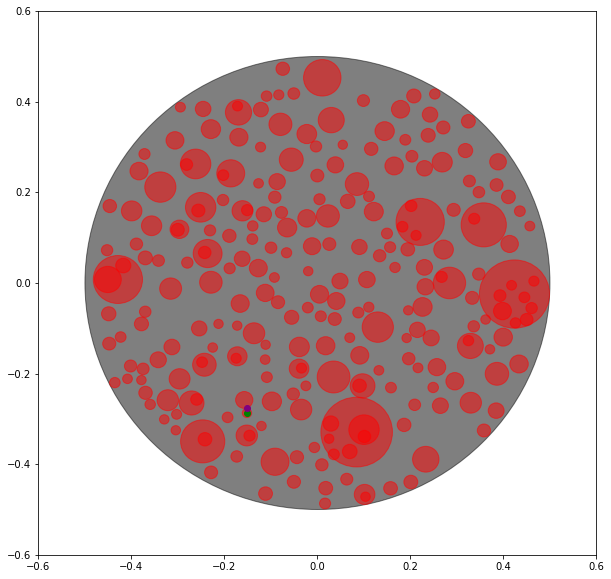

(0.027826110749803533, 0.2282819838347195) (0.013101845827789458, 0.23275675548294986) (<KDNode - (0.013101845827789458, 0.23275675548294986)>, 0.0002368275587974603) 0.01538920266932177 0.010085115114175236


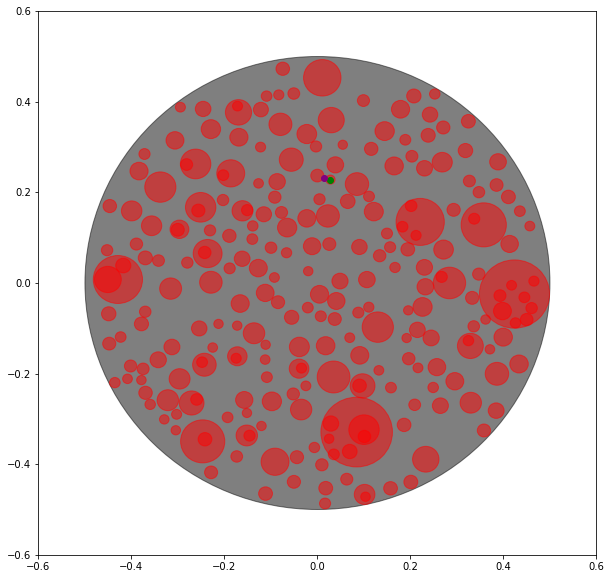

(-0.12688627050614945, -0.4359079150805607) (-0.12038402968170439, -0.45279834327211943) (<KDNode - (-0.12038402968170439, -0.45279834327211943)>, 0.00032756570023328177) 0.01809877620816617 0.010039080403225832


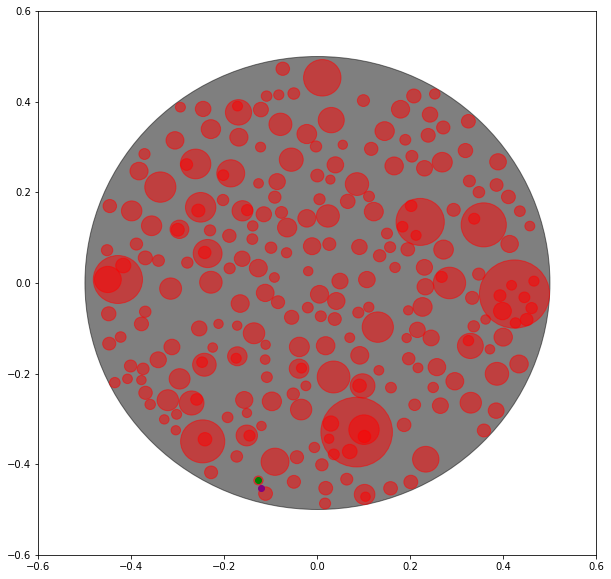

(-0.13597832795602724, -0.18465831818549144) (-0.12096422226075634, -0.1752358427261212) (<KDNode - (-0.12096422226075634, -0.1752358427261212)>, 0.00031420641361120055) 0.01772586848679637 0.009998688538963739


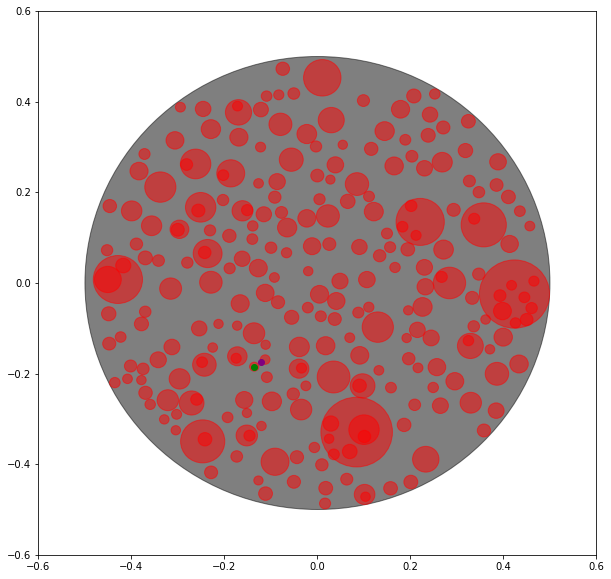

(-0.03639566811606712, -0.47232191326528267) (-0.04625976758017295, -0.45245239612869637) (<KDNode - (-0.04625976758017295, -0.45245239612869637)>, 0.0004920981694788696) 0.0221832858133972 0.009990317835334762


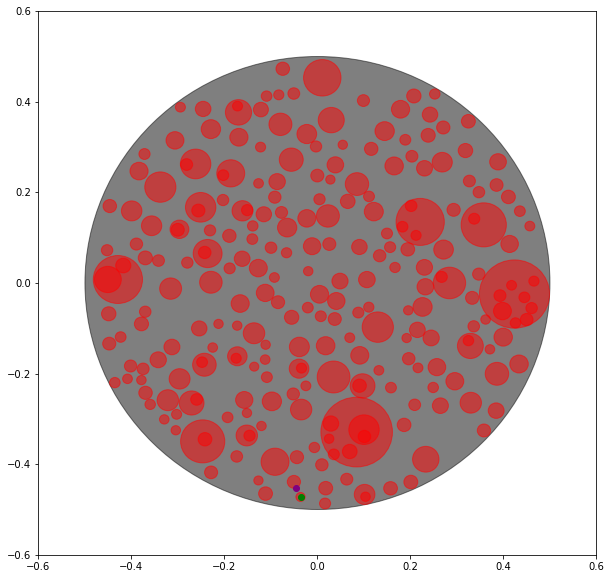

(0.025730575769573678, 0.4337860603085123) (0.034061868170807925, 0.4203976239543871) (<KDNode - (0.034061868170807925, 0.4203976239543871)>, 0.0002486606610833242) 0.015768977807179646 0.00998132495641295


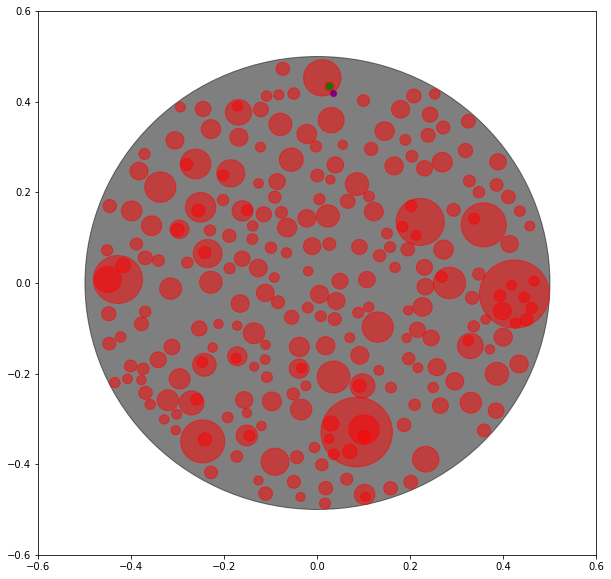

(-0.4564890939583562, 0.09659169557697717) (-0.45620997009260755, 0.08413072440199194) (<KDNode - (-0.45620997009260755, 0.08413072440199194)>, 0.00015535371275624305) 0.012464096949087127 0.009895349268729339


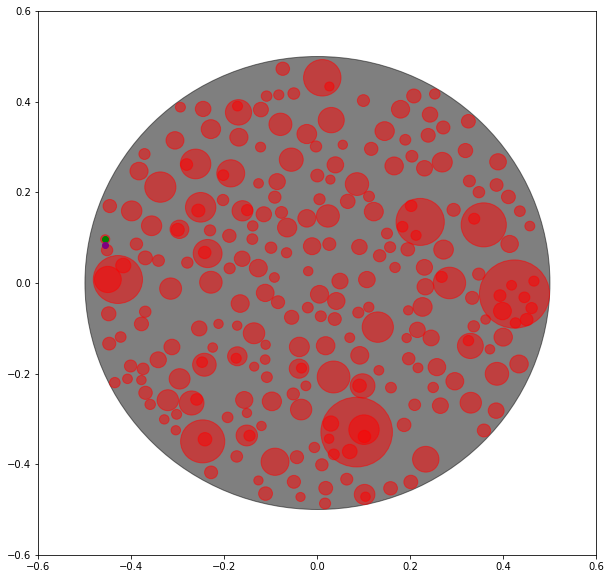

(-0.30740752546170547, 0.07210577696553788) (-0.2897946921052815, 0.05225885050692255) (<KDNode - (-0.2897946921052815, 0.05225885050692255)>, 0.0007041123886948452) 0.02653511614247892 0.00988887047396392


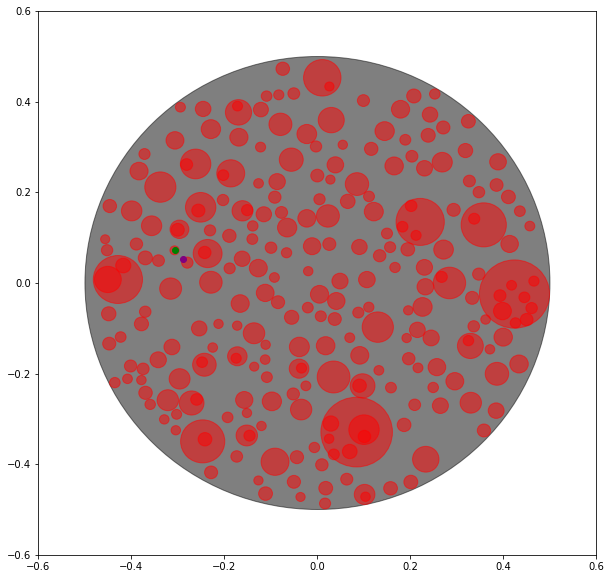

(-0.017729528798977597, 0.37123328840619885) (0.0029918684696658877, 0.36823263899714487) (<KDNode - (0.0029918684696658877, 0.36823263899714487)>, 0.0004383802016410017) 0.020937530934687636 0.00988706574254645


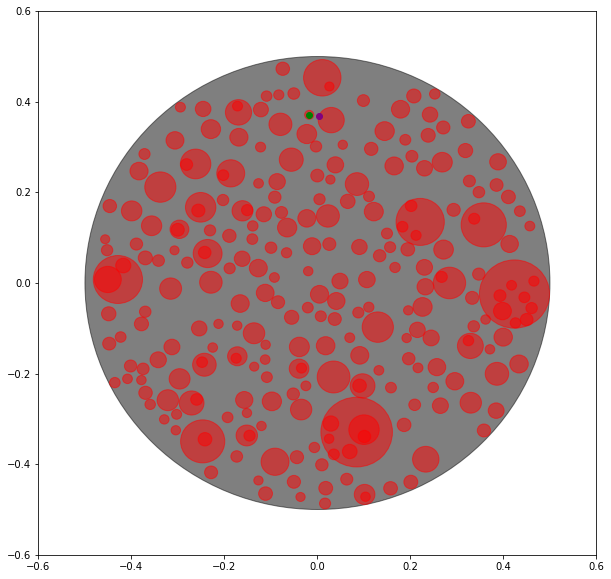

(-0.12175079595254452, 0.32366421455162336) (-0.12232854781905168, 0.3109061250110113) (<KDNode - (-0.12232854781905168, 0.3109061250110113)>, 0.00016310264594552795) 0.012771164627610434 0.009875569827984947


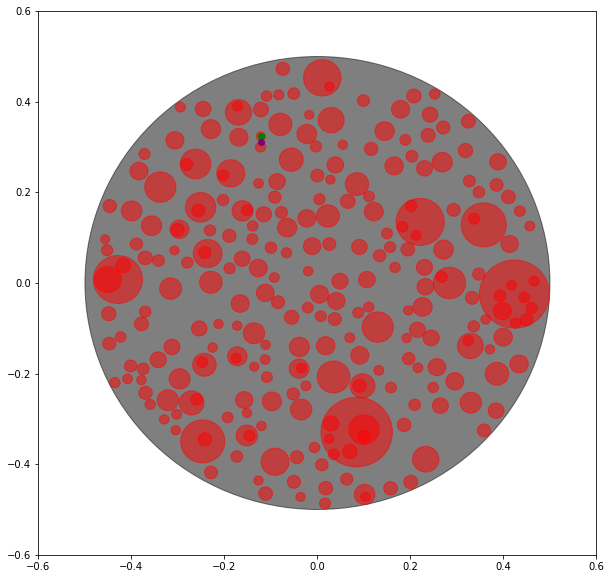

(-0.09526227679093668, -0.22578602336997902) (-0.10184423832487814, -0.21743768412952513) (<KDNode - (-0.10184423832487814, -0.21743768412952513)>, 0.0001130169857079872) 0.010630944723211912 0.009860305420595192


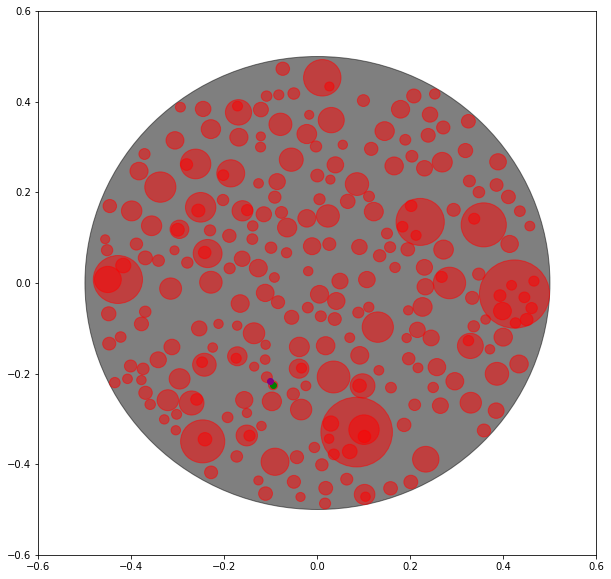

(0.2467870734915848, -0.3515469541701235) (0.2417540291234989, -0.3619842391341833) (<KDNode - (0.2417540291234989, -0.3619842391341833)>, 0.00013426845303211055) 0.011587426506006868 0.009859059891938035


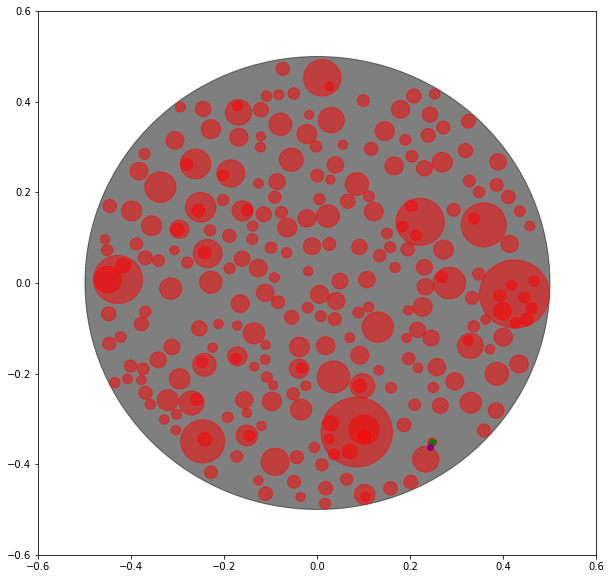

(0.2371805237370418, 0.30013013306902553) (0.23808570190599546, 0.3107421427189454) (<KDNode - (0.23808570190599546, 0.3107421427189454)>, 0.00011343409632754282) 0.010650544414608241 0.009851135423057909


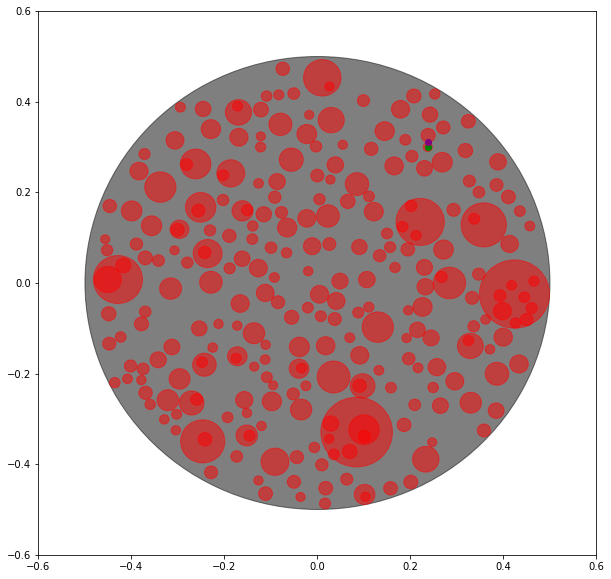

(-0.19061433511446507, 0.4209494936555475) (-0.178498530061593, 0.4034976145385139) (<KDNode - (-0.178498530061593, 0.4034976145385139)>, 0.00045136081679475427) 0.0212452539828253 0.00983427228574598


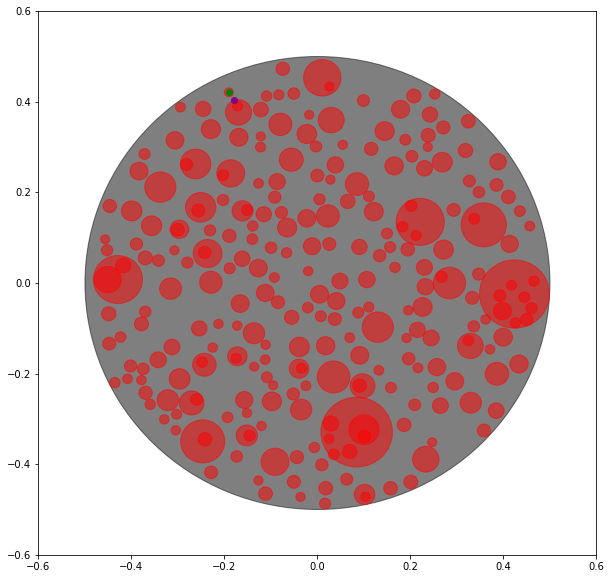

(-0.3306484413689339, 0.20336670670903786) (-0.3181553476919722, 0.1845898834950252) (<KDNode - (-0.3181553476919722, 0.1845898834950252)>, 0.0005086464796316258) 0.02255319222708009 0.009787763557034866


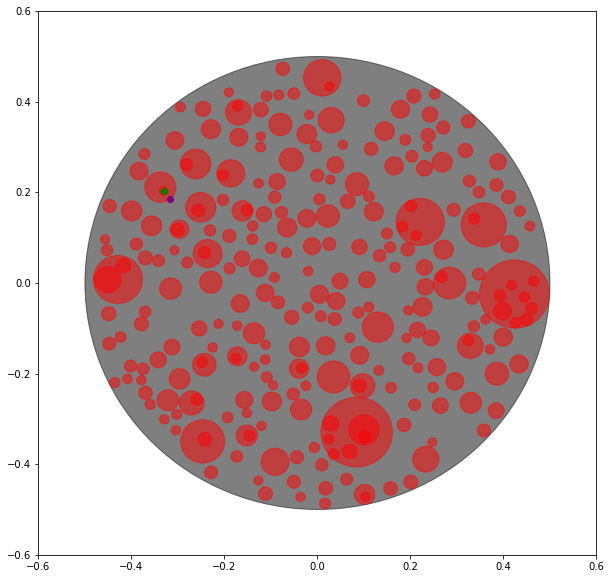

(-0.024233458518968957, -0.44558816349308566) (-0.03711301130866845, -0.44330563985719185) (<KDNode - (-0.03711301130866845, -0.44330563985719185)>, 0.00017109279421107) 0.013080244424744899 0.009785606837095234


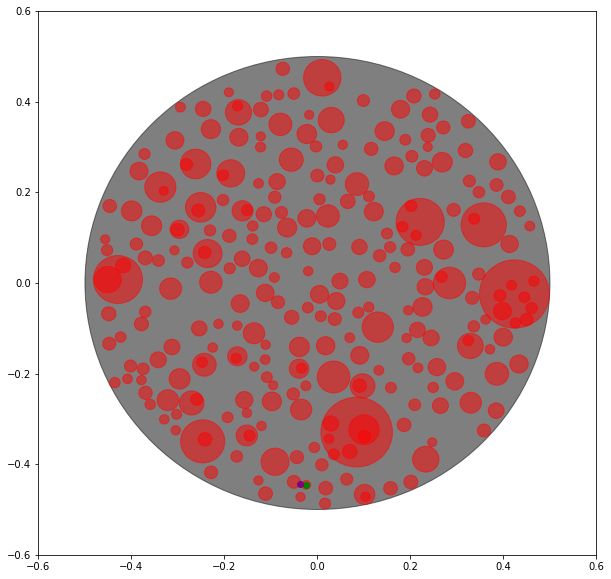

(0.2724337942559402, -0.09555011773574644) (0.2586685841997703, -0.11098595805648694) (<KDNode - (0.2586685841997703, -0.11098595805648694)>, 0.0004277461742978798) 0.020682025391578065 0.009777367712255553


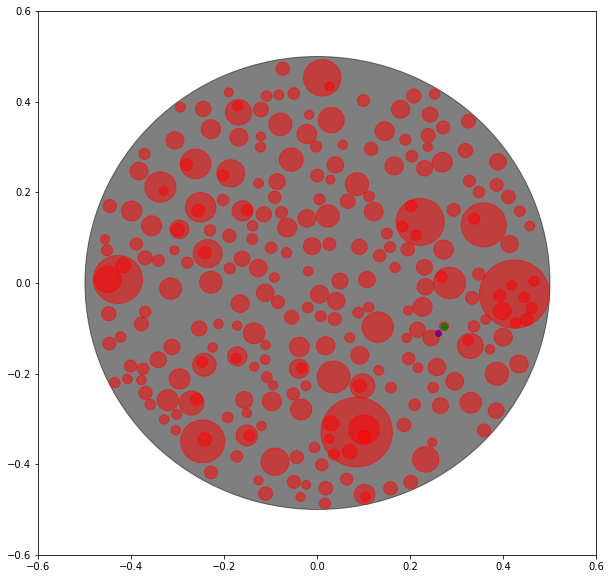

(0.02650683812565667, 0.34500535473006283) (0.02099391526743298, 0.3329016328312518) (<KDNode - (0.02099391526743298, 0.3329016328312518)>, 0.0001768924022444831) 0.013300090309636364 0.009760160870580006


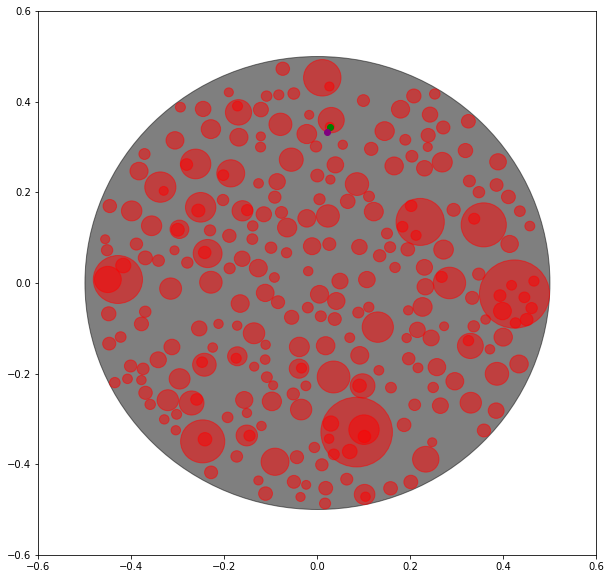

(0.10902636046140435, -0.2725799652752349) (0.1081075327836527, -0.2559190669830912) (<KDNode - (0.1081075327836527, -0.2559190669830912)>, 0.0002784297762025604) 0.016686215155108135 0.009722893326284407


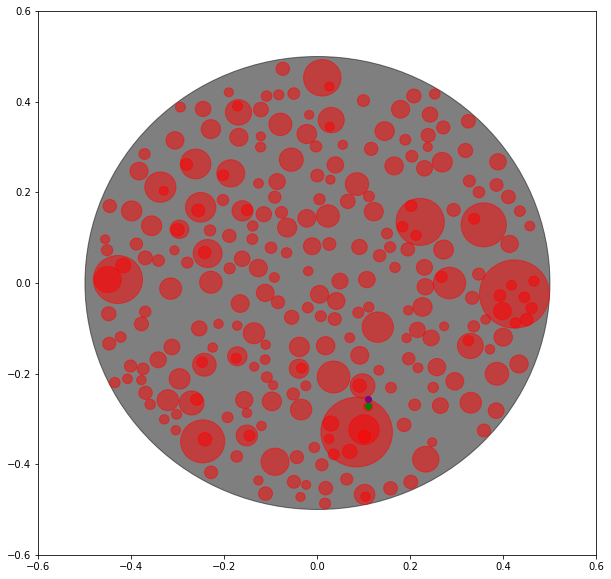

(0.13724679358299874, -0.05522980728096299) (0.14015866490948084, -0.06543534949763596) (<KDNode - (0.14015866490948084, -0.06543534949763596)>, 0.000112632086558283) 0.010612826511268476 0.009709147922606578


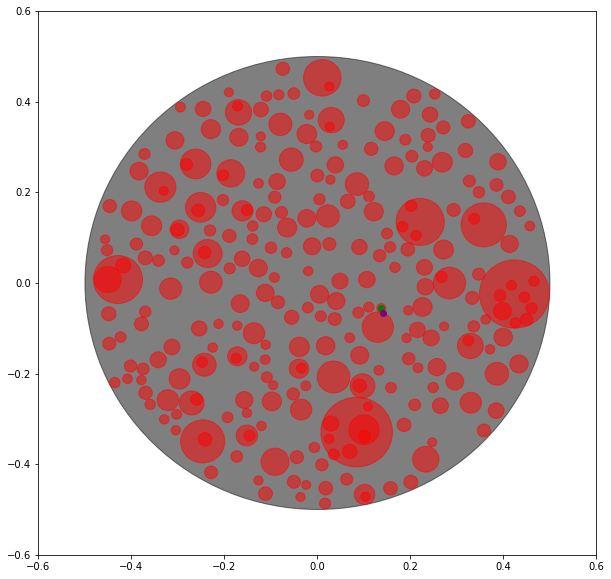

(0.41748197412811794, -0.036604553238955034) (0.4091995825527102, -0.04635602360639736) (<KDNode - (0.4091995825527102, -0.04635602360639736)>, 0.00016368918453549052) 0.012794107414567478 0.009695422614003815


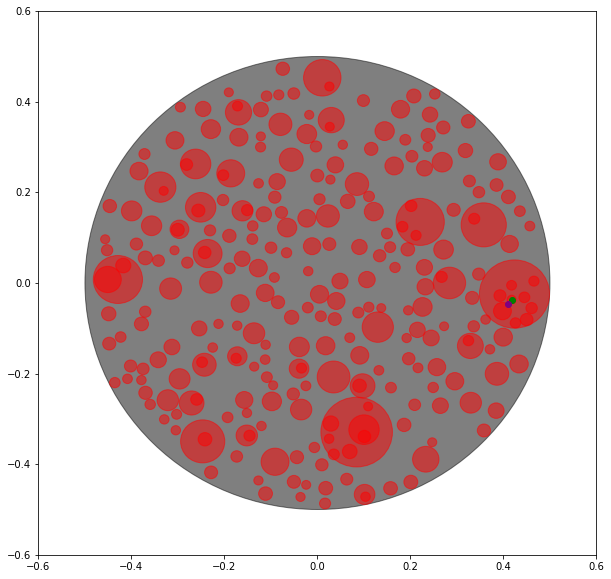

(0.23677226198478357, 0.2092454162946873) (0.23698811468864273, 0.18424670585730668) (<KDNode - (0.23698811468864273, 0.18424670585730668)>, 0.0006249821159217656) 0.024999642315876553 0.009694967408007519


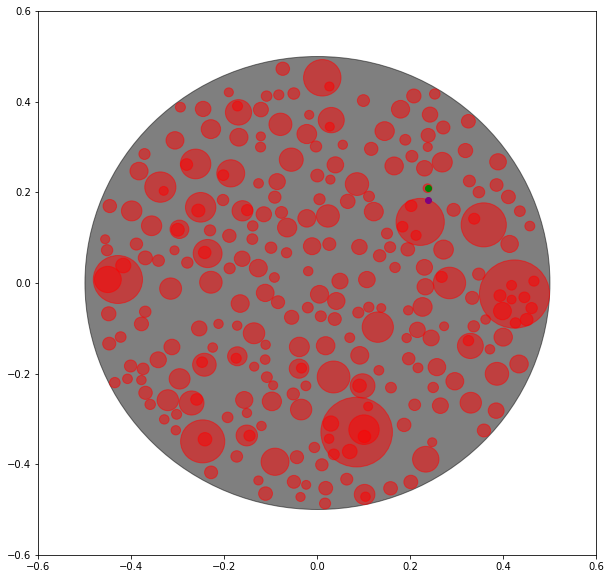

(-0.3165395377661071, -0.09421164922654601) (-0.3129301687107178, -0.12402056647160707) (<KDNode - (-0.3129301687107178, -0.12402056647160707)>, 0.0009015990923009003) 0.03002663971044546 0.009687265248970615


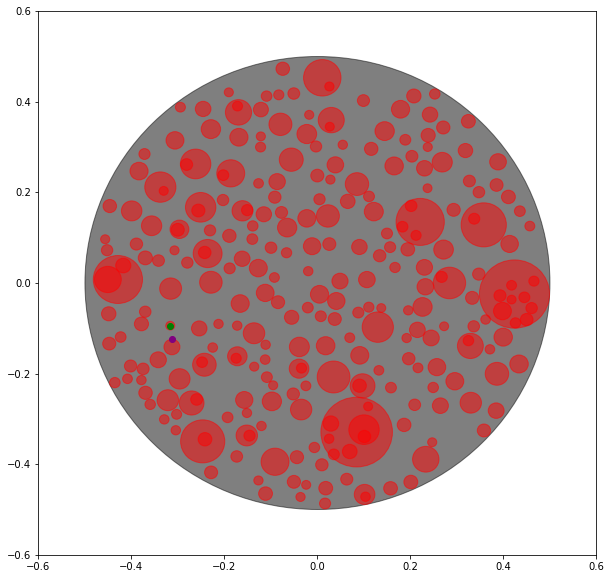

(-0.1704748606787315, -0.19578102206380676) (-0.1722758098196781, -0.18277651324810013) (<KDNode - (-0.1722758098196781, -0.18277651324810013)>, 0.00017236066734606804) 0.013128620161542797 0.009666365318224967


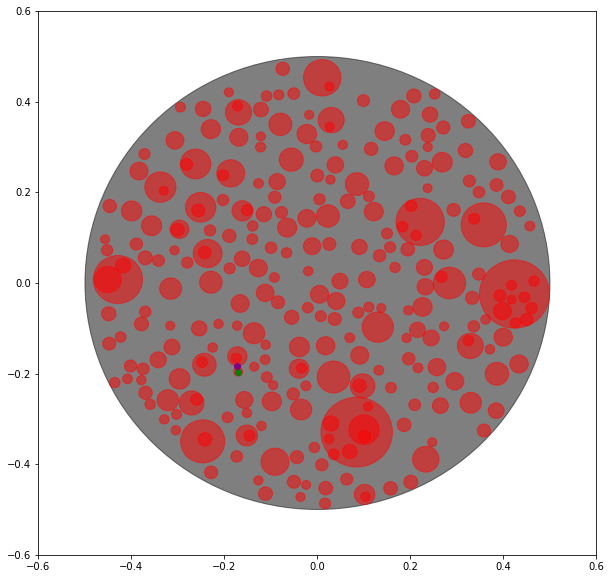

(0.04936506691597291, -0.19628836132901062) (0.06320211857457605, -0.18675754375274817) (<KDNode - (0.06320211857457605, -0.18675754375274817)>, 0.00028230048227484536) 0.016801799971278238 0.00965836221626886


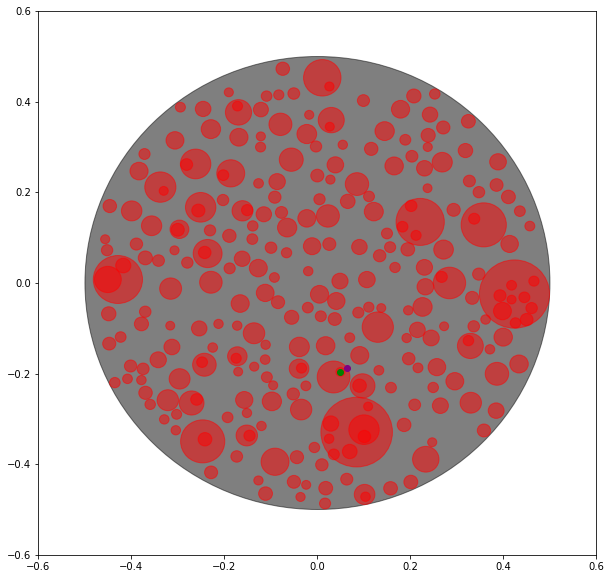

(-0.1862852210349193, -0.3633207760724328) (-0.18102886494698125, -0.37264529107949956) (<KDNode - (-0.18102886494698125, -0.37264529107949956)>, 0.00011457585944021665) 0.010704011371454004 0.009651684581927234


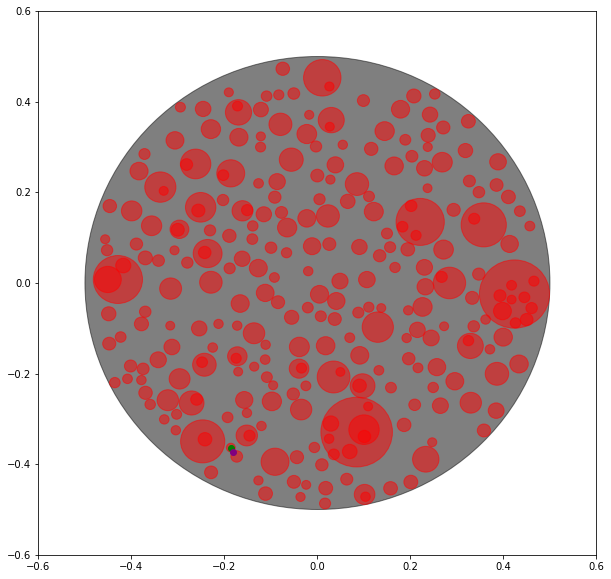

(0.1385519235161449, 0.41323581497702916) (0.11136543275007676, 0.4067595761003613) (<KDNode - (0.11136543275007676, 0.4067595761003613)>, 0.0007810469501611723) 0.027947217216767257 0.009604411586569672


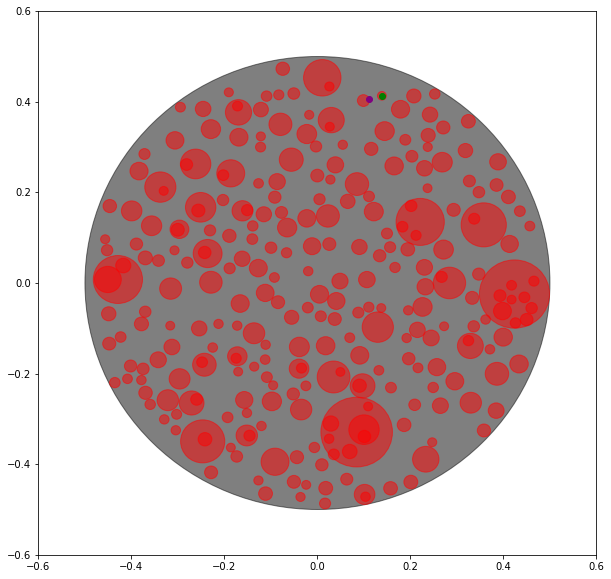

(-0.06298066511649672, 0.23814095930610207) (-0.064287908994811, 0.2477807194850059) (<KDNode - (-0.064287908994811, 0.2477807194850059)>, 9.463386286417024e-05) 0.009727993773855442 0.009541914850800437


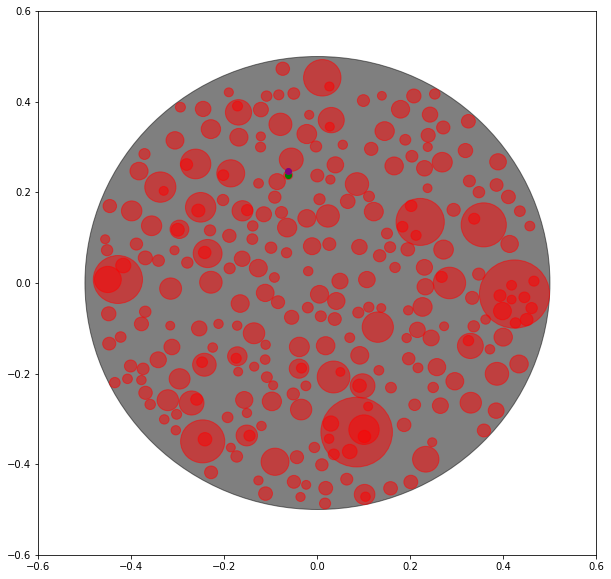

(0.2872138108297993, -0.14424087507160563) (0.3009794282407123, -0.13887738785130976) (<KDNode - (0.3009794282407123, -0.13887738785130976)>, 0.0002182592178659076) 0.01477359867689344 0.00946316284199565


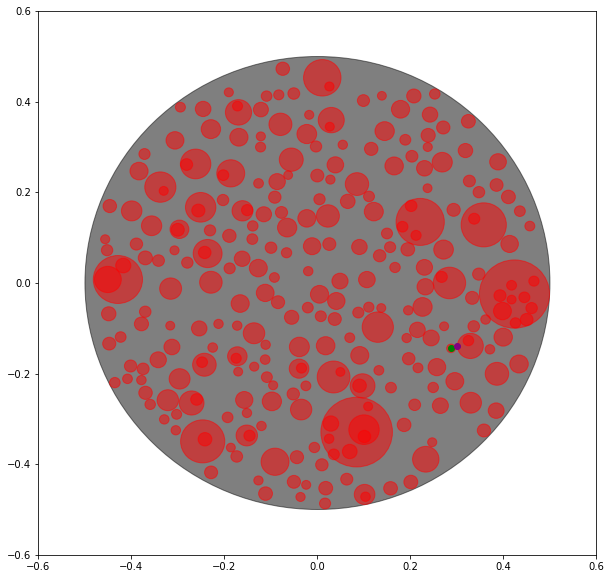

(0.07873536217155236, 0.4521333224316417) (0.05067160008134846, 0.4529960582956381) (<KDNode - (0.05067160008134846, 0.4529960582956381)>, 0.0007883190558265911) 0.02807702006671276 0.009457909681173717


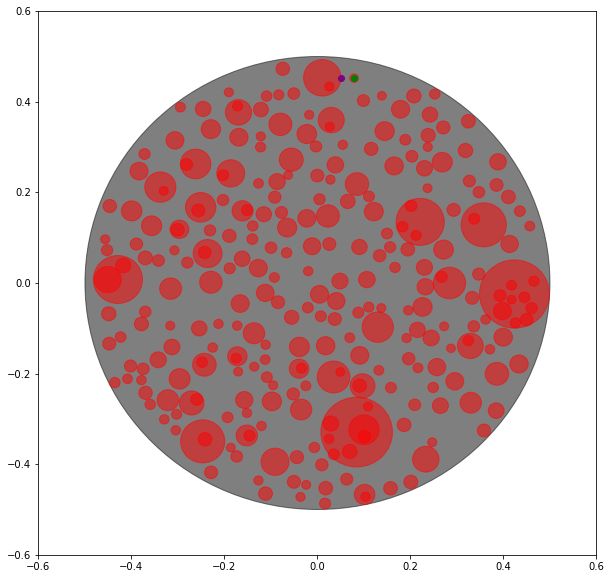

(-0.06674619657708586, -0.45806641394771097) (-0.05903597728992975, -0.4504288433043476) (<KDNode - (-0.05903597728992975, -0.4504288433043476)>, 0.00011777996678839963) 0.010852647915988044 0.009426899191597948


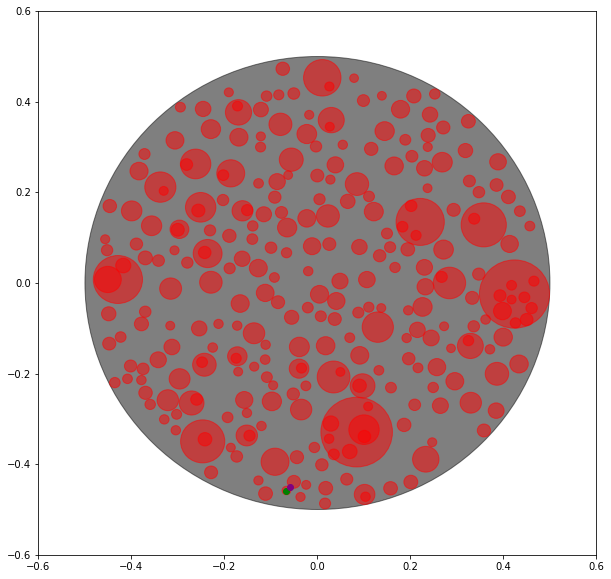

(0.10188384298386306, -0.34113472637550124) (0.10521464507708173, -0.35172177104370667) (<KDNode - (0.10521464507708173, -0.35172177104370667)>, 0.00012317975739076676) 0.011098637636699684 0.009370612842819833


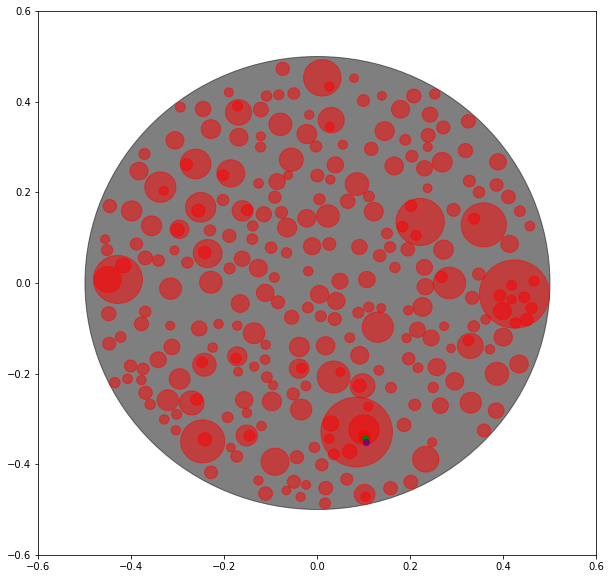

(-0.08370800507307087, -0.08106401037662929) (-0.07021464293999408, -0.08049984323579111) (<KDNode - (-0.07021464293999408, -0.08049984323579111)>, 0.00018238910621715227) 0.013505151099382497 0.00934138738432654


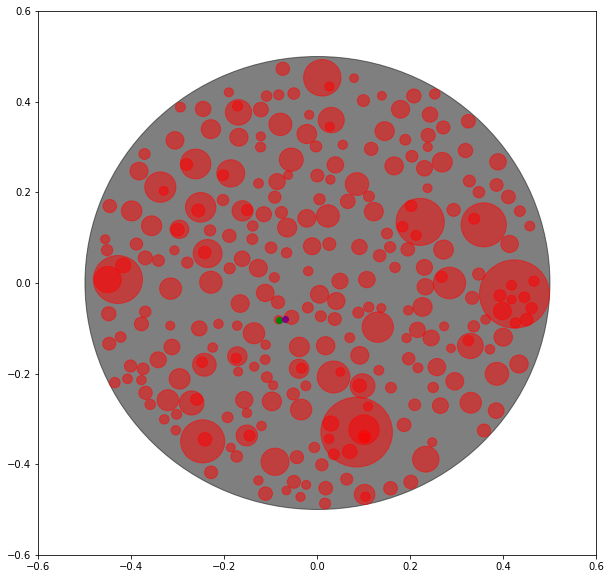

(0.15577311408208835, -0.4129086745346153) (0.15722584953814786, -0.4384085776365566) (<KDNode - (0.15722584953814786, -0.4384085776365566)>, 0.0006523554985136869) 0.02554125091912467 0.009278132349878456


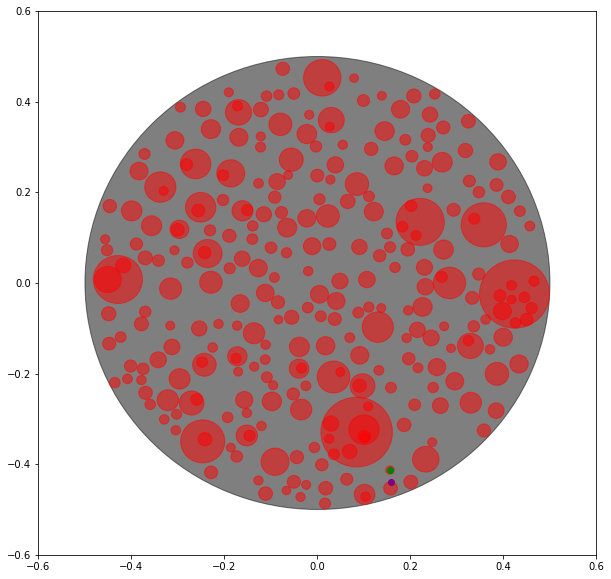

(0.12375099148830714, -0.41433615321902134) (0.10810753278365269, -0.4022792072098385) (<KDNode - (0.10810753278365269, -0.4022792072098385)>, 0.0003900877473125788) 0.019750639162127864 0.009239917482992703


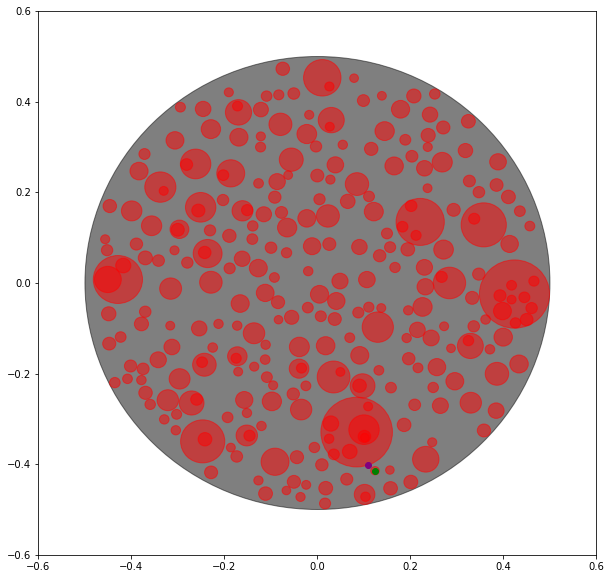

(0.436485818126464, 0.054711244009947584) (0.44701966987722686, 0.04727537185659119) (<KDNode - (0.44701966987722686, 0.04727537185659119)>, 0.00016625422738811123) 0.012893960888265143 0.009151149317112948


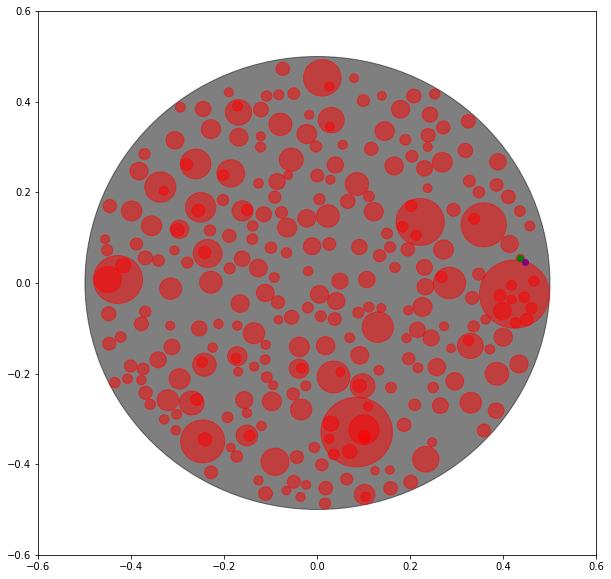

(0.3462205249711715, 0.2745613060165525) (0.3309409742358515, 0.2831912822987855) (<KDNode - (0.3309409742358515, 0.2831912822987855)>, 0.0003079411613051221) 0.017548252371821022 0.009105387135185885


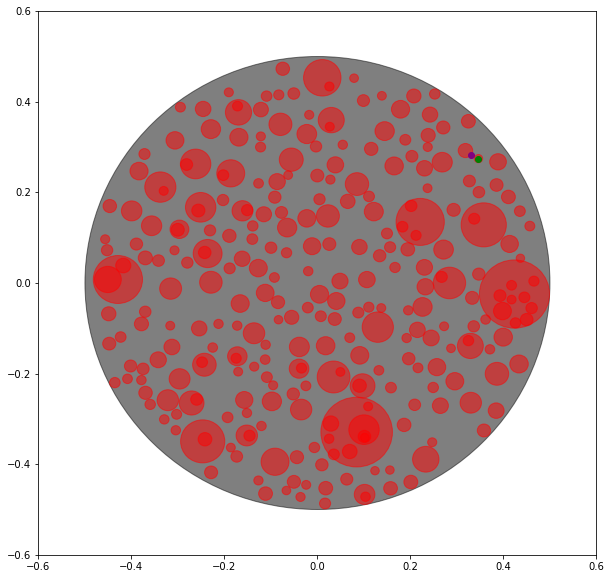

(-0.0016476732459938786, -0.0927023314885118) (0.0035239696513001866, -0.0847396023110874) (<KDNode - (0.0035239696513001866, -0.0847396023110874)>, 9.015094621013795e-05) 0.009494785211374607 0.009100032872223532


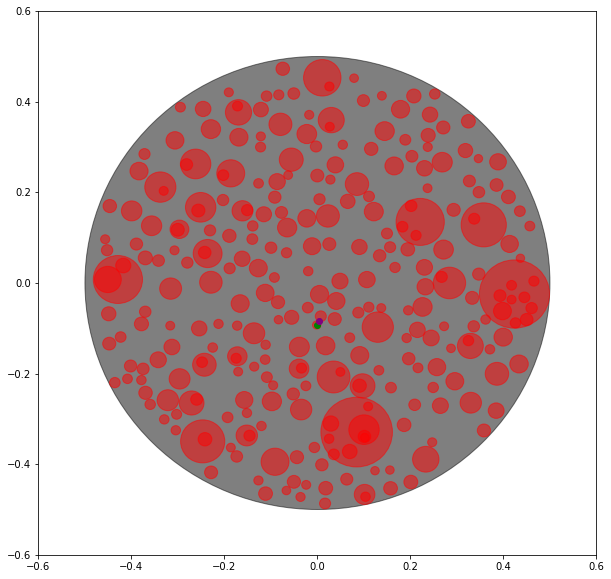

(0.1956145156874478, -0.21699203805242764) (0.20986719493902944, -0.19602458581790586) (<KDNode - (0.20986719493902944, -0.19602458581790586)>, 0.0006427729190554184) 0.025352966671682003 0.009091425723173919


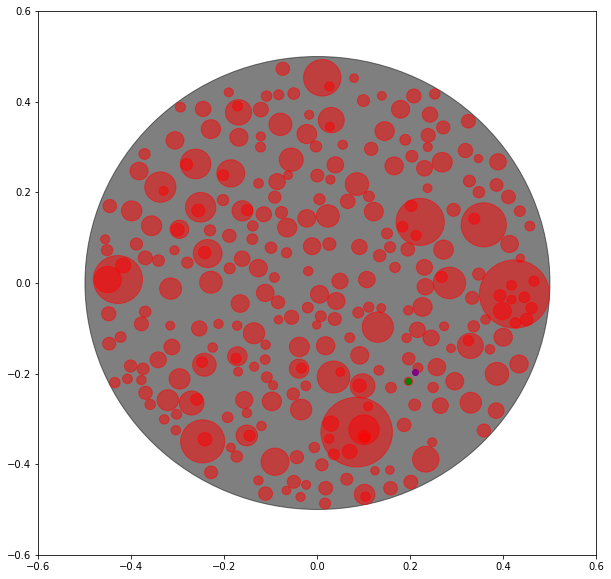

(-0.10025697319883081, 0.4358133845894311) (-0.10582901332264666, 0.4235232587080735) (<KDNode - (-0.10582901332264666, 0.4235232587080735)>, 0.00018209482532102923) 0.013494251565797536 0.009085809808703988


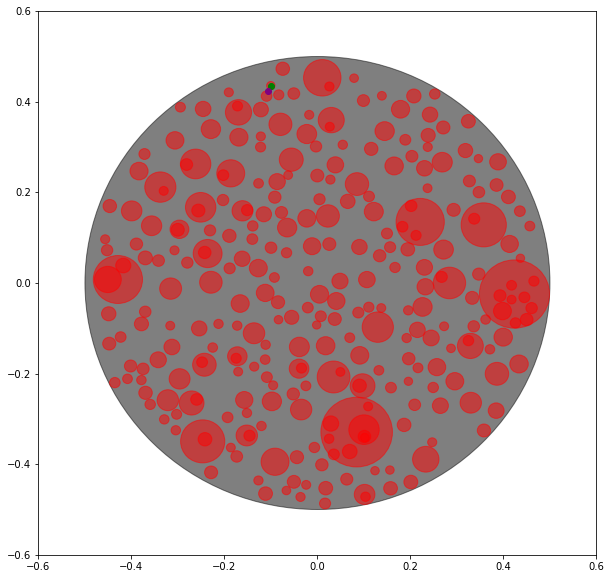

(0.3003774909867819, 0.3765213776603079) (0.3124107157033673, 0.36586482973976836) (<KDNode - (0.3124107157033673, 0.36586482973976836)>, 0.00025836051066259783) 0.016073596693416126 0.009061617481802424


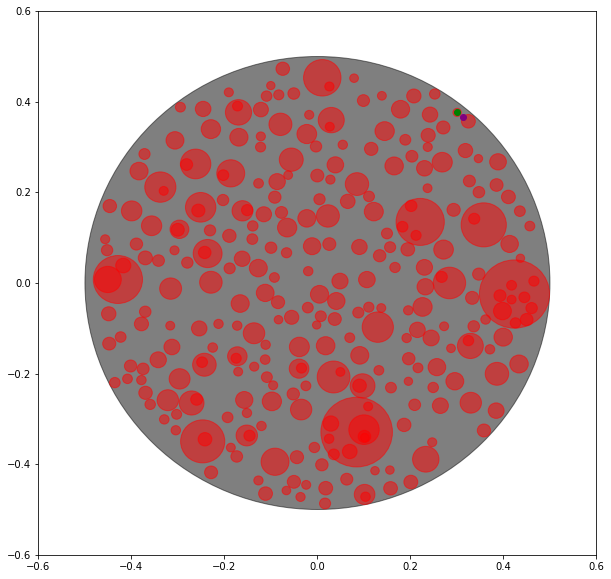

(0.11927006347062918, 0.3719469385576777) (0.13227654308267717, 0.35216758974549267) (<KDNode - (0.13227654308267717, 0.35216758974549267)>, 0.0005603911513327046) 0.02367258227005885 0.009034047563038454


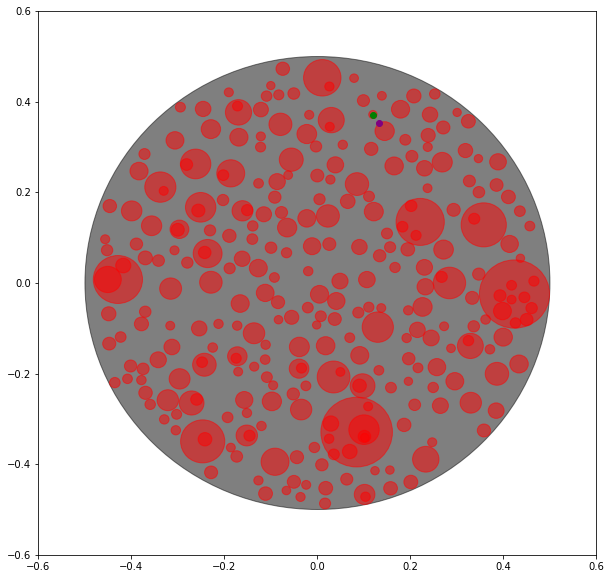

(0.27632056443030656, -0.377326419949785) (0.2600200087652788, -0.38025021877596327) (<KDNode - (0.2600200087652788, -0.38025021877596327)>, 0.00027425671456462965) 0.016560697888815847 0.009014868733923938


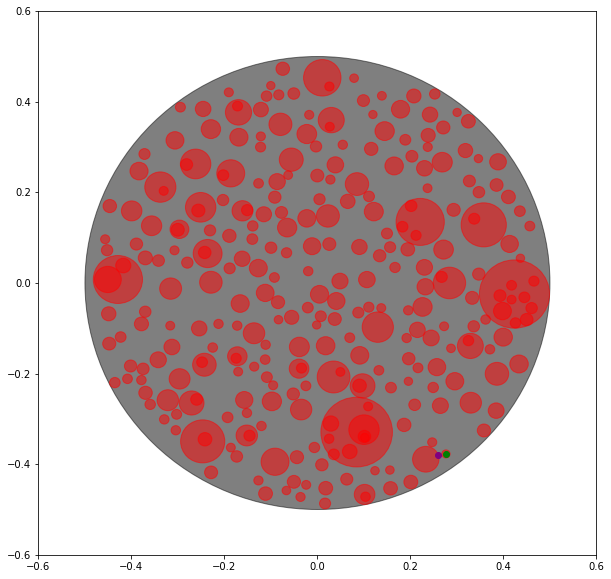

(0.1134489497853258, 0.45153635219738397) (0.08819327185272607, 0.4521333224316417) (<KDNode - (0.08819327185272607, 0.4521333224316417)>, 0.0006382056412957944) 0.02526273226109548 0.008996800797031107


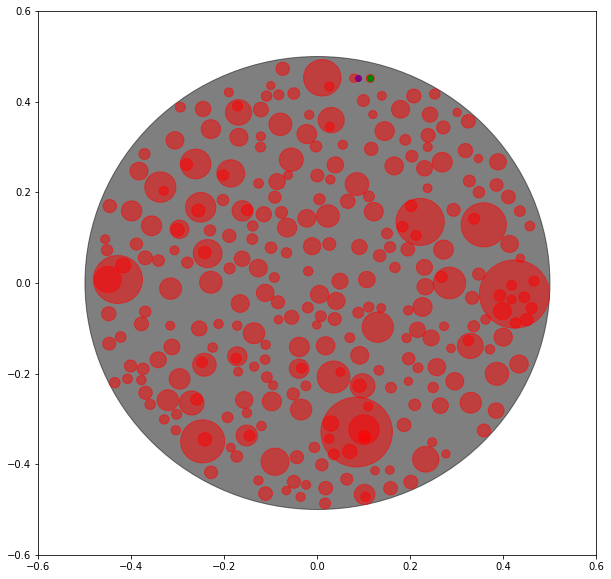

(0.17189362030844738, 0.38510858301952955) (0.16004468766722724, 0.3895652601053621) (<KDNode - (0.16004468766722724, 0.3895652601053621)>, 0.00016025917538355677) 0.012659351301846266 0.008977029414685225


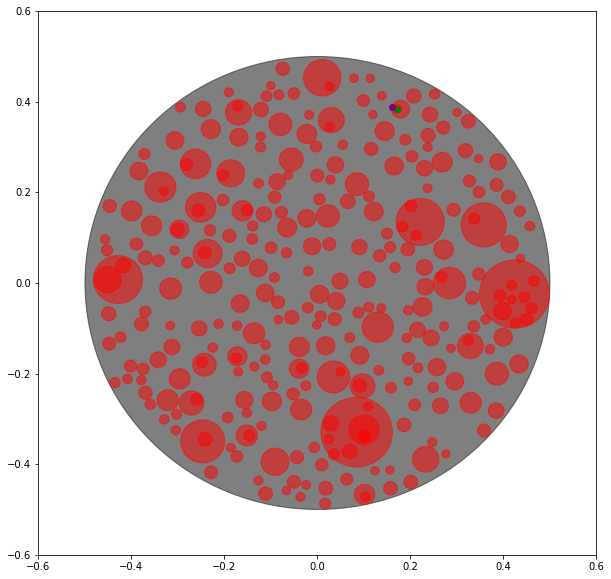

(0.06628538247216005, 0.3873734305225629) (0.0523422972592058, 0.376048979040752) (<KDNode - (0.0523422972592058, 0.376048979040752)>, 0.0003226528266195922) 0.017962539537036297 0.008958563886651703


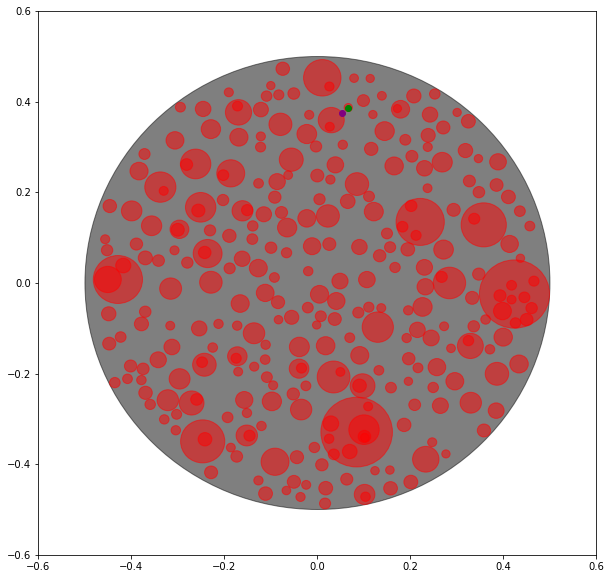

(0.14322401845515556, 0.03630982812710249) (0.13796596509106684, 0.04735638428896982) (<KDNode - (0.13796596509106684, 0.04735638428896982)>, 0.00014967352821689377) 0.01223411329916859 0.008951942982730226


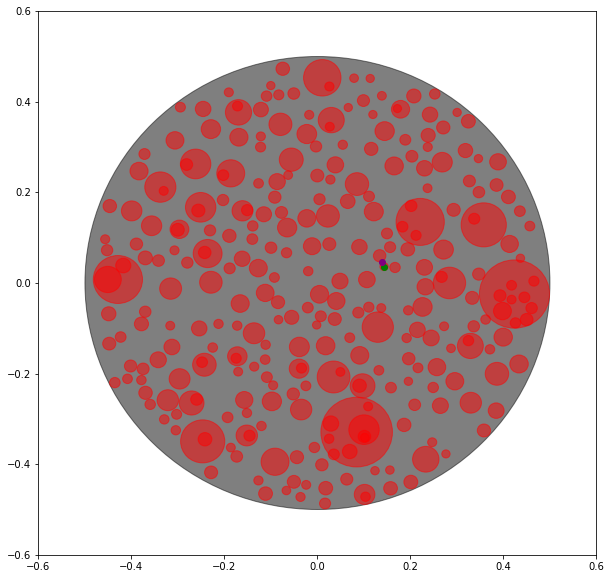

(0.37252496502353316, -0.23391162361699858) (0.3782082618637761, -0.2245127330339935) (<KDNode - (0.3782082618637761, -0.2245127330339935)>, 0.00012063900716561694) 0.010983578977984222 0.00893911578395931


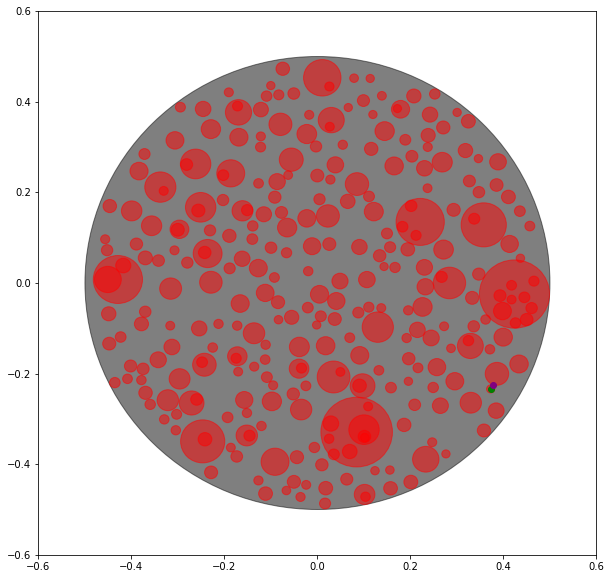

(-0.3930293718441685, 0.20863174273942928) (-0.38974854828125655, 0.22846577924297265) (<KDNode - (-0.38974854828125655, 0.22846577924297265)>, 0.00040415280727484914) 0.02010355210590529 0.008887535500141656


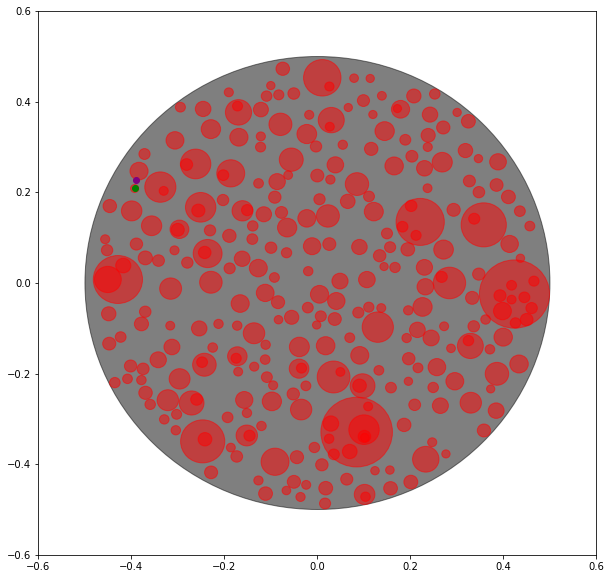

(-0.2350054676228512, -0.224995812746258) (-0.23526047791645494, -0.20458775547196395) (<KDNode - (-0.23526047791645494, -0.20458775547196395)>, 0.0004165538319607097) 0.02040965046150251 0.008868645648437704


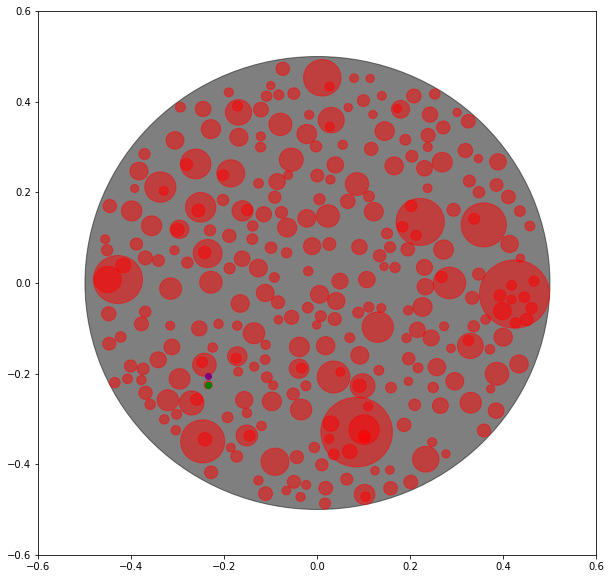

(0.1452272954659271, -0.15433042814717537) (0.14015866490948084, -0.12937032332494366) (<KDNode - (0.14015866490948084, -0.12937032332494366)>, 0.0006486978484545354) 0.02546954747251186 0.008834568196875637


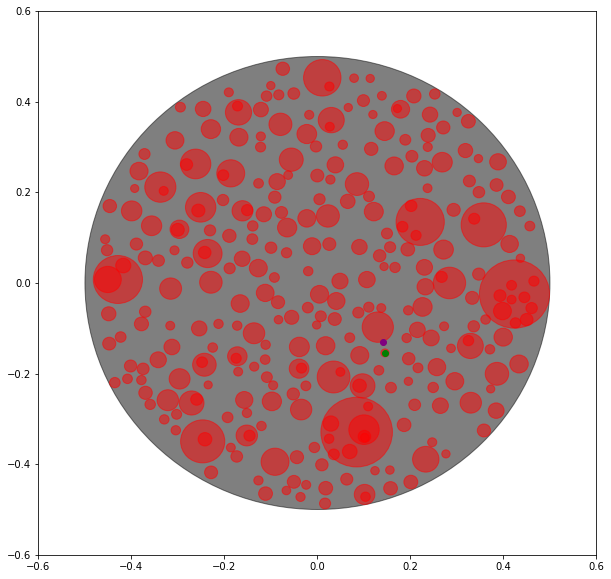

(-0.15436846022409056, 0.4384193023277621) (-0.1812613863740855, 0.4239884509191536) (<KDNode - (-0.1812613863740855, 0.4239884509191536)>, 0.00093147894928642) 0.030520140060072136 0.008824941179061215


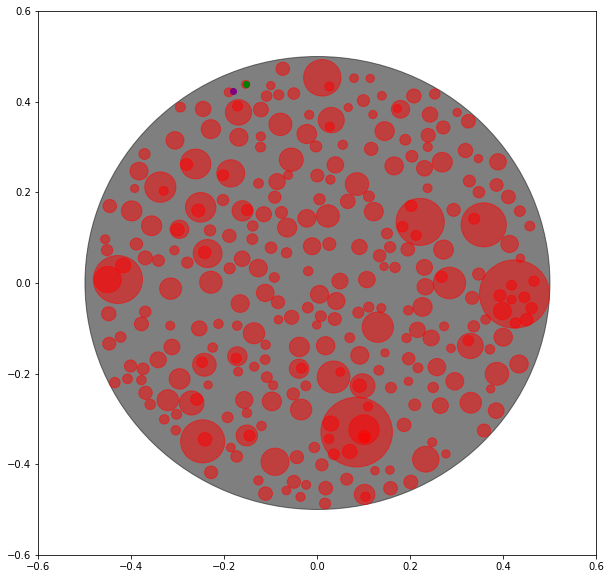

(0.14892091252564482, -0.33379248303338666) (0.16127596592343277, -0.3290991370964648) (<KDNode - (0.16127596592343277, -0.3290991370964648)>, 0.00017467484054581214) 0.013216460969026926 0.008785737958873743


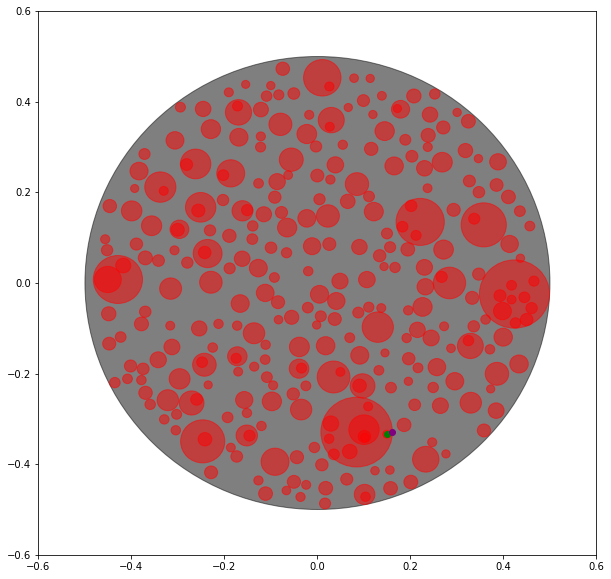

(0.2975563301345698, 0.22017042283718283) (0.31439769807133944, 0.22108515097922785) (<KDNode - (0.31439769807133944, 0.22108515097922785)>, 0.00028446840155550224) 0.016866191080249927 0.00877135527413165


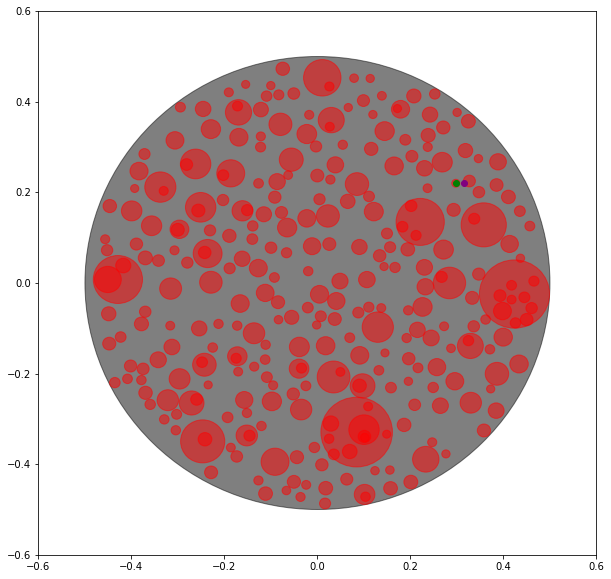

(-0.29086193508106817, -0.08772768694074261) (-0.307326401025994, -0.09121811963559624) (<KDNode - (-0.307326401025994, -0.09121811963559624)>, 0.0002832617592489261) 0.0168303820292032 0.008737293672740499


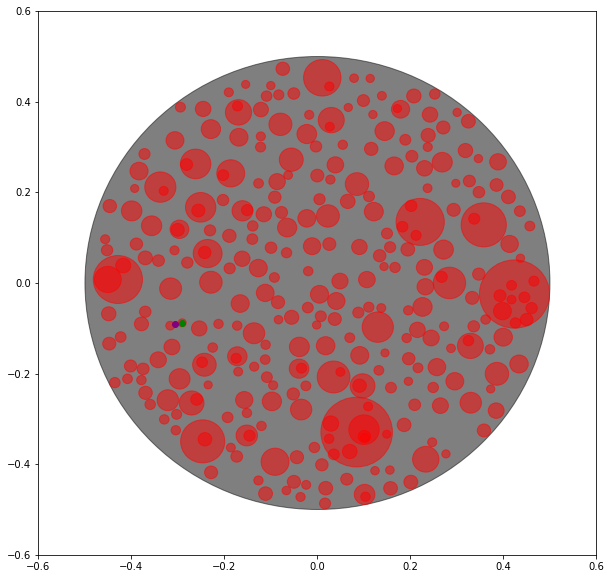

(-0.3299553516010633, 0.02718947948311635) (-0.3342833211591919, 0.03913482421146622) (<KDNode - (-0.3342833211591919, 0.03913482421146622)>, 0.0001614225811752037) 0.012705218659086656 0.008725008621035663


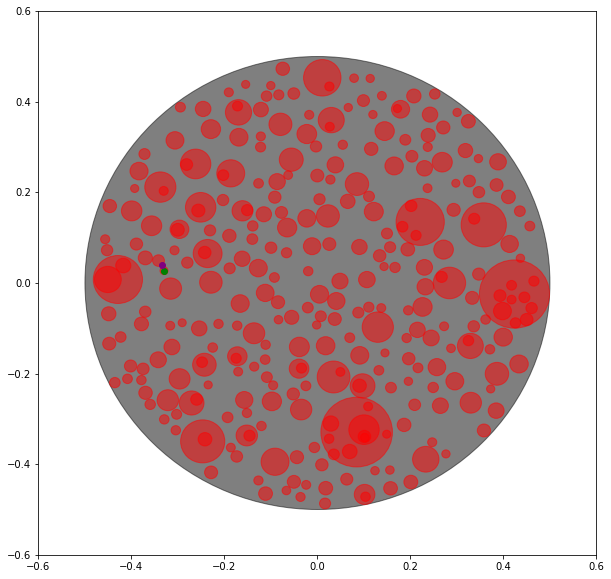

(0.3875771175936842, 0.14187897619978093) (0.40388865337318364, 0.14338987903778763) (<KDNode - (0.40388865337318364, 0.14338987903778763)>, 0.00026834902687178754) 0.01638136217998331 0.008723271055634182


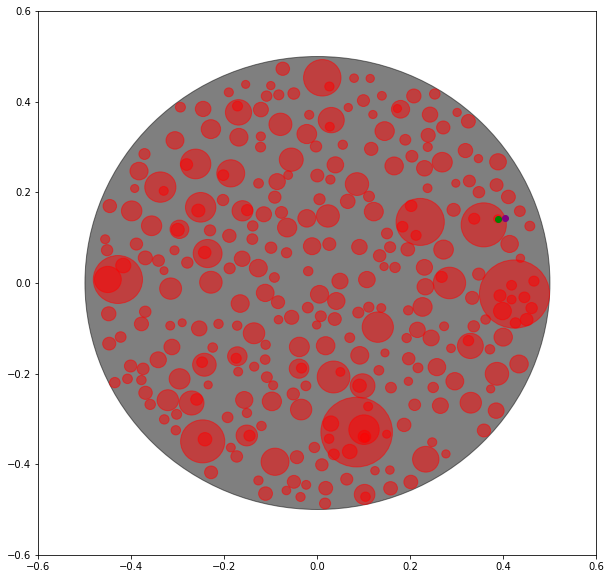

(-0.25284921711318664, -0.31765360632824946) (-0.24644580649375275, -0.33085020463217896) (<KDNode - (-0.24644580649375275, -0.33085020463217896)>, 0.0002151538743563536) 0.014668124432126747 0.008712243744357981


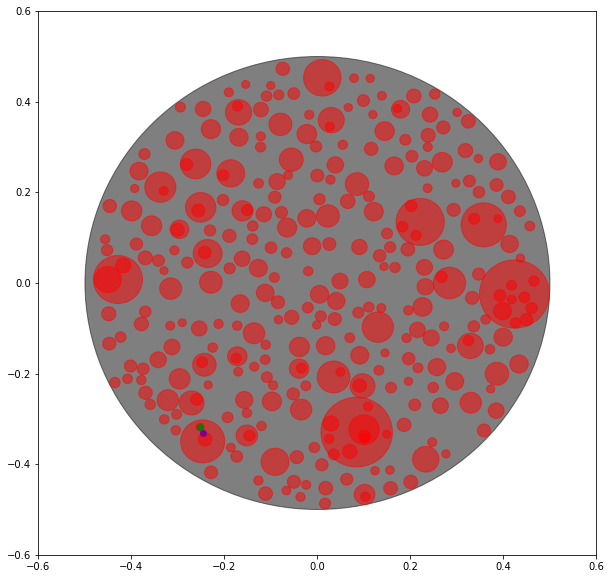

(0.3711313052931303, 0.3178994151130997) (0.38277571461132415, 0.28459551310327924) (<KDNode - (0.38277571461132415, 0.28459551310327924)>, 0.0012447421574493633) 0.03528090358039832 0.008703231049407956


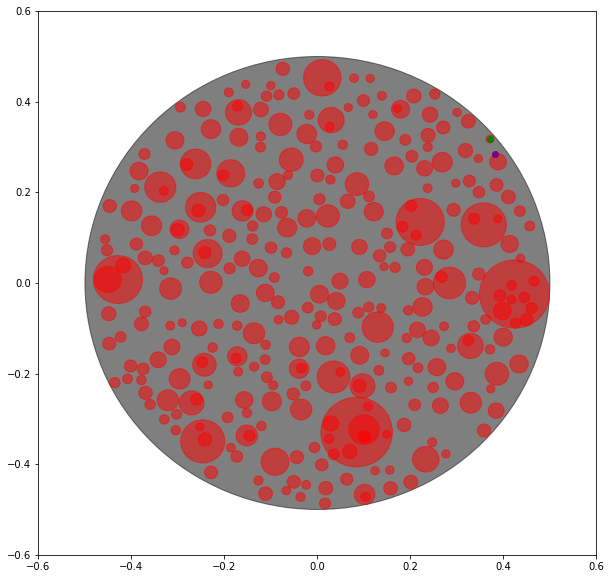

(0.2801425997754863, -0.043531645476828786) (0.28388672385588654, -0.03478543334321497) (<KDNode - (0.28388672385588654, -0.03478543334321497)>, 9.051469181560664e-05) 0.009513920948568295 0.008695709656889006


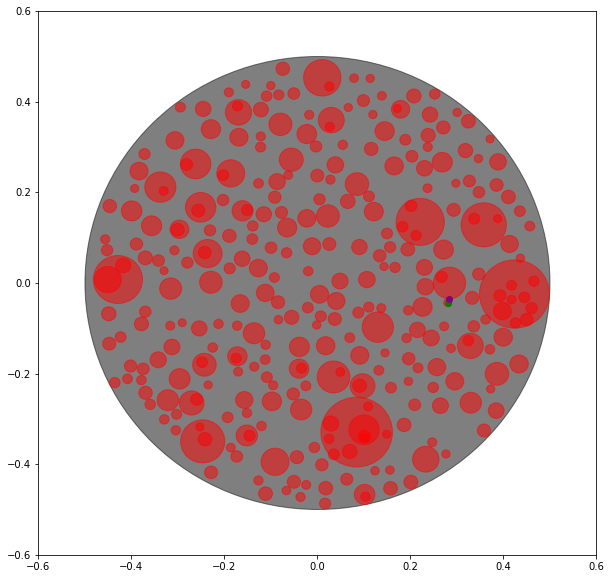

(-0.015935809492884503, -0.381026432398636) (-0.013322382619056192, -0.37235893732259495) (<KDNode - (-0.013322382619056192, -0.37235893732259495)>, 8.195547091804354e-05) 0.009052926097016563 0.00869491522988876


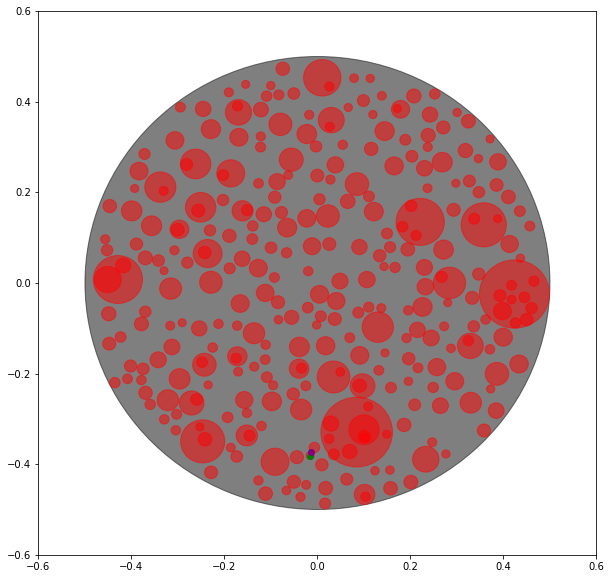

(0.009086294421743715, -0.24667500429331124) (0.013947981461018995, -0.23601168086630522) (<KDNode - (0.013947981461018995, -0.23601168086630522)>, 0.00013734246737679258) 0.011719320260868058 0.00868369723348483


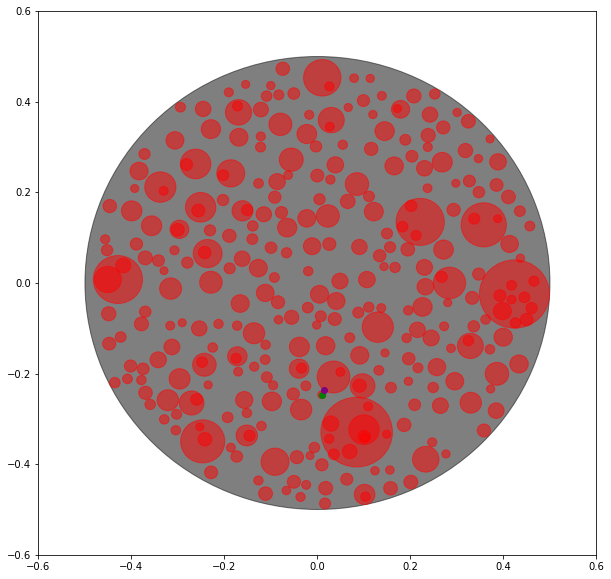

(0.3233906644509078, -0.22816127936159641) (0.3137642336223667, -0.22287327867455844) (<KDNode - (0.3137642336223667, -0.22287327867455844)>, 0.0001206311217628003) 0.010983220008849878 0.00866595737227165


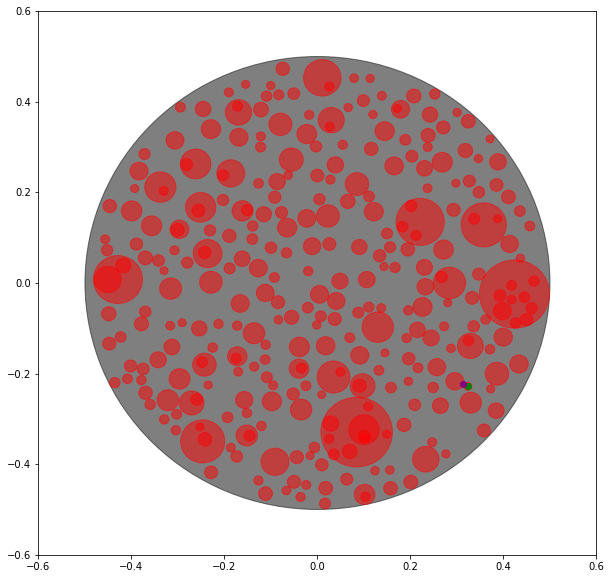

(0.1494431784886306, 0.20777475671490522) (0.12208138321331866, 0.19479104113151152) (<KDNode - (0.12208138321331866, 0.19479104113151152)>, 0.0009172447110385429) 0.030286048125144075 0.008601929251915887


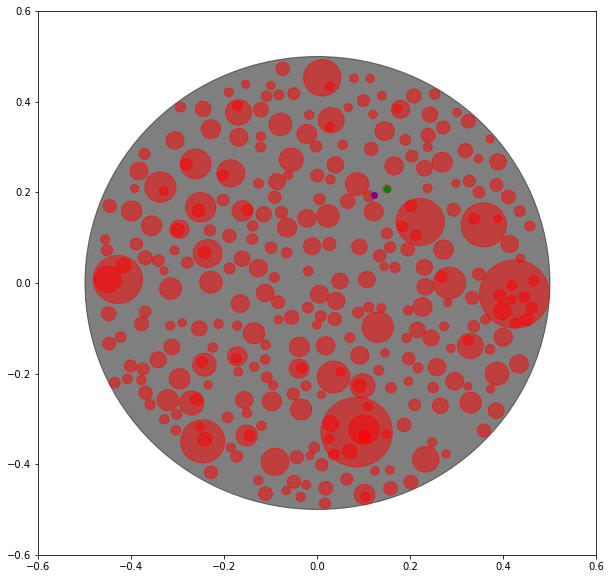

(-0.2075905336694878, -0.23224459573806044) (-0.22657088438819187, -0.22773637496871466) (<KDNode - (-0.22657088438819187, -0.22773637496871466)>, 0.00038057776791017105) 0.019508402495083267 0.008594006624746223


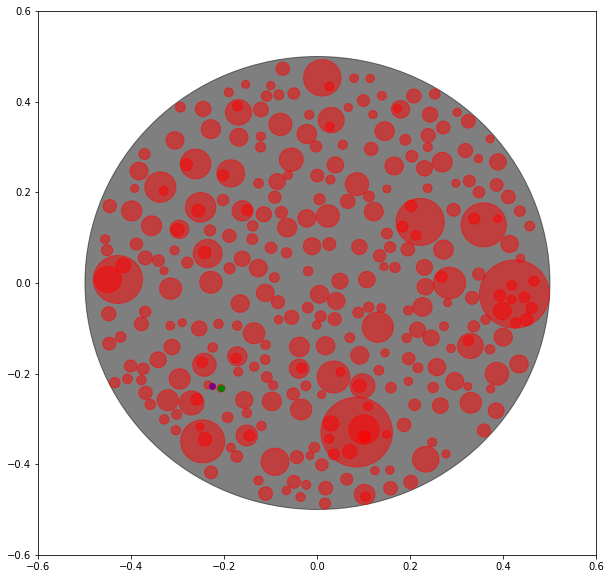

(-0.4741641603033614, 0.11875587807064485) (-0.4623054343247984, 0.1045972013006549) (<KDNode - (-0.4623054343247984, 0.1045972013006549)>, 0.000341097509711697) 0.018468825347371095 0.008588020757648645


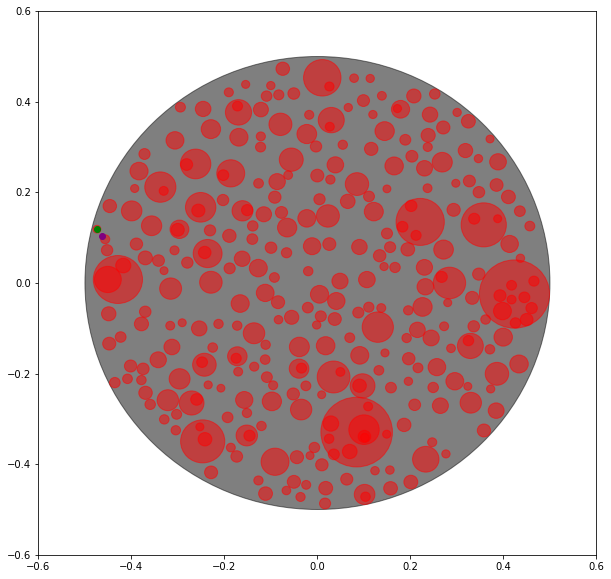

(-0.0035090895560907884, 0.01539056074967766) (-0.01157542384754942, 0.02011386773490062) (<KDNode - (-0.01157542384754942, 0.02011386773490062)>, 8.737537777821742e-05) 0.009347479755432339 0.008586635373156208


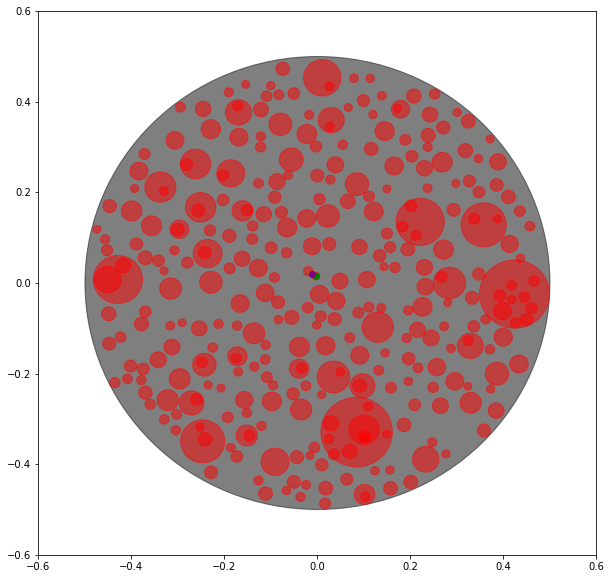

(-0.03589781434380708, -0.007410034936861408) (-0.014153714834845326, -0.018905891351060335) (<KDNode - (-0.014153714834845326, -0.018905891351060335)>, 0.0006049605781515094) 0.024595946376415552 0.008585897899932948


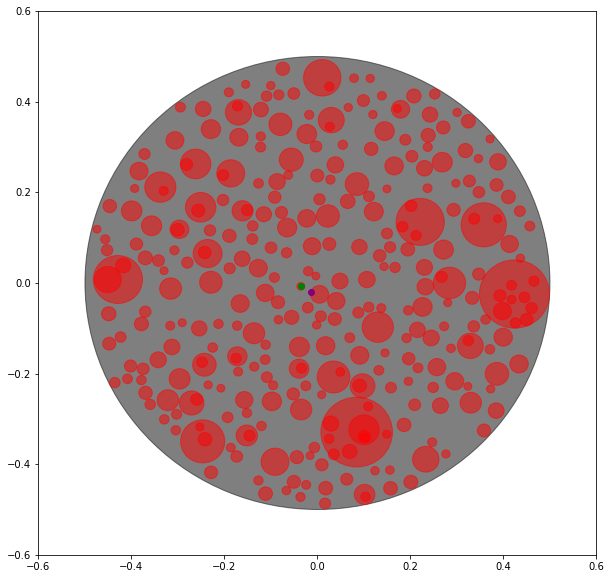

(0.22735921612938195, -0.22201775569696575) (0.23806257623548455, -0.22709284271172991) (<KDNode - (0.23806257623548455, -0.22709284271172991)>, 0.00014031842576833642) 0.011845607868249583 0.008583886287292602


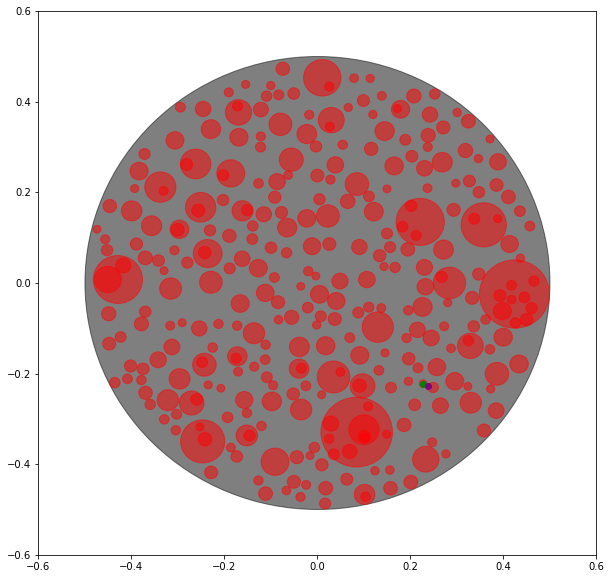

(-0.17645649260016363, -0.41373679239983036) (-0.17357495892603586, -0.3955860549278147) (<KDNode - (-0.17357495892603586, -0.3955860549278147)>, 0.00033775250709316637) 0.01837804415853783 0.008579056492493952


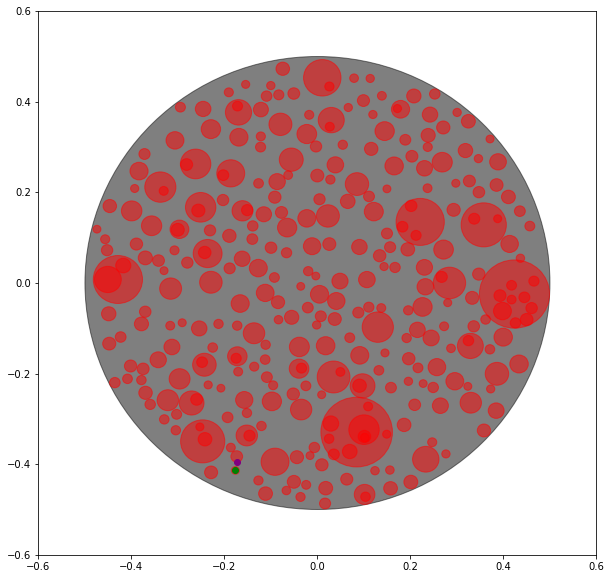

(-0.041100811451695266, -0.2912830576525382) (-0.04216466765969538, -0.3011909945547109) (<KDNode - (-0.04216466765969538, -0.3011909945547109)>, 9.929900368873546e-05) 0.009964888543718664 0.00855257848216992


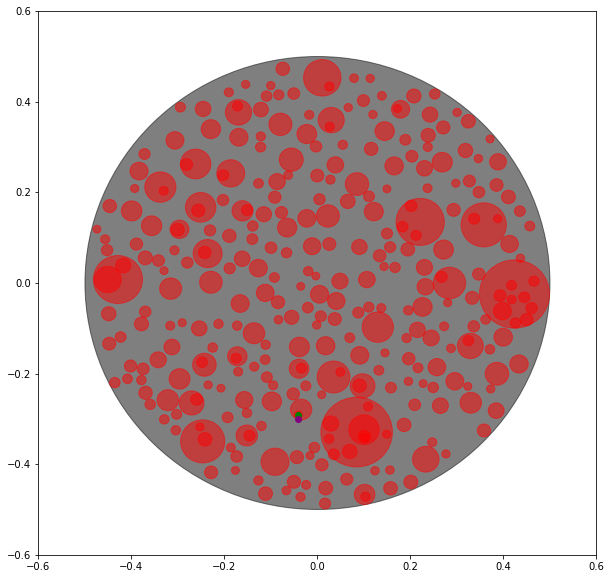

(0.2738195523419959, -0.3458613590628881) (0.2561635966463567, -0.3485003371149542) (<KDNode - (0.2561635966463567, -0.3485003371149542)>, 0.0003186969766856613) 0.017852086059776357 0.008526445838864834


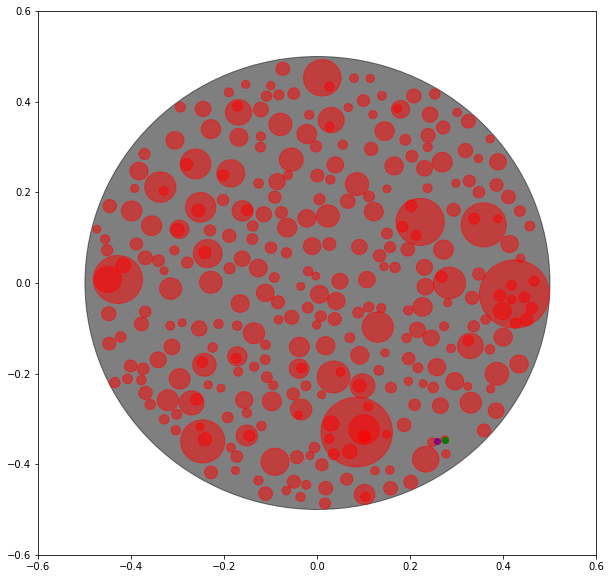

(-0.2799409024367677, 0.3526176740466518) (-0.29501259402397934, 0.33046237235596615) (<KDNode - (-0.29501259402397934, 0.33046237235596615)>, 0.0007180132803053231) 0.026795769821099057 0.008506235383091731


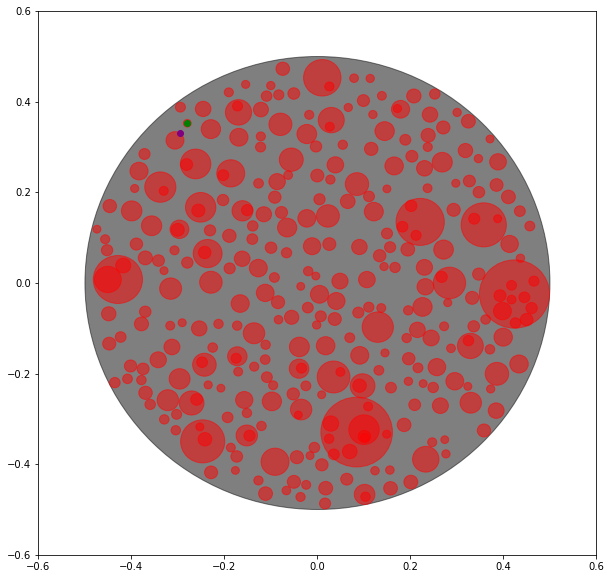

(-0.3543104466128996, 0.268358519154894) (-0.36218753233069334, 0.2776845866794283) (<KDNode - (-0.36218753233069334, 0.2776845866794283)>, 0.00014902401487764308) 0.012207539263817384 0.008499239547231799


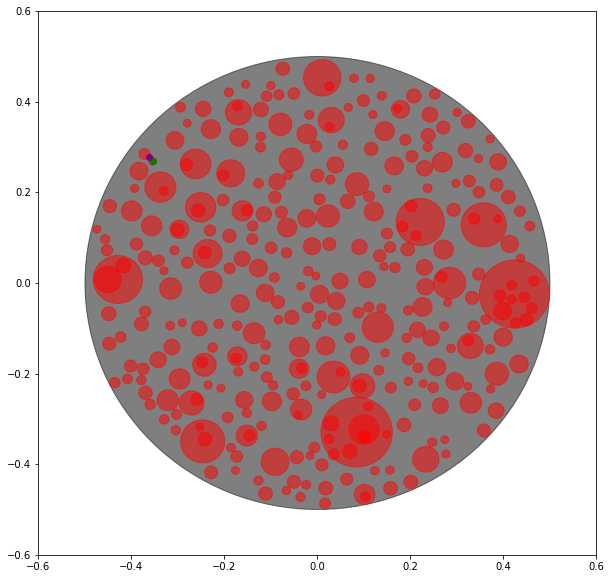

(0.20263721003436674, -0.23675553085229542) (0.19842392073900608, -0.22563849772886557) (<KDNode - (0.19842392073900608, -0.22563849772886557)>, 0.00014134023215383714) 0.011888659813193292 0.008492079780992237


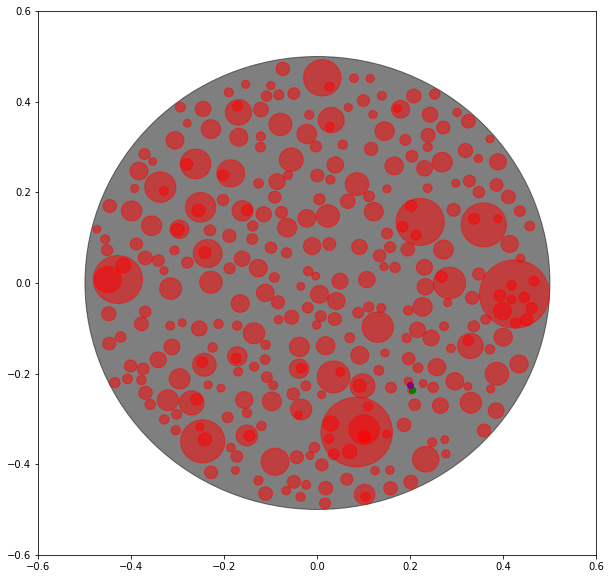

(0.2088037087304894, 0.3085896009406471) (0.20025743294865586, 0.3124850514507293) (<KDNode - (0.20025743294865586, 0.3124850514507293)>, 8.821336441565423e-05) 0.009392196996212028 0.00845979718755755


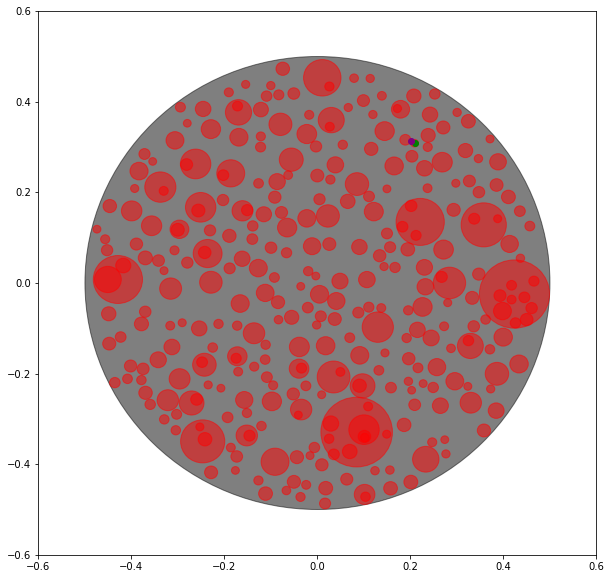

(-0.3237802656227793, -0.05004022557366597) (-0.3230632834817003, -0.03480768992873304) (<KDNode - (-0.3230632834817003, -0.03480768992873304)>, 0.0002325442055647785) 0.01524940017065519 0.008451196428781444


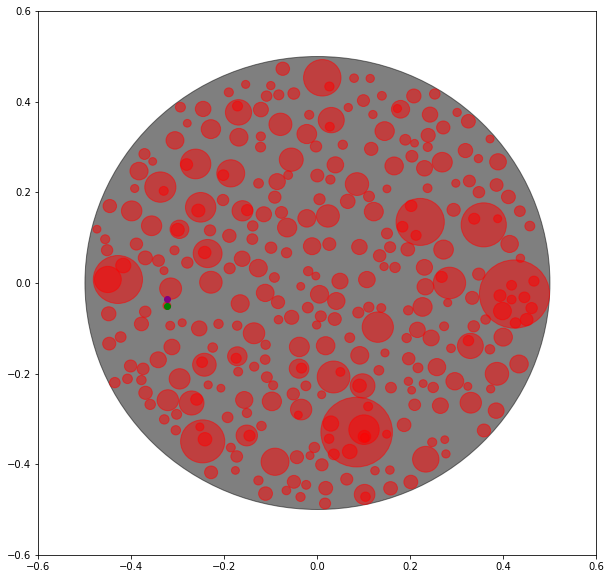

(0.1799898605591851, -0.20403410860608887) (0.18825939777430256, -0.21164823209003358) (<KDNode - (0.18825939777430256, -0.21164823209003358)>, 0.0001263601221809713) 0.011241001831730626 0.008442336896456357


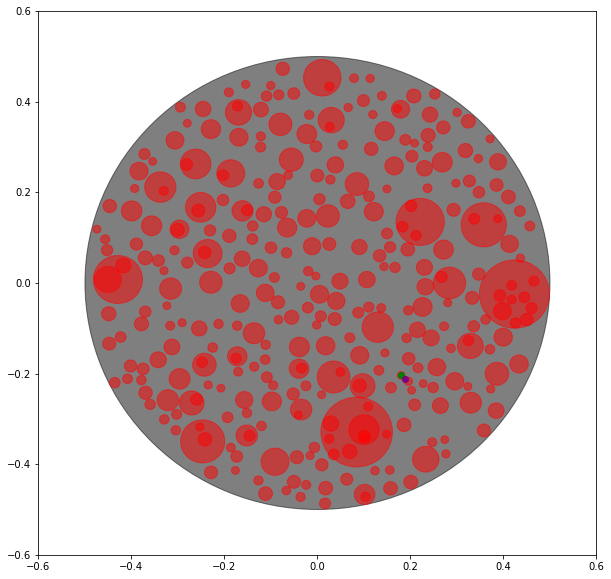

(-0.2772490006147889, 0.3704117790609215) (-0.2799409024367677, 0.36112390942974354) (<KDNode - (-0.2799409024367677, 0.36112390942974354)>, 9.351085770493045e-05) 0.009670101225164629 0.008435242570881081


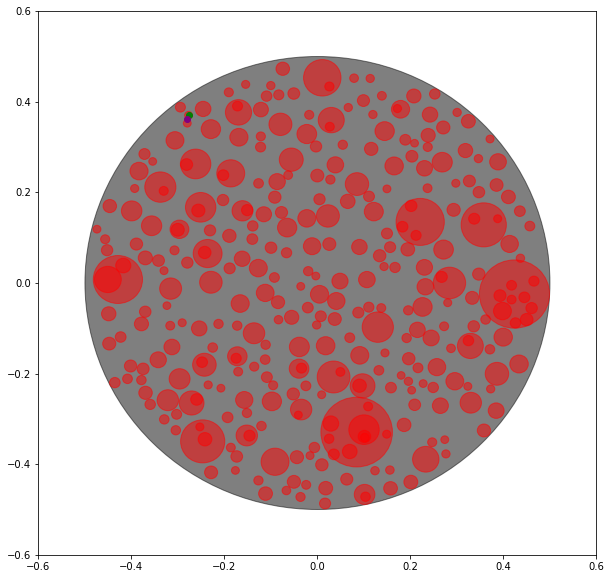

(-0.3609342274614184, 0.01337567934272087) (-0.3762070912632213, 0.007738966045297516) (<KDNode - (-0.3762070912632213, 0.007738966045297516)>, 0.00026503290550577145) 0.01627983124930266 0.008429621995481402


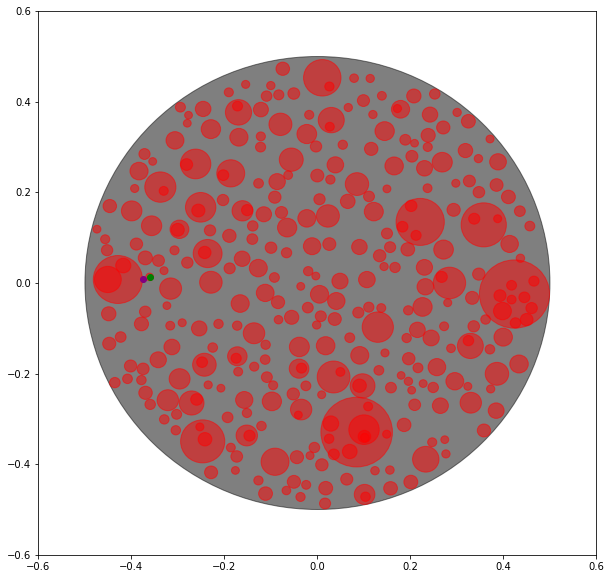

(0.14369769576328437, -0.35928710567809125) (0.1575099567454862, -0.352876783248005) (<KDNode - (0.1575099567454862, -0.352876783248005)>, 0.00023187078709812248) 0.015227303999662005 0.00841971428877919


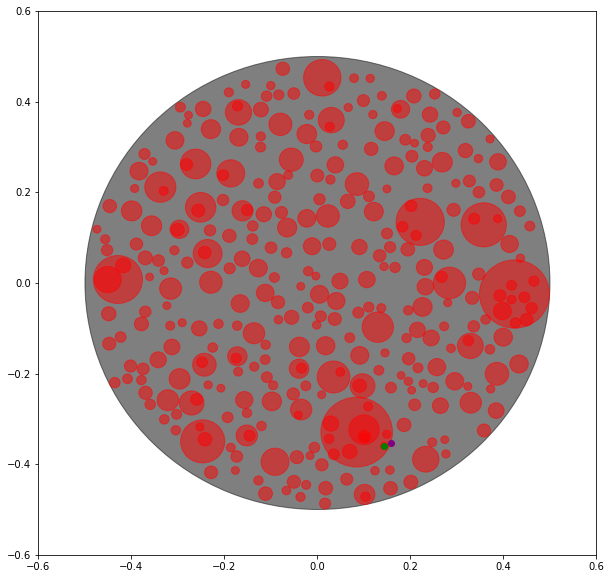

(-0.40466283103904316, -0.060678132522530716) (-0.4128005244144068, -0.04262757375196465) (<KDNode - (-0.4128005244144068, -0.04262757375196465)>, 0.0003920447254010966) 0.019800119327950946 0.008405184689059009


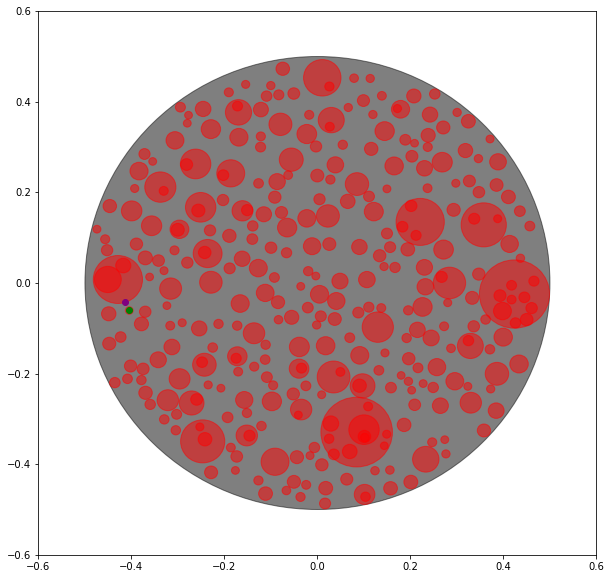

(0.0816232670223893, 0.019605854054188913) (0.08921324458992601, 0.0131289003741018) (<KDNode - (0.08921324458992601, 0.0131289003741018)>, 9.955868844970446e-05) 0.009977910024133533 0.008388434243517377


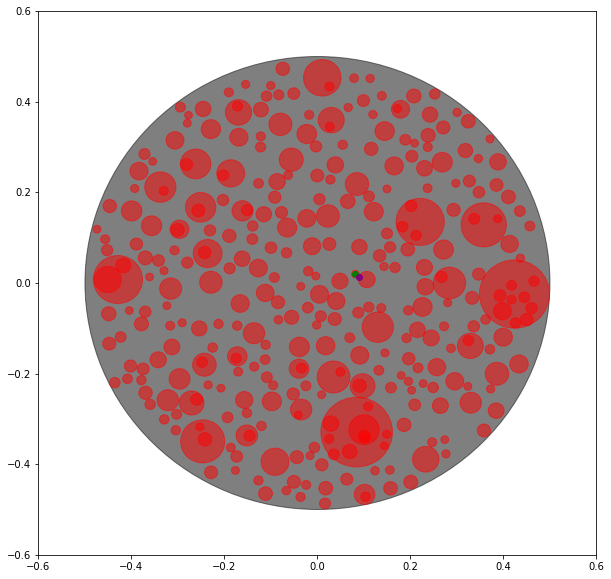

(-0.013395872725287172, -0.48080763574759333) (-0.026894311238912304, -0.47540909125560826) (<KDNode - (-0.026894311238912304, -0.47540909125560826)>, 0.0002113521249380606) 0.014537954633924974 0.008388136866888994


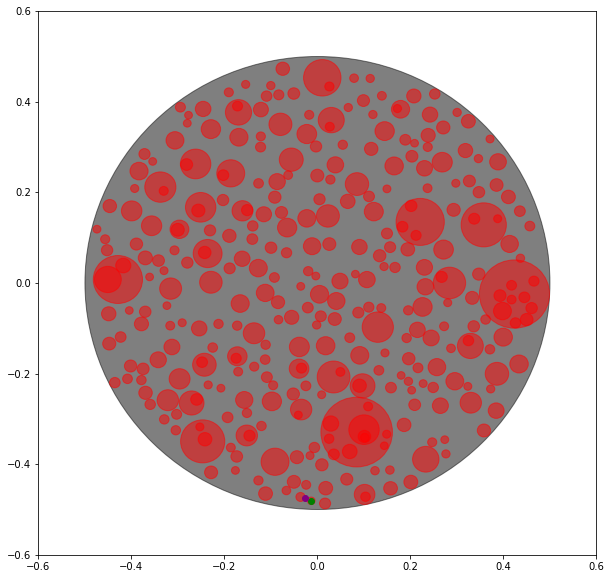

(0.36926710494580056, -0.018456704068491737) (0.3802135330388886, -0.023849767429874713) (<KDNode - (0.3802135330388886, -0.023849767429874713)>, 0.0001489094204170386) 0.012202844767390865 0.008376026969635752


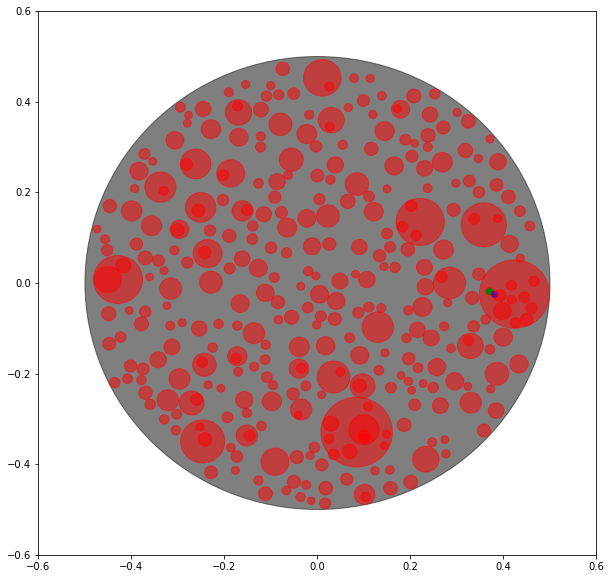

(0.21749574485539036, 0.15545964009300808) (0.21166650202807968, 0.16292046219476589) (<KDNode - (0.21166650202807968, 0.16292046219476589)>, 8.964393837383069e-05) 0.009468048287468262 0.00837364413590906


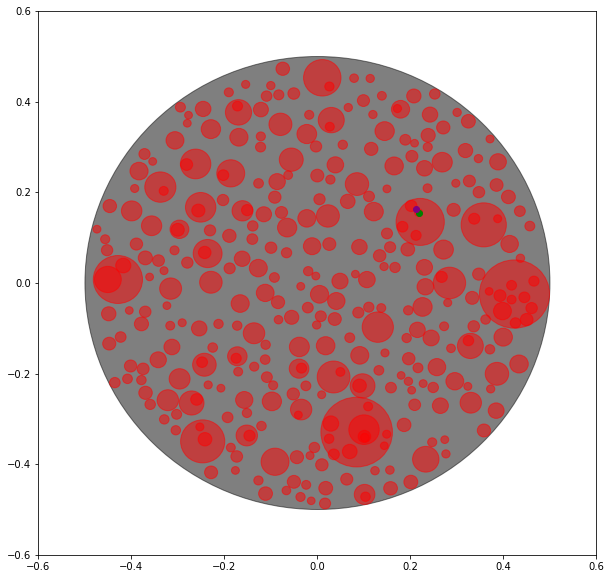

(0.3309595067390931, 0.04099061645811336) (0.33914093200433715, 0.0305021273711858) (<KDNode - (0.33914093200433715, 0.0305021273711858)>, 0.00017694412269737248) 0.013302034532257555 0.008372933736971224


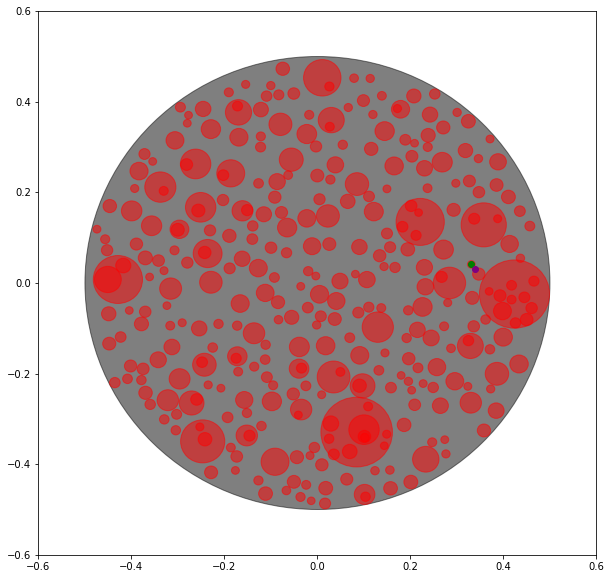

(0.15652532545165082, 0.1297368495251468) (0.15322734562435675, 0.12068270649638888) (<KDNode - (0.15322734562435675, 0.12068270649638888)>, 9.28541769264444e-05) 0.009636087220778173 0.008353867947250907


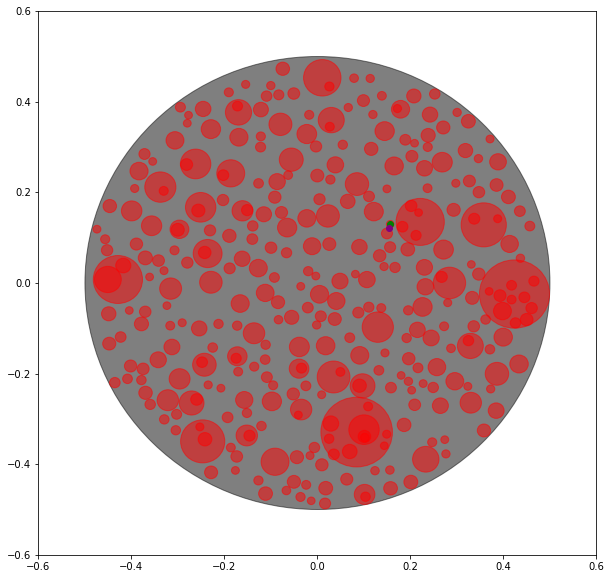

(0.3040795653994181, -0.3451077184113863) (0.28234599818086076, -0.3458613590628881) (<KDNode - (0.28234599818086076, -0.3458613590628881)>, 0.00047291591827514664) 0.02174663004410446 0.00835138688687229


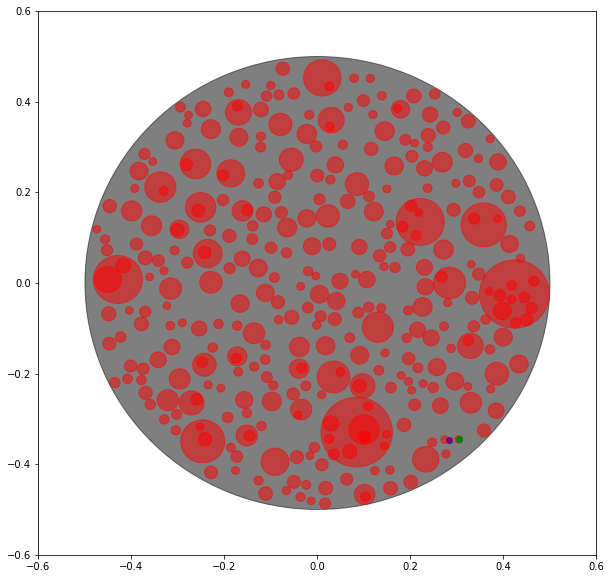

(0.12699566053972805, 0.2243640833712623) (0.1101943262513406, 0.2183715198893358) (<KDNode - (0.1101943262513406, 0.2183715198893358)>, 0.0003181956509550627) 0.017838039436974644 0.008347824817193763


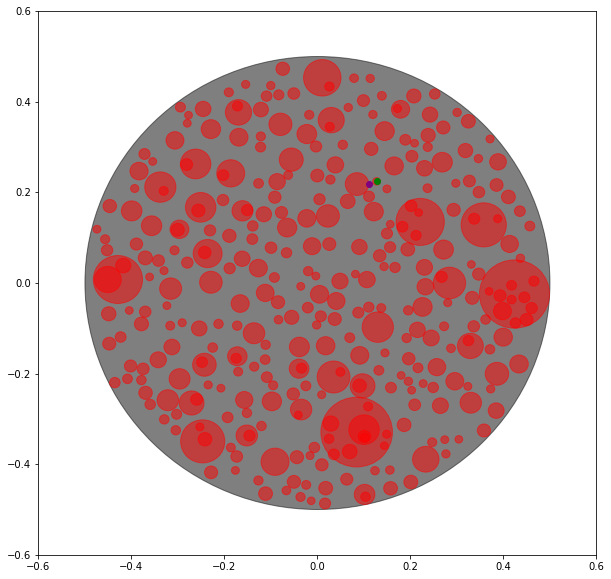

(-0.02392683841952171, -0.277339195170693) (-0.013250014262532545, -0.27227634115754806) (<KDNode - (-0.013250014262532545, -0.27227634115754806)>, 0.00013962706483768518) 0.011816389670186287 0.008341524276125112


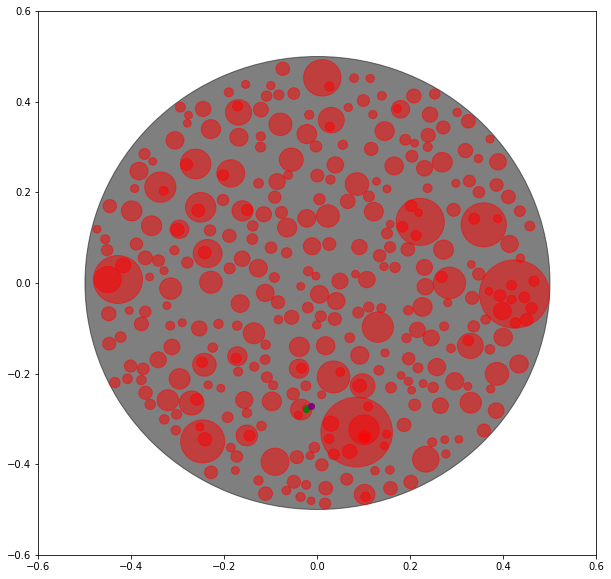

(-0.07098596119503284, 0.19698504407713824) (-0.07893474848295025, 0.19357395269119154) (<KDNode - (-0.07893474848295025, 0.19357395269119154)>, 7.481876379183719e-05) 0.008649784031514151 0.008280734927238501


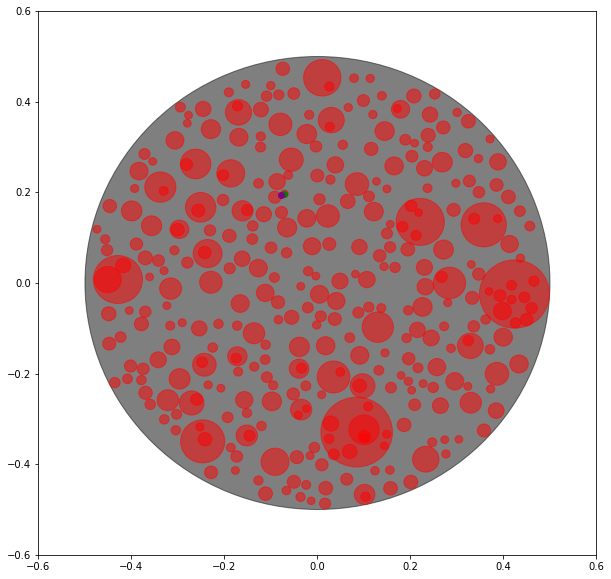

(-0.3335907638299949, -0.20288807953443908) (-0.3178766160110304, -0.20466865922469338) (<KDNode - (-0.3178766160110304, -0.20466865922469338)>, 0.0002501049057096135) 0.015814705362719013 0.0082723191317235


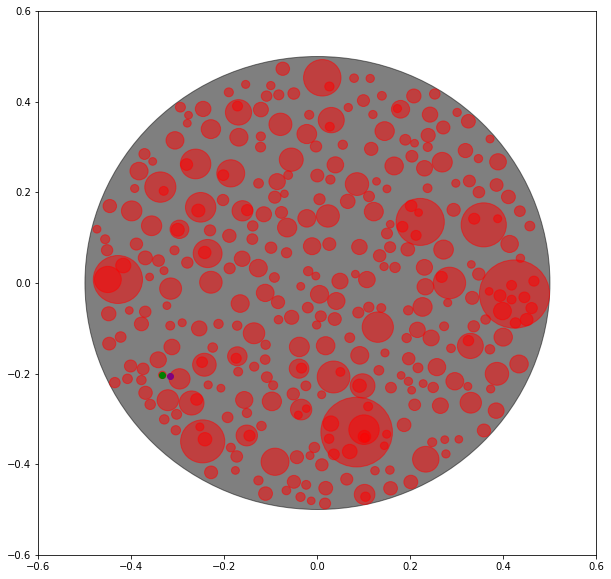

(0.04143659559558357, 0.008684378299142802) (0.03437677659641897, 0.014488084135089917) (<KDNode - (0.03437677659641897, 0.014488084135089917)>, 8.352404573117206e-05) 0.009139149070409787 0.00826089891377498


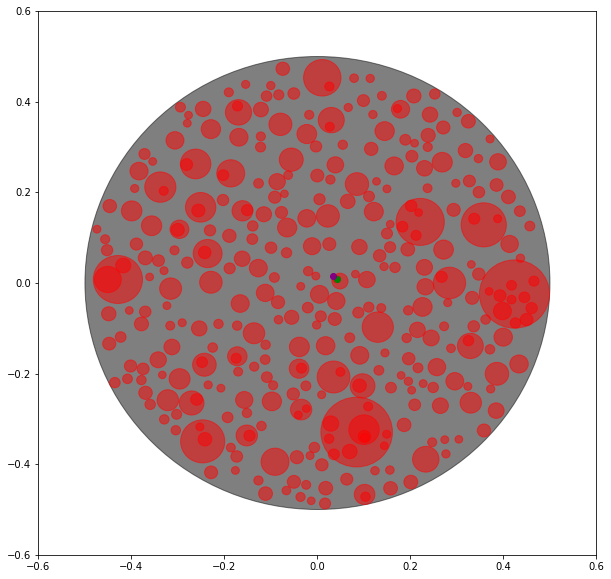

(0.3768068774649132, -0.188444076539152) (0.37116313503497883, -0.18003155284759698) (<KDNode - (0.37116313503497883, -0.18003155284759698)>, 0.00010262238347641593) 0.010130270651686259 0.008247485543246714


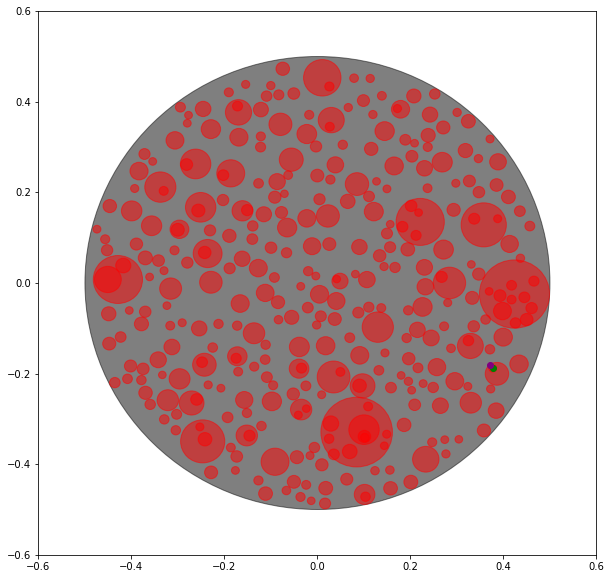

(-0.30797838875240247, 0.14941700792354418) (-0.3030693066903913, 0.13796601344392936) (<KDNode - (-0.3030693066903913, 0.13796601344392936)>, 0.00015522436126372887) 0.012458906904850396 0.008247462277567444


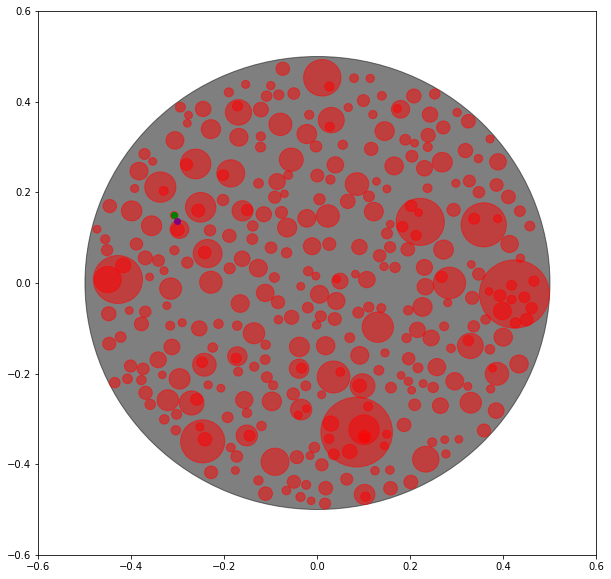

(-0.0797968457258609, 0.036861709285039054) (-0.08626859730663138, 0.020879291020153297) (<KDNode - (-0.08626859730663138, 0.020879291020153297)>, 0.0002973212621169589) 0.017243006179809797 0.008237778055702446


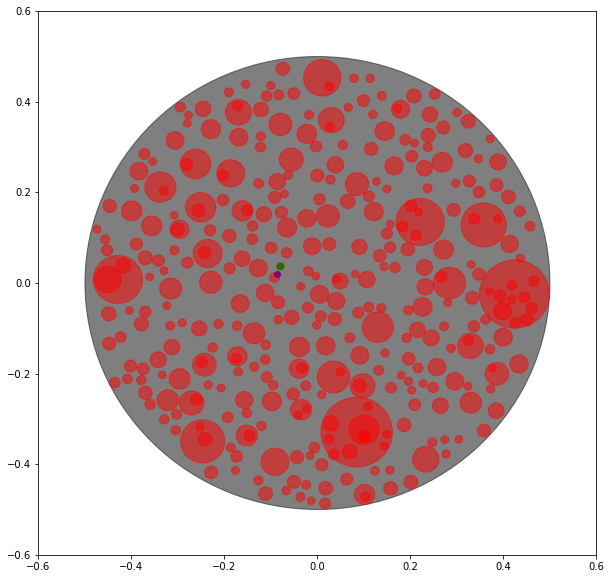

(0.3000314766274277, -0.25217846035121094) (0.30782548555870165, -0.257178482759028) (<KDNode - (0.30782548555870165, -0.257178482759028)>, 8.574679929945097e-05) 0.009259956765528172 0.008230344214441443


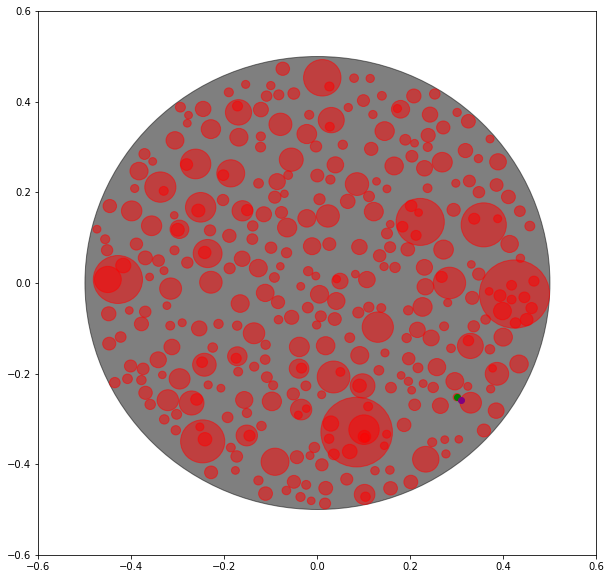

(0.04824934758796134, 0.05156837052355352) (0.03380050513414164, 0.07454255474673485) (<KDNode - (0.03380050513414164, 0.07454255474673485)>, 0.0007365821889759763) 0.027140047696641512 0.008224933564337952


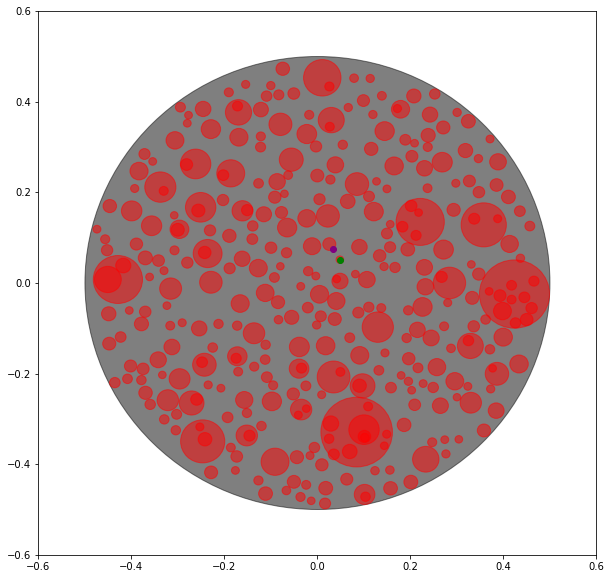

(0.07367896207818705, 0.42004473384789753) (0.08832751274297207, 0.410408424166928) (<KDNode - (0.08832751274297207, 0.410408424166928)>, 0.00030743850084632025) 0.017533924285405143 0.008202881010806908


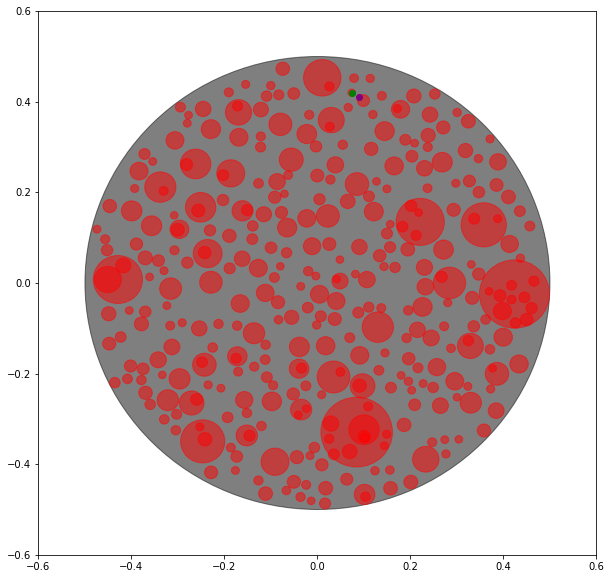

(-0.09047934487973312, 0.2215459395326778) (-0.10103646105330462, 0.21339765247818854) (<KDNode - (-0.10103646105330462, 0.21339765247818854)>, 0.00017784728382464198) 0.013335939555375992 0.008197499049061915


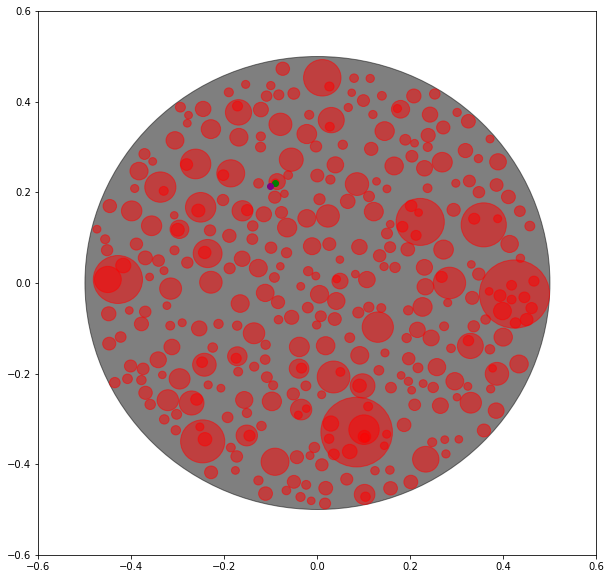

(-0.13113098375855145, -0.41197787119063545) (-0.1197566132113515, -0.4038849427637708) (<KDNode - (-0.1197566132113515, -0.4038849427637708)>, 0.0001948717958673636) 0.013959648844701059 0.008194361841728861


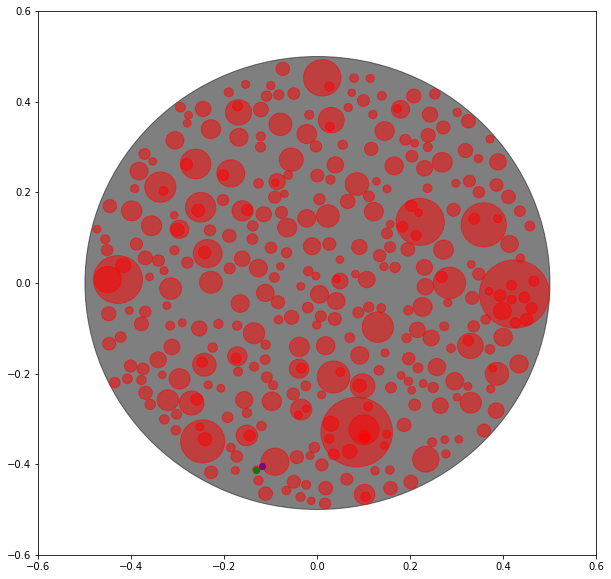

(-0.24874989874869527, -0.03335980643960987) (-0.2434120067257036, -0.017970403195456276) (<KDNode - (-0.2434120067257036, -0.017970403195456276)>, 0.0002653268234602833) 0.016288855805742873 0.008164427742707378


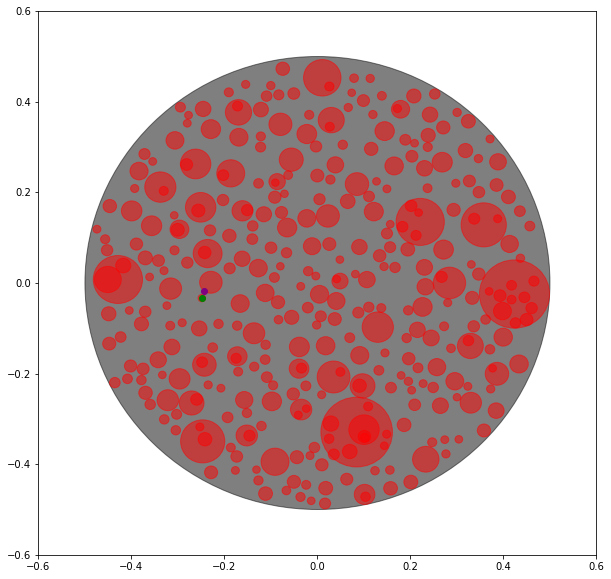

(0.19034520862335508, -0.0327091431161288) (0.19214924374288395, -0.05062380212810608) (<KDNode - (0.19214924374288395, -0.05062380212810608)>, 0.0003241895502279123) 0.0180052645142445 0.008155280211462732


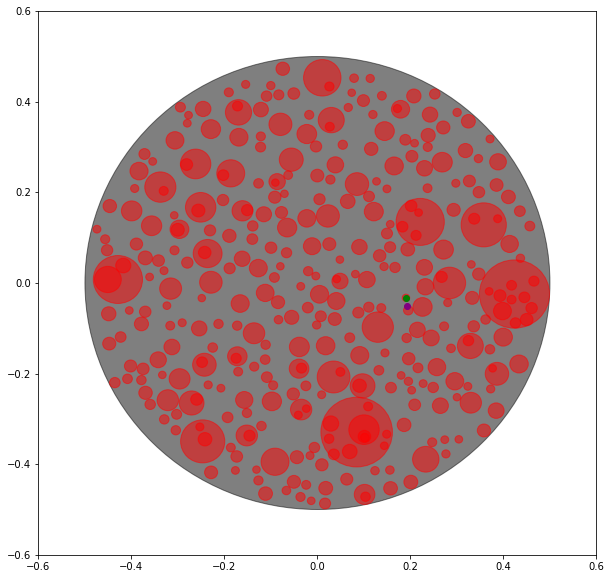

(0.09872199988519986, 0.42598079343782125) (0.09891688227089727, 0.4158039774355067) (<KDNode - (0.09891688227089727, 0.4158039774355067)>, 0.00010360556308922102) 0.010178681795263128 0.008149325278057165


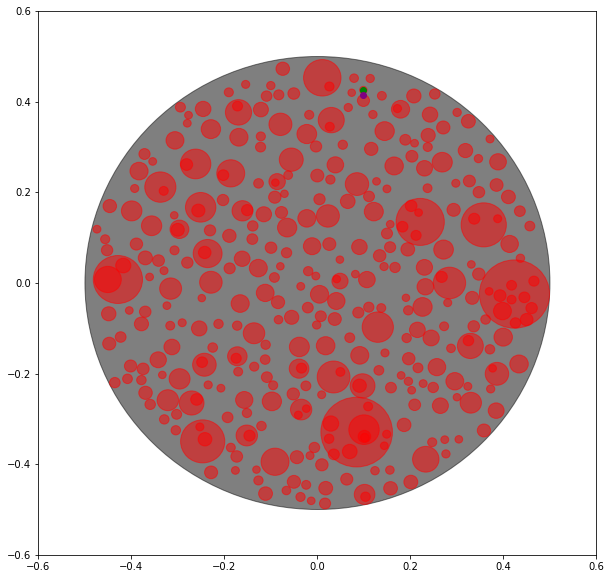

(-0.05222696524792293, 0.017738480217511173) (-0.04094447850707658, -0.00046389762384748106) (<KDNode - (-0.04094447850707658, -0.00046389762384748106)>, 0.00045862106613695825) 0.021415439900617457 0.008144332020520562


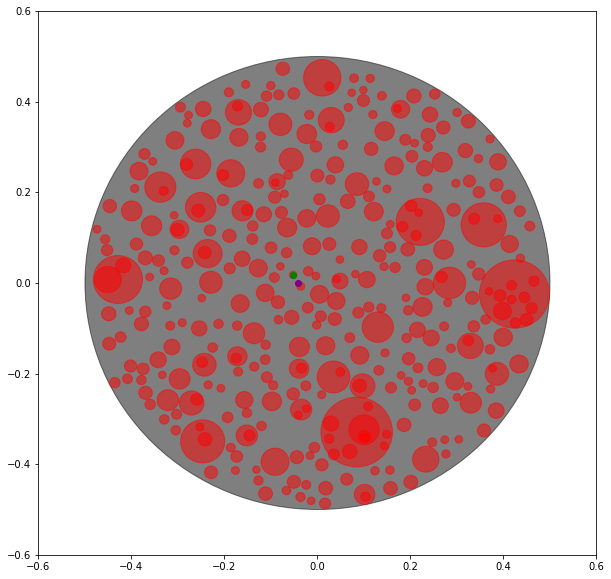

(-0.04872924178208506, 0.46816769936662794) (-0.06063455521402047, 0.4684077701804169) (<KDNode - (-0.06063455521402047, 0.4684077701804169)>, 0.00014179412190825486) 0.011907733701601446 0.008060639827661543


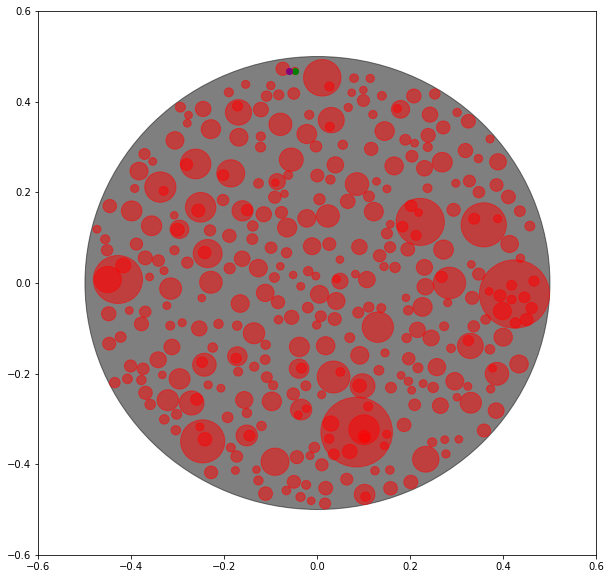

(-0.17607400512693203, 0.1955508772703742) (-0.16818046413971222, 0.18072275586124179) (<KDNode - (-0.16818046413971222, 0.18072275586124179)>, 0.0002821811738408904) 0.016798249130218615 0.008033265268443888


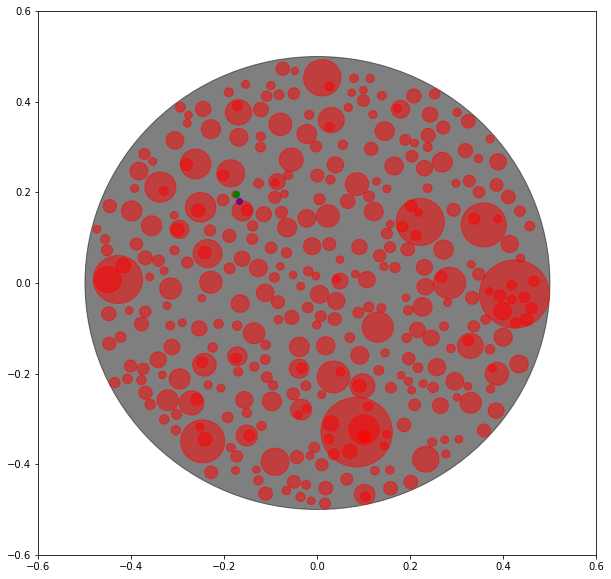

(0.2709501390811499, 0.04296886948240898) (0.2712091104300867, 0.052632347497023016) (<KDNode - (0.2712091104300867, 0.052632347497023016)>, 9.344987349849897e-05) 0.009666947475728778 0.008013415311572689


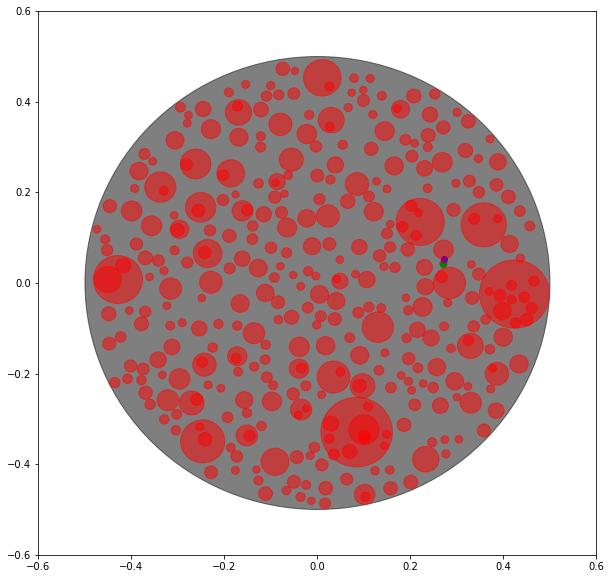

(0.47249827728657545, 0.0847826359354952) (0.46010321690696615, 0.11544018705985042) (<KDNode - (0.46010321690696615, 0.11544018705985042)>, 0.0010935229627566138) 0.03306845872968097 0.008012649027534449


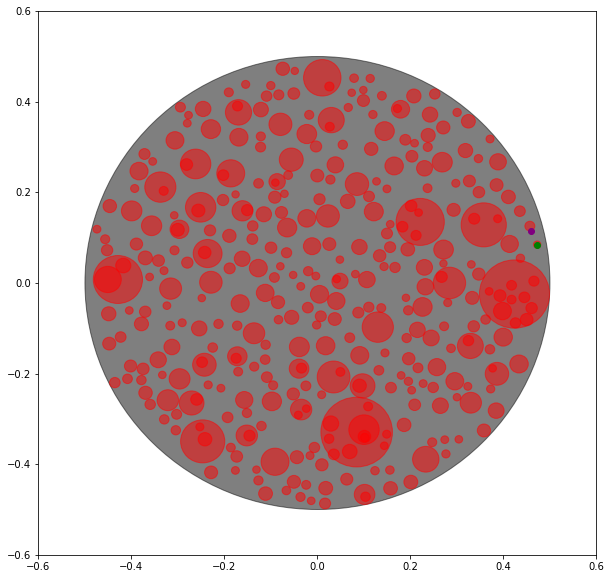

(-0.3124115042500374, 0.3068524328036623) (-0.3177373765958687, 0.2991843924773792) (<KDNode - (-0.3177373765958687, 0.2991843924773792)>, 8.71637586895946e-05) 0.009336153313308141 0.007999275149540104


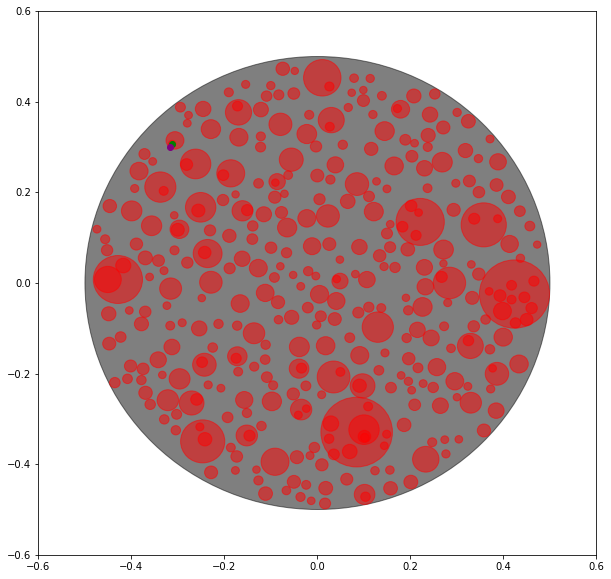

(-0.18092660033447608, -0.31985055476143764) (-0.17062642535181322, -0.3230026757032053) (<KDNode - (-0.17062642535181322, -0.3230026757032053)>, 0.00011602947110500404) 0.010771697689083372 0.007995652207734266


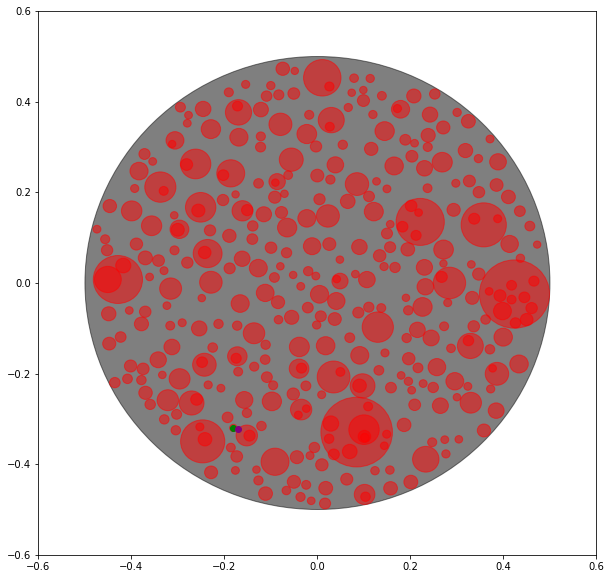

(0.32241162096411197, -0.3639708298671129) (0.3089883874477104, -0.3518641323294661) (<KDNode - (0.3089883874477104, -0.3518641323294661)>, 0.00032675532330390846) 0.018076374727912355 0.007982658500240504


KeyboardInterrupt: 

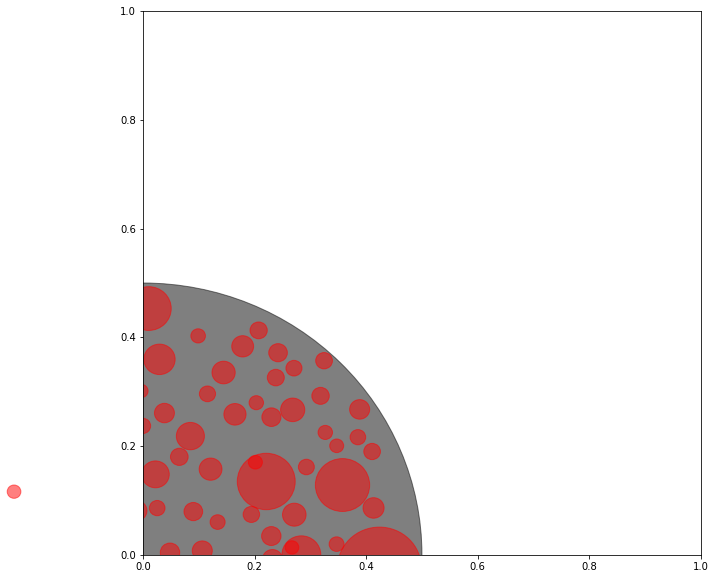

In [134]:
circles = []
tree = kdtree.create(dimensions=2)
points = []
# circles.append(plt.Circle((0,0), 0.5, color='black',alpha=0.5))
circles.append((0,0,.5))
# fig, ax = plt.subplots(1,1,figsize=(10,10))
max_attempts = 1000
n_points = 20
center_to_radius = {}
for u,radius in enumerate(radii):
    attempts = 0
    while attempts<max_attempts:
        r = (.5-radius) * random.random()**.5
        theta = random.random()*2*math.pi
        x = r*math.cos(theta)
        y = r*math.sin(theta)
        search_result = tree.search_nn((x,y))
        if search_result is None \
        or search_result[1]**.5>radius:
            if search_result is not None:
                print((x,y),brute_force(points,(x,y)),search_result,search_result[1]**.5,radius)
            for theta in np.arange(0,2*math.pi,2*math.pi/n_points):
                x1 = x + radius*math.cos(theta)
                y1 = y + radius*math.sin(theta)
                tree.add((x1,y1))
                points.append((x1,y1))
            circles.append((x,y,radius))
            fig, ax = plt.subplots(1,1,figsize=(10,10))
            for x1,y1,r1 in circles:
                ax.add_artist(plt.Circle((x1, y1), r1, color='red' if x1!=0 else 'black',alpha=0.5));
            if search_result is not None:
                plt.plot([x],[y],c='green',marker='o')
                plt.plot([search_result[0].data[0]],[search_result[0].data[1]],c='purple',marker='o')
            plt.xlim(-.6,.6);
            plt.ylim(-.6,.6);
            plt.show();
            tree = tree.rebalance()
            break
        attempts += 1
    else:
        print('failed to place one')
# for circle in circles:
#     ax.add_artist(circle);
# plt.xlim(-.6,.6);
# plt.ylim(-.6,.6);

In [ ]:
circles = []
tree_centers = kdtree.create(dimensions=2)
tree_edges = kdtree.create(dimensions=2)
ax.add_artist(plt.Circle((0,0), 0.5, color='black',alpha=0.5))
fig, ax = plt.subplots(1,1,figsize=(10,10))
max_attempts = 1000
n_points = 20
center_to_radius = {}
for u,radius in enumerate(radii):
    attempts = 0
    while attempts<max_attempts:
        r = (.5-radius) * random.random()**.5
        theta = random.random()*2*math.pi
        x = r*math.cos(theta)
        y = r*math.sin(theta)
        center_search = tree_centers.search_nn((x,y))
        edge_search = tree_edges.search_nn((x,y))
        if center_search is not None:
            x1,y1 = center_search[0].data
            dist1 = center_search[1]
#             x2,y2 = edge_search[0].data
            dist2 = edge_search[1]
        #print((x,y),search_result)
        if center_search is None \
        or (dist1**.5>(center_to_radius[(x1,y1)]+radius) and dist2**.5>radius):
            tree_centers.add((x,y))
            for theta in np.arange(0,2*math.pi,2*math.pi/n_points):
                x1 = x + radius*math.cos(theta)
                y1 = y + radius*math.sin(theta)
                tree_edges.add((x1,y1))
            circles.append((x,y,radius))
            tree_centers = tree_centers.rebalance()
            tree_edges = tree_edges.rebalance()
            center_to_radius[(x,y)] = radius
            break
        attempts += 1
    else:
        print('failed to place one')
for x,y,r in circles:
    ax.add_artist(plt.Circle((x, y), r, color='red',alpha=0.5));
plt.xlim(-.6,.6);
plt.ylim(-.6,.6);